In [20]:
import numpy as np
from scipy import linalg as la
import matplotlib.pyplot as plt
from sklearn.preprocessing import scale

from data_cube import DataCube
from ssm import SSM
from similarity_network_fusion import SNF

In [74]:
dc = DataCube(
    subjects=["10", "20", "30"],
    gestures=["1", "2", "3", "4"],
    channels=["2", "4", "6", "8"],
    data_grp="parsed"
)
dc.load_data()
dc.rms_smooth(100, 20)
dc.normalize_modalities(smooth=True)

In [91]:
t = dc.data_set_smooth["30"]["4_0_1"][:,:-1]
u = dc.data_set_smooth["30"]["3_0_1"][:,:-1]
s = dc.data_set_smooth["30"]["2_0_1"][:,:-1]

In [92]:
def dog_walk(xi, xj, mtrc):
    """
    xi, xj - instances of time series metrics
    xi := (i, vi); vi \in R^D
    n - length of time series
    """
    return abs(xi[0]-xj[0]) * mtrc(xi[1:]-xj[1:])

In [93]:
ssm1 = np.zeros(shape=(t.shape[0], t.shape[0]))
for n,i in enumerate(t):
    for m,j in enumerate(t):
        ssm1[n,m] = dog_walk(i, j, la.norm)

In [94]:
ssm2 = np.zeros(shape=(u.shape[0], u.shape[0]))
for n,i in enumerate(u):
    for m,j in enumerate(u):
        ssm2[n,m] = dog_walk(i, j, la.norm)

In [95]:
ssm3 = np.zeros(shape=(s.shape[0], s.shape[0]))
for n,i in enumerate(s):
    for m,j in enumerate(s):
        ssm3[n,m] = dog_walk(i, j, la.norm)

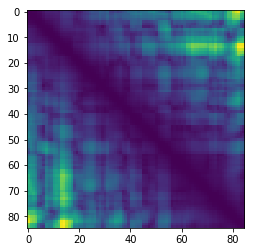

In [96]:
plt.imshow(ssm1)
plt.show()

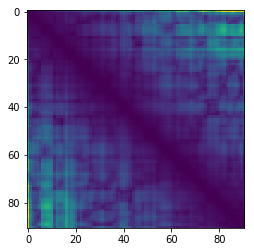

In [97]:
plt.imshow(ssm2)
plt.show()

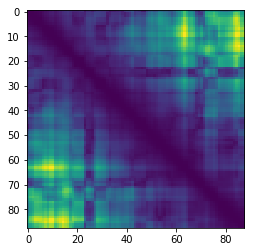

In [98]:
plt.imshow(ssm3)
plt.show()

In [4]:
def pass_synergist_channels(gnum, array):
    """
    pass synergist only channels for each gesture
    gnum - gesture number (i.e. 1, 2, 3, or 4)
    array - entire array of all channels and time index
    """
    synrgsts = {"1":[0, 1, 4], # channels 2 & 8; 0 is tidx
                "2":[0, 2, 3], # channels 4 & 6; 0 is tidx
                "3":[0, 1, 2], # channels 4 & 2; 0 is tidx
                "4":[0, 3, 4]} # channels 6 & 8; 0 is tidx
    synergist_array = np.c_[array[:, synrgsts[gnum][0]],
                            array[:, synrgsts[gnum][1]],
                            array[:, synrgsts[gnum][2]]]
    return synergist_array



def pass_antagonist_channels(gnum, array):
    """
    pass antagonist only channels for each gesture
    gnum - gesture number (i.e. 1, 2, 3, or 4)
    array - entire array of all channels and time index
    """
    antgnsts = {"1":[0, 2, 3], # channels 4 & 6; 0 is tidx
                "2":[0, 1, 4], # channels 2 & 8; 0 is tidx
                "3":[0, 3, 4], # channels 6 & 8; 0 is tidx
                "4":[0, 1, 2]} # channels 4 & 2; 0 is tidx
    antagonist_array = np.c_[array[:, antgnsts[gnum][0]],
                             array[:, antgnsts[gnum][1]],
                             array[:, antgnsts[gnum][2]]]
    return antagonist_array

---

In [5]:
dict_antag = {}
for s, gdict in dc.data_set_smooth.items():
    dict_antag[s] = {}
    for g, a in gdict.items():
        snf = SNF(pass_antagonist_channels(g[0], a), k=0.2)
        # calculate graph weights to find knn
        snf.calc_weights()
        snf.normalize_weights()
        # generate and normalize knn graphs
        snf.calc_knn_weights()
        snf.normalize_knn_weights()
        # fuse graphs
        snf.network_fusion(eta=0.2, iters=50)
        # save template to dict
        dict_antag[s][g] = snf.fused_similarity_template

In [6]:
dict_synerg = {}
for s, gdict in dc.data_set_smooth.items():
    dict_synerg[s] = {}
    for g, a in gdict.items():
        snf = SNF(pass_synergist_channels(g[0], a), k=0.2)
        # calculate graph weights to find knn
        snf.calc_weights()
        snf.normalize_weights()
        # generate and normalize knn graphs
        snf.calc_knn_weights()
        snf.normalize_knn_weights()
        # fuse graphs
        snf.network_fusion(eta=0.2, iters=50)
        # save template to dict
        dict_synerg[s][g] = snf.fused_similarity_template

---

In [7]:
decomp_ant = {}

for s, gdict in dict_antag.items():
    decomp_ant[s] = {}
    for g, a in gdict.items():
        print(f"subject {s}; gesture {g}; avg {a.mean()}; sd {a.std()}")
        evals, evecs = la.eig(a)
        evals = evals.real
        sort_idx = np.argsort(-evals)
        evals = evals[sort_idx]
        evecs = evecs[:, sort_idx]
        # calc percent of variance explained
        print(f"subject {s}; gesture {g}; PoV: {evals[0].real / evals.real.sum()}")
        # do PCA
        res = a @ evecs[:, 0]
        res = scale(res.real)
        decomp_ant[s][g] = res

subject 30; gesture 3_0_1; avg 1.399408910518126; sd 0.03337986141275371
subject 30; gesture 3_0_1; PoV: 0.9735971388306639
subject 30; gesture 4_1_1; avg 0.9486380944577384; sd 0.009447441787171367
subject 30; gesture 4_1_1; PoV: 0.9838964085185549
subject 30; gesture 2_0_1; avg 1.0916088003819857; sd 0.03874335029846573
subject 30; gesture 2_0_1; PoV: 0.9613643245518249
subject 30; gesture 4_1_2; avg 1.8617200128517737; sd 0.009974780116494216
subject 30; gesture 4_1_2; PoV: 0.9923094900176469
subject 30; gesture 2_0_2; avg 0.9436849505807638; sd 0.0122480737202941
subject 30; gesture 2_0_2; PoV: 0.9742819876313923
subject 30; gesture 1_1_2; avg 1.0601091890899648; sd 0.011369034018909076
subject 30; gesture 1_1_2; PoV: 0.98237251786956
subject 30; gesture 2_1_2; avg 1.5965130445037772; sd 0.015173193926809334
subject 30; gesture 2_1_2; PoV: 0.9871714929923071
subject 30; gesture 4_0_1; avg 0.9237886098346534; sd 0.01069810592899096
subject 30; gesture 4_0_1; PoV: 0.9806836289409125


subject 05; gesture 3_0_2; PoV: 0.9861110941655434
subject 05; gesture 1_1_1; avg 2.361469257435967; sd 0.015240830603332143
subject 05; gesture 1_1_1; PoV: 0.9907256807415855
subject 05; gesture 3_1_2; avg 1.8686766593130915; sd 0.019378065706141697
subject 05; gesture 3_1_2; PoV: 0.9854685784817337
subject 05; gesture 2_1_1; avg 1.4260625068538044; sd 0.016996339185642723
subject 05; gesture 2_1_1; PoV: 0.9824147888841935
subject 05; gesture 1_0_1; avg 1.2943519591330759; sd 0.011369644995896214
subject 05; gesture 1_0_1; PoV: 0.9892369744826816
subject 05; gesture 3_1_1; avg 1.9959412055473353; sd 0.015725210294399442
subject 05; gesture 3_1_1; PoV: 0.990260124008498
subject 05; gesture 1_0_2; avg 2.3556453047935086; sd 0.024535202042531165
subject 05; gesture 1_0_2; PoV: 0.9852721010776041
subject 05; gesture 4_0_2; avg 0.8913228953614439; sd 0.024155507026382424
subject 05; gesture 4_0_2; PoV: 0.9666097833768602
subject 21; gesture 3_0_1; avg 0.954548374414914; sd 0.01321480985556

subject 26; gesture 4_1_2; PoV: 0.6913141607399996
subject 26; gesture 2_0_2; avg 1.2396862698363942; sd 0.02319222415968753
subject 26; gesture 2_0_2; PoV: 0.9766511741249583
subject 26; gesture 1_1_2; avg 2.3767625967613046; sd 0.021611742641283505
subject 26; gesture 1_1_2; PoV: 0.9865861812142567
subject 26; gesture 2_1_2; avg 1.2761021687194867; sd 0.01916031500257593
subject 26; gesture 2_1_2; PoV: 0.9807411531365047
subject 26; gesture 4_0_1; avg 2.1866354798825274; sd 0.03324434439716149
subject 26; gesture 4_0_1; PoV: 0.9829136119988195
subject 26; gesture 3_0_2; avg 1.4788783130192225; sd 0.01167797043788279
subject 26; gesture 3_0_2; PoV: 0.9853229526702715
subject 26; gesture 1_1_1; avg 1.7222149551291221; sd 0.02804749281810914
subject 26; gesture 1_1_1; PoV: 0.9821098158450411
subject 26; gesture 3_1_2; avg 1.0487597674950653; sd 0.011256578661279203
subject 26; gesture 3_1_2; PoV: 0.9799725108892513
subject 26; gesture 2_1_1; avg 2.7472563235309377; sd 0.0730161572078233

subject 25; gesture 1_0_1; PoV: 0.9902521978269482
subject 25; gesture 3_1_1; avg 1.602824876789998; sd 0.033734534726612544
subject 25; gesture 3_1_1; PoV: 0.9696036151604615
subject 25; gesture 1_0_2; avg 1.4223700573682945; sd 0.01662257133506581
subject 25; gesture 1_0_2; PoV: 0.9771970502286794
subject 25; gesture 4_0_2; avg 1.4017644106721603; sd 0.028204396741531204
subject 25; gesture 4_0_2; PoV: 0.9749421175088905
subject 18; gesture 3_0_1; avg 1.9226765976793336; sd 0.013530775990726074
subject 18; gesture 3_0_1; PoV: 0.9906513309927543
subject 18; gesture 4_1_1; avg 1.1384355734865366; sd 0.02222867956823282
subject 18; gesture 4_1_1; PoV: 0.9743592173055441
subject 18; gesture 2_0_1; avg 1.0921070738254162; sd 0.009515586630400025
subject 18; gesture 2_0_1; PoV: 0.9855784864959967
subject 18; gesture 4_1_2; avg 5.656115026469121; sd 0.039137097338340976
subject 18; gesture 4_1_2; PoV: 0.9920455725410685
subject 18; gesture 2_0_2; avg 0.9359716937717557; sd 0.012738399193368

subject 12; gesture 2_0_2; PoV: 0.9847831535922413
subject 12; gesture 1_1_2; avg 1.3637294443330616; sd 0.013446524988855754
subject 12; gesture 1_1_2; PoV: 0.9826053127697231
subject 12; gesture 2_1_2; avg 2.7121154498139406; sd 0.038853629087532156
subject 12; gesture 2_1_2; PoV: 0.9880900219027728
subject 12; gesture 4_0_1; avg 1.0594918645164517; sd 0.009761288280806813
subject 12; gesture 4_0_1; PoV: 0.9833988219571139
subject 12; gesture 3_0_2; avg 3.2116574055233404; sd 0.10837080228725719
subject 12; gesture 3_0_2; PoV: 0.9694588582748673
subject 12; gesture 1_1_1; avg 1.8520107939474506; sd 0.022183289781975448
subject 12; gesture 1_1_1; PoV: 0.9830147018873222
subject 12; gesture 3_1_2; avg 0.9335243035020176; sd 0.009331894908592823
subject 12; gesture 3_1_2; PoV: 0.9860741427815927
subject 12; gesture 2_1_1; avg 1.2307158774443756; sd 0.016844654876745767
subject 12; gesture 2_1_1; PoV: 0.9803987303818639
subject 12; gesture 1_0_1; avg 1.394249270031189; sd 0.0126062226037

subject 36; gesture 1_1_2; PoV: 0.9878000348248505
subject 36; gesture 2_1_2; avg 1.9263827962419269; sd 0.030663050741430116
subject 36; gesture 2_1_2; PoV: 0.9726625472649219
subject 36; gesture 4_0_1; avg 2.277024340387634; sd 0.02756720979512265
subject 36; gesture 4_0_1; PoV: 0.9830226146734957
subject 36; gesture 3_0_2; avg 3.3930287701471546; sd 0.01932276542264808
subject 36; gesture 3_0_2; PoV: 0.9942179726384033
subject 36; gesture 1_1_1; avg 1.4096245668377874; sd 0.025874132635263235
subject 36; gesture 1_1_1; PoV: 0.9710097874788934
subject 36; gesture 3_1_2; avg 1.653881240298894; sd 0.010336871578504277
subject 36; gesture 3_1_2; PoV: 0.9917748248837034
subject 36; gesture 2_1_1; avg 1.9600462822860685; sd 0.030515841521517022
subject 36; gesture 2_1_1; PoV: 0.9771271730707235
subject 36; gesture 1_0_1; avg 1.5591221821575063; sd 0.014596318446687509
subject 36; gesture 1_0_1; PoV: 0.9843825229636459
subject 36; gesture 3_1_1; avg 1.2026964368678472; sd 0.014032453601134

subject 35; gesture 4_0_2; PoV: 0.9803626661094584
subject 22; gesture 3_0_1; avg 1.3027534721303142; sd 0.01177489147868366
subject 22; gesture 3_0_1; PoV: 0.9858108738067156
subject 22; gesture 4_1_1; avg 1.5688195846187467; sd 0.011706557421600495
subject 22; gesture 4_1_1; PoV: 0.9870184908431843
subject 22; gesture 2_0_1; avg 1.3477293011405655; sd 0.01559033426710226
subject 22; gesture 2_0_1; PoV: 0.9800214980109693
subject 22; gesture 4_1_2; avg 1.5347725919817818; sd 0.018637365214710634
subject 22; gesture 4_1_2; PoV: 0.9810204234987357
subject 22; gesture 2_0_2; avg 1.084402695895564; sd 0.01243770610971235
subject 22; gesture 2_0_2; PoV: 0.9787271921903711
subject 22; gesture 1_1_2; avg 9.713922170216131; sd 0.08140357878193322
subject 22; gesture 1_1_2; PoV: 0.9942252017760035
subject 22; gesture 2_1_2; avg 1.0521067425094495; sd 0.00986683811938983
subject 22; gesture 2_1_2; PoV: 0.9831657411269417
subject 22; gesture 4_0_1; avg 1.0708650593280797; sd 0.02009418566630061


In [8]:
decomp_syn = {}

for s, gdict in dict_synerg.items():
    decomp_syn[s] = {}
    for g, a in gdict.items():
        print(f"subject {s}; gesture {g}; avg {a.mean()}; sd {a.std()}")
        evals, evecs = la.eig(a)
        evals = evals.real
        sort_idx = np.argsort(-evals)
        evals = evals[sort_idx]
        evecs = evecs[:, sort_idx]
        # calc percent of variance explained
        print(f"subject {s}; gesture {g}; PoV: {evals[0].real / evals.real.sum()}")
        # do PCA
        res = a @ evecs[:, 0]
        res = scale(res.real)
        decomp_syn[s][g] = res

subject 30; gesture 3_0_1; avg 0.9767384530206688; sd 0.008885241228213957
subject 30; gesture 3_0_1; PoV: 0.982840180214439
subject 30; gesture 4_1_1; avg 1.344079509165732; sd 0.012157781269667859
subject 30; gesture 4_1_1; PoV: 0.9879681951553816
subject 30; gesture 2_0_1; avg 4.069002018187431; sd 0.04122555071906487
subject 30; gesture 2_0_1; PoV: 0.9920322894270451
subject 30; gesture 4_1_2; avg 2.368534009835186; sd 0.034717830287538436
subject 30; gesture 4_1_2; PoV: 0.982421259532845
subject 30; gesture 2_0_2; avg 1.3636101188503817; sd 0.011397781354546119
subject 30; gesture 2_0_2; PoV: 0.9858415427247617
subject 30; gesture 1_1_2; avg 1.7617567196761668; sd 0.016856627447998134
subject 30; gesture 1_1_2; PoV: 0.9828242702817631
subject 30; gesture 2_1_2; avg 1.6833170775917061; sd 0.019131658421209955
subject 30; gesture 2_1_2; PoV: 0.9885490427048987
subject 30; gesture 4_0_1; avg 1.371803043772622; sd 0.011834718772620326
subject 30; gesture 4_0_1; PoV: 0.989043054006556


subject 16; gesture 2_0_1; avg 1.7500326446417152; sd 1.420693101311607
subject 16; gesture 2_0_1; PoV: 0.5333955526567274
subject 16; gesture 4_1_2; avg 1.1819776003732774; sd 0.9298437489788657
subject 16; gesture 4_1_2; PoV: 0.5555935801213044
subject 16; gesture 2_0_2; avg 2.9500016613842184; sd 0.04643206413321108
subject 16; gesture 2_0_2; PoV: 0.9817237147249485
subject 16; gesture 1_1_2; avg 1.9870850633368342; sd 0.020382324283259527
subject 16; gesture 1_1_2; PoV: 0.9804047697134222
subject 16; gesture 2_1_2; avg 1.1455761223192344; sd 0.009236816290400601
subject 16; gesture 2_1_2; PoV: 0.9881711314443273
subject 16; gesture 4_0_1; avg 2.9015639636280293; sd 0.023653903674145535
subject 16; gesture 4_0_1; PoV: 0.9920446826359801
subject 16; gesture 3_0_2; avg 2.423475120905702; sd 0.011504526312343341
subject 16; gesture 3_0_2; PoV: 0.9934782524877327
subject 16; gesture 1_1_1; avg 1.2146126072324772; sd 0.012774436543069452
subject 16; gesture 1_1_1; PoV: 0.9824455968485583

subject 08; gesture 2_0_2; PoV: 0.9730366776281225
subject 08; gesture 1_1_2; avg 1.0971152229881775; sd 0.04210356377779076
subject 08; gesture 1_1_2; PoV: 0.9538927692359455
subject 08; gesture 2_1_2; avg 1.1844107027419541; sd 1.0186968471630462
subject 08; gesture 2_1_2; PoV: 0.5494407278210524
subject 08; gesture 4_0_1; avg 1.5515159839354464; sd 0.027974404728267493
subject 08; gesture 4_0_1; PoV: 0.9727885372652372
subject 08; gesture 3_0_2; avg 1.896618404604428; sd 0.02922151772622253
subject 08; gesture 3_0_2; PoV: 0.9806564542659773
subject 08; gesture 1_1_1; avg 2.8004805801224797; sd 0.037789863242814276
subject 08; gesture 1_1_1; PoV: 0.9841207715288429
subject 08; gesture 3_1_2; avg 8.180721845490133; sd 0.03973769555191922
subject 08; gesture 3_1_2; PoV: 0.9958955048144327
subject 08; gesture 2_1_1; avg 1.9056208576610503; sd 0.025839488750228207
subject 08; gesture 2_1_1; PoV: 0.9858109206919873
subject 08; gesture 1_0_1; avg 1.344608844610996; sd 0.0113705425741168
su

subject 25; gesture 2_1_1; PoV: 0.9768231816653802
subject 25; gesture 1_0_1; avg 1.3033983843610417; sd 0.01033887455354202
subject 25; gesture 1_0_1; PoV: 0.9862331654398123
subject 25; gesture 3_1_1; avg 3.077142459821065; sd 0.012509057689840298
subject 25; gesture 3_1_1; PoV: 0.9953192919542166
subject 25; gesture 1_0_2; avg 1.3260970966723309; sd 0.01875671954007544
subject 25; gesture 1_0_2; PoV: 0.9791314140011528
subject 25; gesture 4_0_2; avg 1.3483456833495946; sd 0.016307900310985623
subject 25; gesture 4_0_2; PoV: 0.9811008792152627
subject 18; gesture 3_0_1; avg 2.8790586514389287; sd 0.021934144397123975
subject 18; gesture 3_0_1; PoV: 0.9900131769458551
subject 18; gesture 4_1_1; avg 1.1006815856762697; sd 0.011663671808713678
subject 18; gesture 4_1_1; PoV: 0.9844174993696907
subject 18; gesture 2_0_1; avg 3.8680881127515767; sd 0.04906566652436697
subject 18; gesture 2_0_1; PoV: 0.9886218056079104
subject 18; gesture 4_1_2; avg 3.460547991691147; sd 0.0307808840205304

subject 07; gesture 1_0_1; PoV: 0.9855905852078618
subject 07; gesture 3_1_1; avg 1.0870205237053359; sd 0.01033347542475427
subject 07; gesture 3_1_1; PoV: 0.9867999543633209
subject 07; gesture 1_0_2; avg 1.7845792444081345; sd 0.0197035244730176
subject 07; gesture 1_0_2; PoV: 0.9885512483012806
subject 07; gesture 4_0_2; avg 1.124097130812466; sd 0.015986468266107126
subject 07; gesture 4_0_2; PoV: 0.9792758555161722
subject 20; gesture 3_0_1; avg 1.2769068743270955; sd 0.02014802128418088
subject 20; gesture 3_0_1; PoV: 0.9818785575236404
subject 20; gesture 4_1_1; avg 1.248828199672373; sd 0.013729178092355299
subject 20; gesture 4_1_1; PoV: 0.9776639640379856
subject 20; gesture 2_0_1; avg 1.1618657697652788; sd 0.010623725632093633
subject 20; gesture 2_0_1; PoV: 0.9845629032436287
subject 20; gesture 4_1_2; avg 1.9083273979525142; sd 0.018584445167393587
subject 20; gesture 4_1_2; PoV: 0.9836491040252593
subject 20; gesture 2_0_2; avg 2.882630059534556; sd 0.06298646218929191


subject 35; gesture 2_0_1; PoV: 0.9835205479081268
subject 35; gesture 4_1_2; avg 2.91954645903334; sd 0.10935374605339498
subject 35; gesture 4_1_2; PoV: 0.9667503131367041
subject 35; gesture 2_0_2; avg 1.3067594681823365; sd 0.011031090925595744
subject 35; gesture 2_0_2; PoV: 0.9876282805884032
subject 35; gesture 1_1_2; avg 1.138383419281715; sd 0.01379400188182068
subject 35; gesture 1_1_2; PoV: 0.9803651747906013
subject 35; gesture 2_1_2; avg 2.175624060858659; sd 0.01991388749331318
subject 35; gesture 2_1_2; PoV: 0.983276588777292
subject 35; gesture 4_0_1; avg 1.5308058153770392; sd 0.01781801555233951
subject 35; gesture 4_0_1; PoV: 0.9801578777474309
subject 35; gesture 3_0_2; avg 2.23115925022283; sd 0.08130373985765245
subject 35; gesture 3_0_2; PoV: 0.9638929510424903
subject 35; gesture 1_1_1; avg 1.4992377494521307; sd 0.017613872856743325
subject 35; gesture 1_1_1; PoV: 0.9787463375740019
subject 35; gesture 3_1_2; avg 2.1267858665272095; sd 0.019812664049700317
subj

subject 02; gesture 1_1_1; PoV: 0.986601150293754
subject 02; gesture 3_1_2; avg 1.9775912676382572; sd 0.014122748122711167
subject 02; gesture 3_1_2; PoV: 0.9912874071391516
subject 02; gesture 2_1_1; avg 0.9551135412544682; sd 0.009239097478741014
subject 02; gesture 2_1_1; PoV: 0.9810904347958738
subject 02; gesture 1_0_1; avg 1.186772767130415; sd 0.01715077711240204
subject 02; gesture 1_0_1; PoV: 0.9762941884992488
subject 02; gesture 3_1_1; avg 1.0606953330350408; sd 0.017166680244638508
subject 02; gesture 3_1_1; PoV: 0.9775753307265247
subject 02; gesture 1_0_2; avg 0.9401292622935145; sd 0.015844328230279776
subject 02; gesture 1_0_2; PoV: 0.9748837934193938
subject 02; gesture 4_0_2; avg 2.029660028387778; sd 0.0144617660907004
subject 02; gesture 4_0_2; PoV: 0.991501794294368


---

In [9]:
ant_syn_dict = {}

gests = decomp_ant["01"].keys()

for s in dc.subjects:
    ant_syn_dict[s] = {}
    for g in gests:
        ant_syn_dict[s][g] = np.c_[dc.data_set_smooth[s][g][:,0], decomp_syn[s][g], decomp_ant[s][g]]

subject 30; gesture 3_0_1


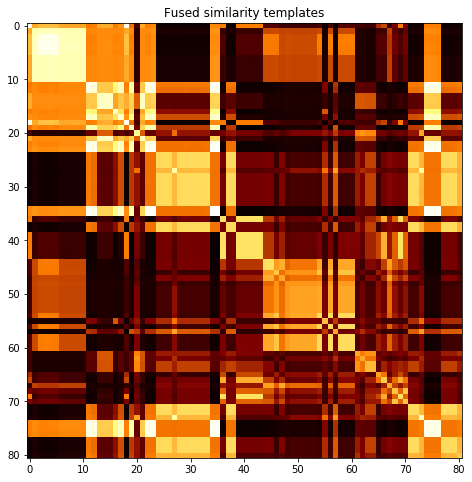

subject 30; gesture 4_1_1


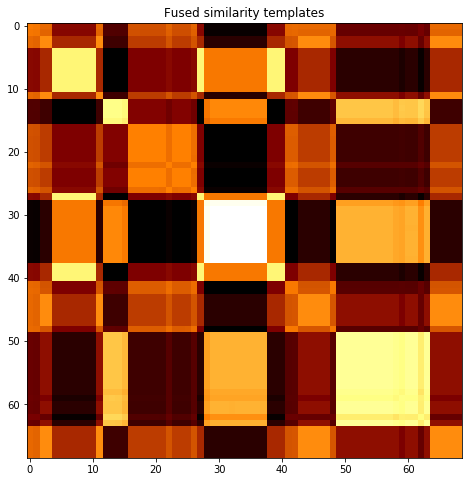

subject 30; gesture 2_0_1


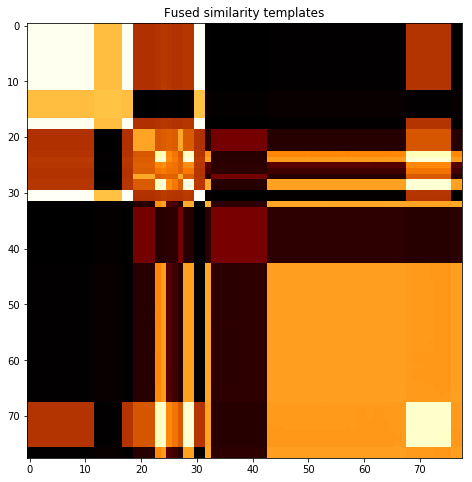

subject 30; gesture 4_1_2


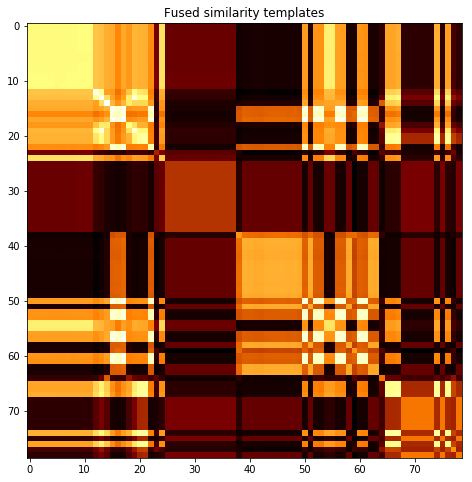

subject 30; gesture 2_0_2


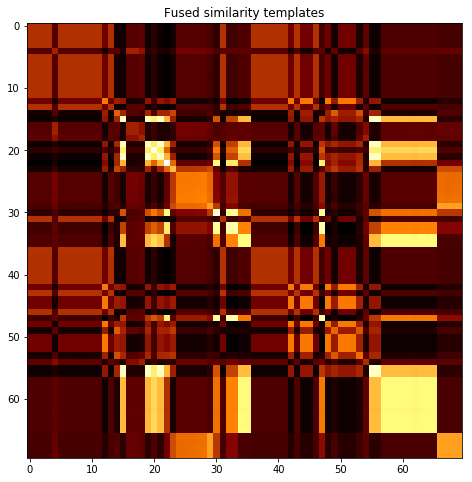

subject 30; gesture 1_1_2


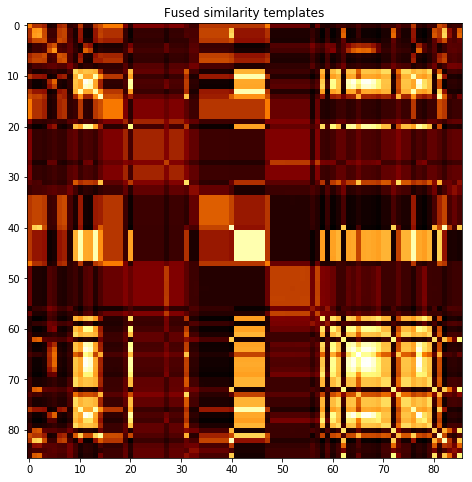

subject 30; gesture 2_1_2


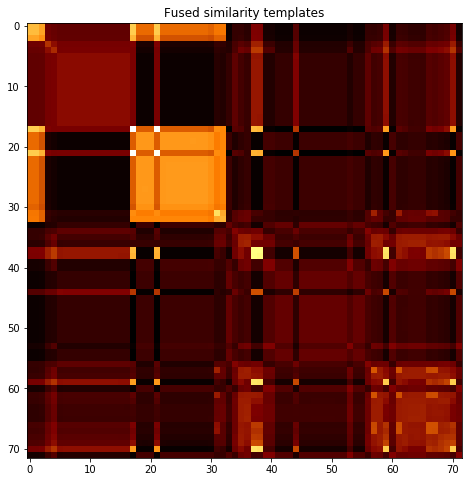

subject 30; gesture 4_0_1


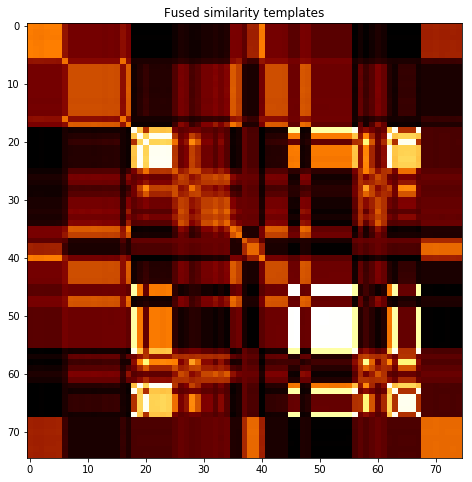

subject 30; gesture 3_0_2


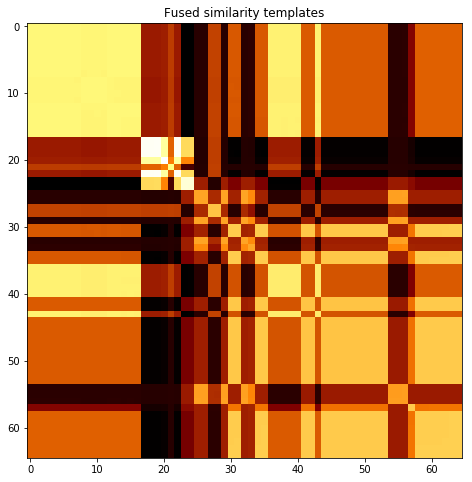

subject 30; gesture 1_1_1


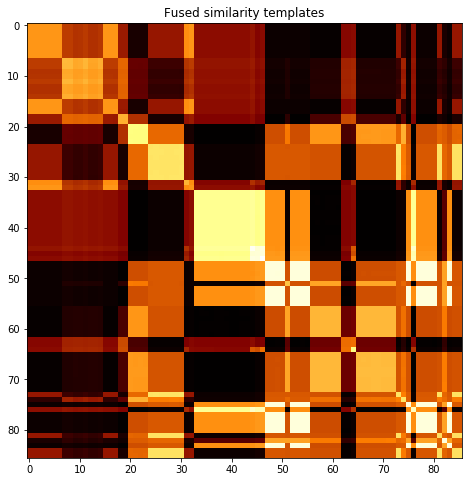

subject 30; gesture 3_1_2


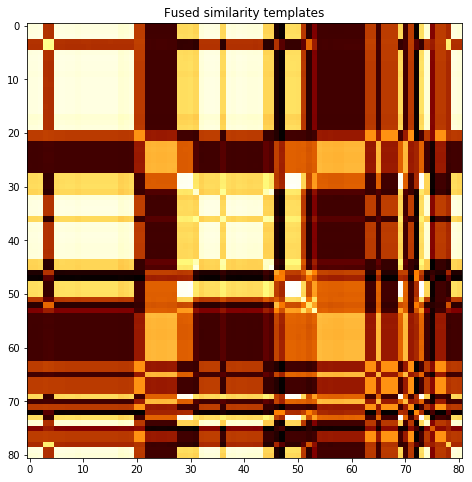

subject 30; gesture 2_1_1


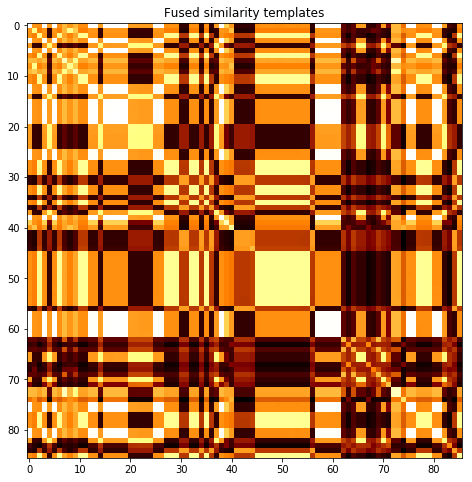

subject 30; gesture 1_0_1


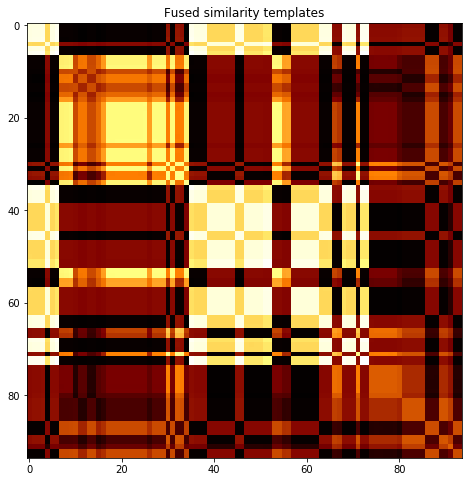

subject 30; gesture 3_1_1


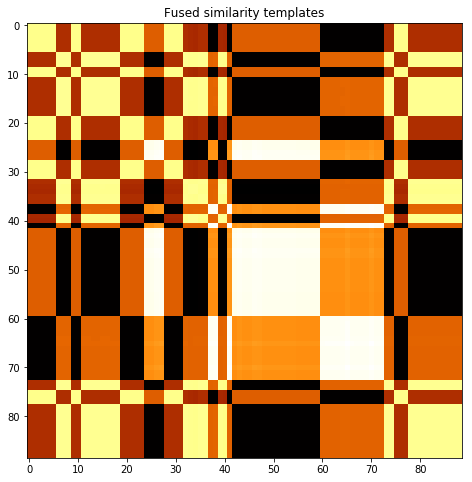

subject 30; gesture 1_0_2


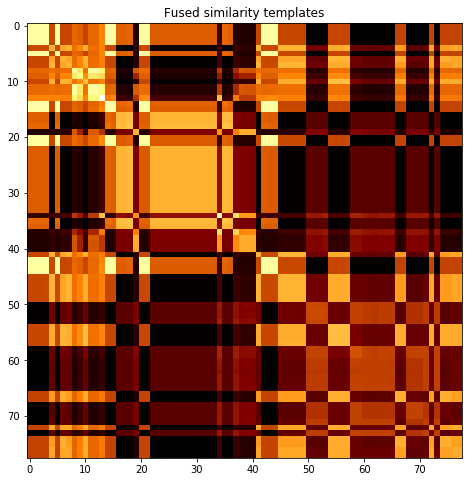

subject 30; gesture 4_0_2


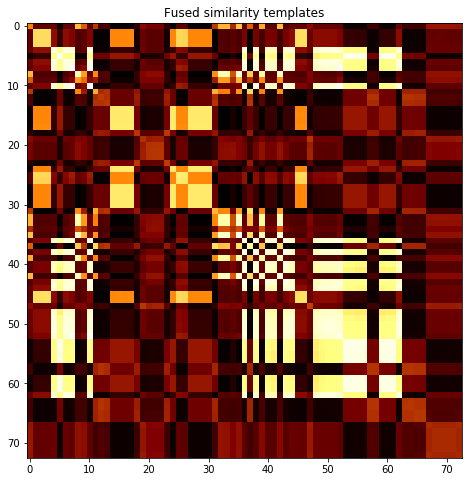

subject 06; gesture 3_0_1


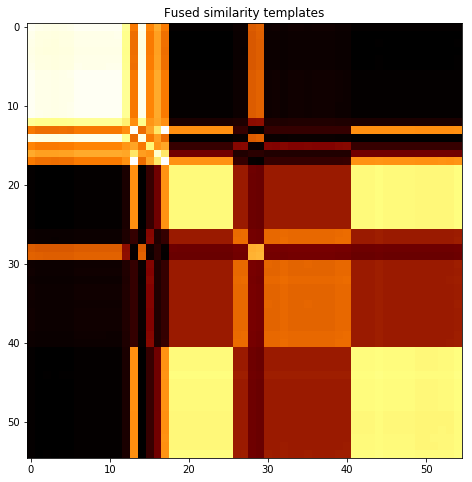

subject 06; gesture 4_1_1


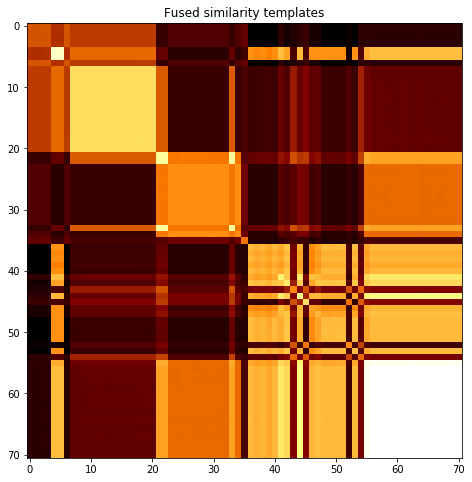

subject 06; gesture 2_0_1


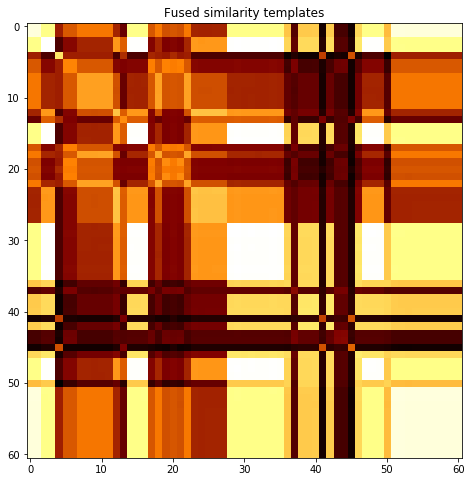

subject 06; gesture 4_1_2


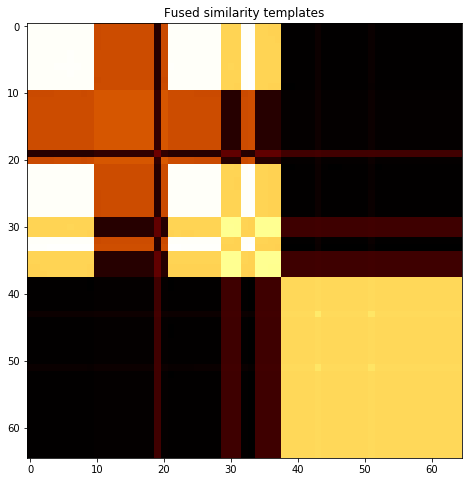

subject 06; gesture 2_0_2


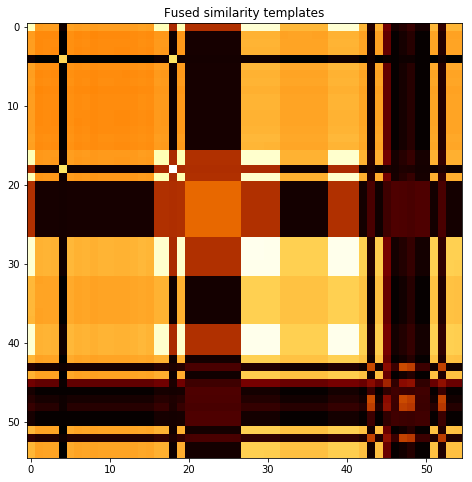

subject 06; gesture 1_1_2


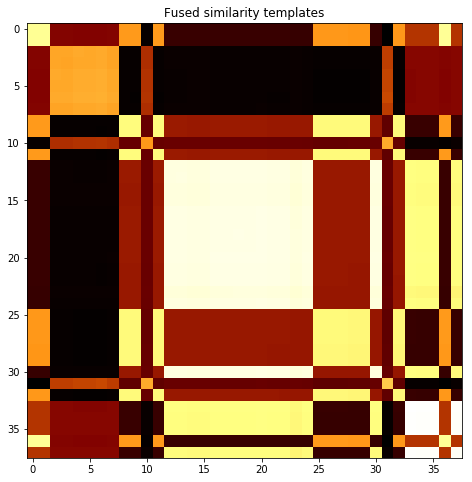

subject 06; gesture 2_1_2


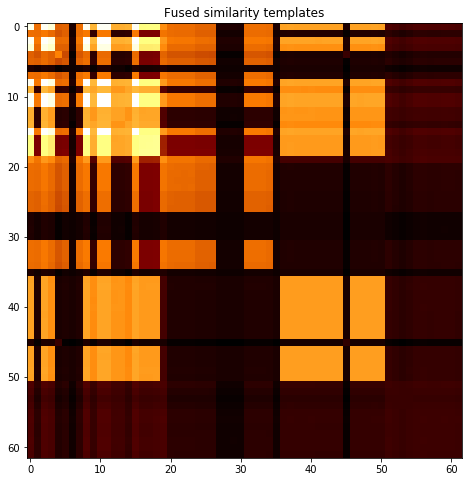

subject 06; gesture 4_0_1


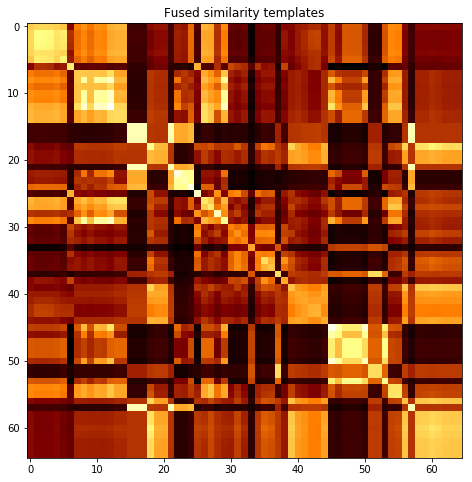

subject 06; gesture 3_0_2


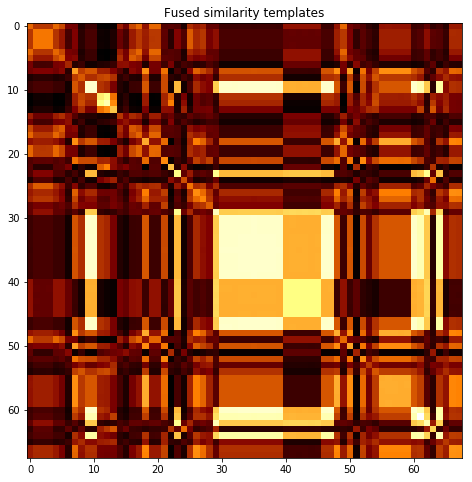

subject 06; gesture 1_1_1


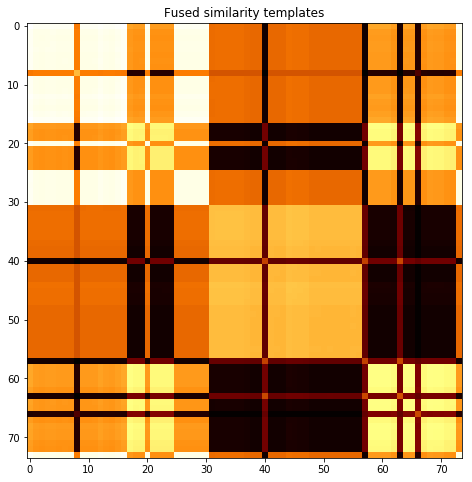

subject 06; gesture 3_1_2


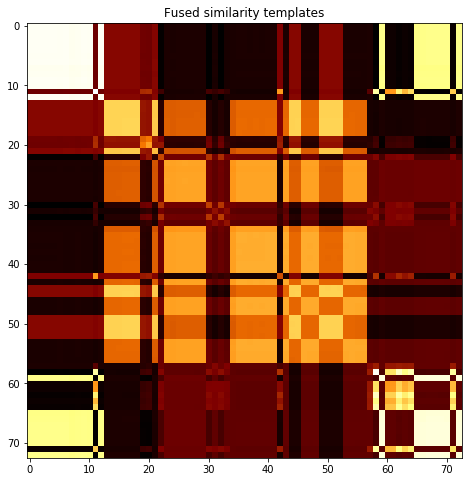

subject 06; gesture 2_1_1


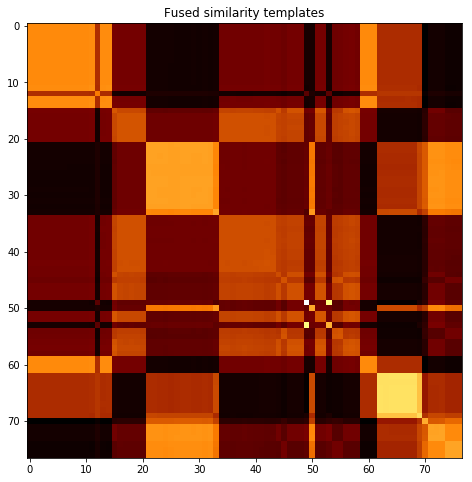

subject 06; gesture 1_0_1


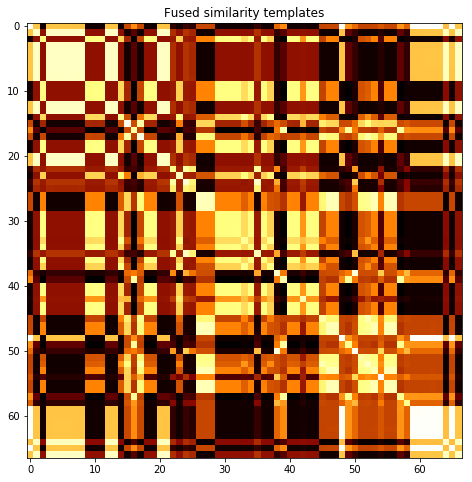

subject 06; gesture 3_1_1


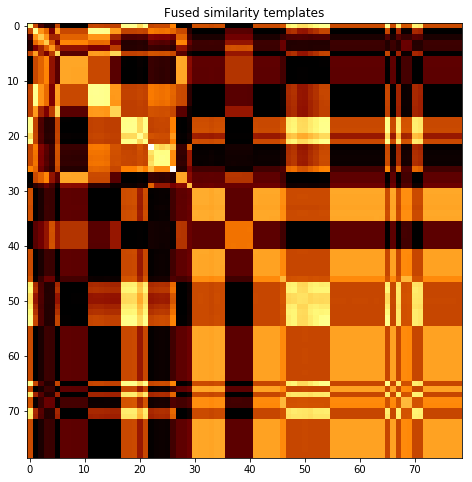

subject 06; gesture 1_0_2


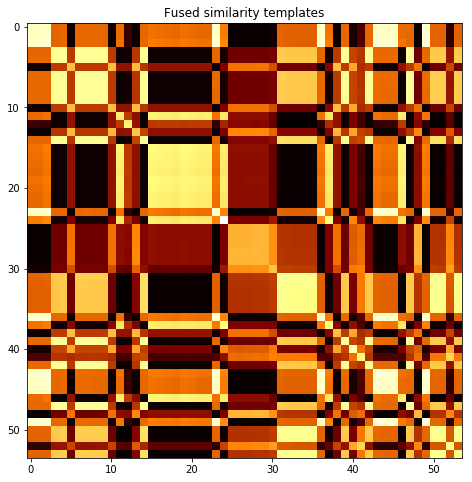

subject 06; gesture 4_0_2


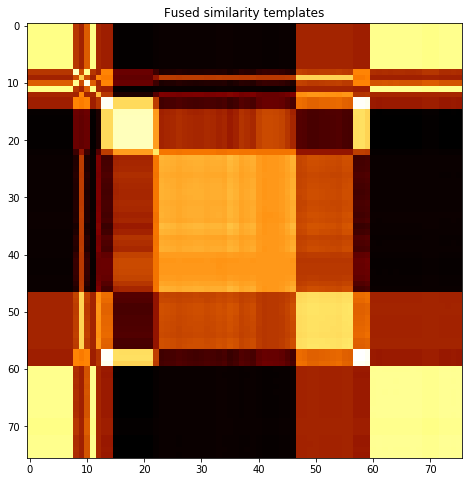

subject 09; gesture 3_0_1


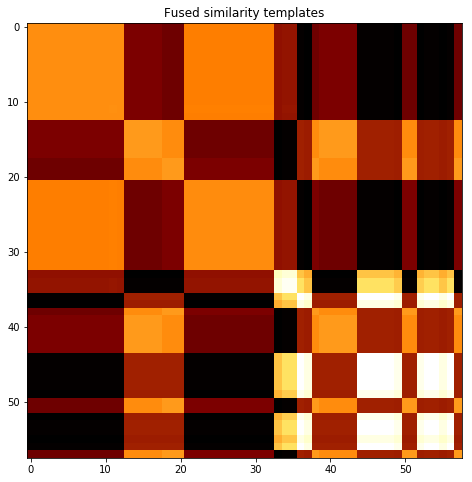

subject 09; gesture 4_1_1


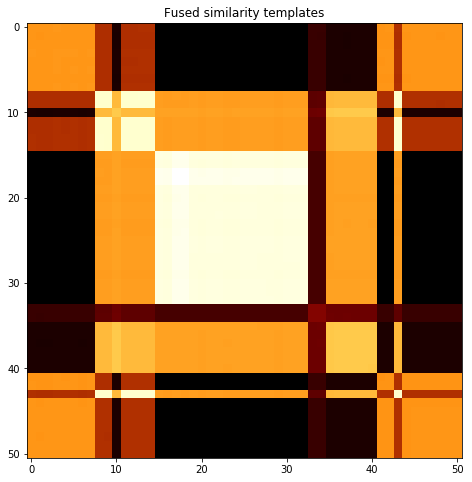

subject 09; gesture 2_0_1


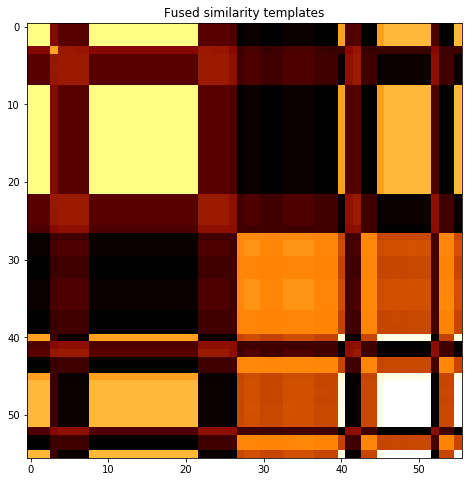

subject 09; gesture 4_1_2


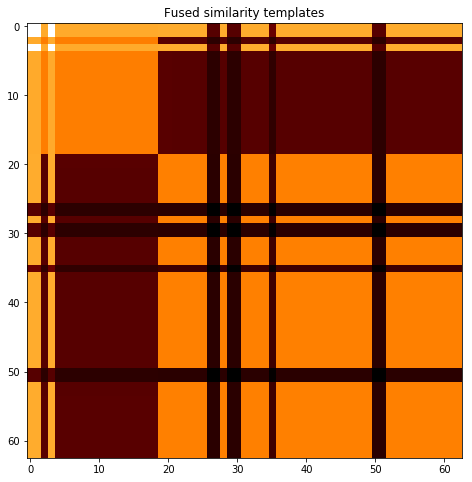

subject 09; gesture 2_0_2


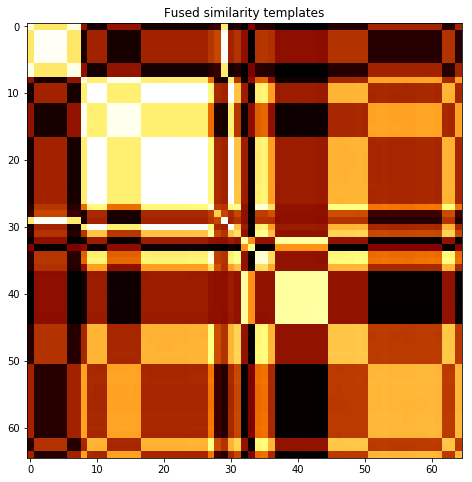

subject 09; gesture 1_1_2


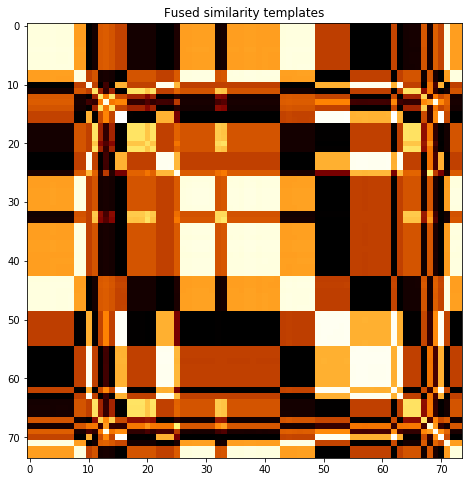

subject 09; gesture 2_1_2


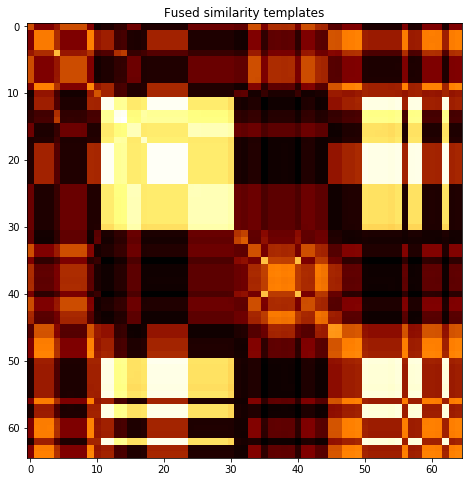

subject 09; gesture 4_0_1


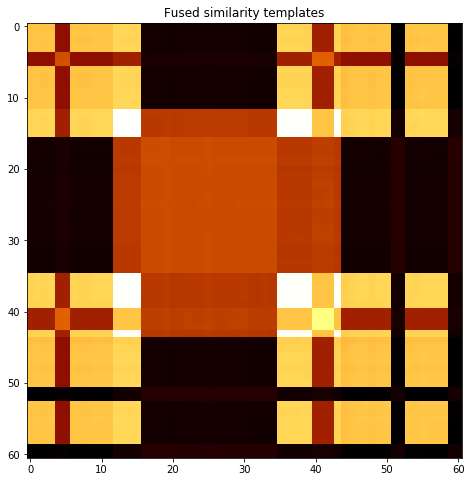

subject 09; gesture 3_0_2


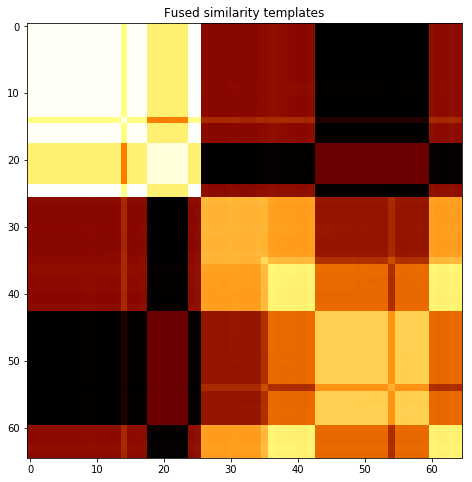

subject 09; gesture 1_1_1


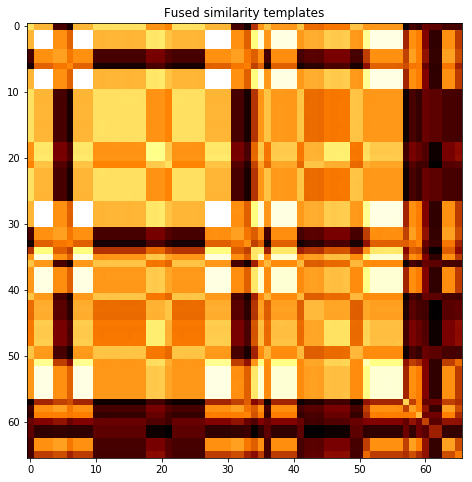

subject 09; gesture 3_1_2


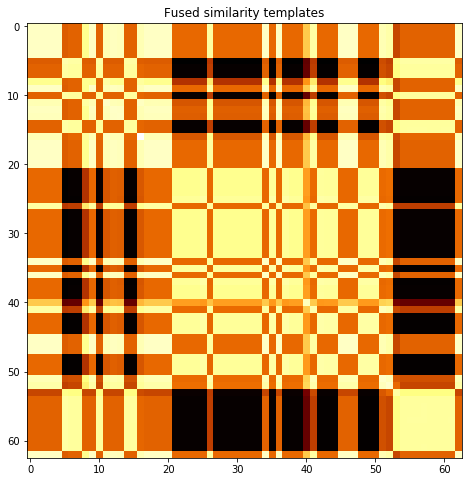

subject 09; gesture 2_1_1


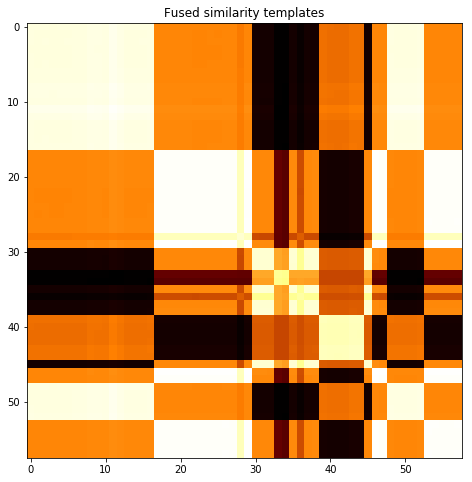

subject 09; gesture 1_0_1


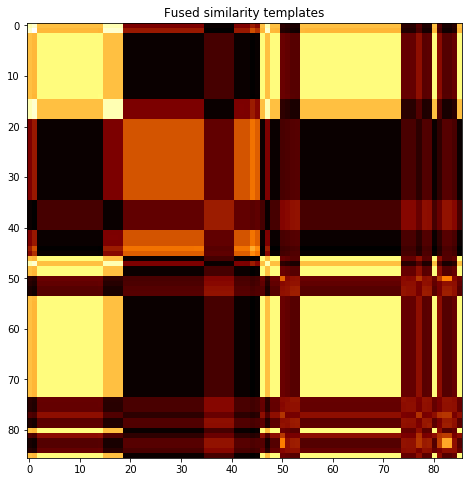

subject 09; gesture 3_1_1


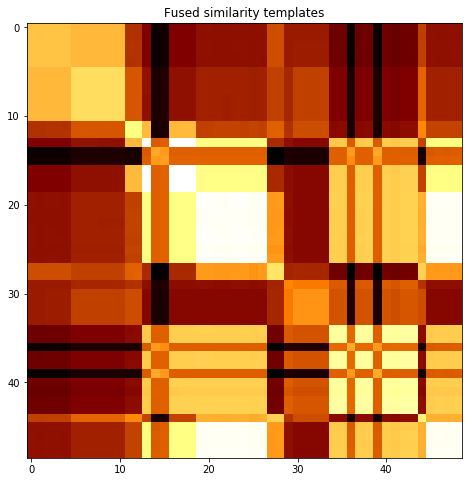

subject 09; gesture 1_0_2


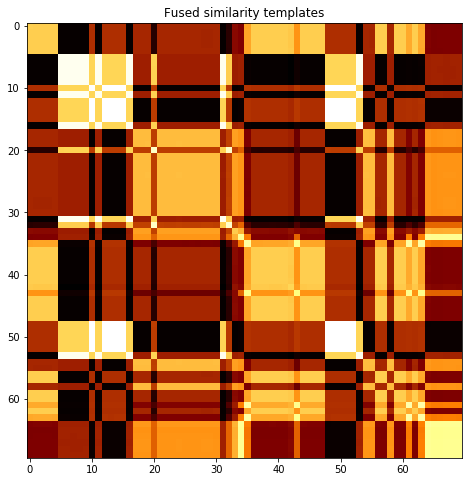

subject 09; gesture 4_0_2


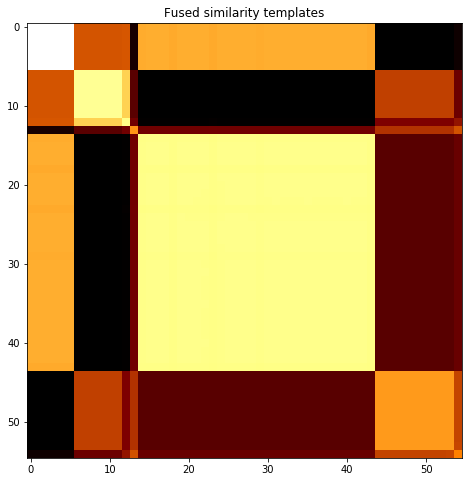

subject 03; gesture 3_0_1


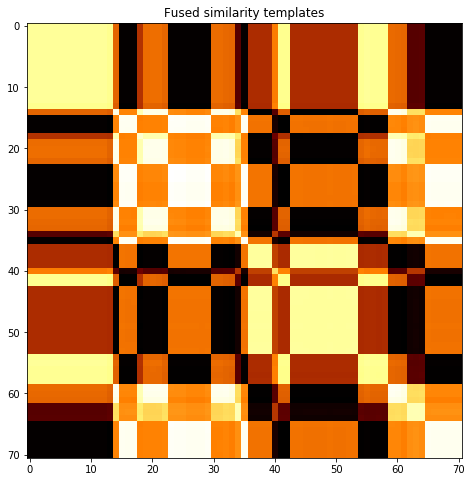

subject 03; gesture 4_1_1


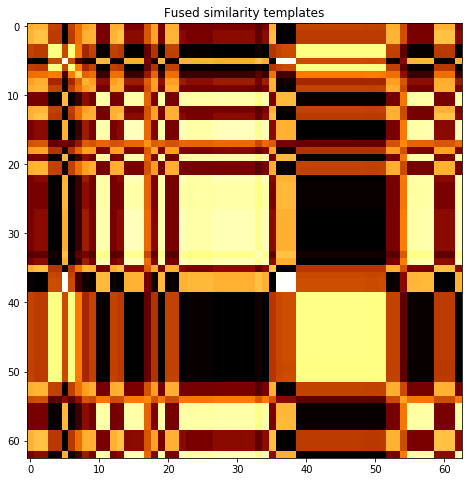

subject 03; gesture 2_0_1


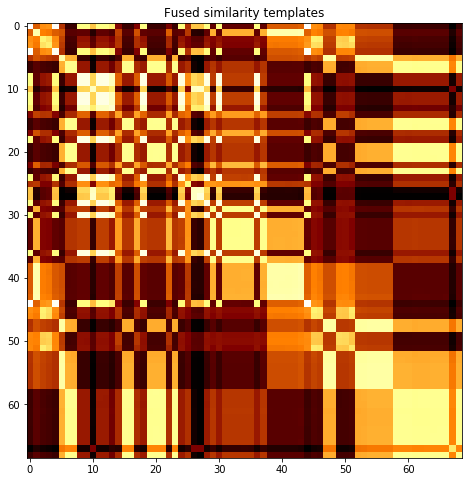

subject 03; gesture 4_1_2


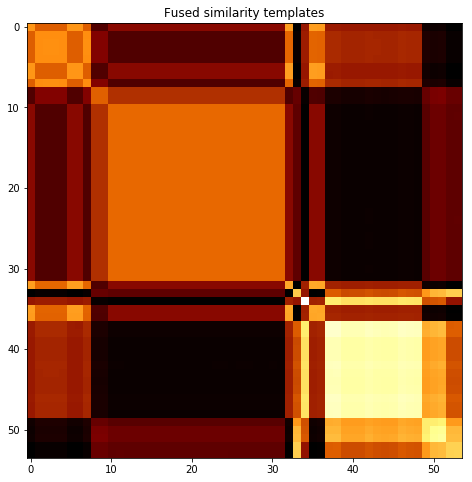

subject 03; gesture 2_0_2


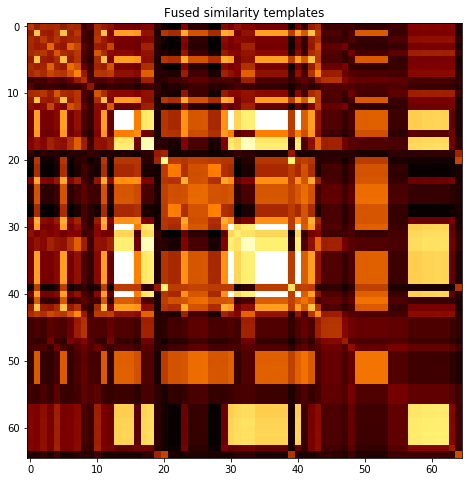

subject 03; gesture 1_1_2


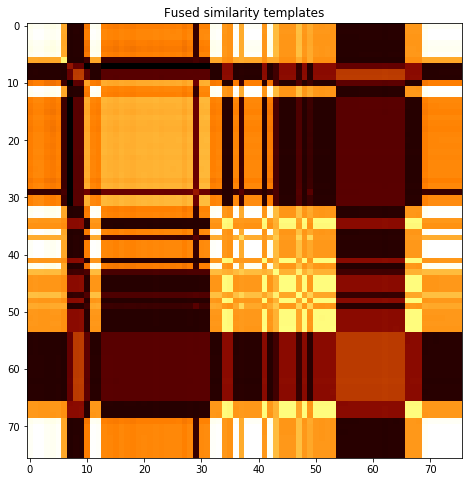

subject 03; gesture 2_1_2


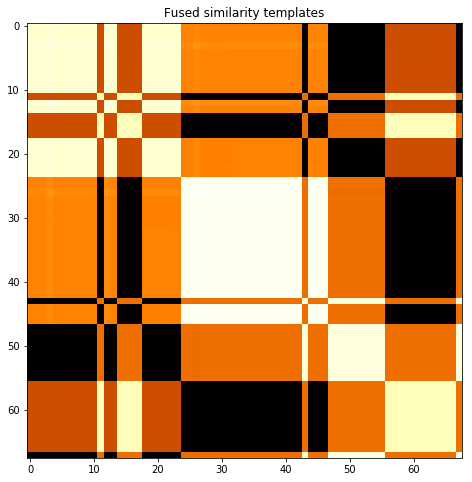

subject 03; gesture 4_0_1


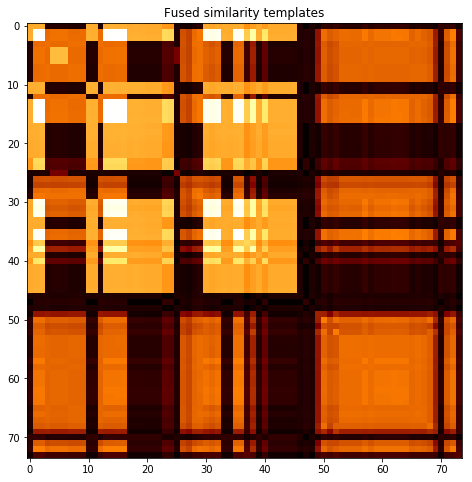

subject 03; gesture 3_0_2


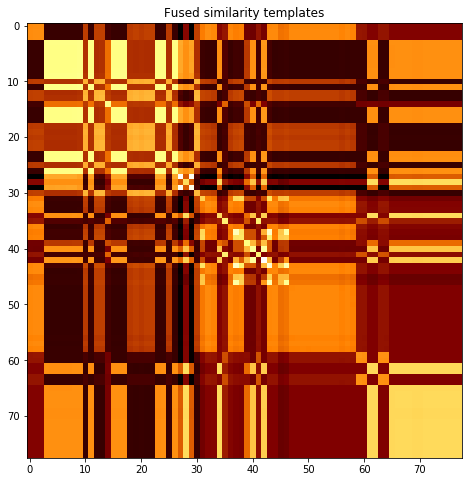

subject 03; gesture 1_1_1


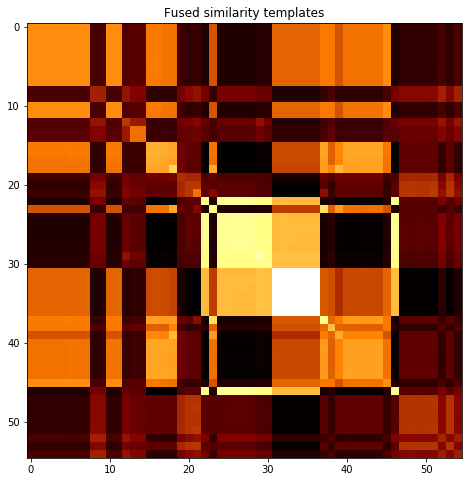

subject 03; gesture 3_1_2


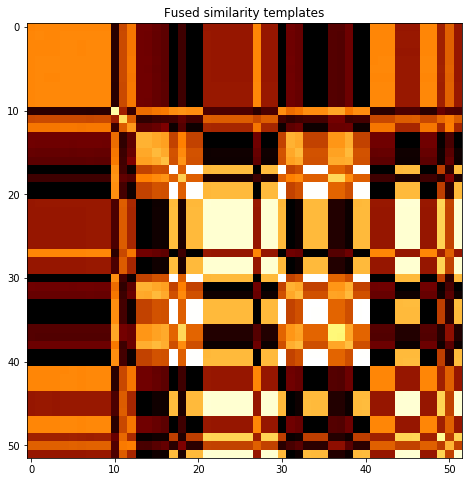

subject 03; gesture 2_1_1


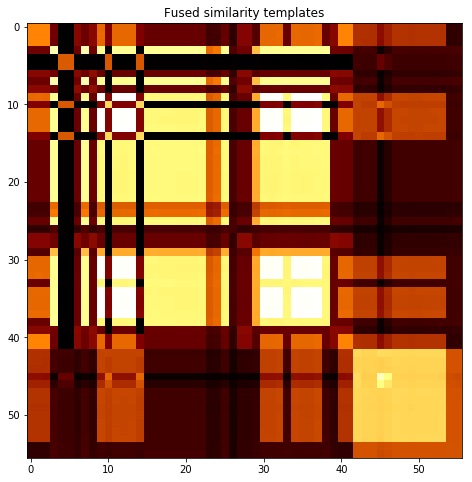

subject 03; gesture 1_0_1


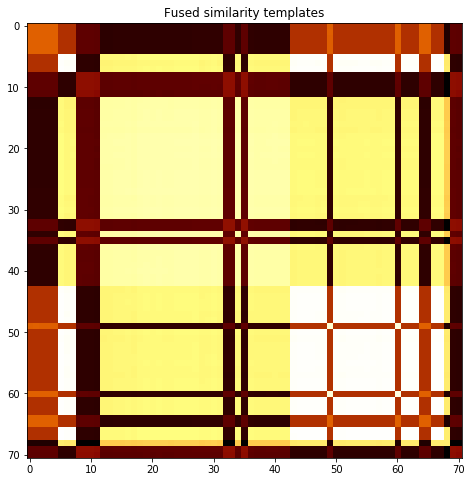

subject 03; gesture 3_1_1


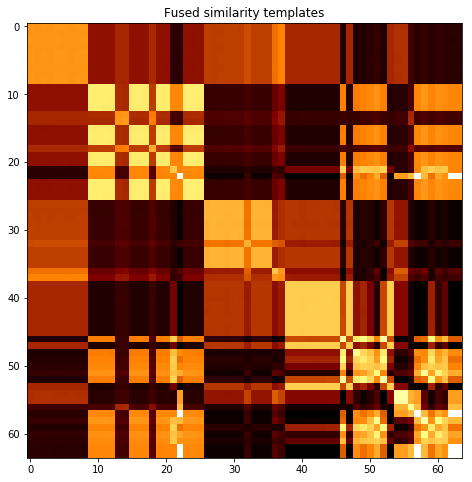

subject 03; gesture 1_0_2


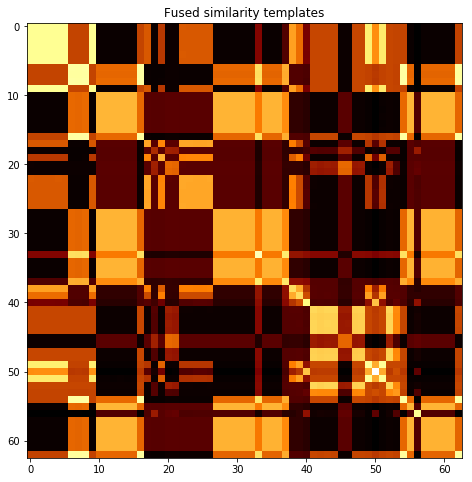

subject 03; gesture 4_0_2


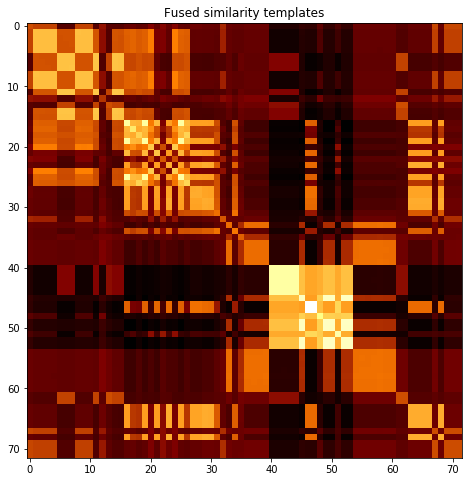

subject 05; gesture 3_0_1


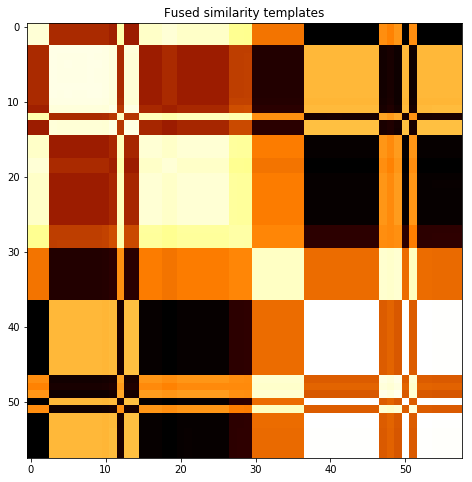

subject 05; gesture 4_1_1


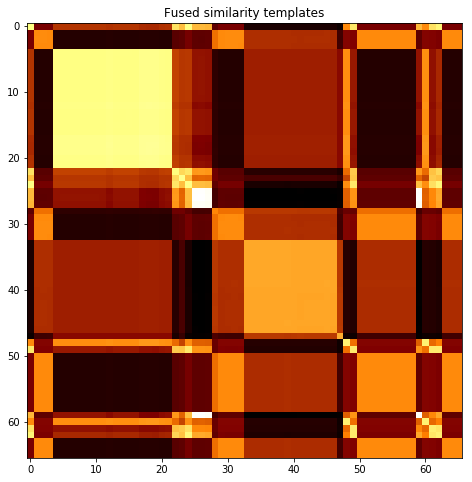

subject 05; gesture 2_0_1


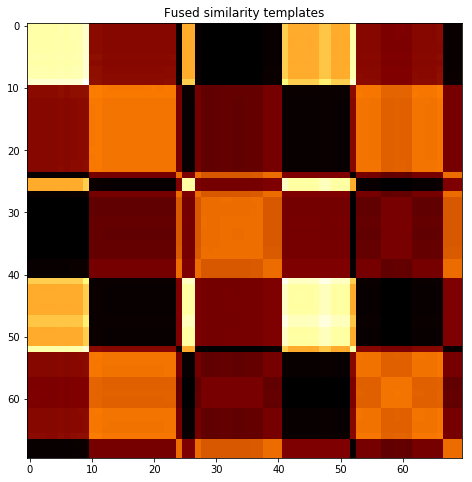

subject 05; gesture 4_1_2


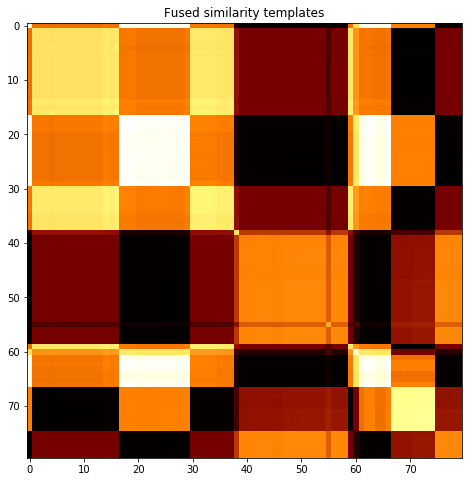

subject 05; gesture 2_0_2


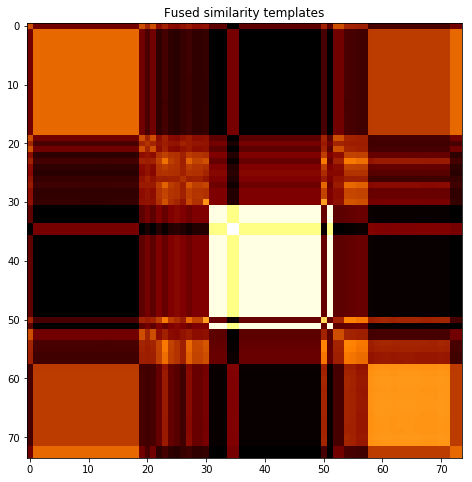

subject 05; gesture 1_1_2


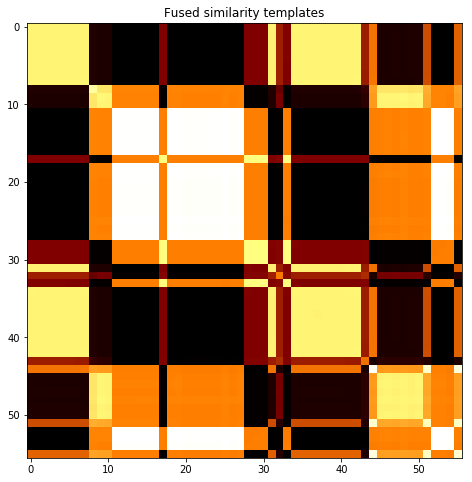

subject 05; gesture 2_1_2


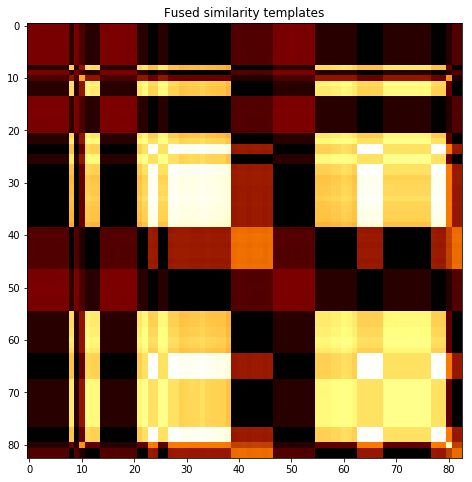

subject 05; gesture 4_0_1


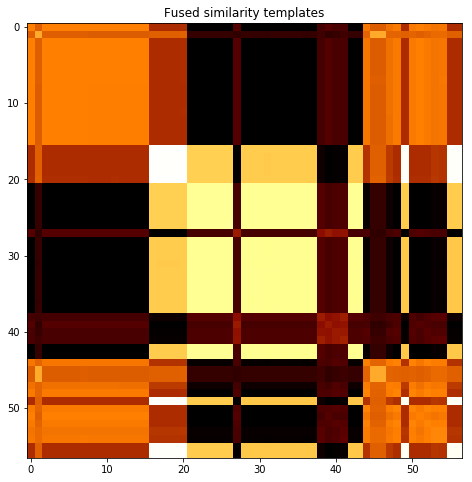

subject 05; gesture 3_0_2


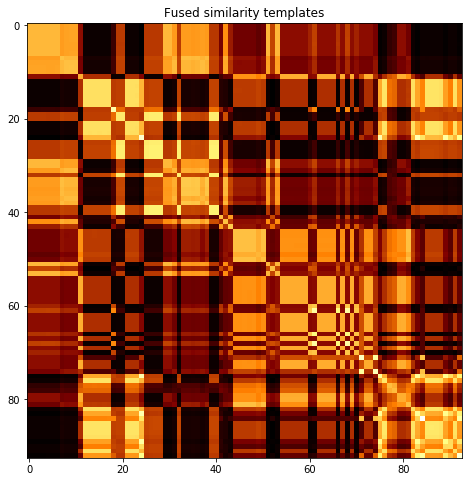

subject 05; gesture 1_1_1


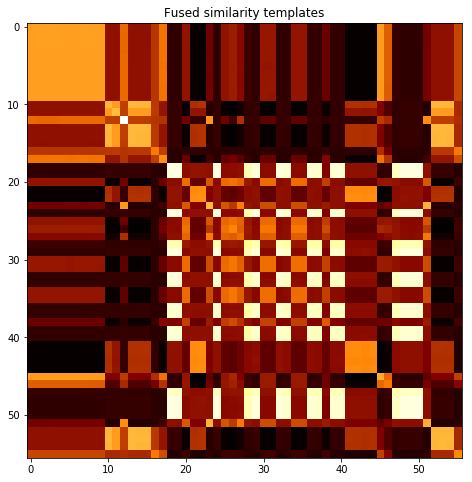

subject 05; gesture 3_1_2


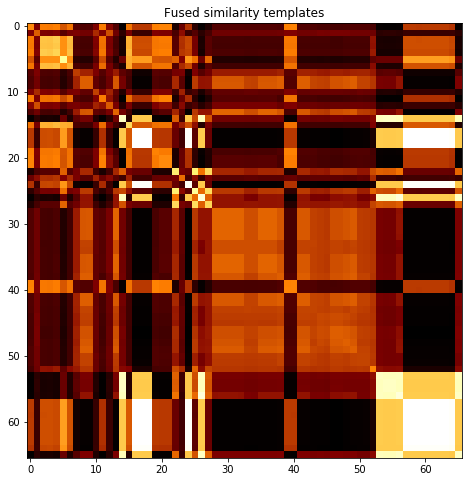

subject 05; gesture 2_1_1


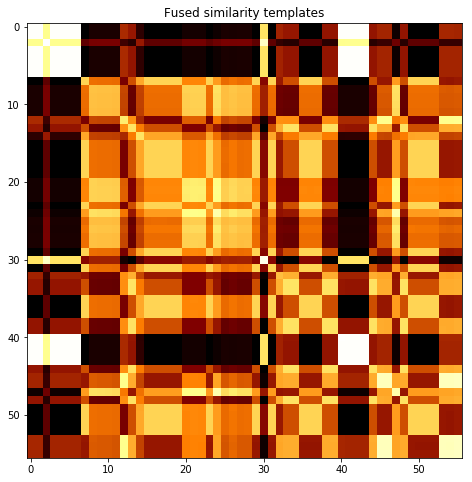

subject 05; gesture 1_0_1


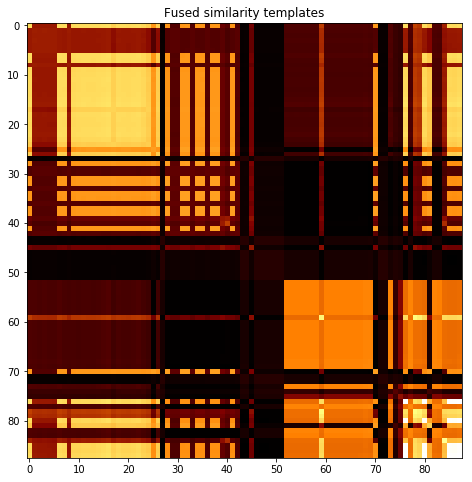

subject 05; gesture 3_1_1


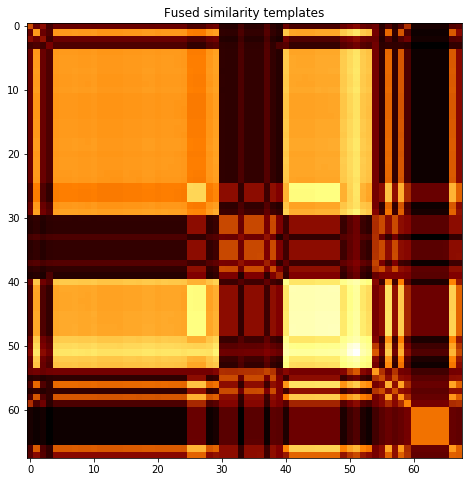

subject 05; gesture 1_0_2


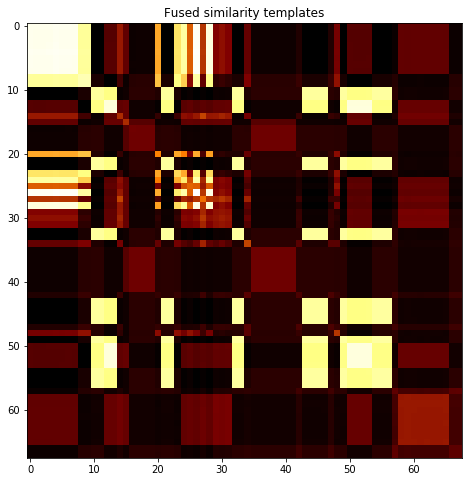

subject 05; gesture 4_0_2


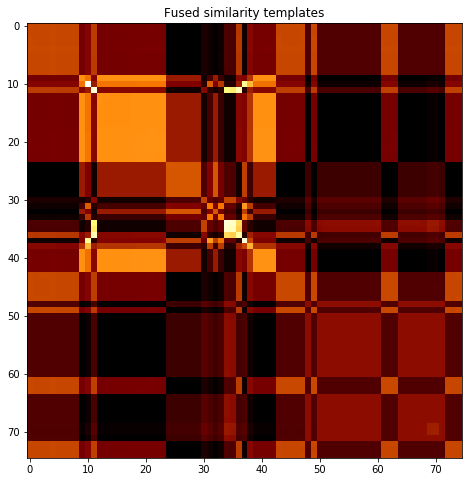

subject 21; gesture 3_0_1


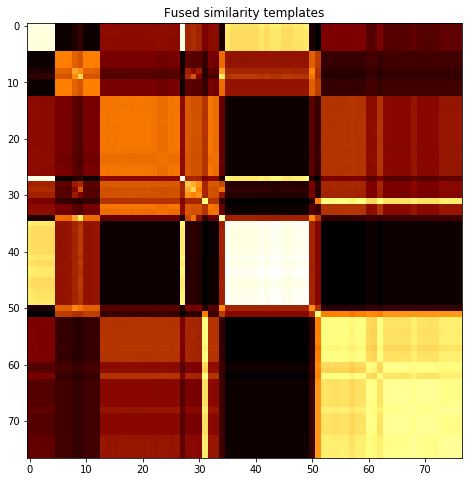

subject 21; gesture 4_1_1


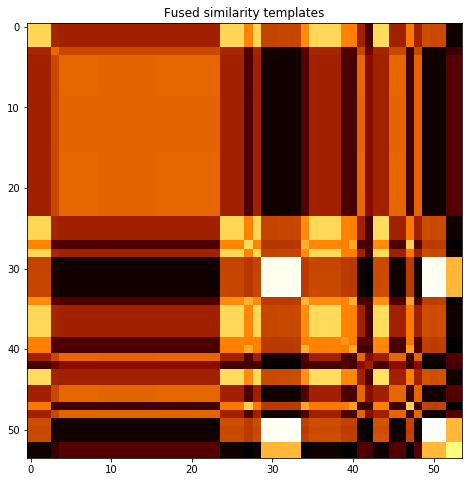

subject 21; gesture 2_0_1


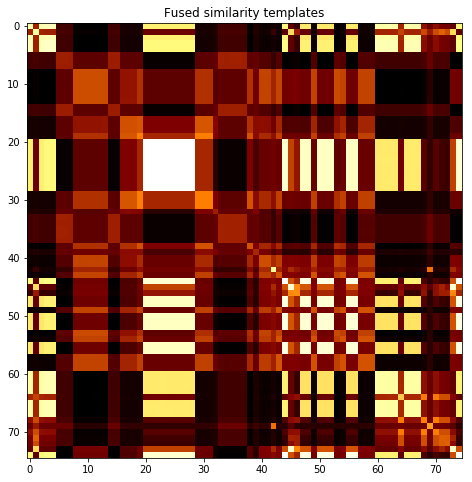

subject 21; gesture 4_1_2


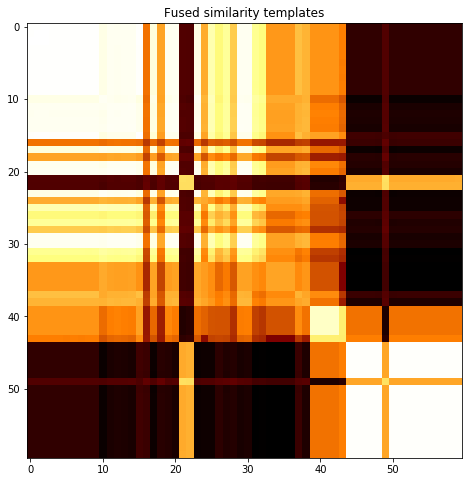

subject 21; gesture 2_0_2


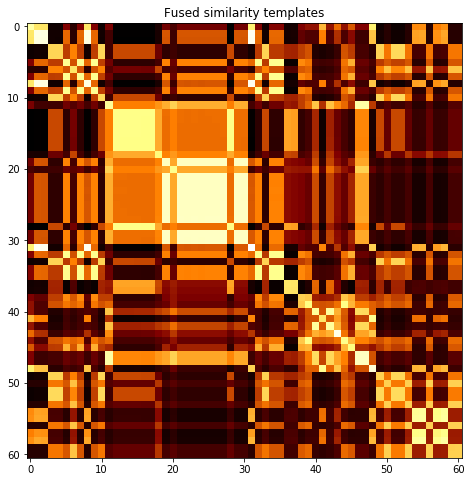

subject 21; gesture 1_1_2


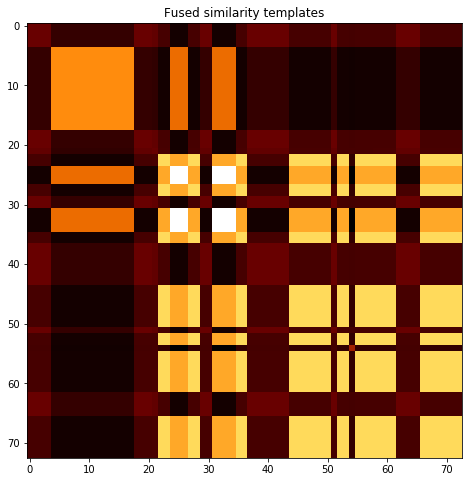

subject 21; gesture 2_1_2


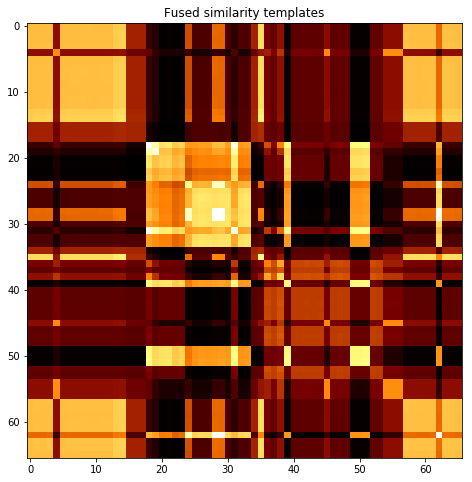

subject 21; gesture 4_0_1


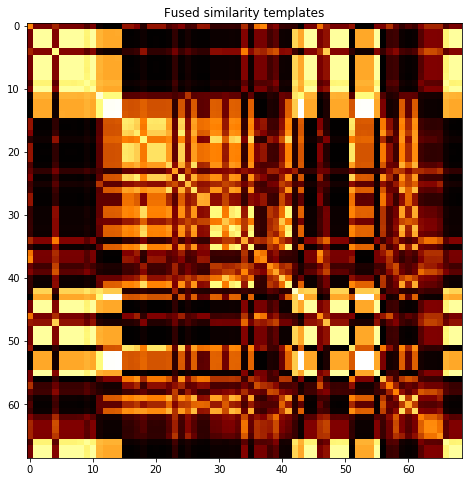

subject 21; gesture 3_0_2


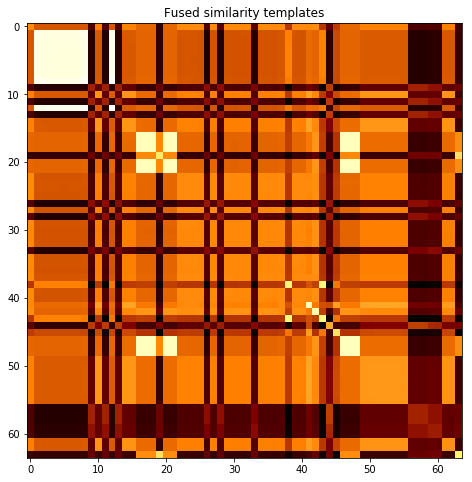

subject 21; gesture 1_1_1


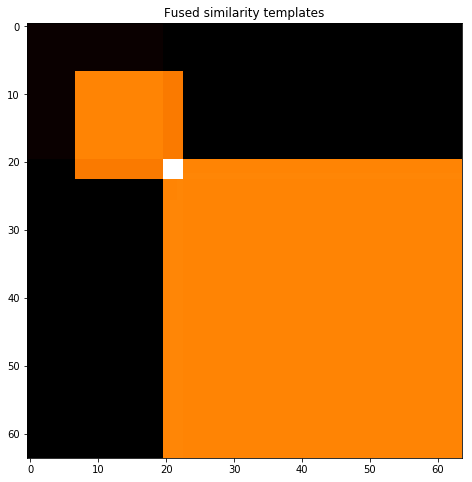

subject 21; gesture 3_1_2


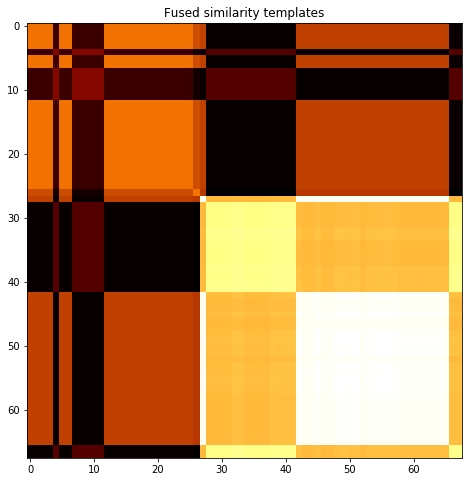

subject 21; gesture 2_1_1


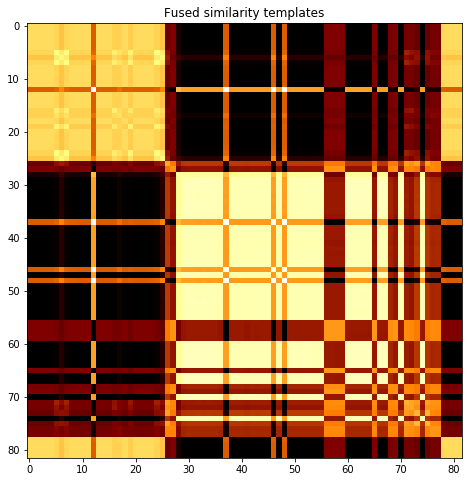

subject 21; gesture 1_0_1


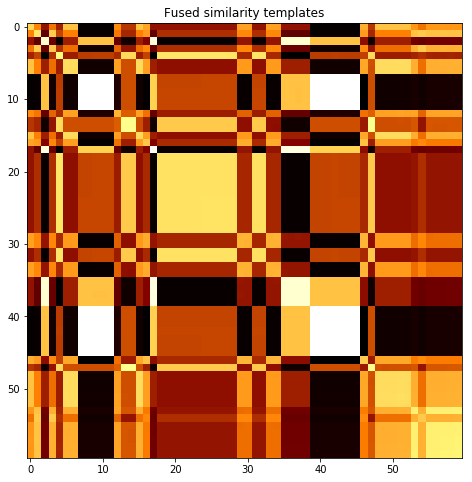

subject 21; gesture 3_1_1


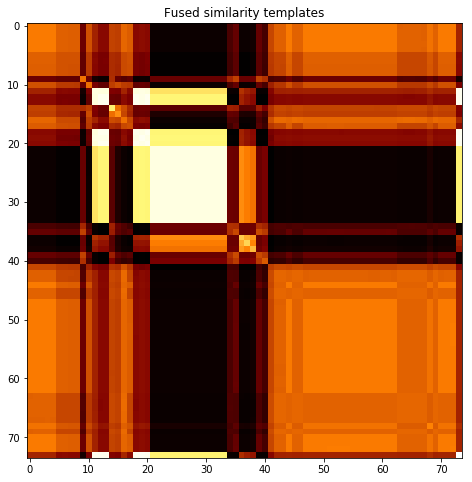

subject 21; gesture 1_0_2


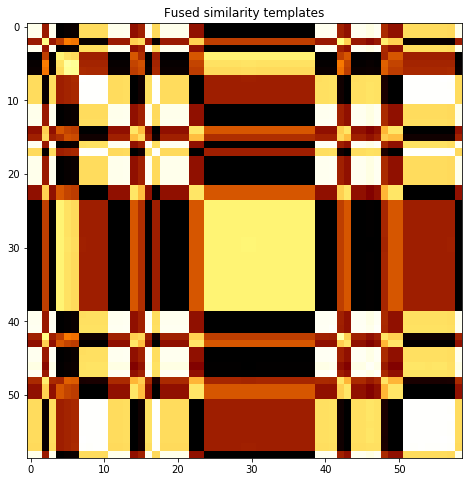

subject 21; gesture 4_0_2


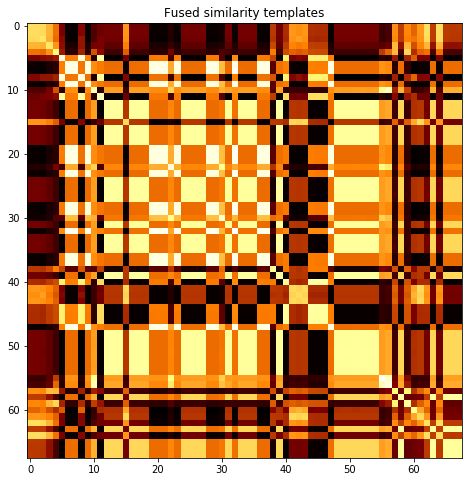

subject 17; gesture 3_0_1


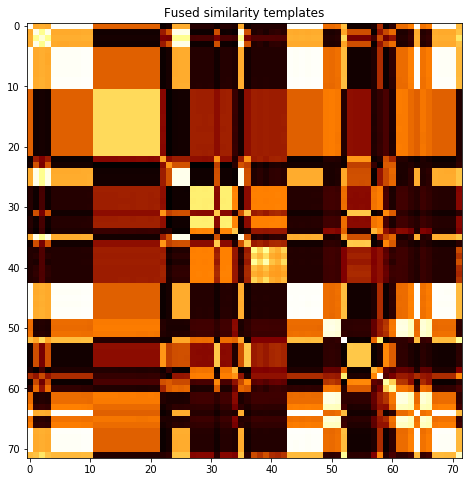

subject 17; gesture 4_1_1


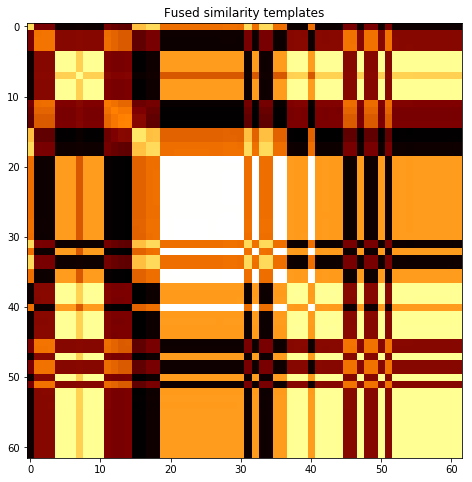

subject 17; gesture 2_0_1


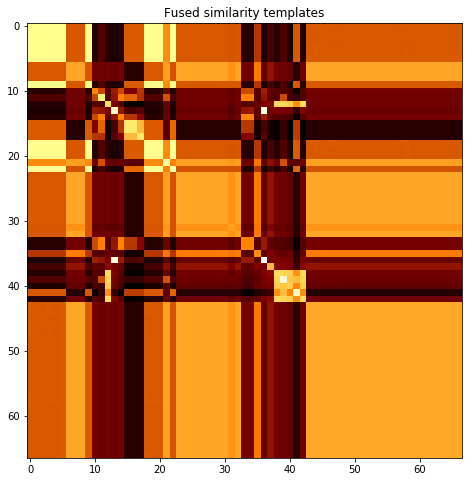

subject 17; gesture 4_1_2


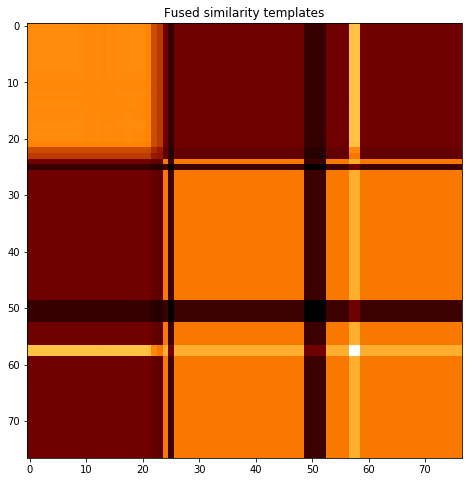

subject 17; gesture 2_0_2


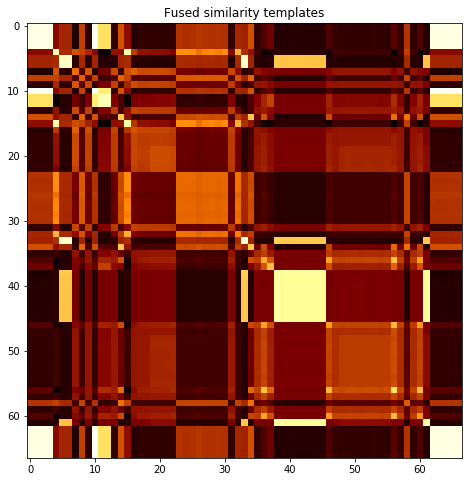

subject 17; gesture 1_1_2


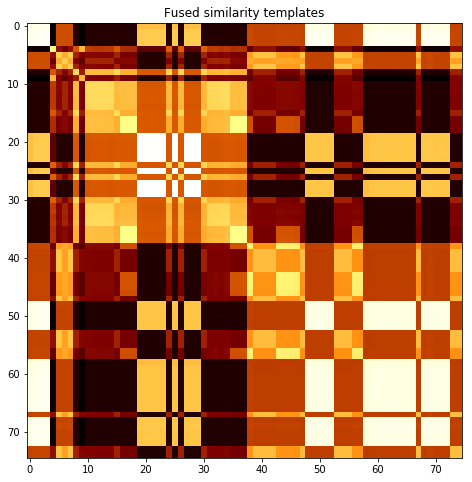

subject 17; gesture 2_1_2


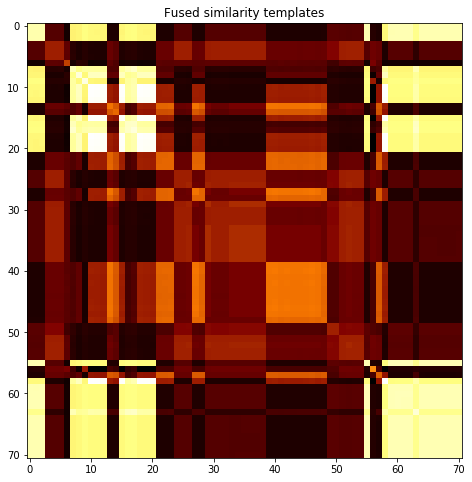

subject 17; gesture 4_0_1


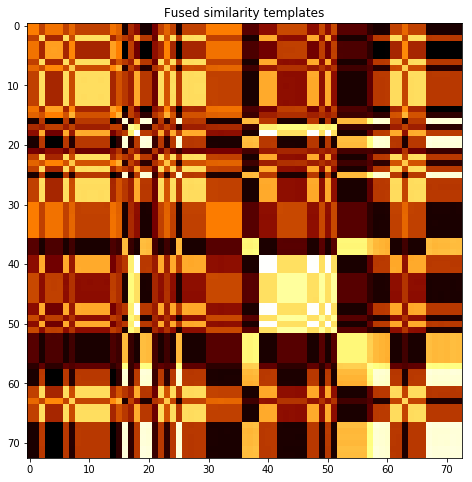

subject 17; gesture 3_0_2


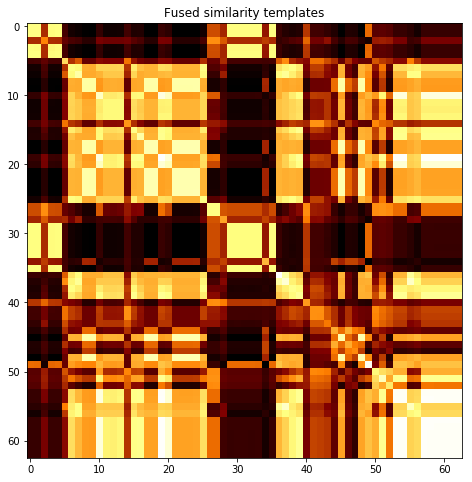

subject 17; gesture 1_1_1


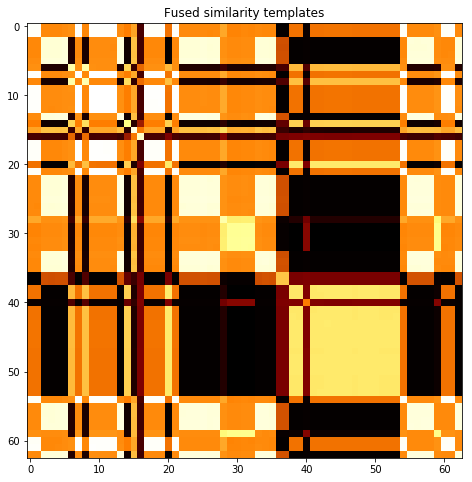

subject 17; gesture 3_1_2


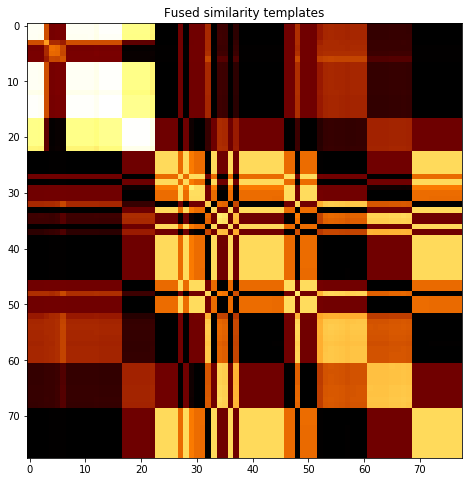

subject 17; gesture 2_1_1


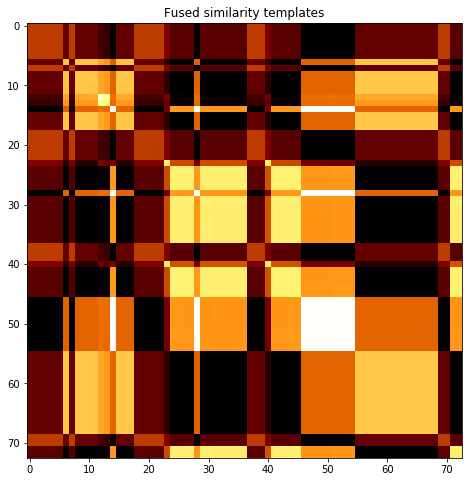

subject 17; gesture 1_0_1


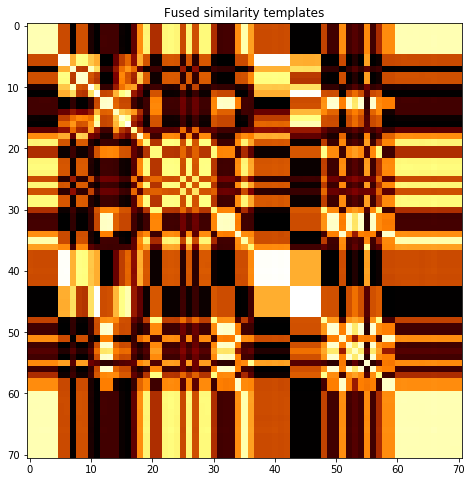

subject 17; gesture 3_1_1


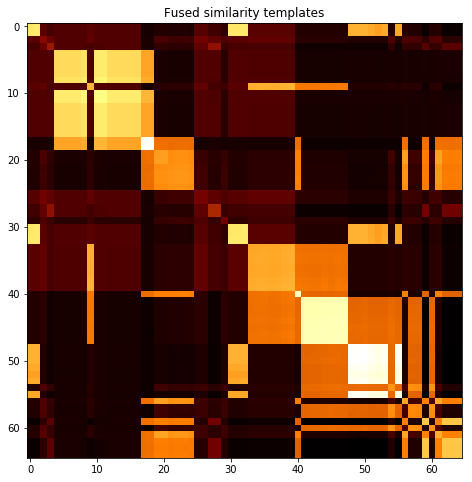

subject 17; gesture 1_0_2


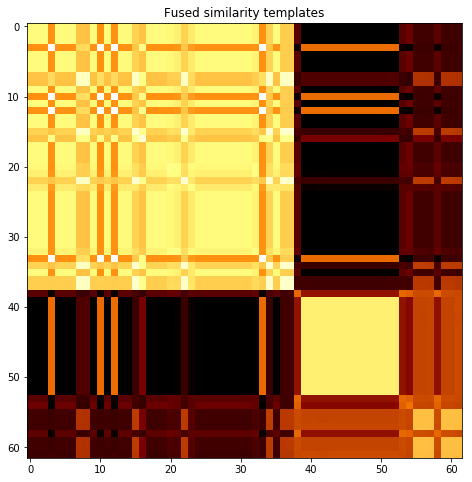

subject 17; gesture 4_0_2


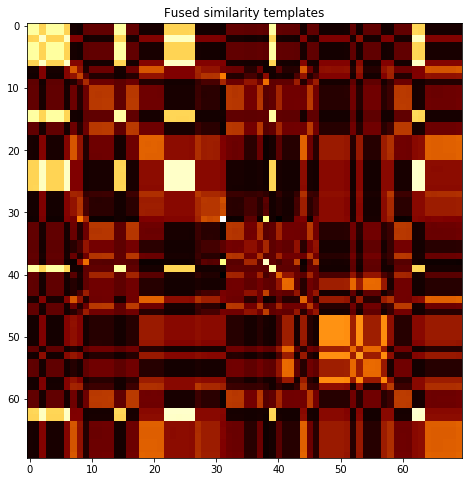

subject 01; gesture 3_0_1


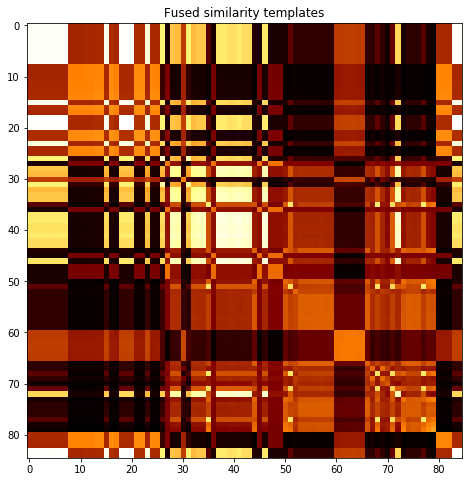

subject 01; gesture 4_1_1


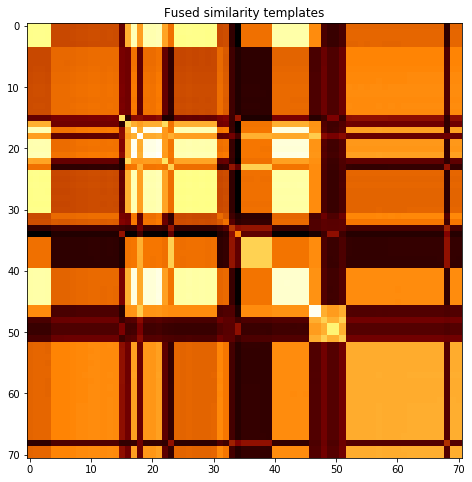

subject 01; gesture 2_0_1


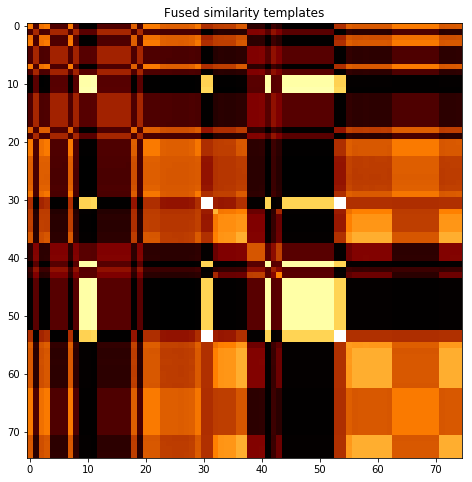

subject 01; gesture 4_1_2


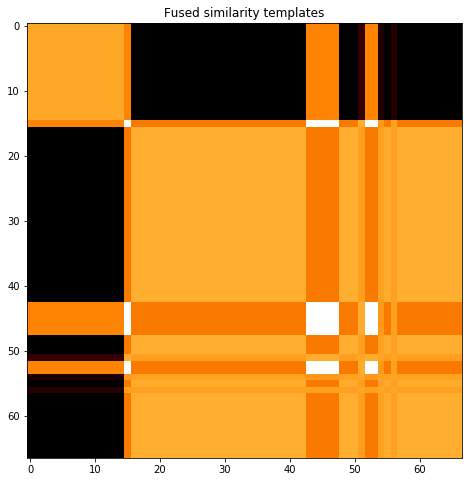

subject 01; gesture 2_0_2


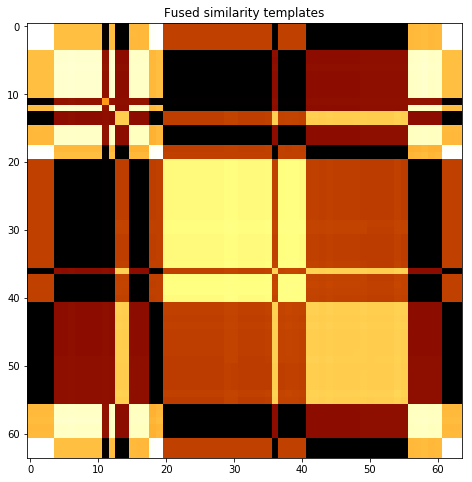

subject 01; gesture 1_1_2


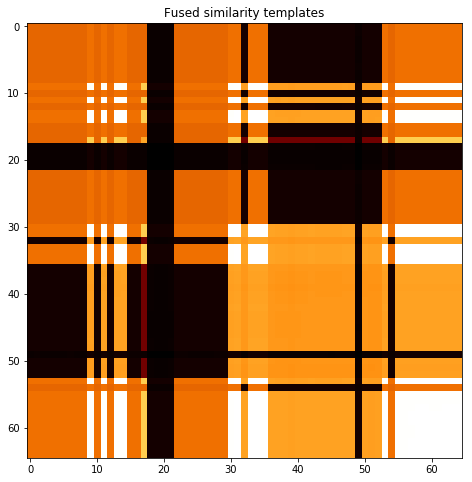

subject 01; gesture 2_1_2


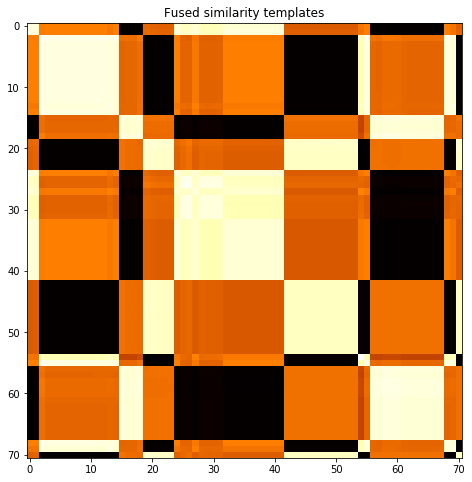

subject 01; gesture 4_0_1


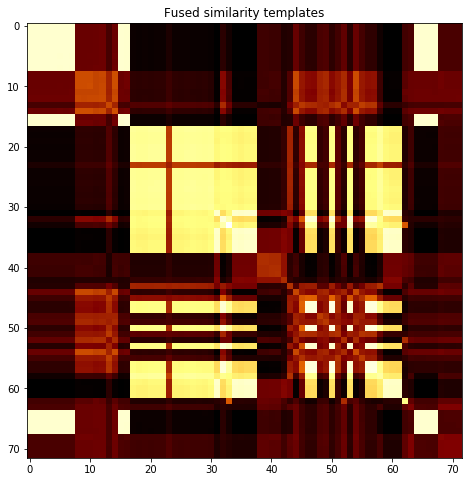

subject 01; gesture 3_0_2


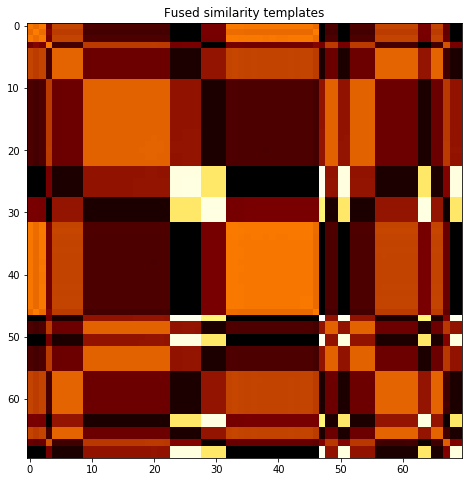

subject 01; gesture 1_1_1


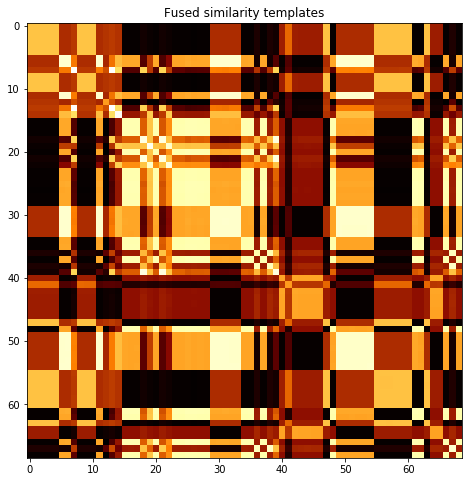

subject 01; gesture 3_1_2


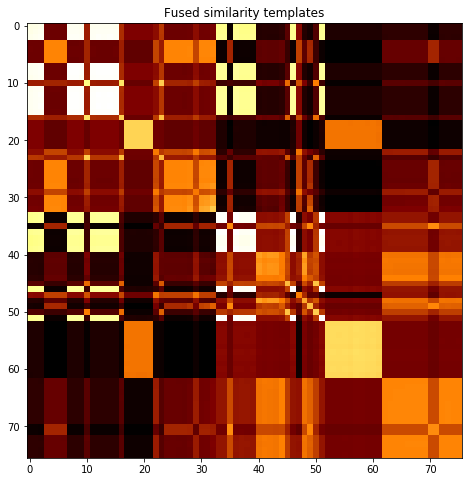

subject 01; gesture 2_1_1


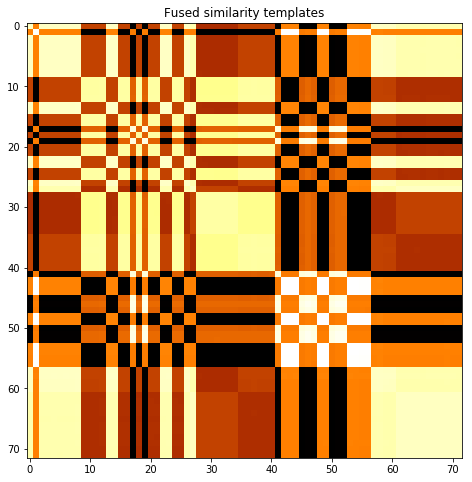

subject 01; gesture 1_0_1


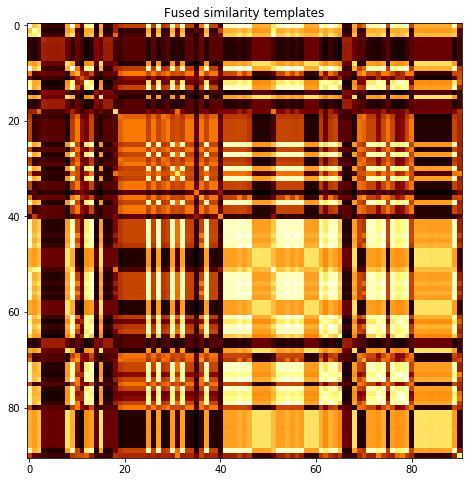

subject 01; gesture 3_1_1


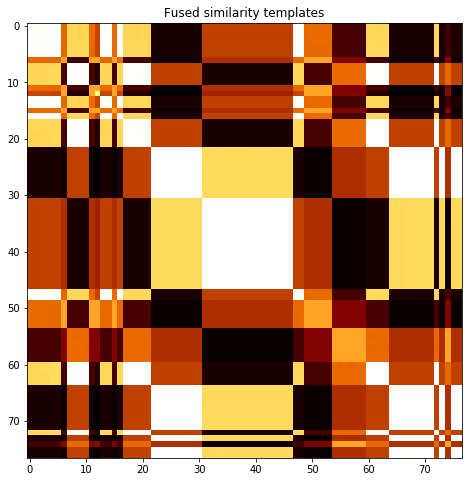

subject 01; gesture 1_0_2


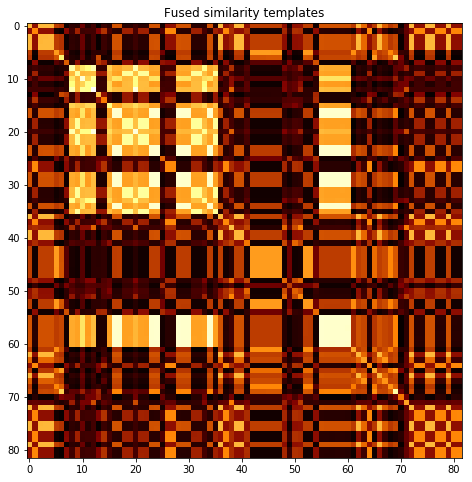

subject 01; gesture 4_0_2


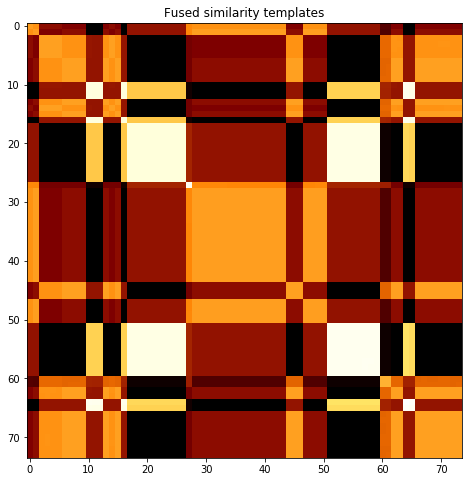

subject 16; gesture 3_0_1


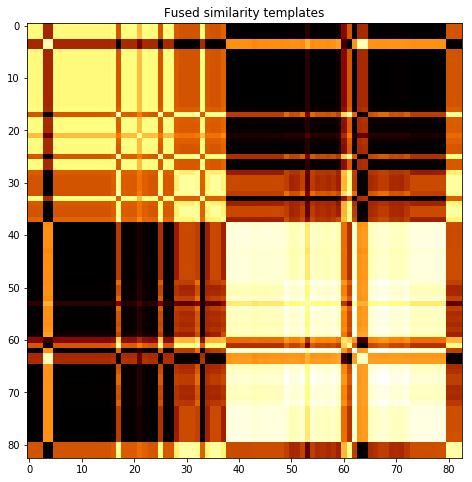

subject 16; gesture 4_1_1


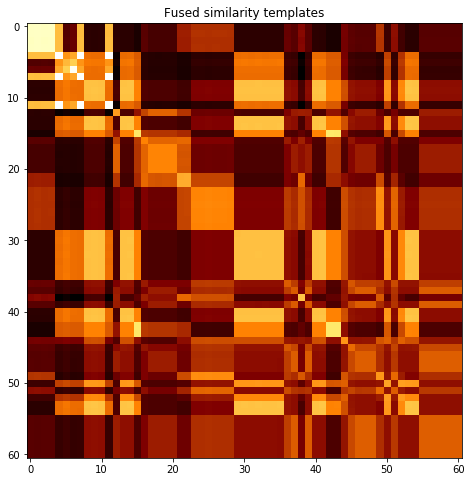

subject 16; gesture 2_0_1


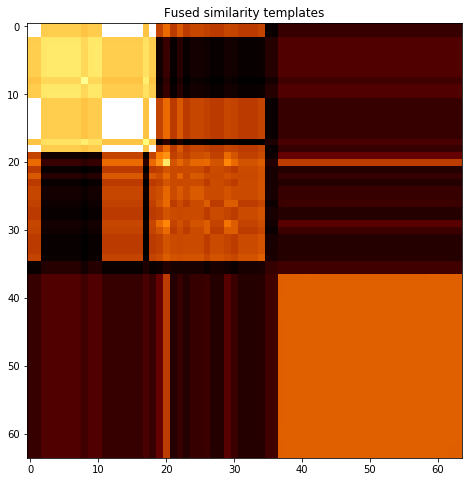

subject 16; gesture 4_1_2


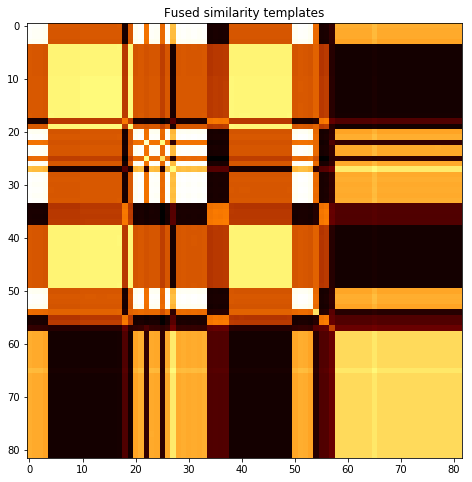

subject 16; gesture 2_0_2


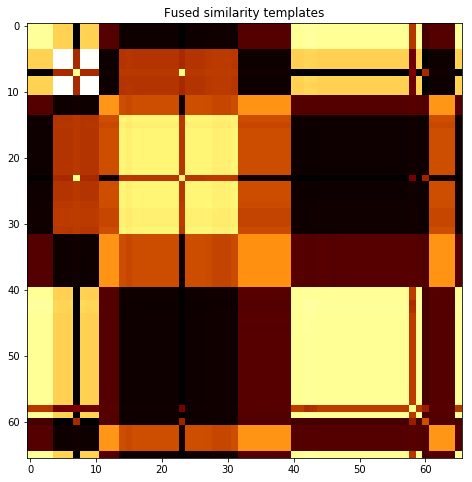

subject 16; gesture 1_1_2


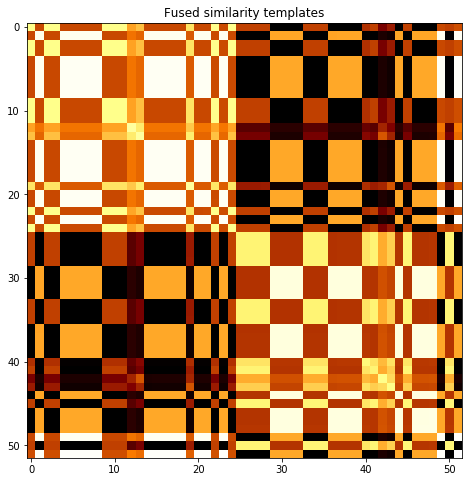

subject 16; gesture 2_1_2


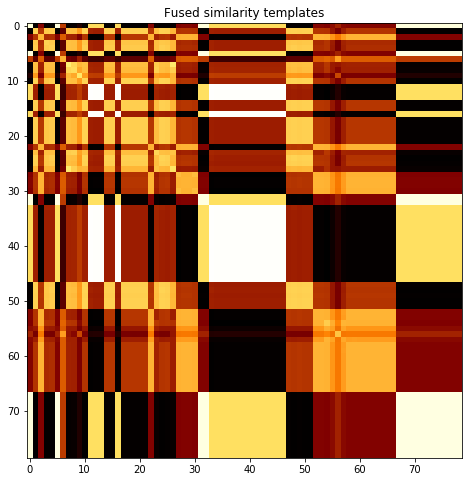

subject 16; gesture 4_0_1


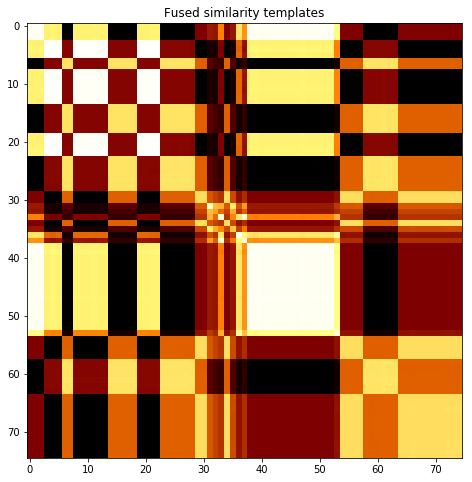

subject 16; gesture 3_0_2


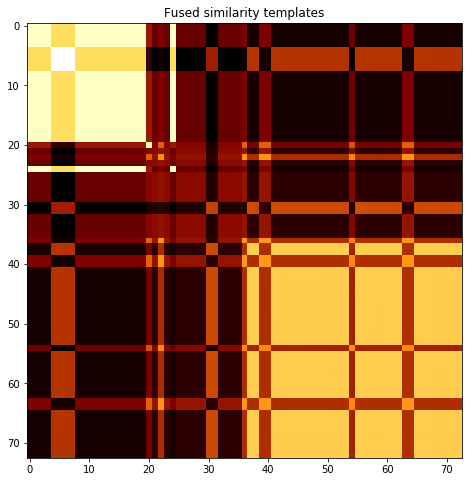

subject 16; gesture 1_1_1


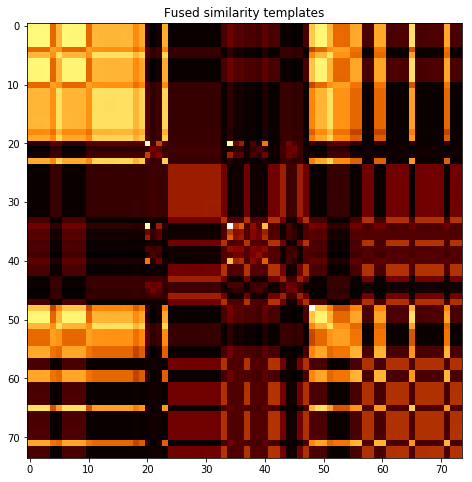

subject 16; gesture 3_1_2


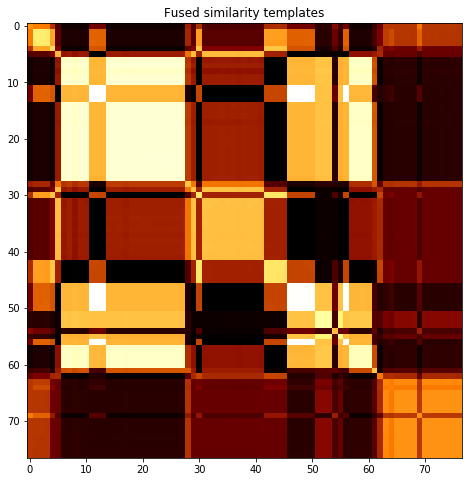

subject 16; gesture 2_1_1


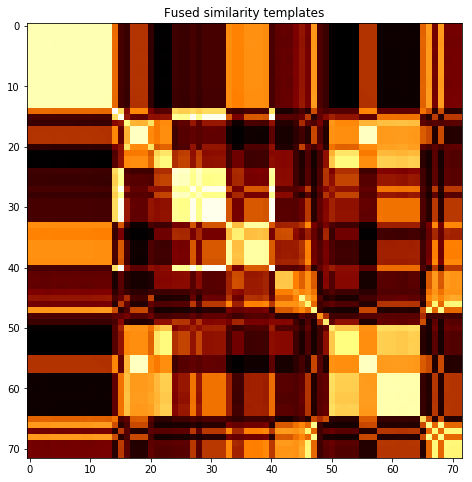

subject 16; gesture 1_0_1


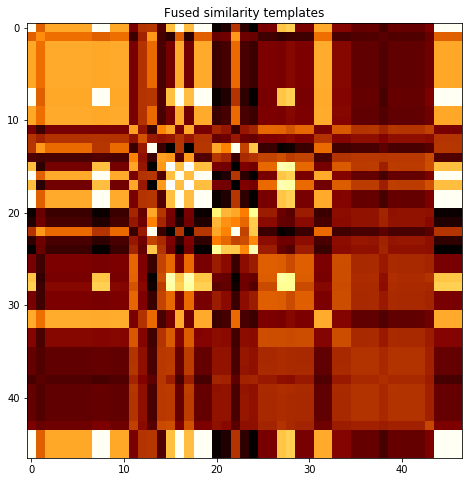

subject 16; gesture 3_1_1


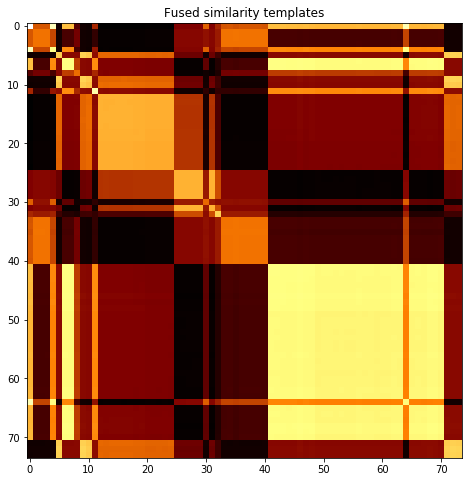

subject 16; gesture 1_0_2


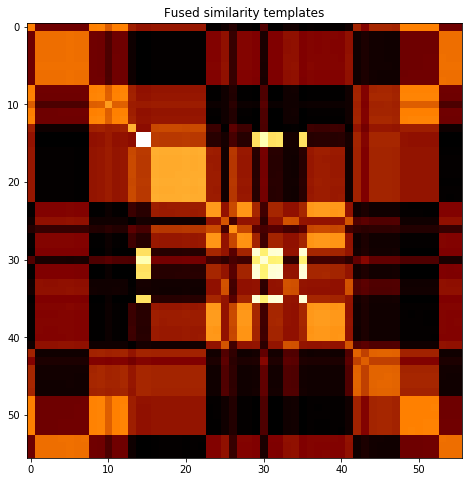

subject 16; gesture 4_0_2


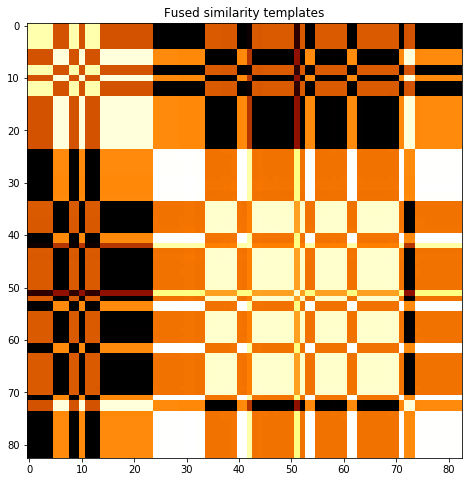

subject 26; gesture 3_0_1


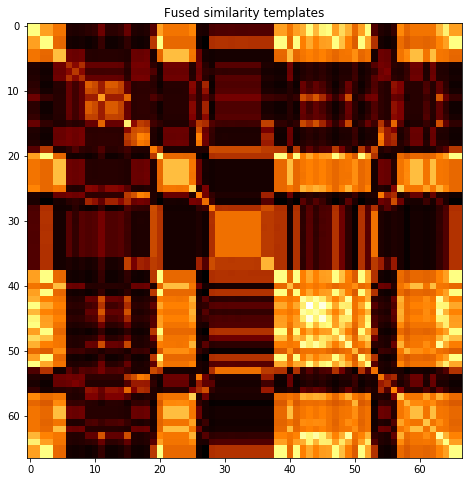

subject 26; gesture 4_1_1


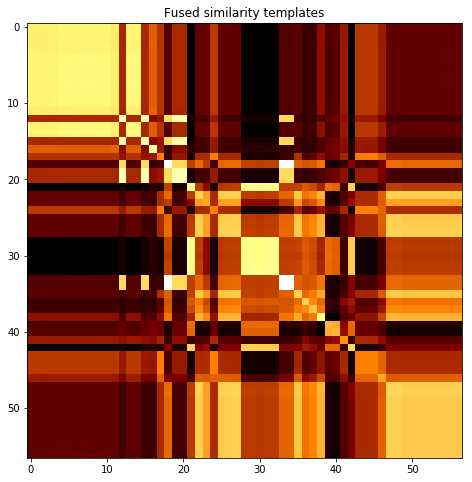

subject 26; gesture 2_0_1


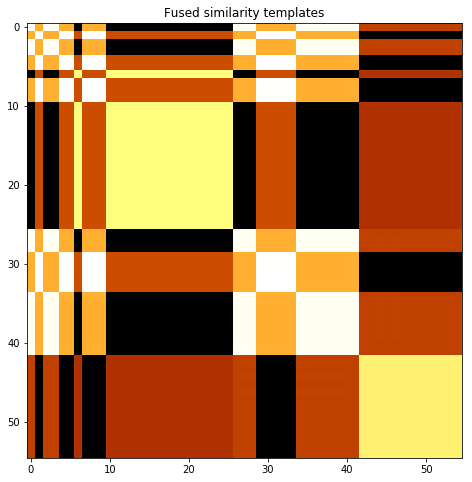

subject 26; gesture 4_1_2


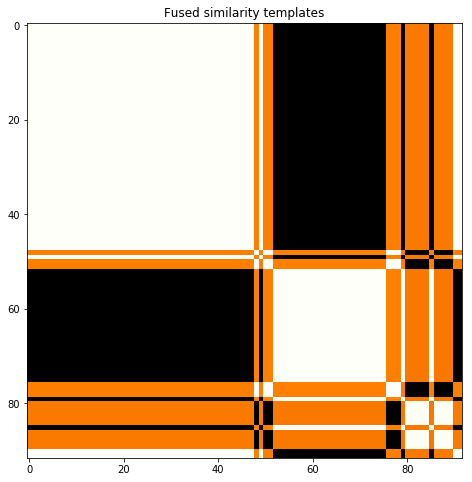

subject 26; gesture 2_0_2


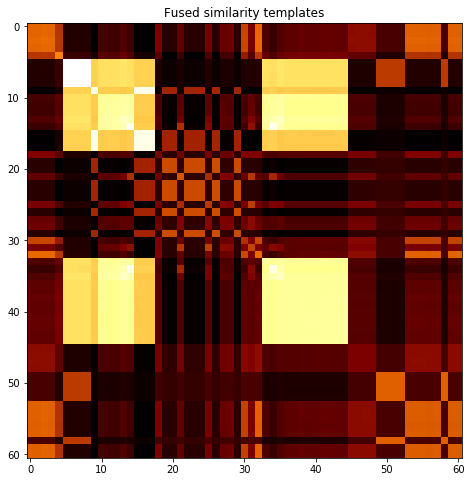

subject 26; gesture 1_1_2


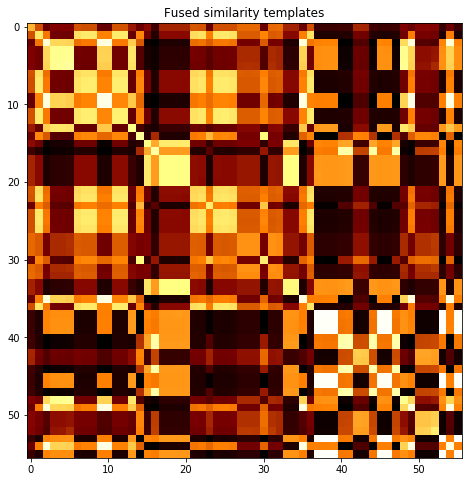

subject 26; gesture 2_1_2


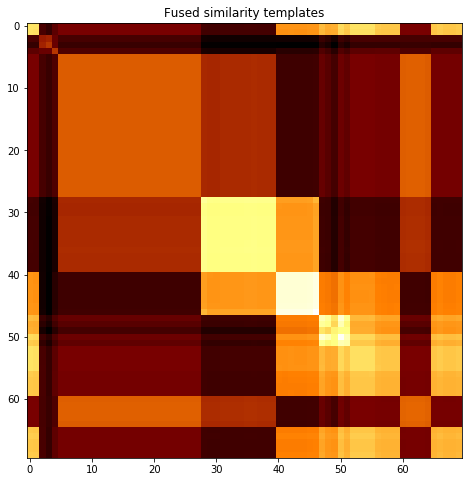

subject 26; gesture 4_0_1


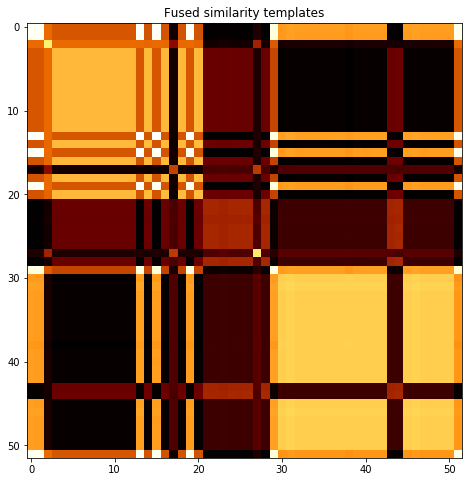

subject 26; gesture 3_0_2


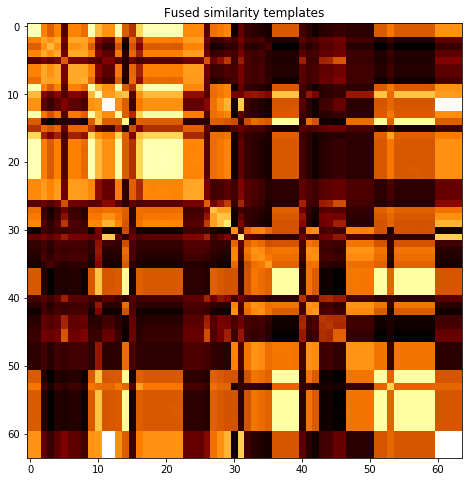

subject 26; gesture 1_1_1


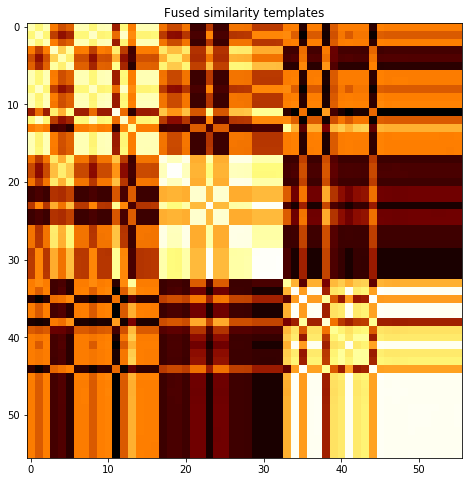

subject 26; gesture 3_1_2


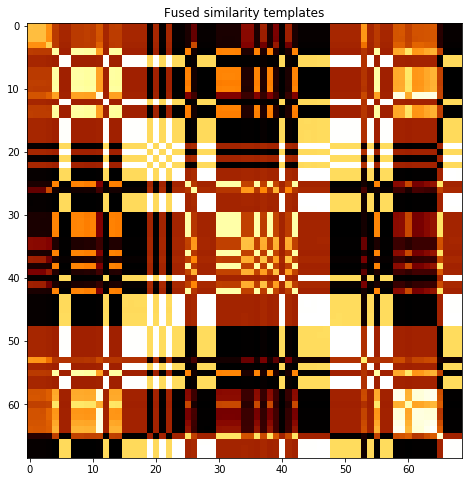

subject 26; gesture 2_1_1


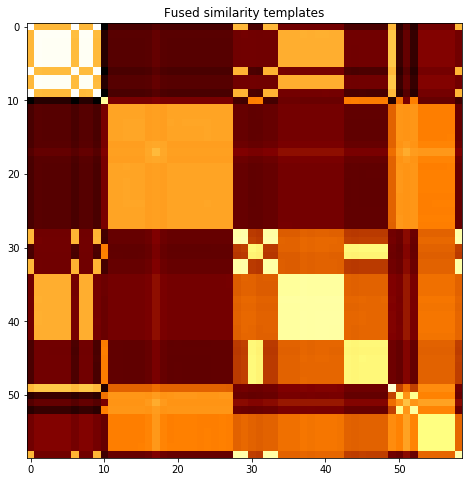

subject 26; gesture 1_0_1


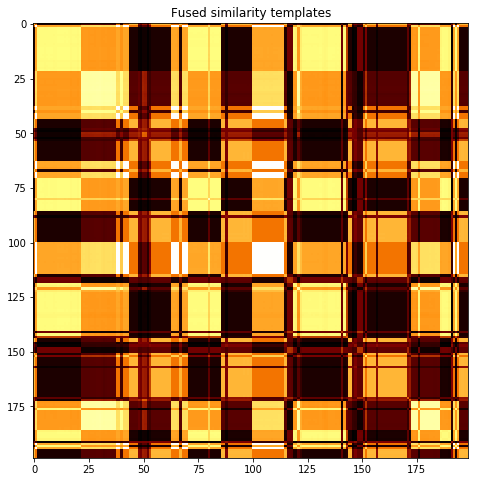

subject 26; gesture 3_1_1


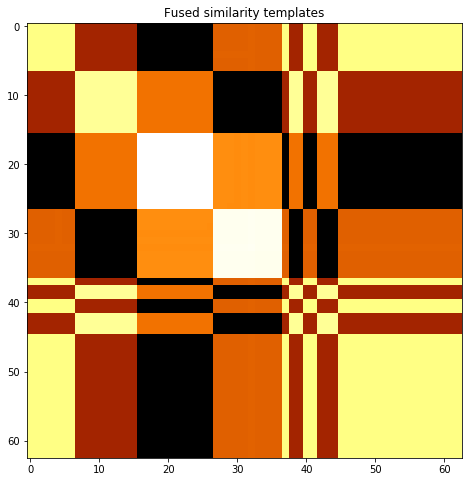

subject 26; gesture 1_0_2


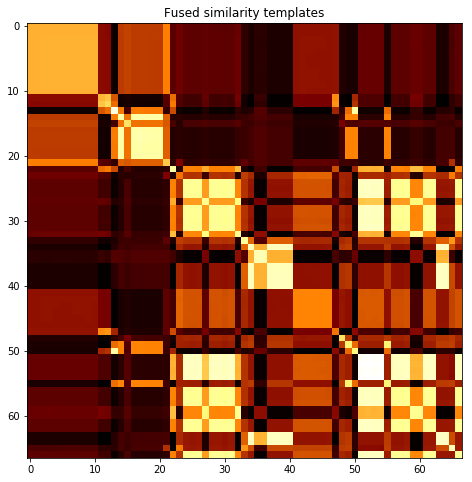

subject 26; gesture 4_0_2


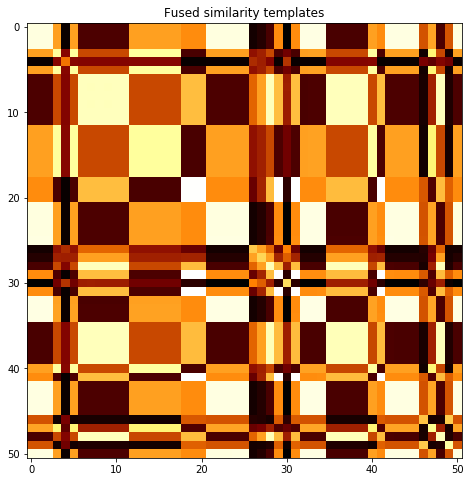

subject 32; gesture 3_0_1


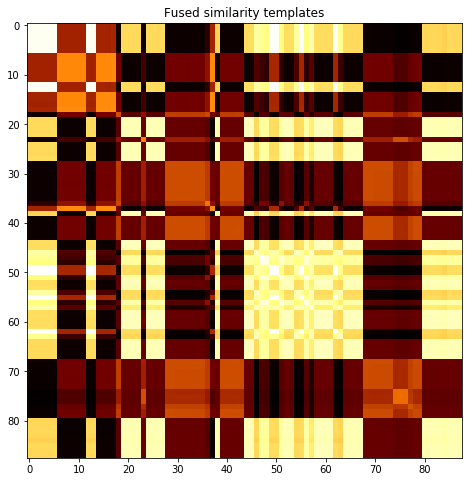

subject 32; gesture 4_1_1


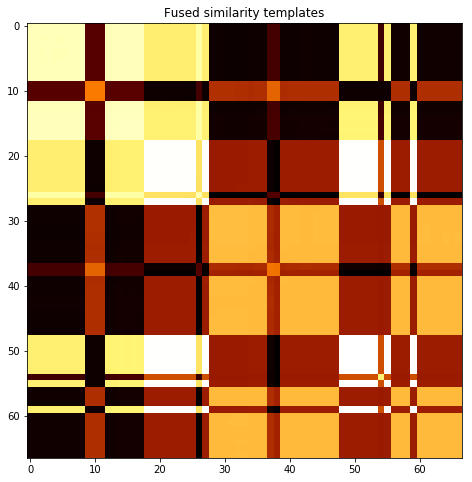

subject 32; gesture 2_0_1


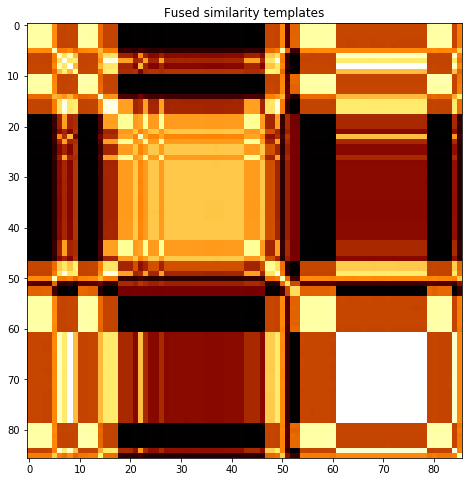

subject 32; gesture 4_1_2


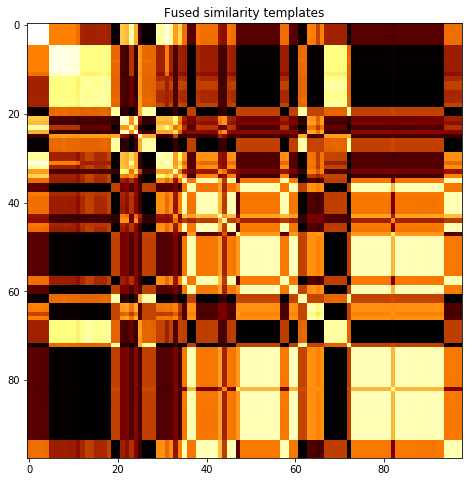

subject 32; gesture 2_0_2


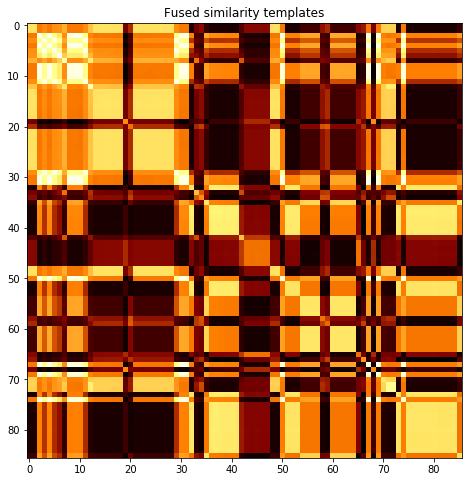

subject 32; gesture 1_1_2


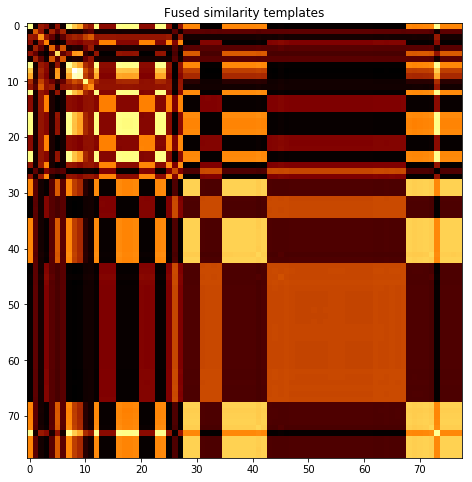

subject 32; gesture 2_1_2


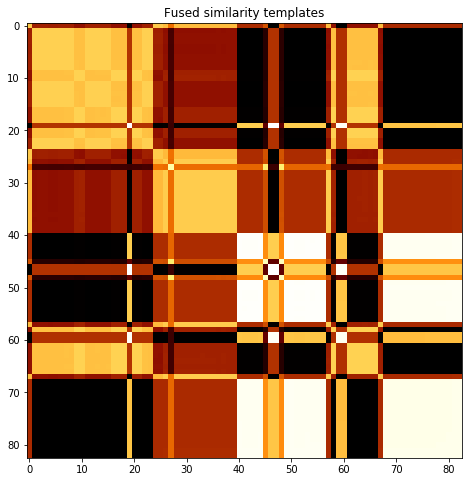

subject 32; gesture 4_0_1


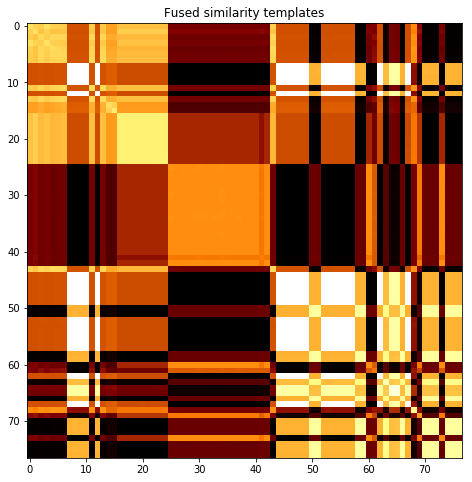

subject 32; gesture 3_0_2


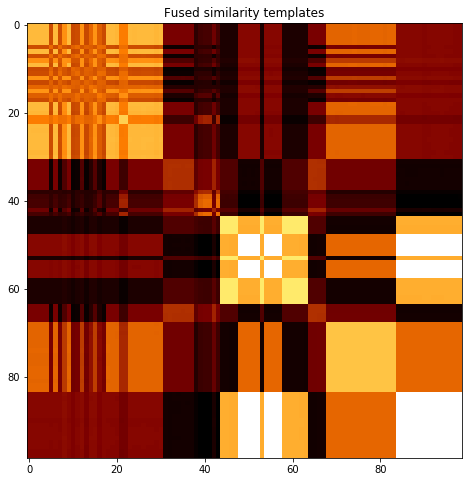

subject 32; gesture 1_1_1


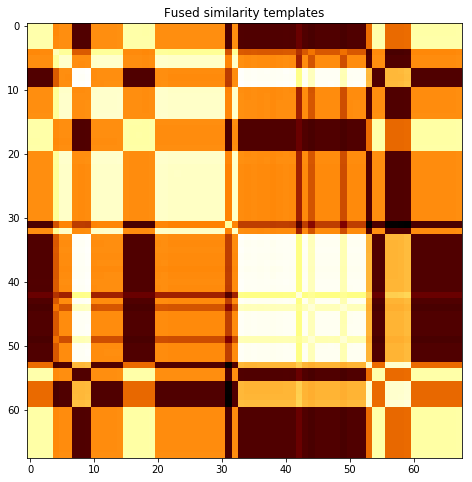

subject 32; gesture 3_1_2


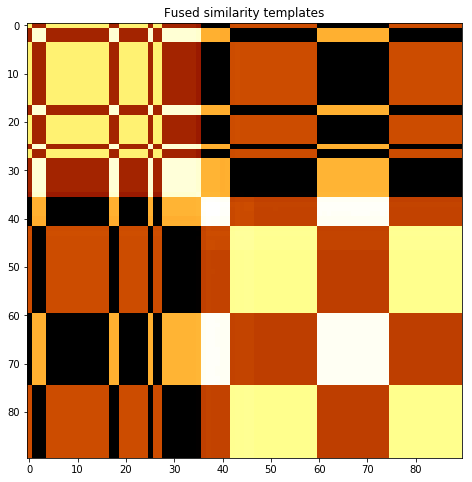

subject 32; gesture 2_1_1


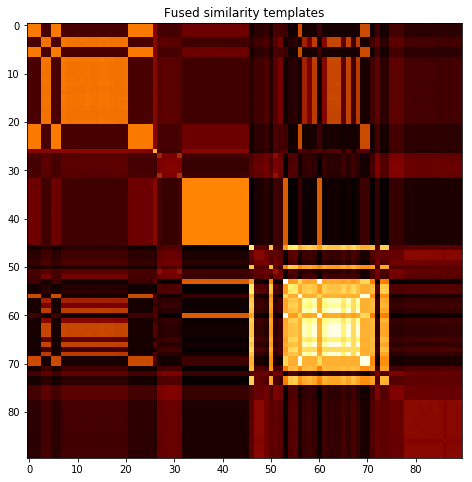

subject 32; gesture 1_0_1


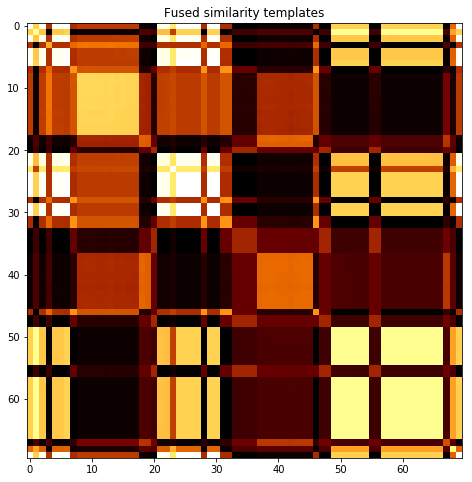

subject 32; gesture 3_1_1


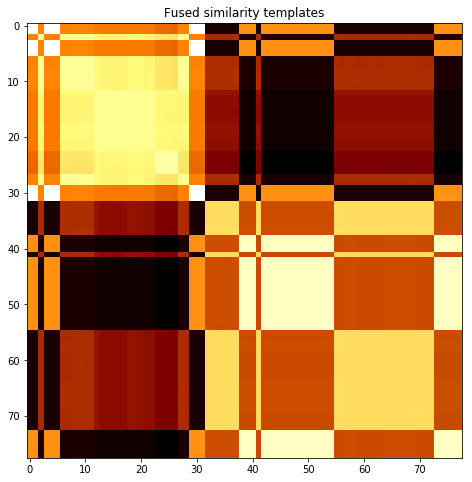

subject 32; gesture 1_0_2


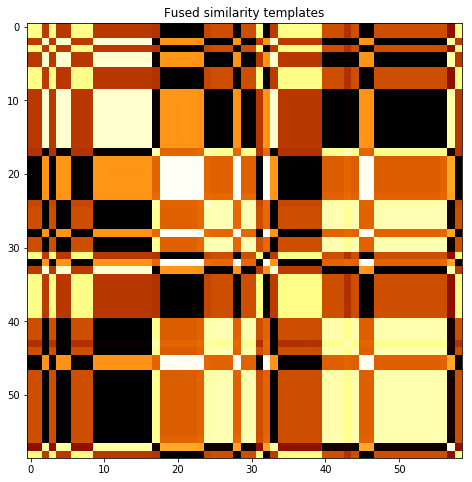

subject 32; gesture 4_0_2


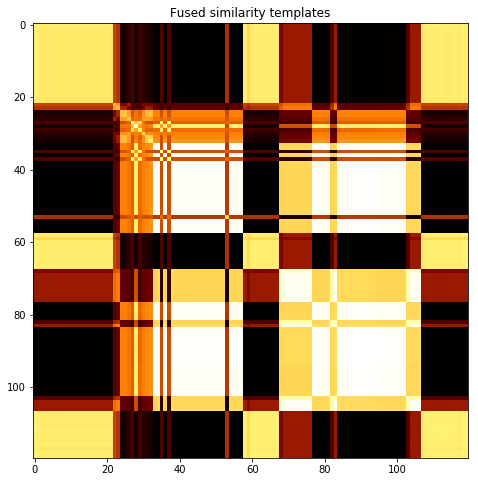

subject 04; gesture 3_0_1


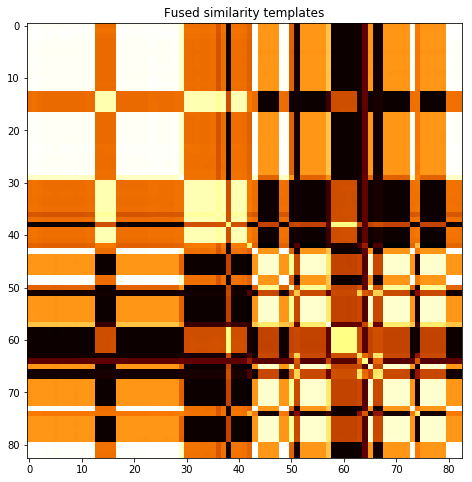

subject 04; gesture 4_1_1


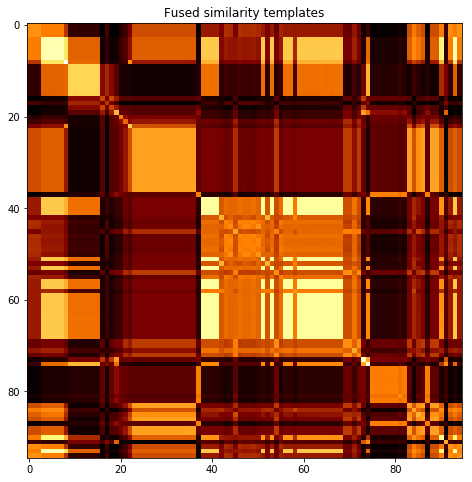

subject 04; gesture 2_0_1


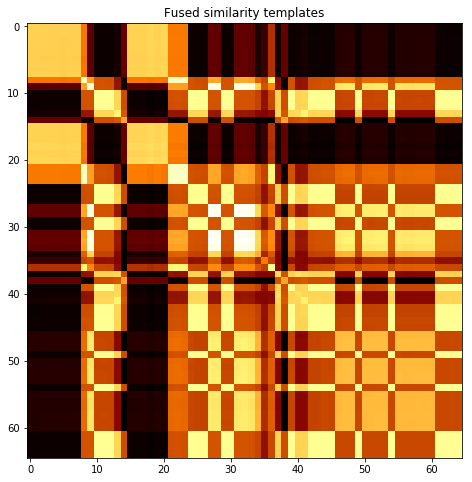

subject 04; gesture 4_1_2


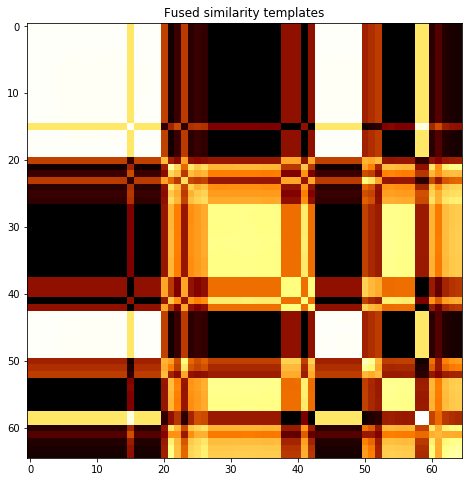

subject 04; gesture 2_0_2


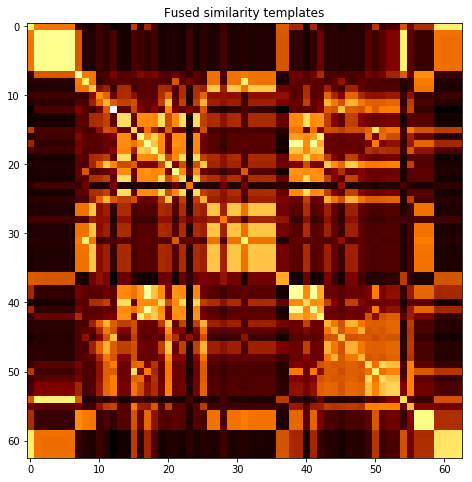

subject 04; gesture 1_1_2


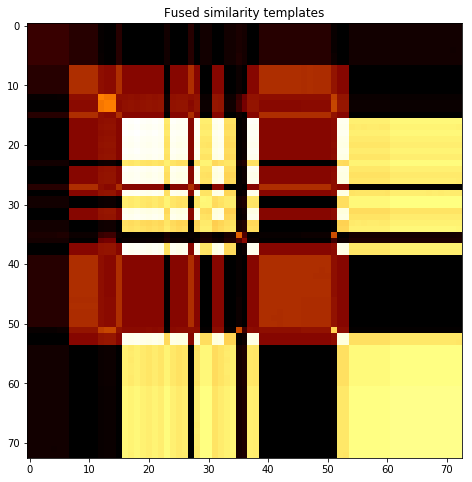

subject 04; gesture 2_1_2


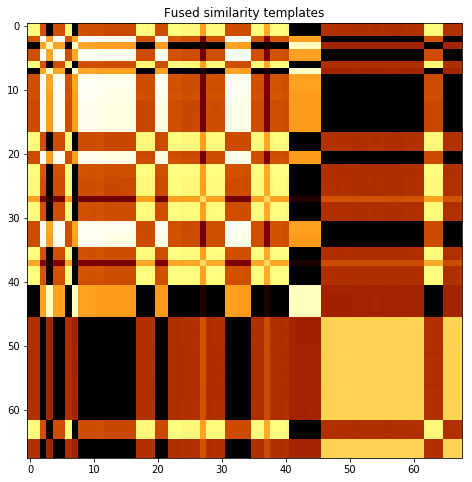

subject 04; gesture 4_0_1


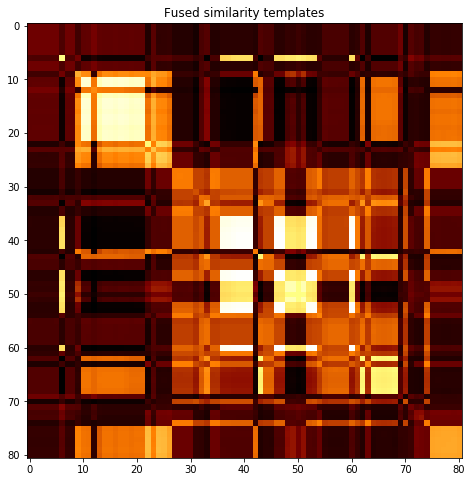

subject 04; gesture 3_0_2


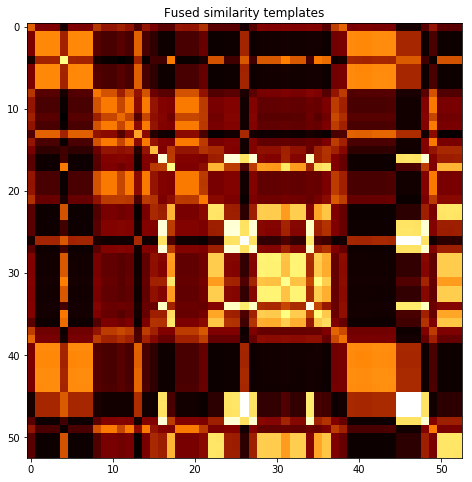

subject 04; gesture 1_1_1


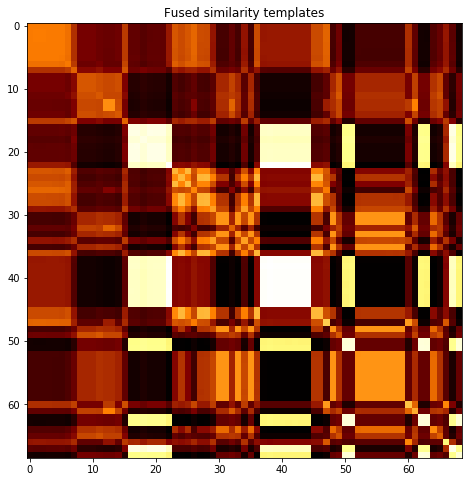

subject 04; gesture 3_1_2


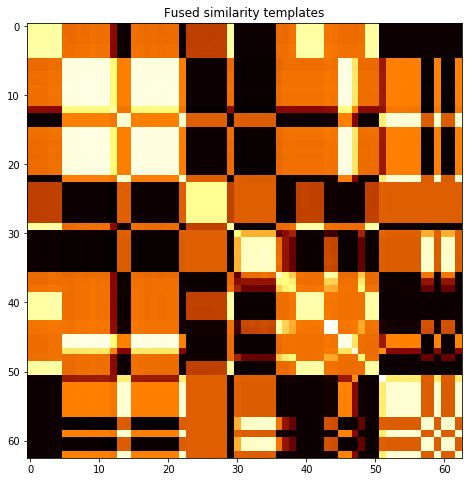

subject 04; gesture 2_1_1


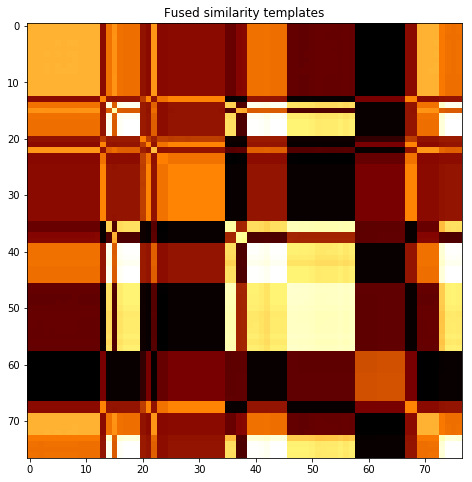

subject 04; gesture 1_0_1


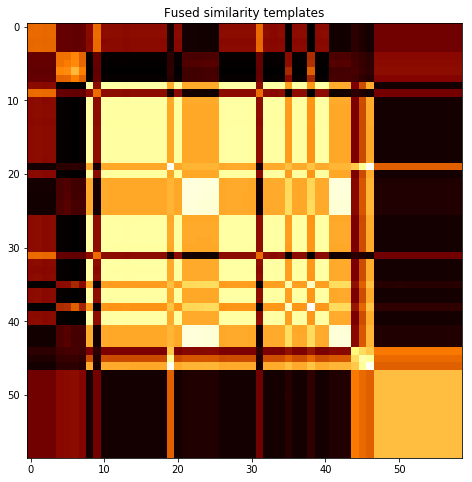

subject 04; gesture 3_1_1


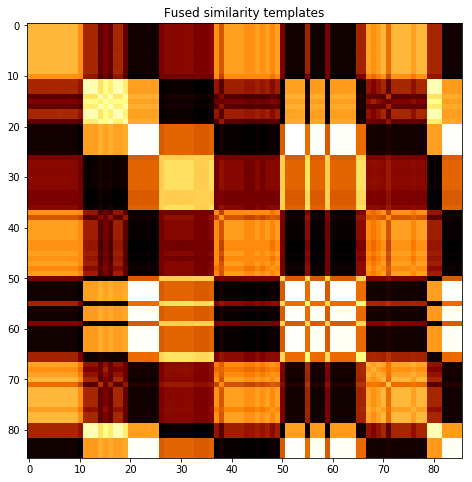

subject 04; gesture 1_0_2


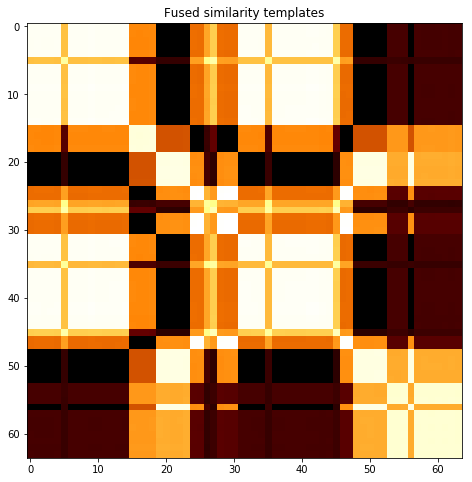

subject 04; gesture 4_0_2


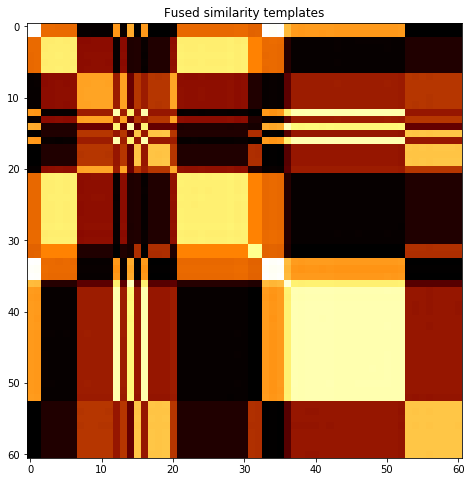

subject 08; gesture 3_0_1


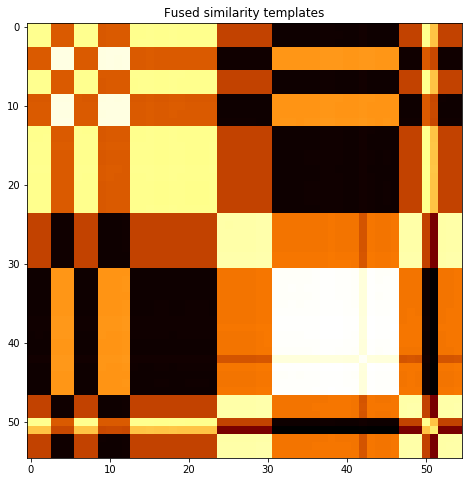

subject 08; gesture 4_1_1


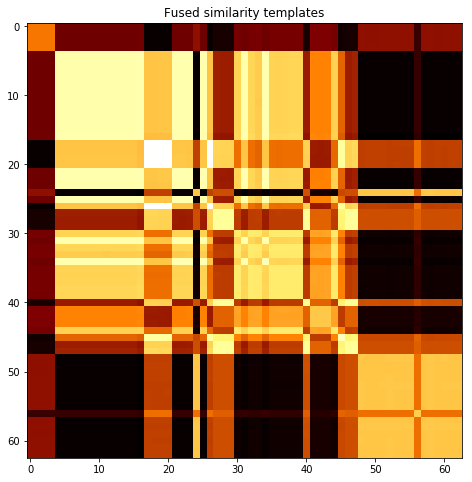

subject 08; gesture 2_0_1


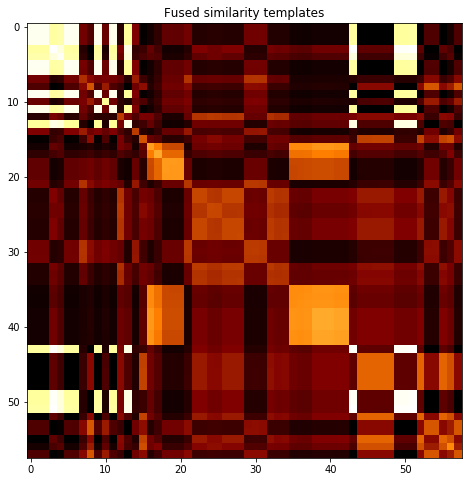

subject 08; gesture 4_1_2


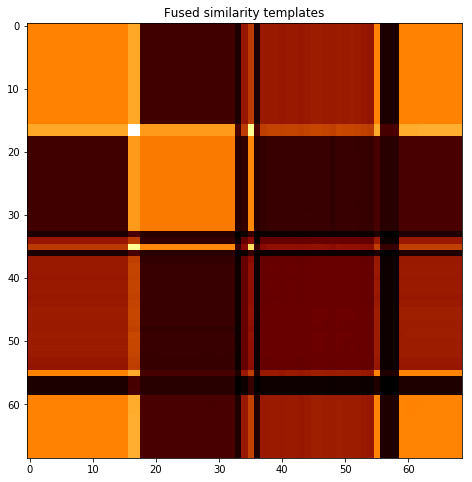

subject 08; gesture 2_0_2


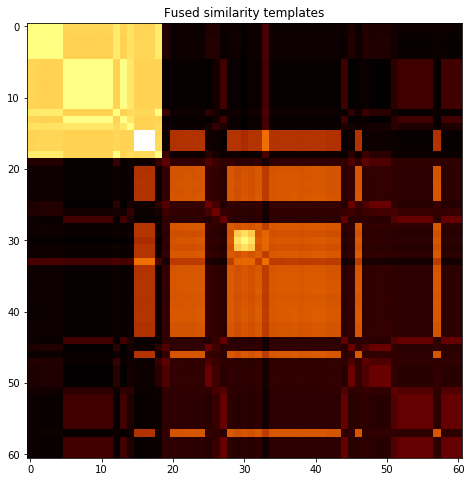

subject 08; gesture 1_1_2


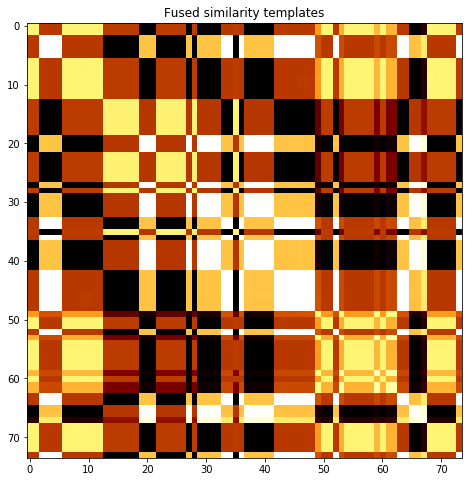

subject 08; gesture 2_1_2


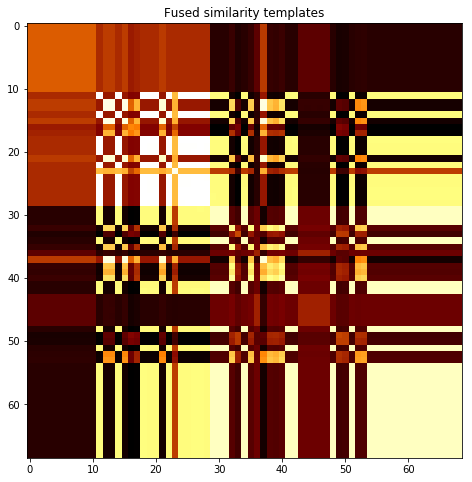

subject 08; gesture 4_0_1


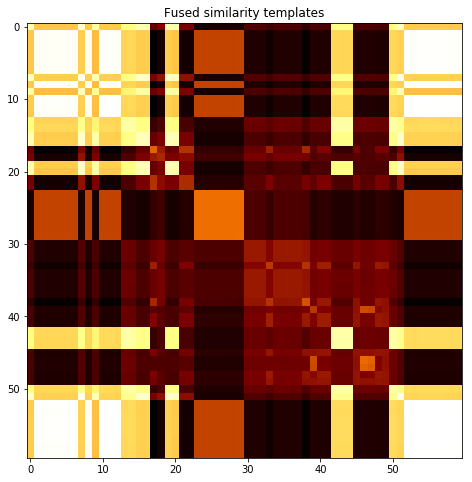

subject 08; gesture 3_0_2


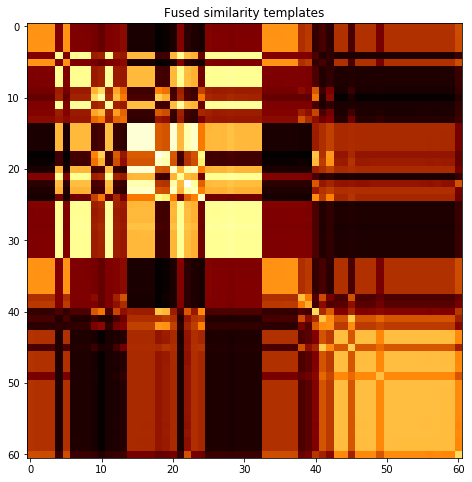

subject 08; gesture 1_1_1


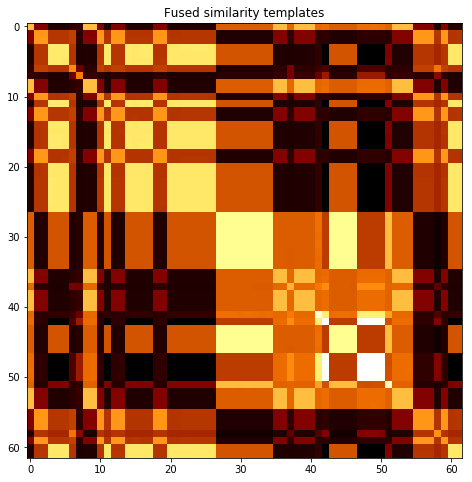

subject 08; gesture 3_1_2


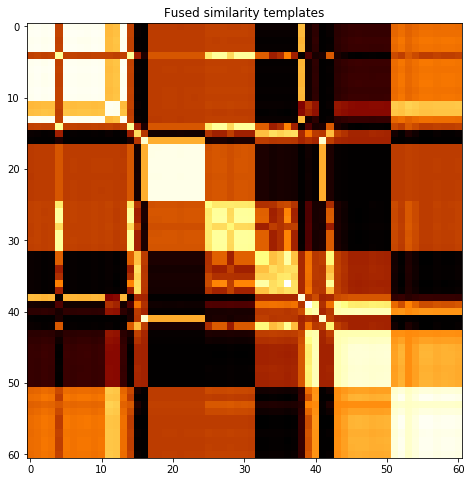

subject 08; gesture 2_1_1


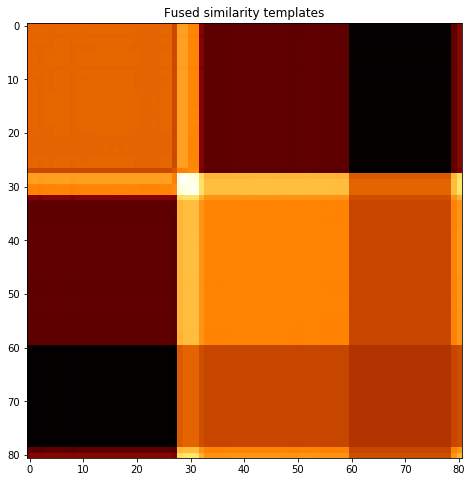

subject 08; gesture 1_0_1


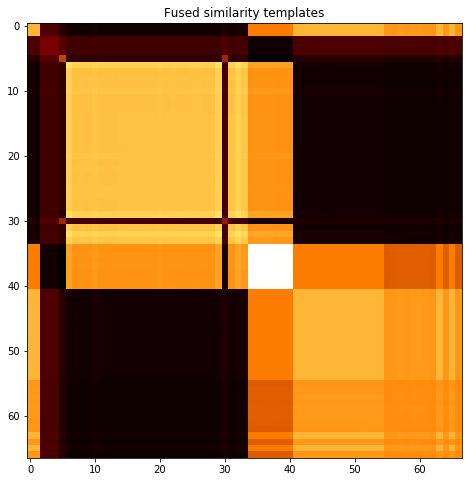

subject 08; gesture 3_1_1


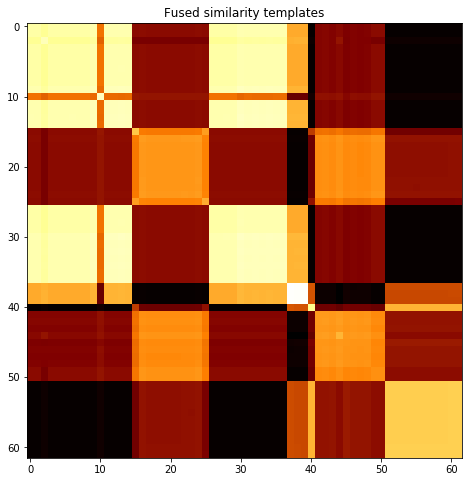

subject 08; gesture 1_0_2


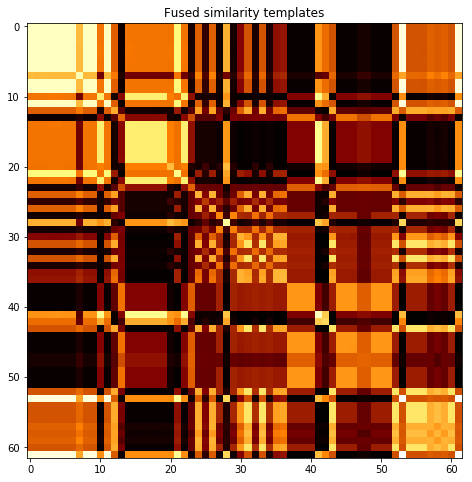

subject 08; gesture 4_0_2


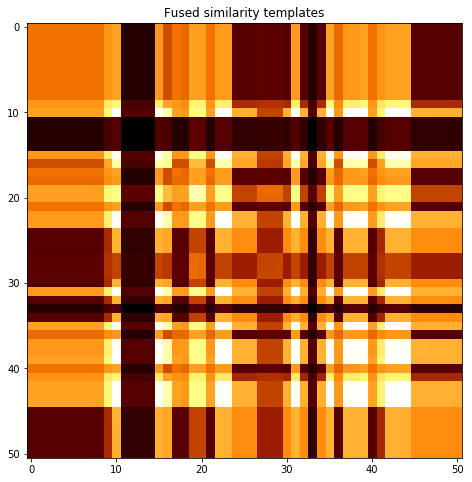

subject 27; gesture 3_0_1


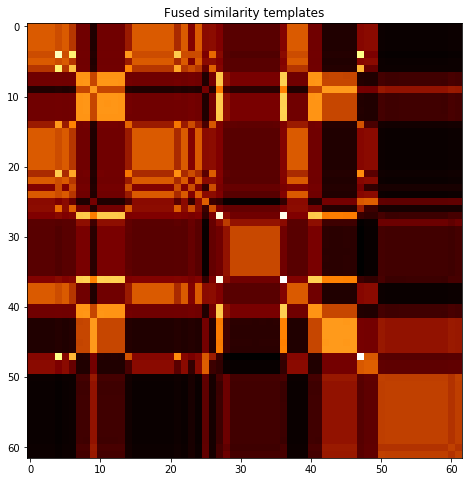

subject 27; gesture 4_1_1


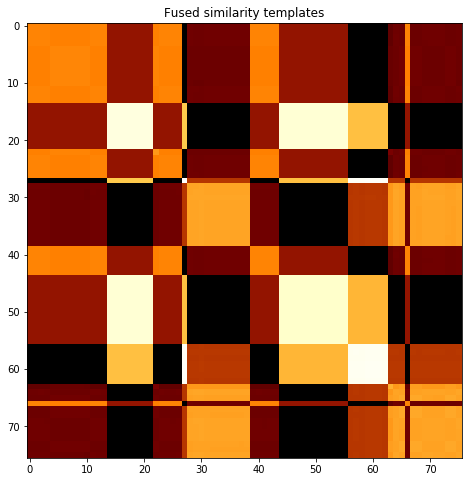

subject 27; gesture 2_0_1


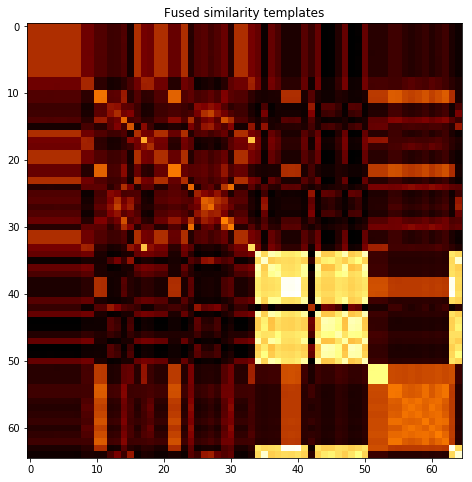

subject 27; gesture 4_1_2


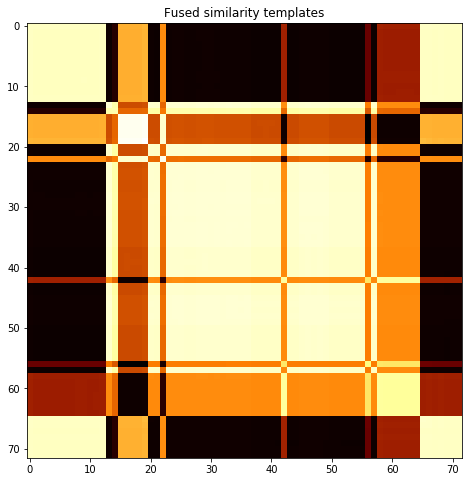

subject 27; gesture 2_0_2


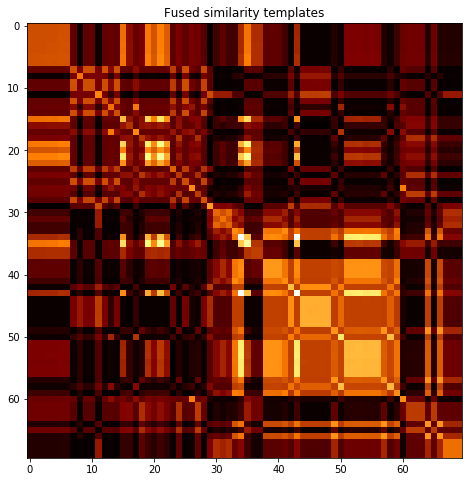

subject 27; gesture 1_1_2


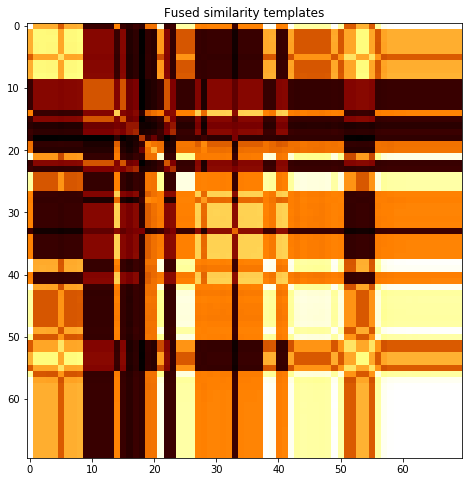

subject 27; gesture 2_1_2


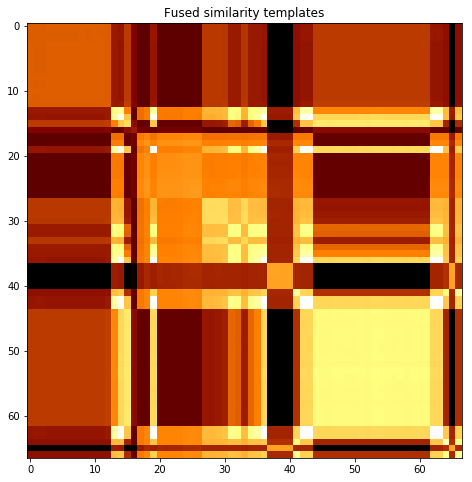

subject 27; gesture 4_0_1


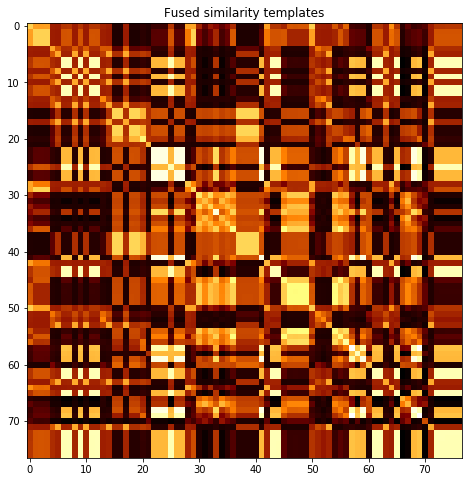

subject 27; gesture 3_0_2


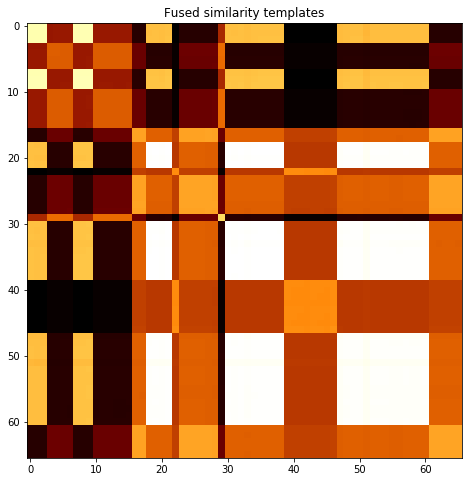

subject 27; gesture 1_1_1


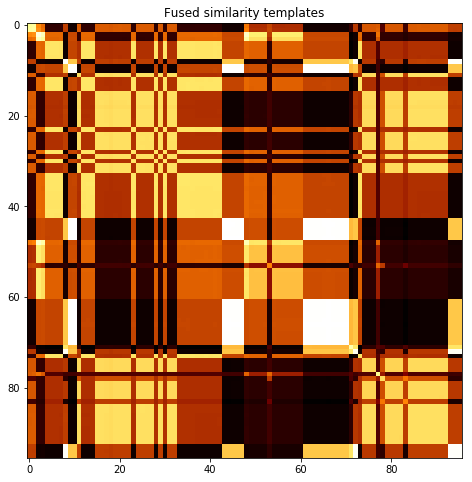

subject 27; gesture 3_1_2


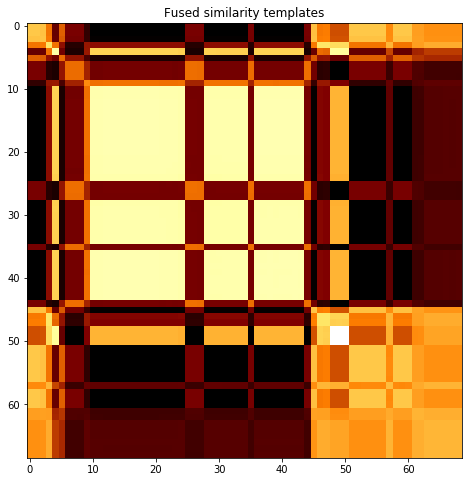

subject 27; gesture 2_1_1


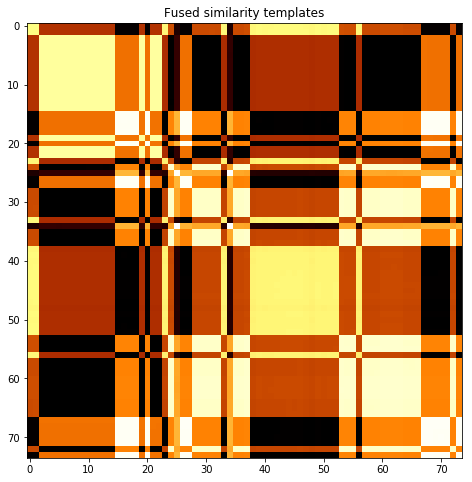

subject 27; gesture 1_0_1


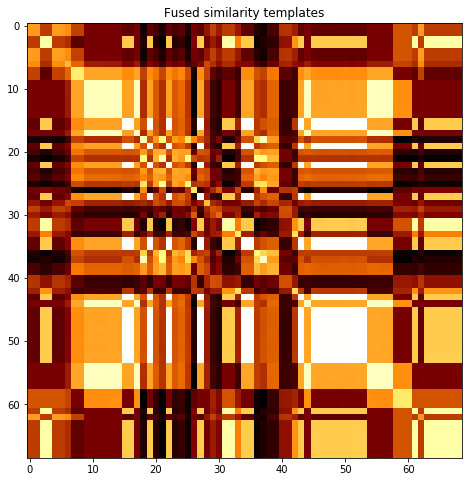

subject 27; gesture 3_1_1


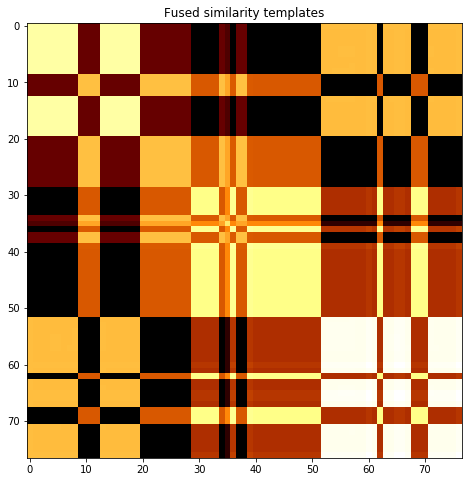

subject 27; gesture 1_0_2


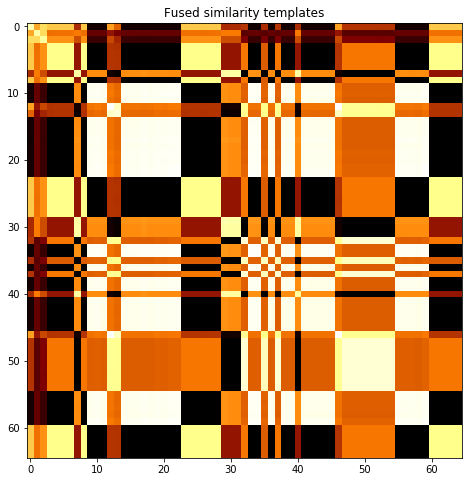

subject 27; gesture 4_0_2


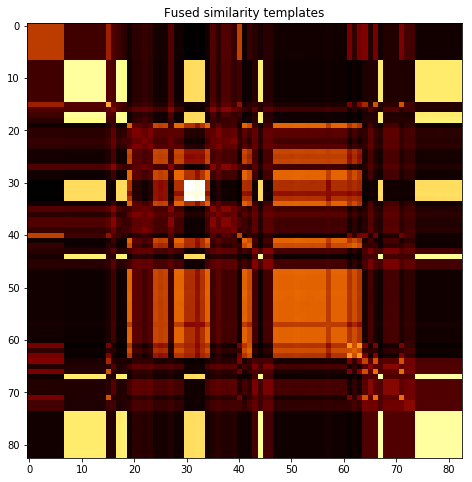

subject 14; gesture 3_0_1


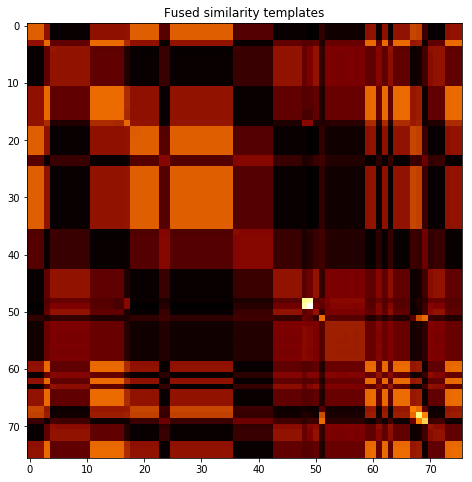

subject 14; gesture 4_1_1


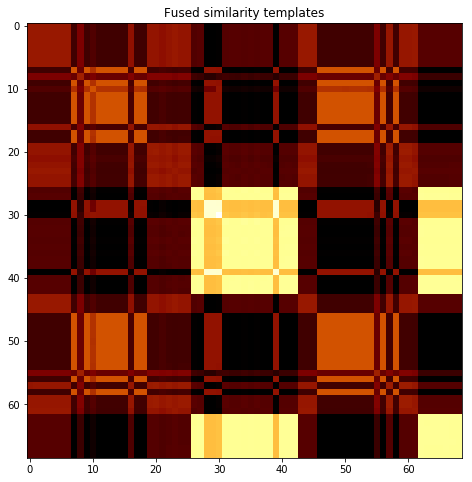

subject 14; gesture 2_0_1


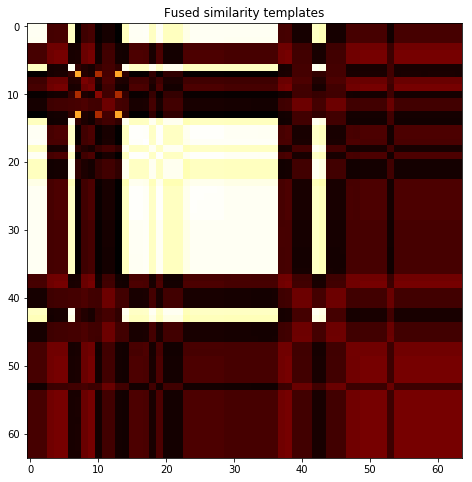

subject 14; gesture 4_1_2


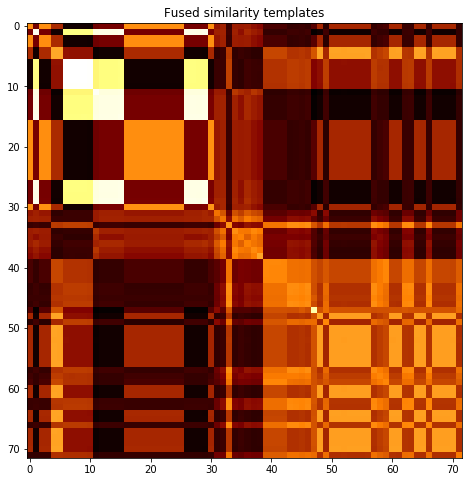

subject 14; gesture 2_0_2


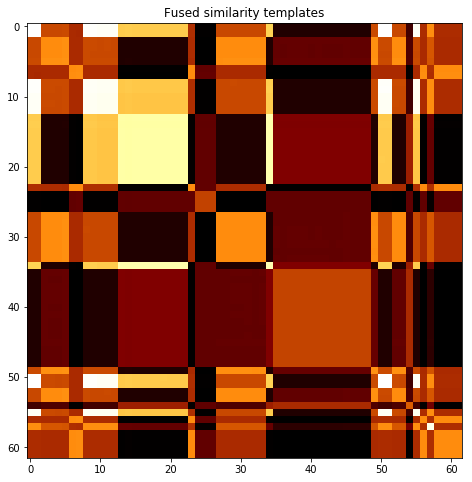

subject 14; gesture 1_1_2


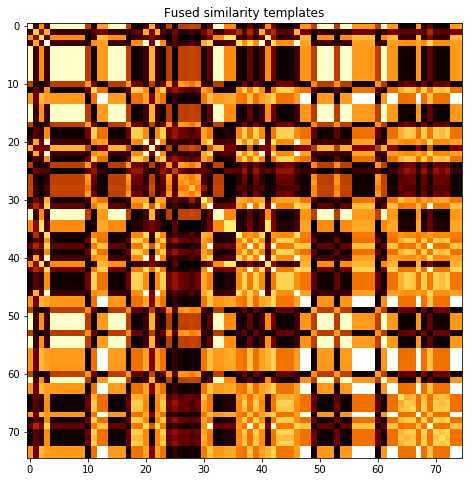

subject 14; gesture 2_1_2


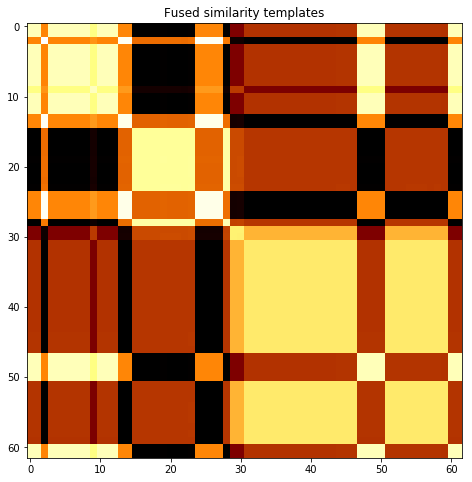

subject 14; gesture 4_0_1


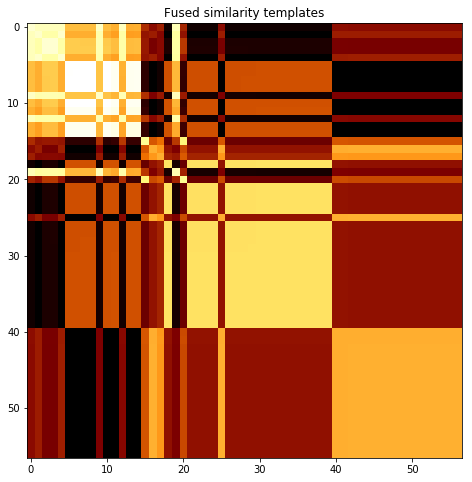

subject 14; gesture 3_0_2


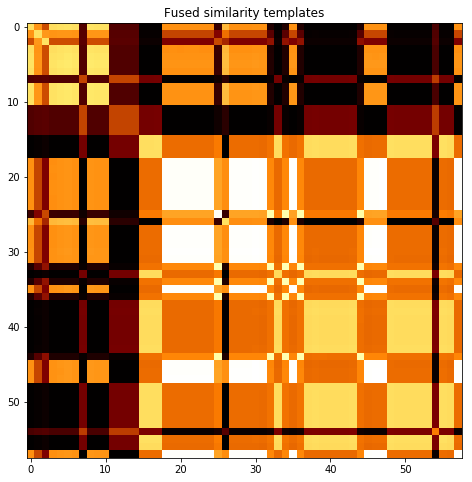

subject 14; gesture 1_1_1


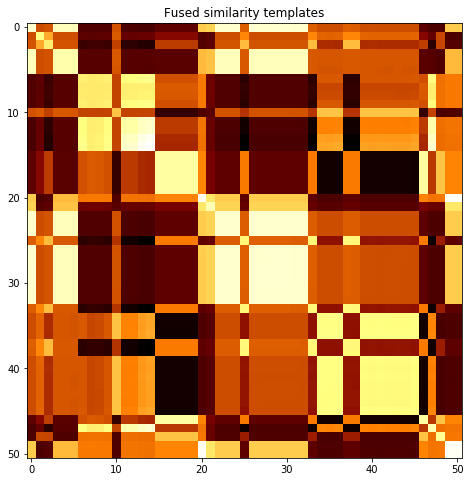

subject 14; gesture 3_1_2


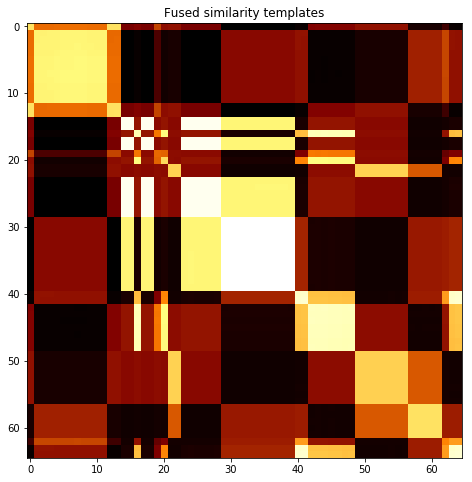

subject 14; gesture 2_1_1


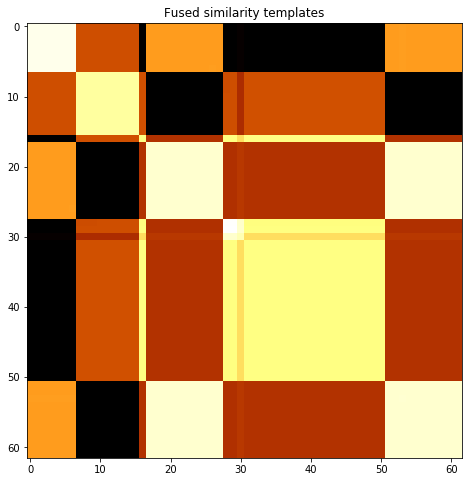

subject 14; gesture 1_0_1


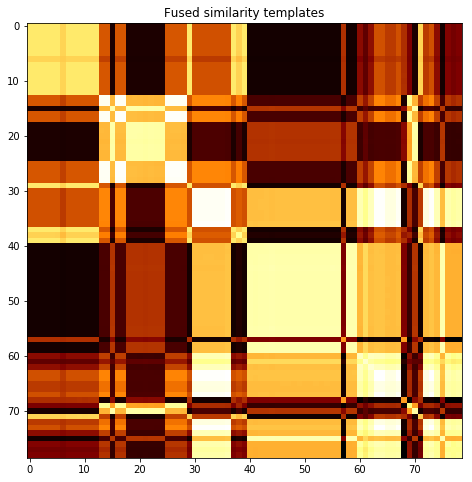

subject 14; gesture 3_1_1


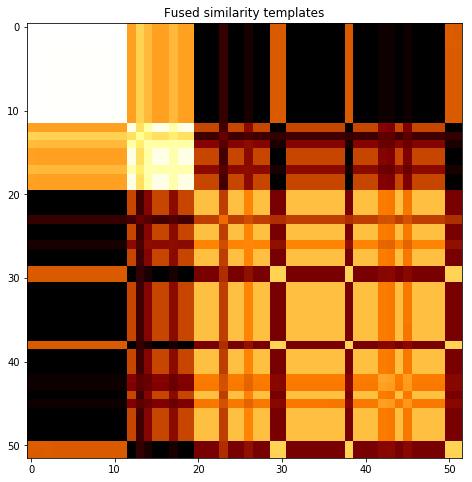

subject 14; gesture 1_0_2


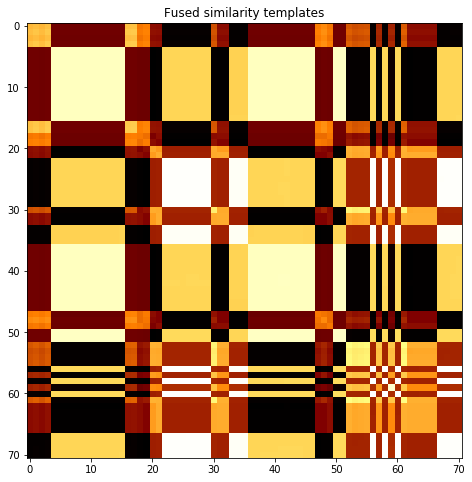

subject 14; gesture 4_0_2


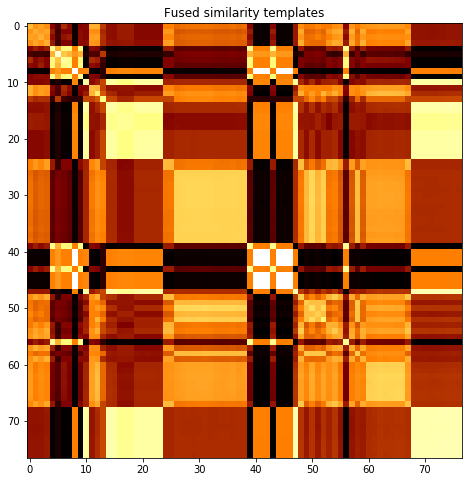

subject 23; gesture 3_0_1


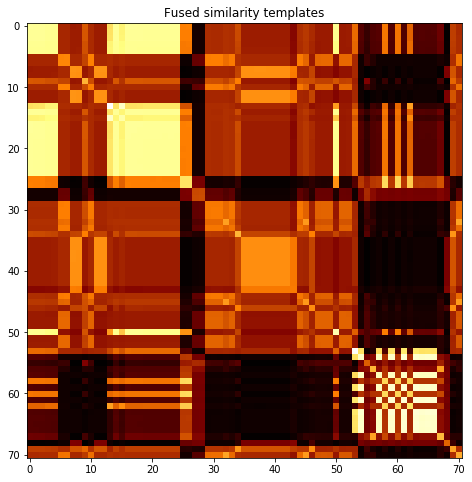

subject 23; gesture 4_1_1


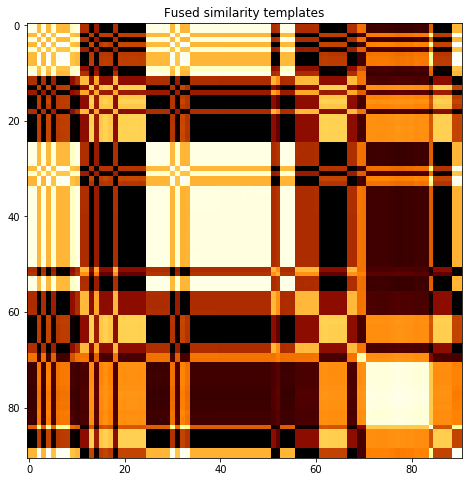

subject 23; gesture 2_0_1


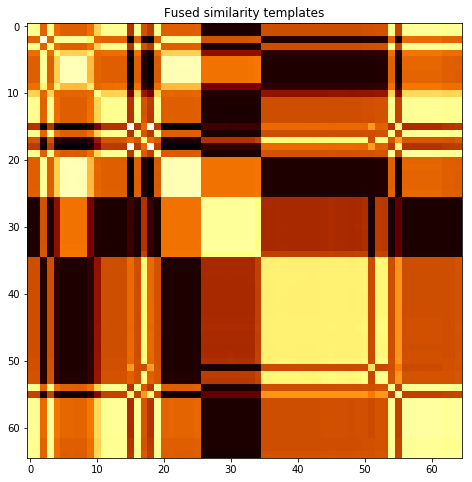

subject 23; gesture 4_1_2


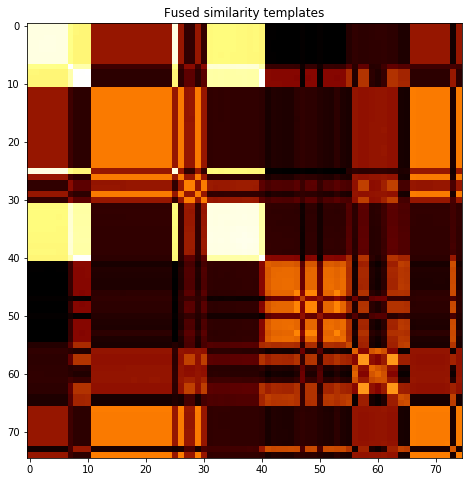

subject 23; gesture 2_0_2


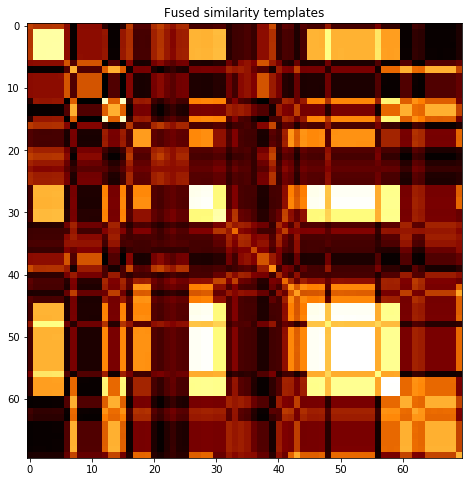

subject 23; gesture 1_1_2


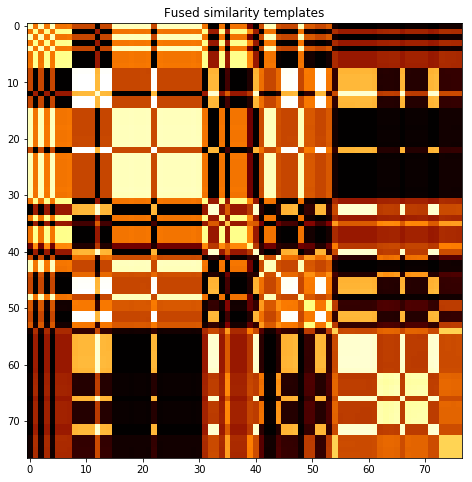

subject 23; gesture 2_1_2


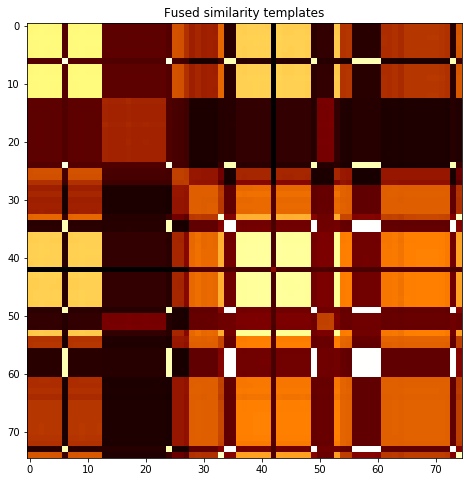

subject 23; gesture 4_0_1


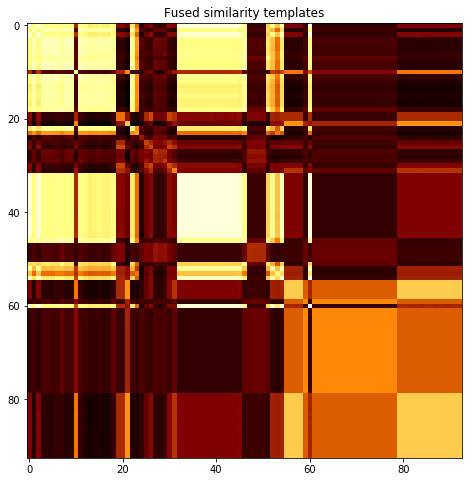

subject 23; gesture 3_0_2


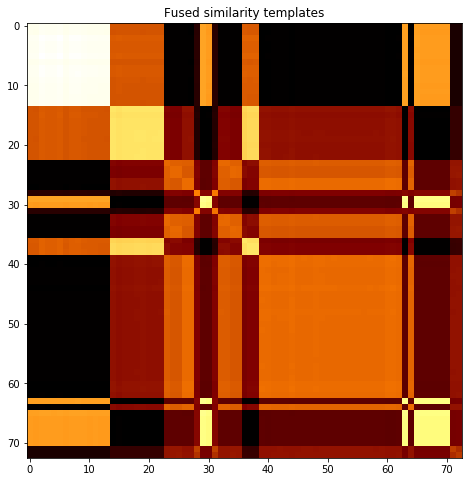

subject 23; gesture 1_1_1


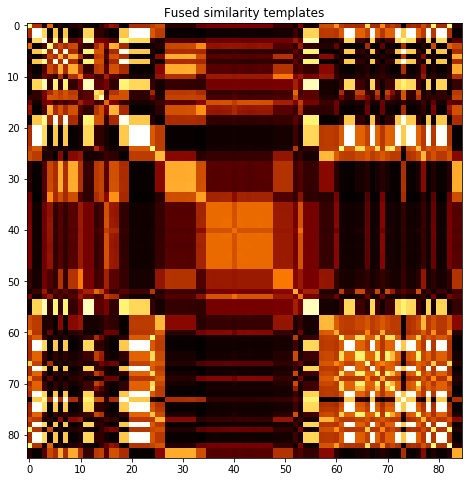

subject 23; gesture 3_1_2


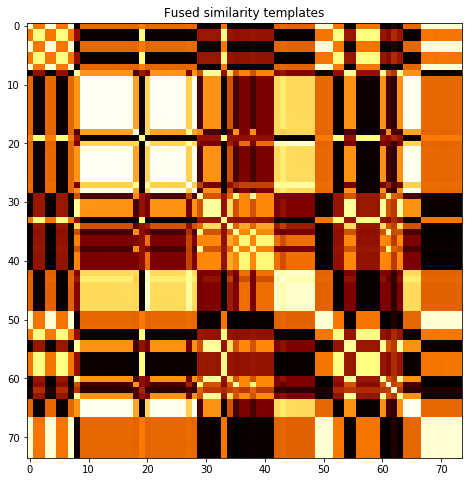

subject 23; gesture 2_1_1


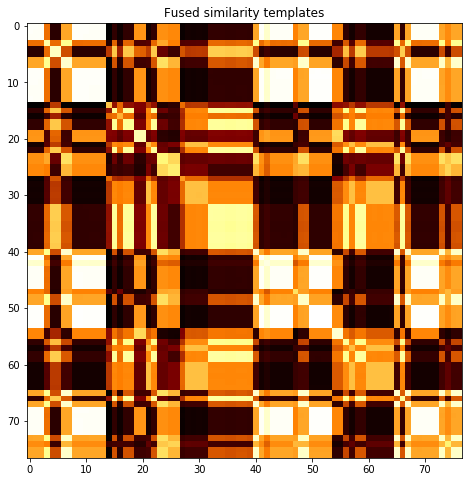

subject 23; gesture 1_0_1


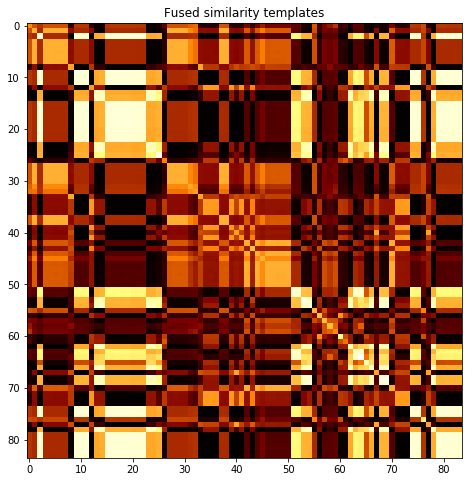

subject 23; gesture 3_1_1


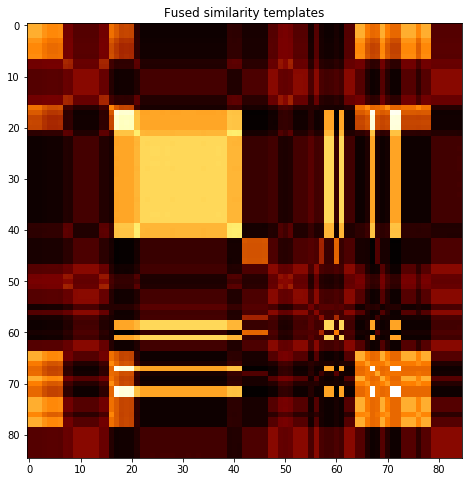

subject 23; gesture 1_0_2


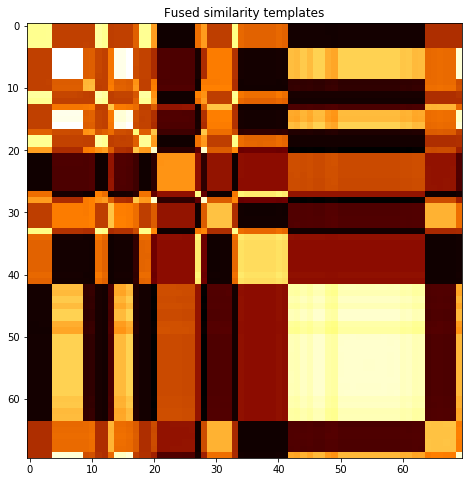

subject 23; gesture 4_0_2


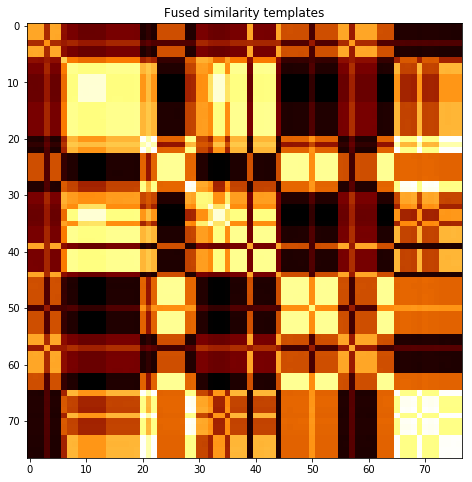

subject 25; gesture 3_0_1


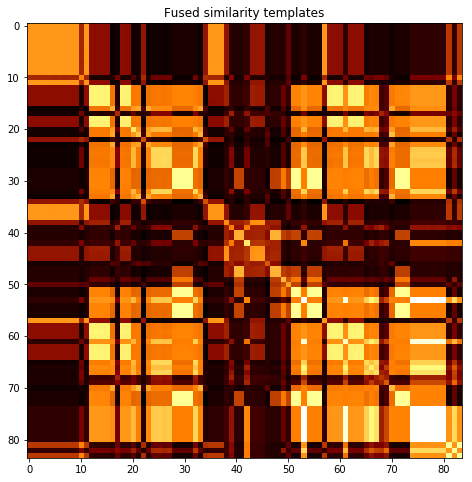

subject 25; gesture 4_1_1


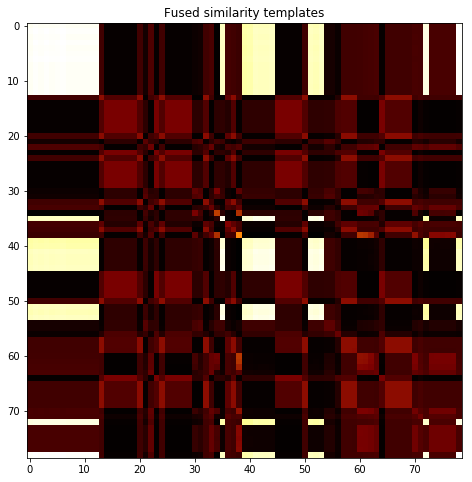

subject 25; gesture 2_0_1


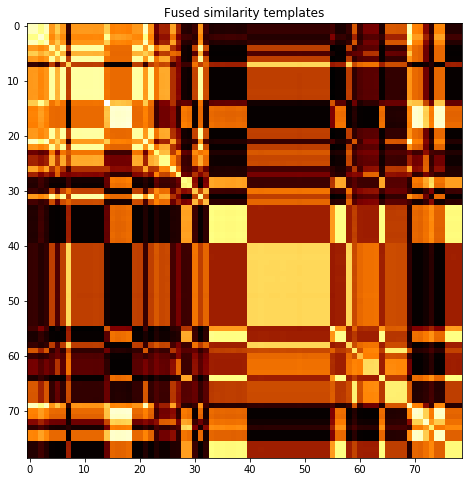

subject 25; gesture 4_1_2


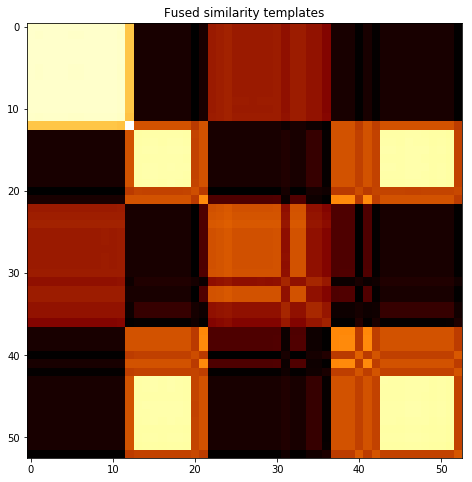

subject 25; gesture 2_0_2


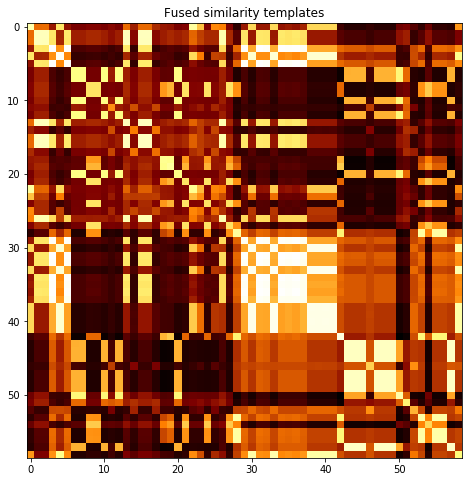

subject 25; gesture 1_1_2


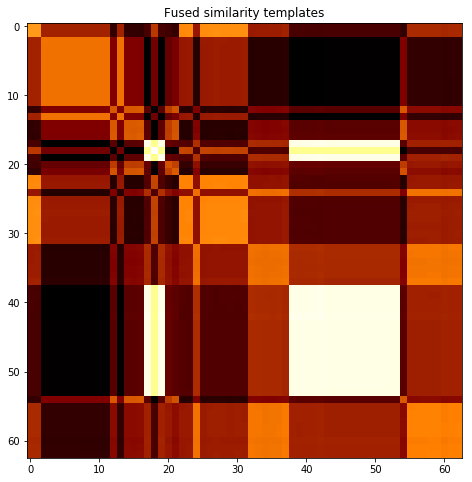

subject 25; gesture 2_1_2


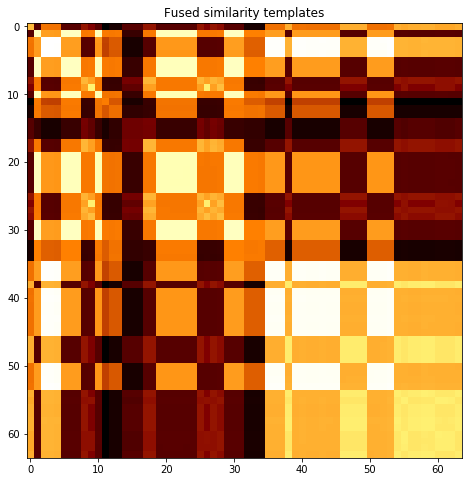

subject 25; gesture 4_0_1


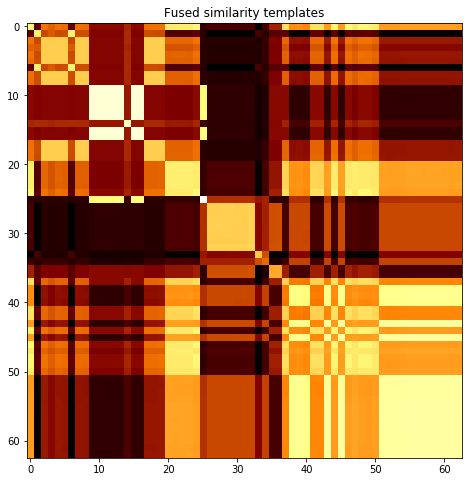

subject 25; gesture 3_0_2


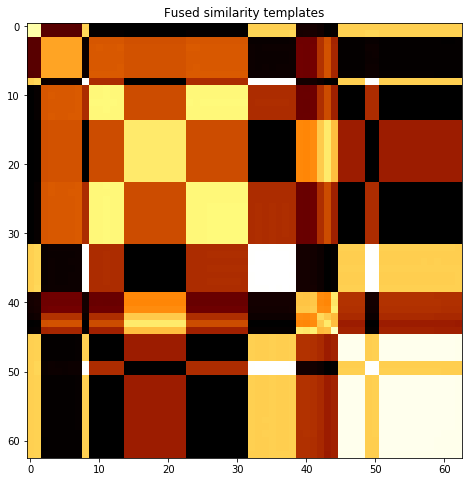

subject 25; gesture 1_1_1


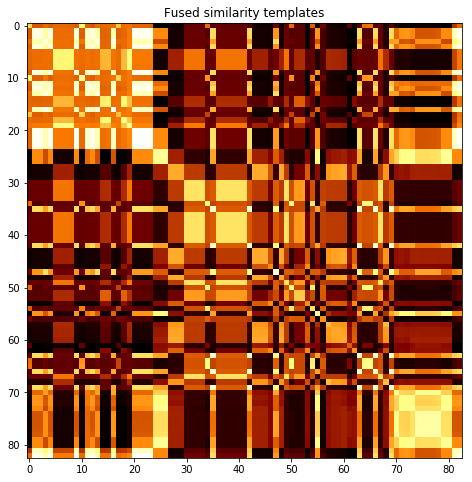

subject 25; gesture 3_1_2


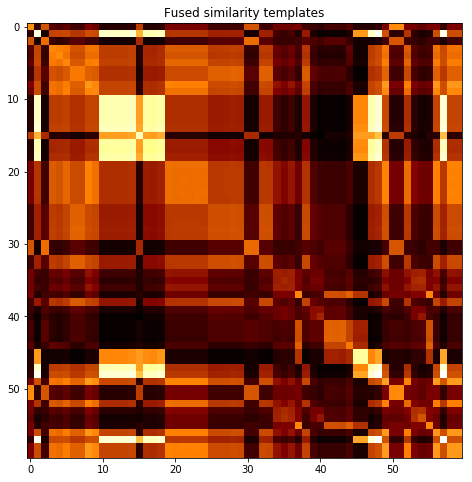

subject 25; gesture 2_1_1


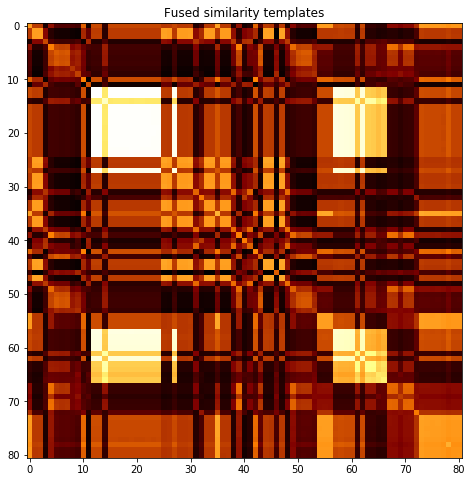

subject 25; gesture 1_0_1


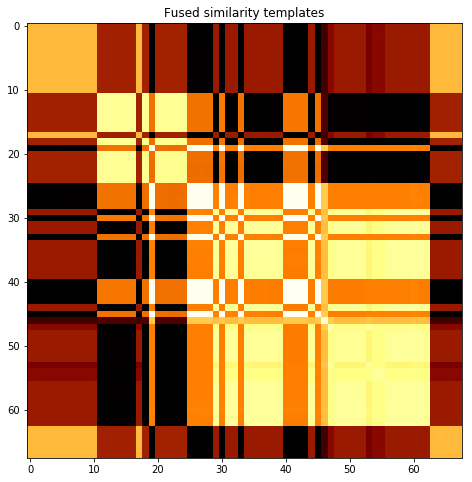

subject 25; gesture 3_1_1


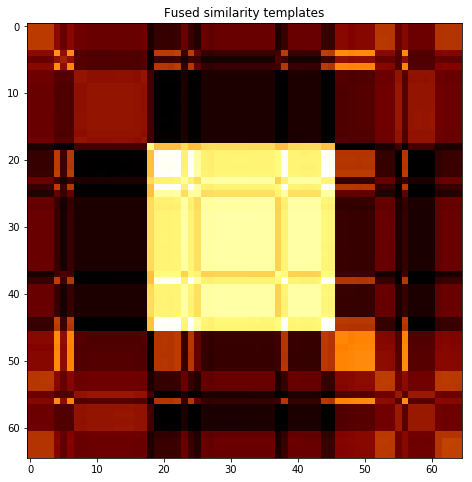

subject 25; gesture 1_0_2


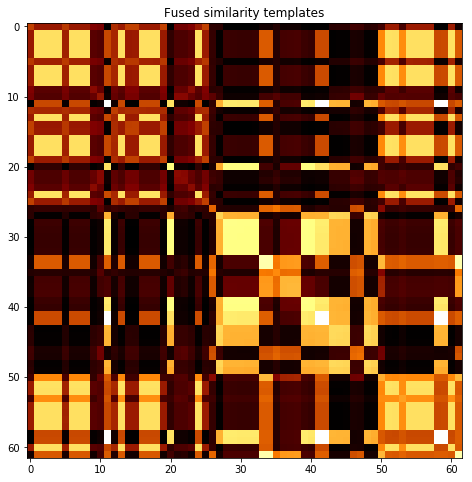

subject 25; gesture 4_0_2


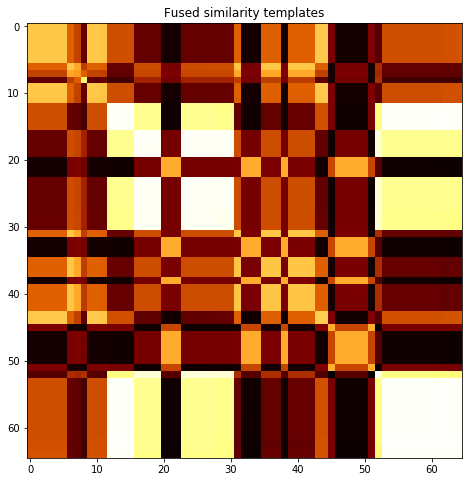

subject 18; gesture 3_0_1


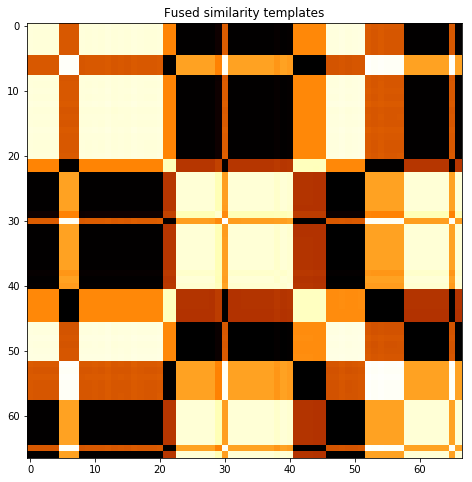

subject 18; gesture 4_1_1


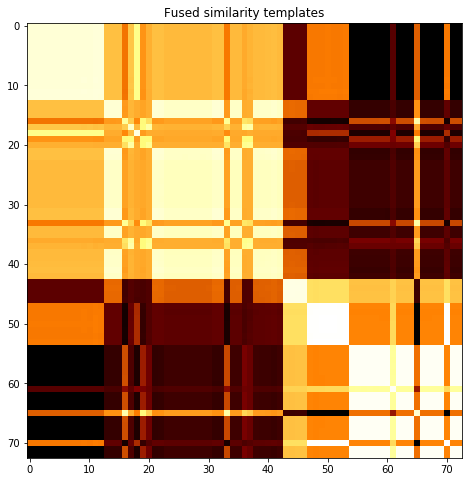

subject 18; gesture 2_0_1


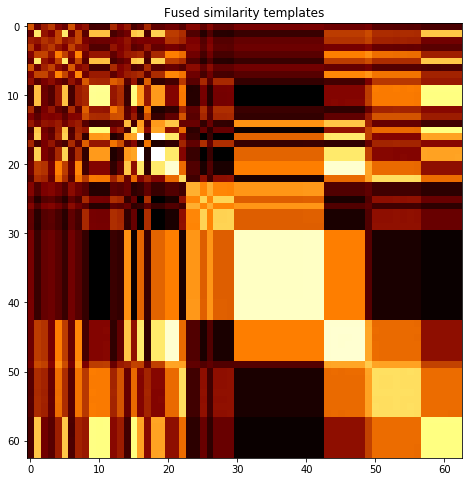

subject 18; gesture 4_1_2


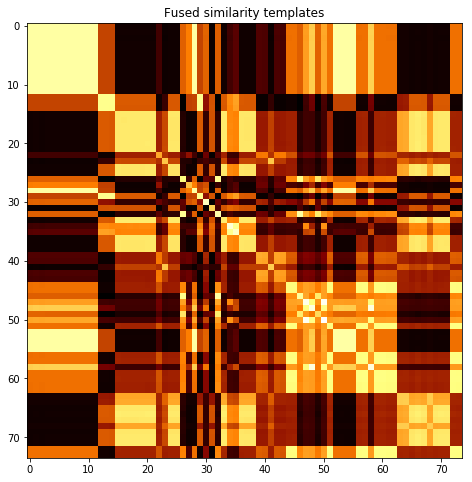

subject 18; gesture 2_0_2


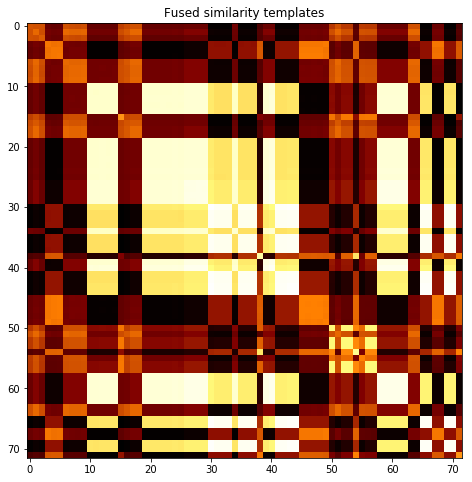

subject 18; gesture 1_1_2


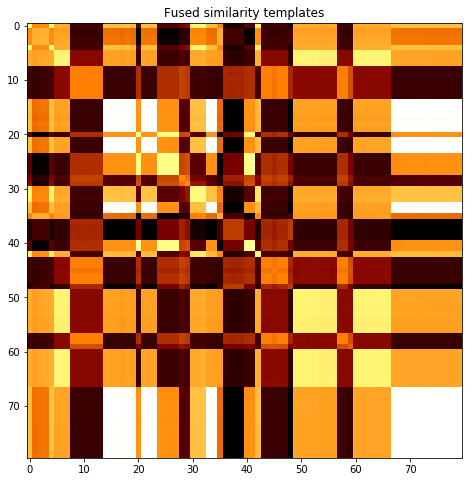

subject 18; gesture 2_1_2


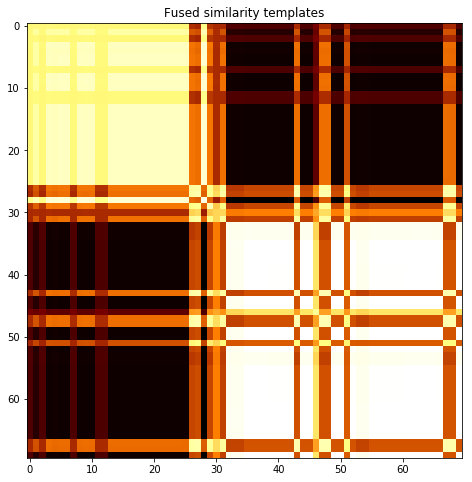

subject 18; gesture 4_0_1


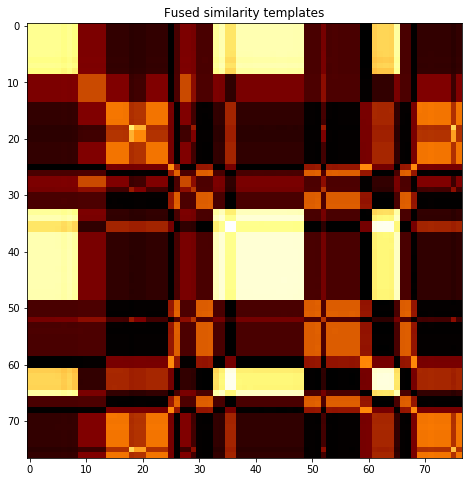

subject 18; gesture 3_0_2


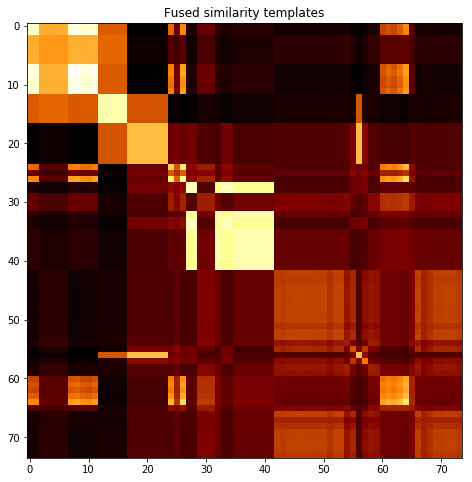

subject 18; gesture 1_1_1


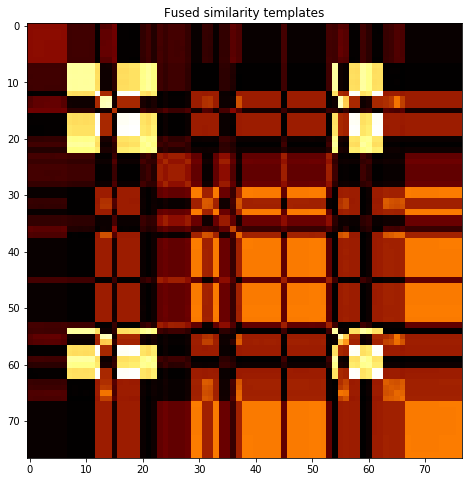

subject 18; gesture 3_1_2


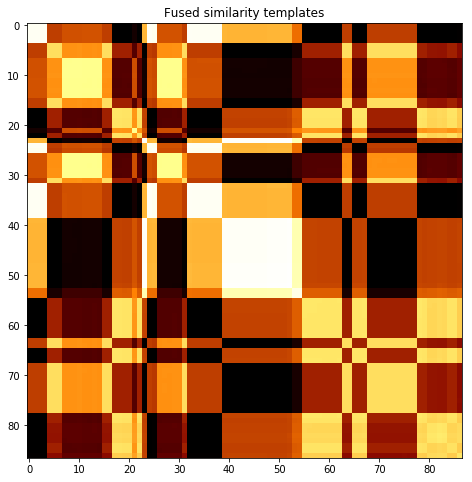

subject 18; gesture 2_1_1


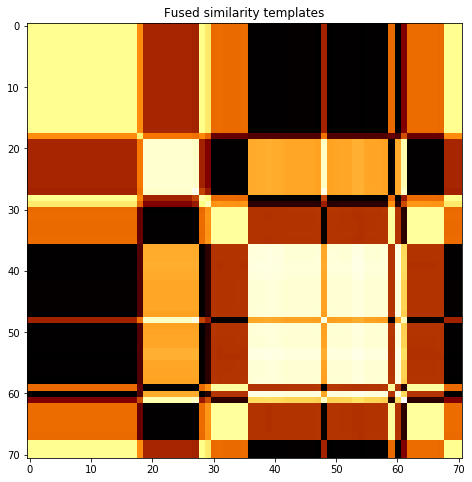

subject 18; gesture 1_0_1


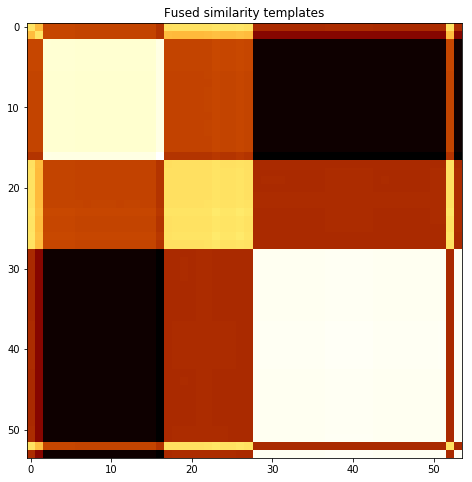

subject 18; gesture 3_1_1


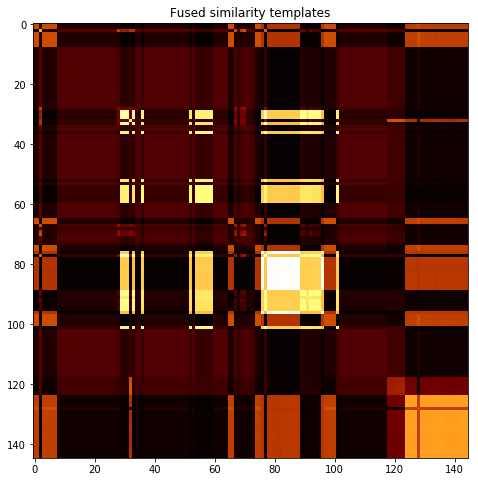

subject 18; gesture 1_0_2


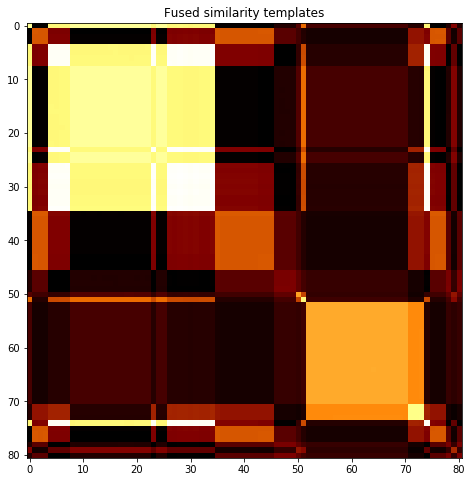

subject 18; gesture 4_0_2


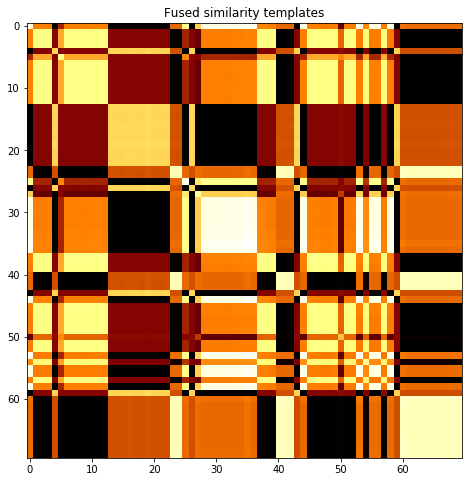

subject 29; gesture 3_0_1


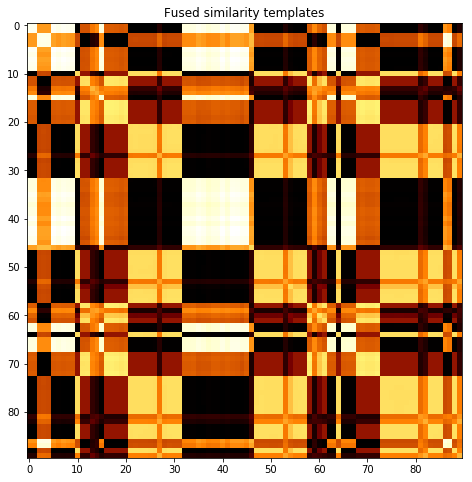

subject 29; gesture 4_1_1


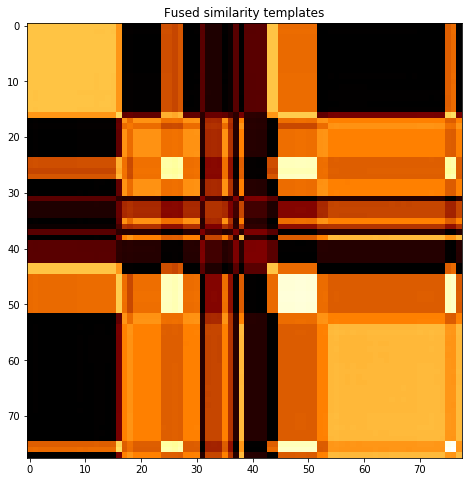

subject 29; gesture 2_0_1


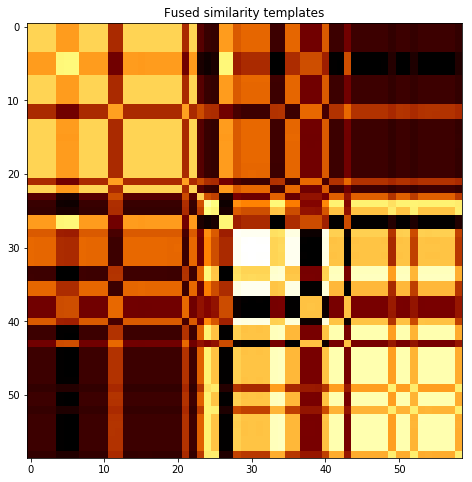

subject 29; gesture 4_1_2


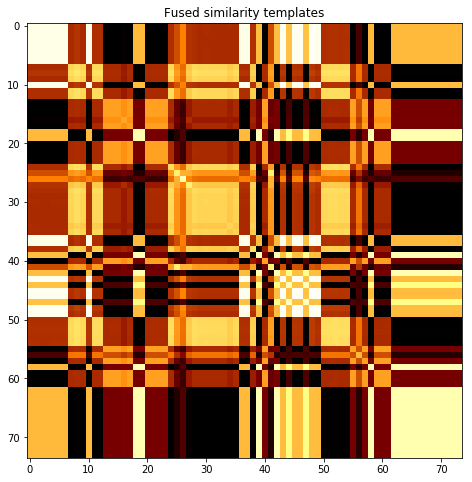

subject 29; gesture 2_0_2


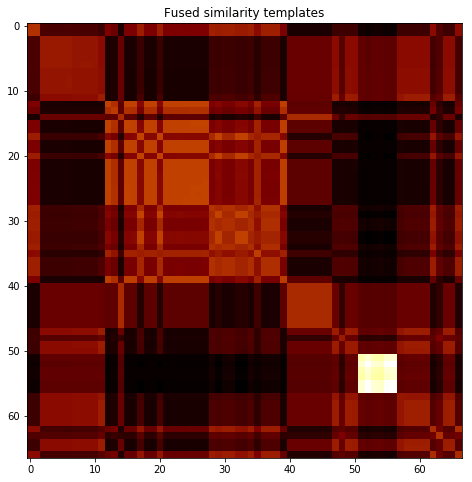

subject 29; gesture 1_1_2


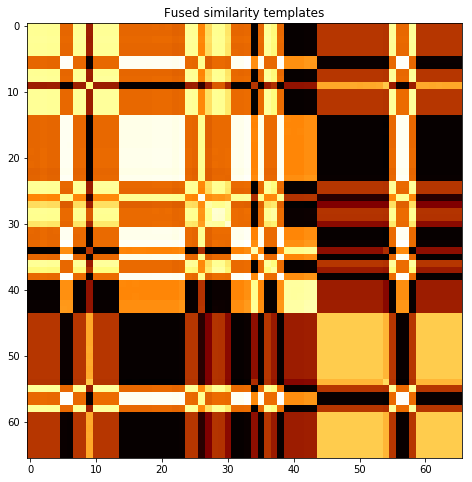

subject 29; gesture 2_1_2


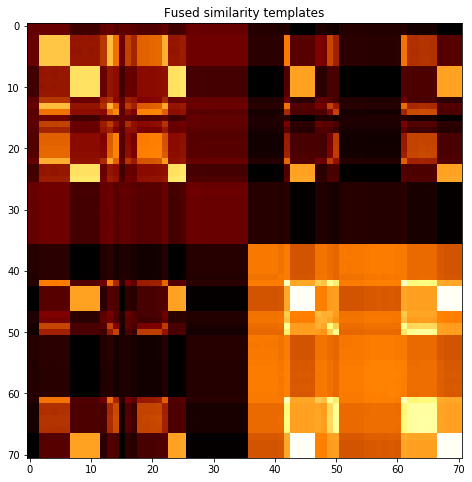

subject 29; gesture 4_0_1


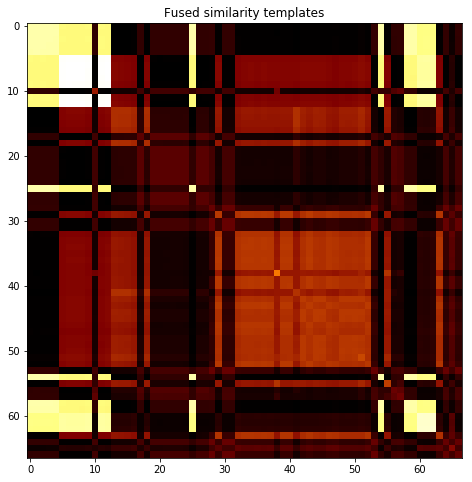

subject 29; gesture 3_0_2


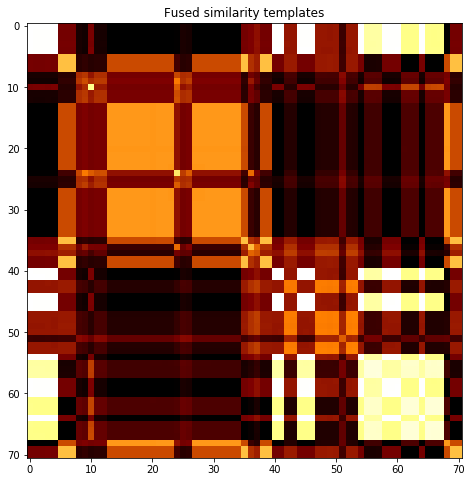

subject 29; gesture 1_1_1


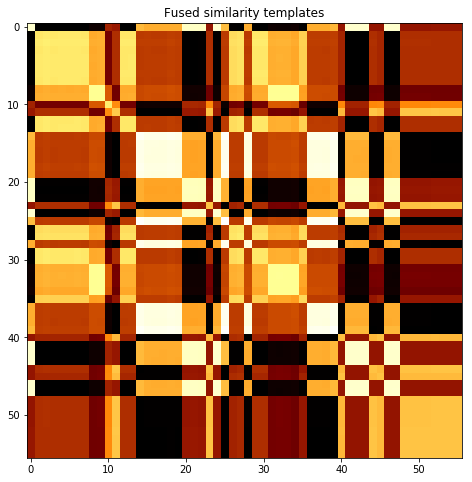

subject 29; gesture 3_1_2


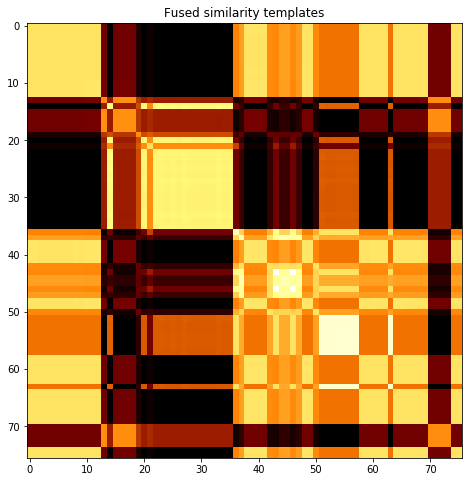

subject 29; gesture 2_1_1


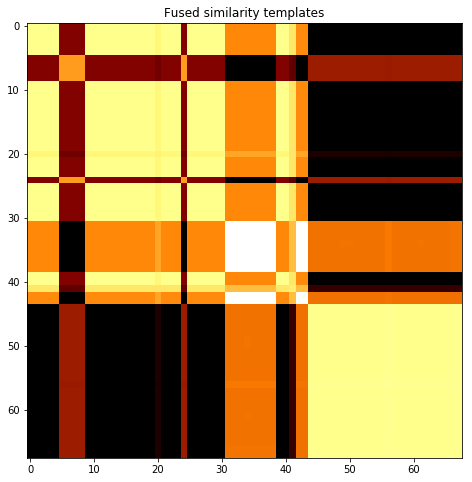

subject 29; gesture 1_0_1


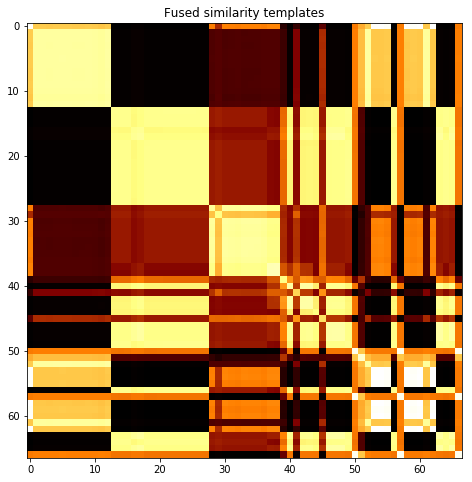

subject 29; gesture 3_1_1


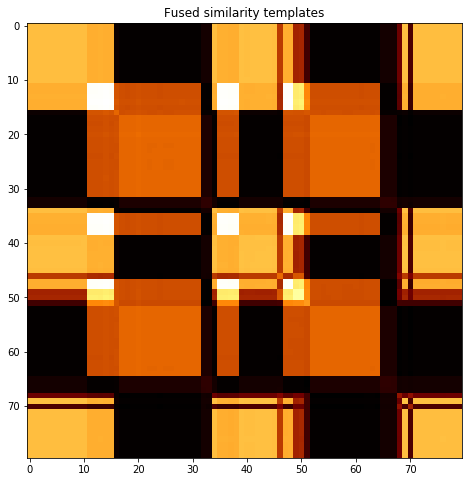

subject 29; gesture 1_0_2


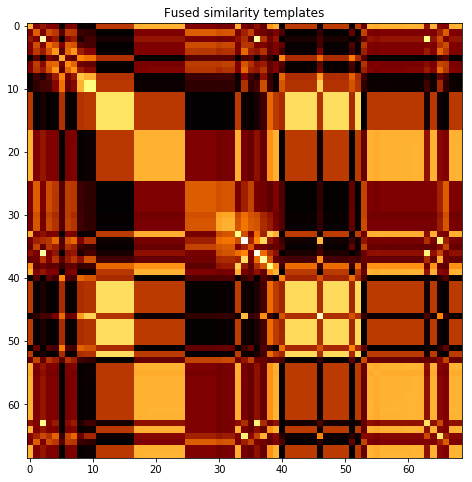

subject 29; gesture 4_0_2


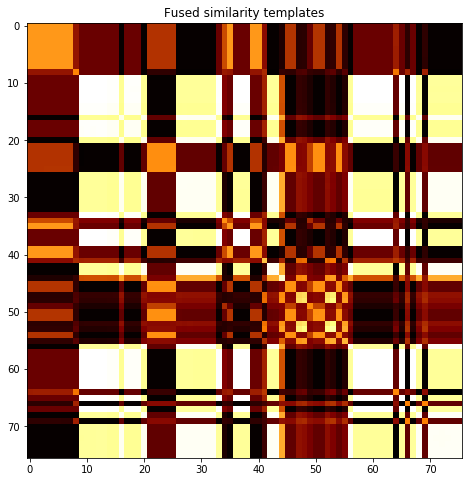

subject 15; gesture 3_0_1


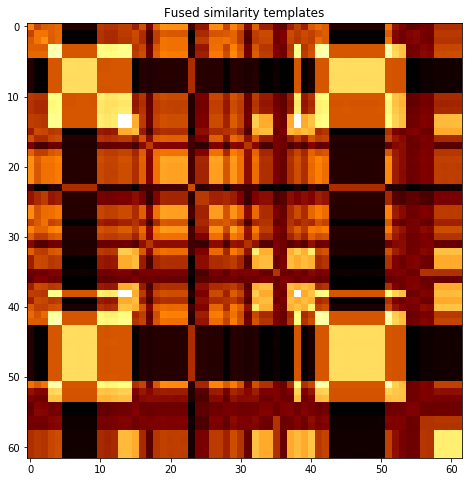

subject 15; gesture 4_1_1


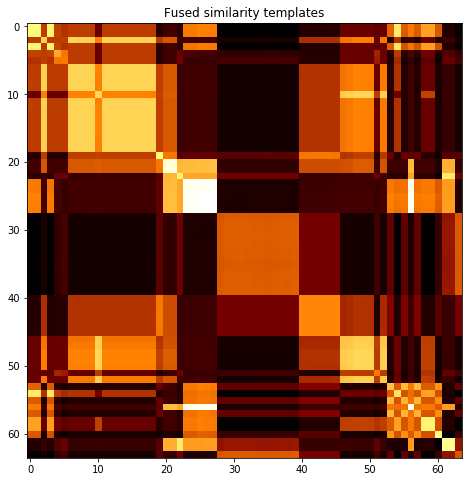

subject 15; gesture 2_0_1


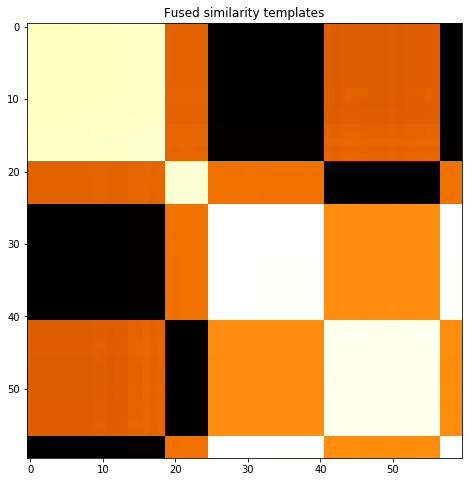

subject 15; gesture 4_1_2


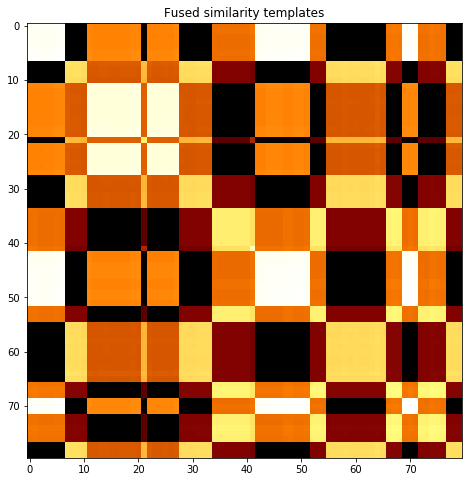

subject 15; gesture 2_0_2


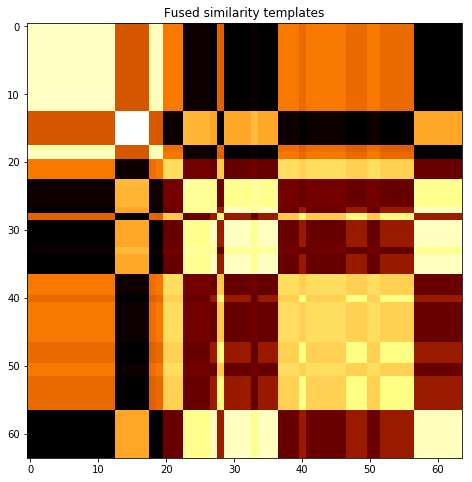

subject 15; gesture 1_1_2


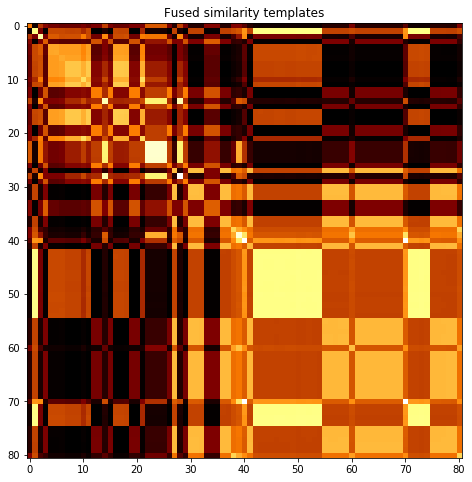

subject 15; gesture 2_1_2


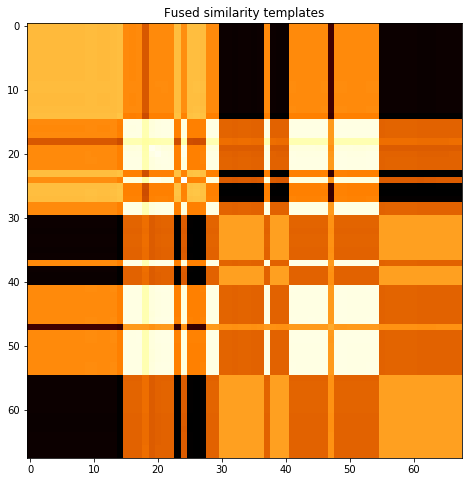

subject 15; gesture 4_0_1


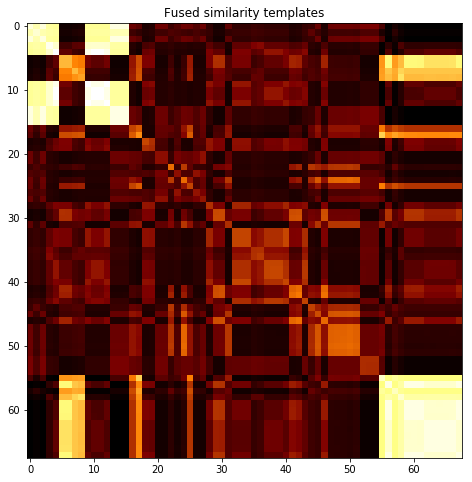

subject 15; gesture 3_0_2


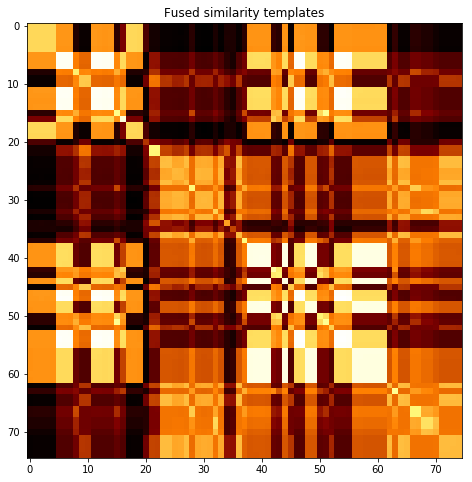

subject 15; gesture 1_1_1


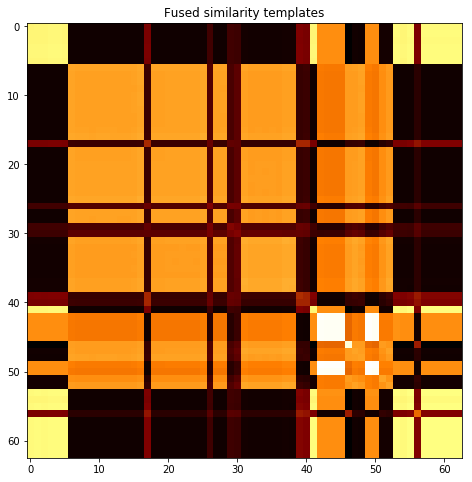

subject 15; gesture 3_1_2


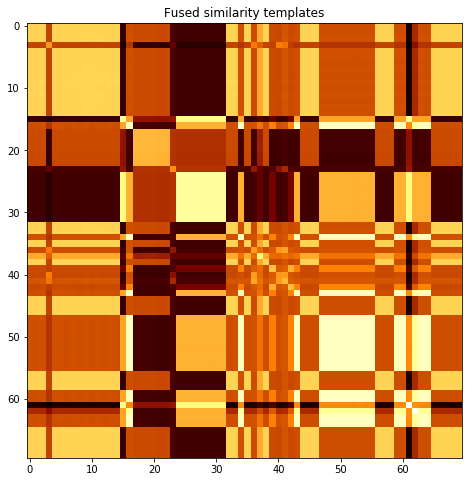

subject 15; gesture 2_1_1


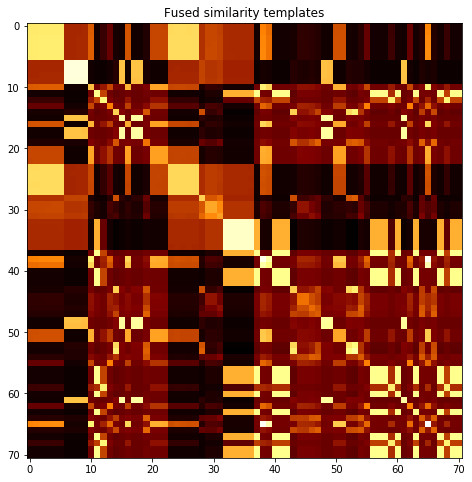

subject 15; gesture 1_0_1


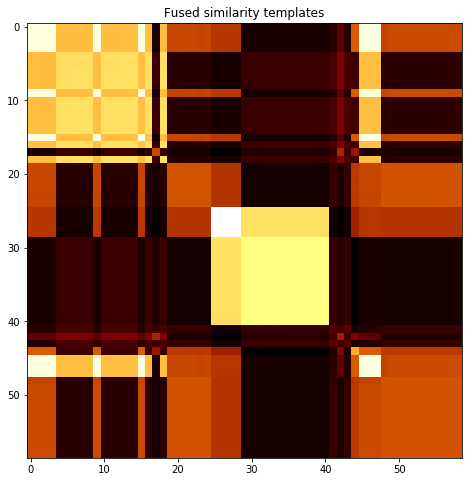

subject 15; gesture 3_1_1


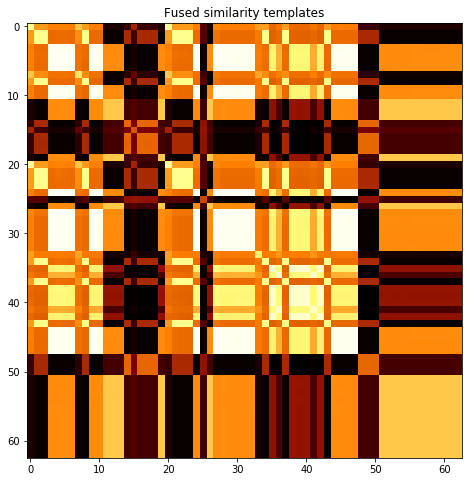

subject 15; gesture 1_0_2


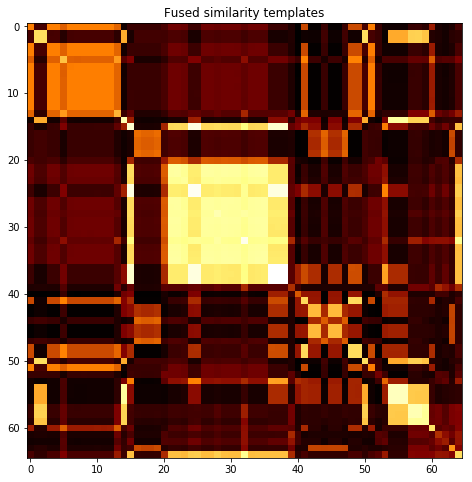

subject 15; gesture 4_0_2


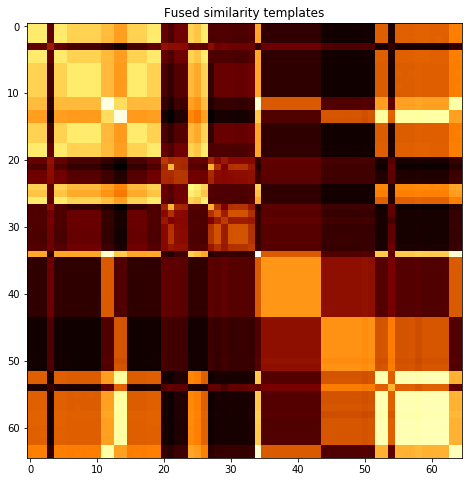

subject 28; gesture 3_0_1


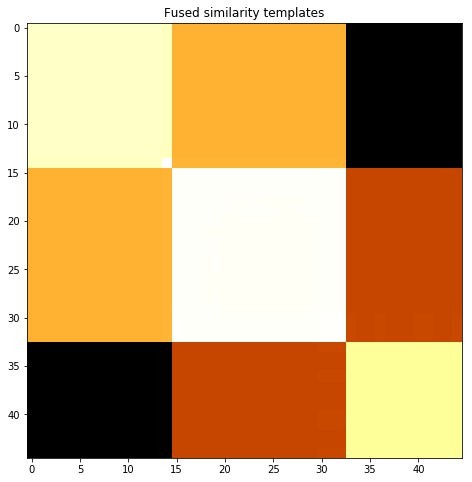

subject 28; gesture 4_1_1


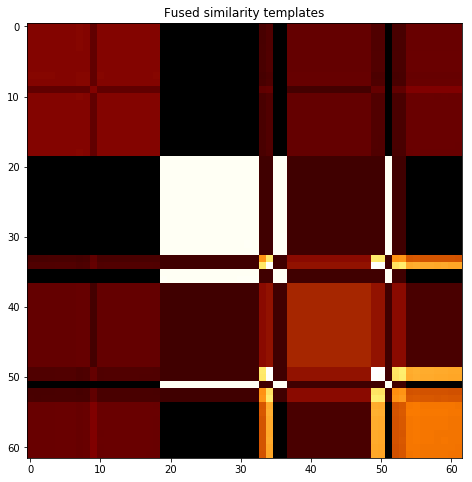

subject 28; gesture 2_0_1


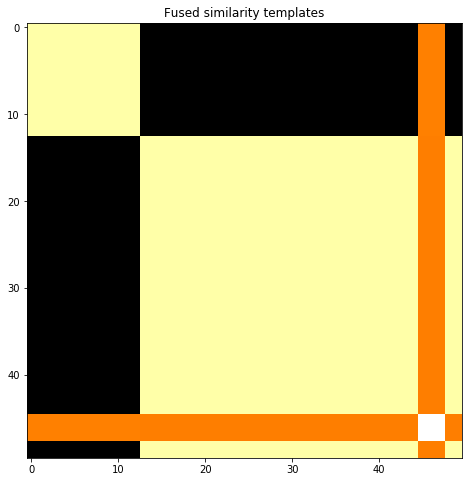

subject 28; gesture 4_1_2


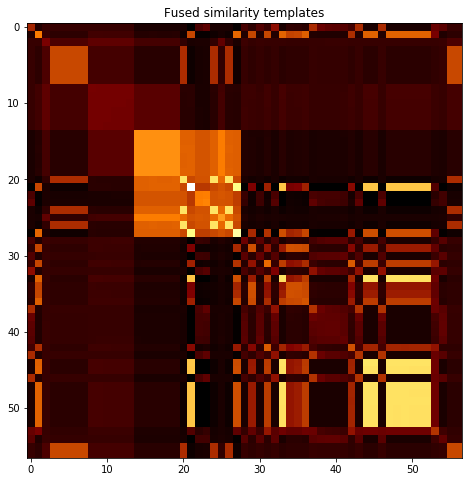

subject 28; gesture 2_0_2


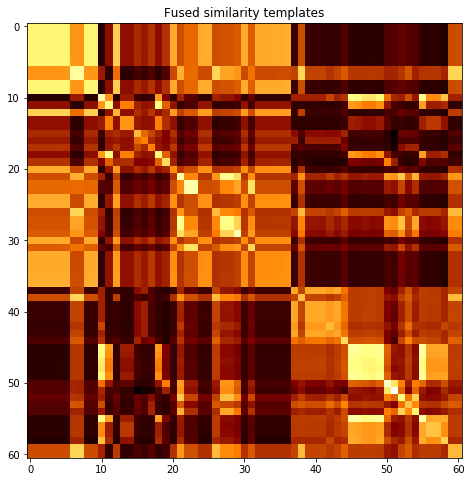

subject 28; gesture 1_1_2


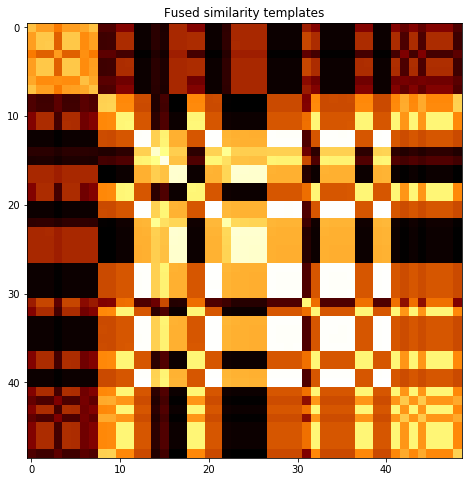

subject 28; gesture 2_1_2


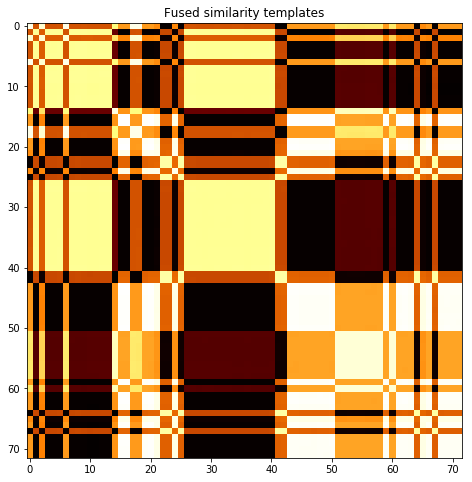

subject 28; gesture 4_0_1


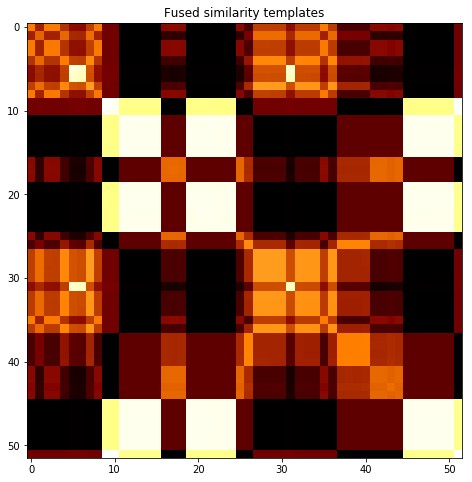

subject 28; gesture 3_0_2


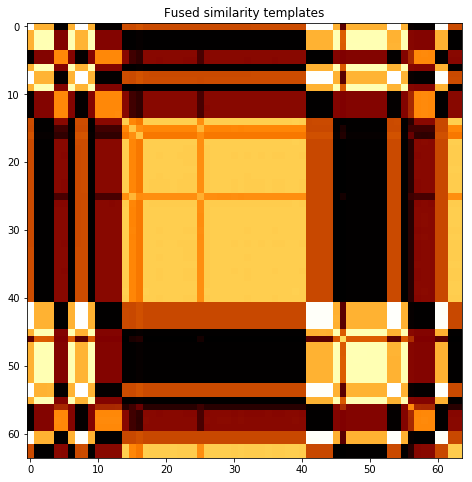

subject 28; gesture 1_1_1


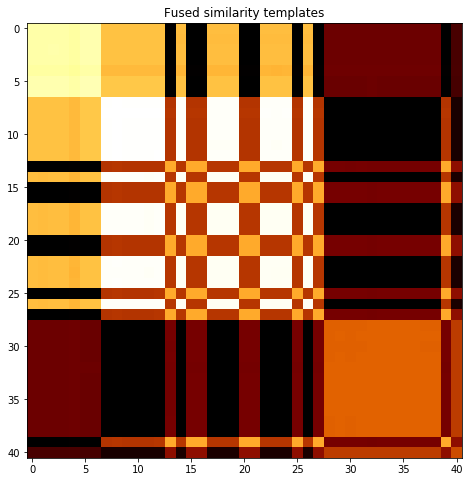

subject 28; gesture 3_1_2


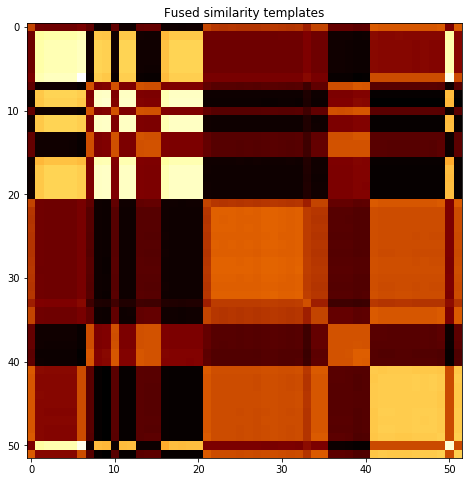

subject 28; gesture 2_1_1


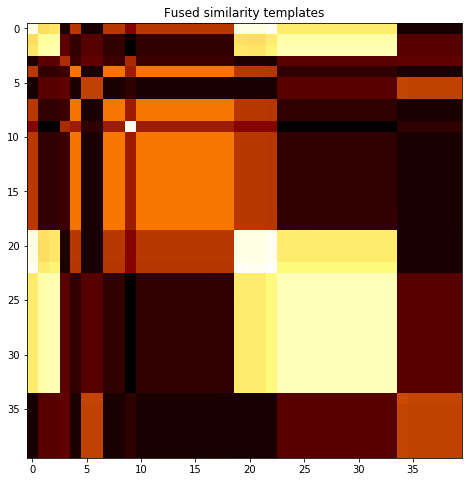

subject 28; gesture 1_0_1


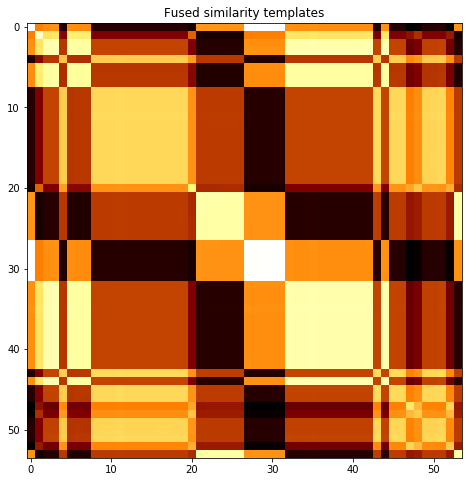

subject 28; gesture 3_1_1


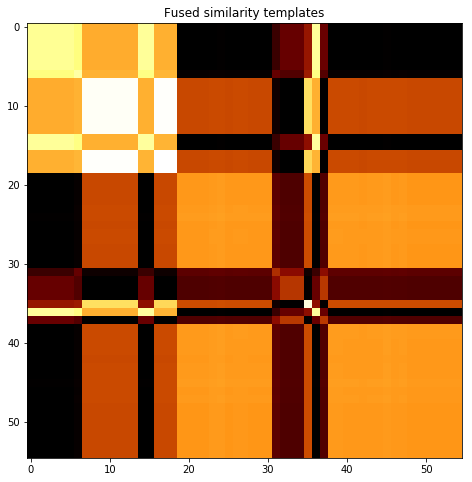

subject 28; gesture 1_0_2


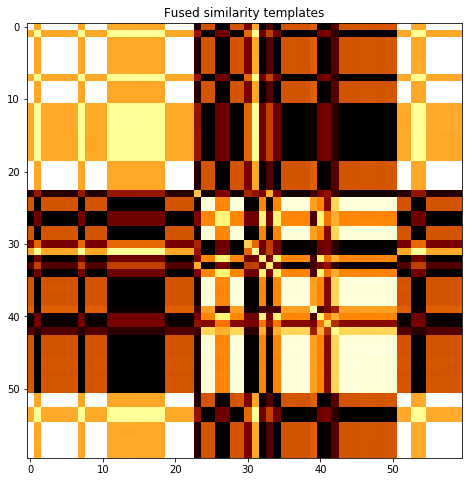

subject 28; gesture 4_0_2


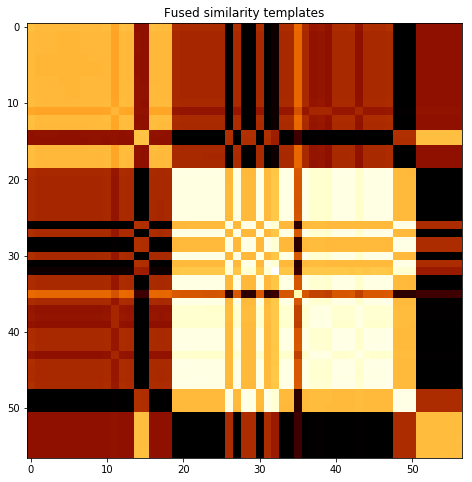

subject 12; gesture 3_0_1


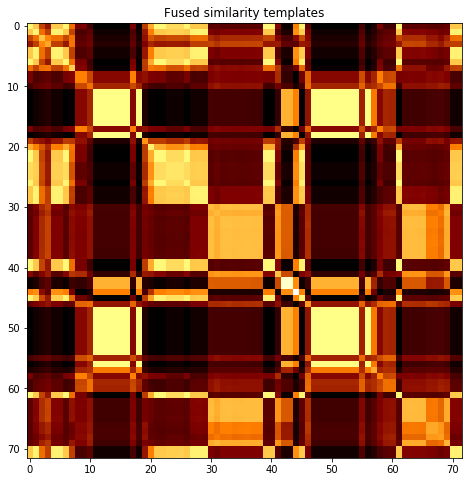

subject 12; gesture 4_1_1


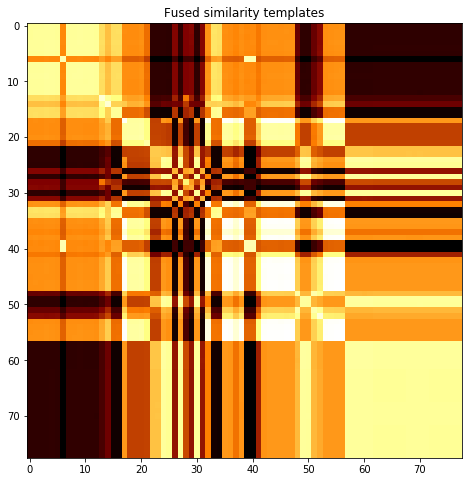

subject 12; gesture 2_0_1


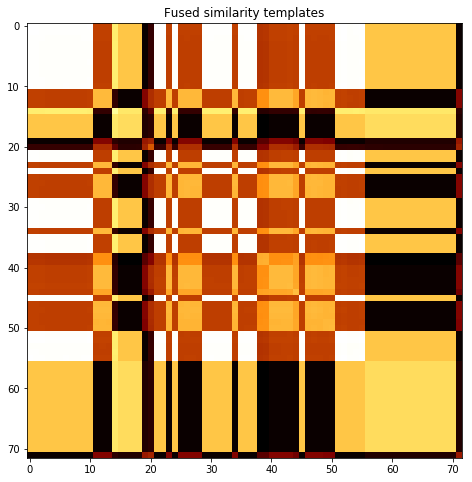

subject 12; gesture 4_1_2


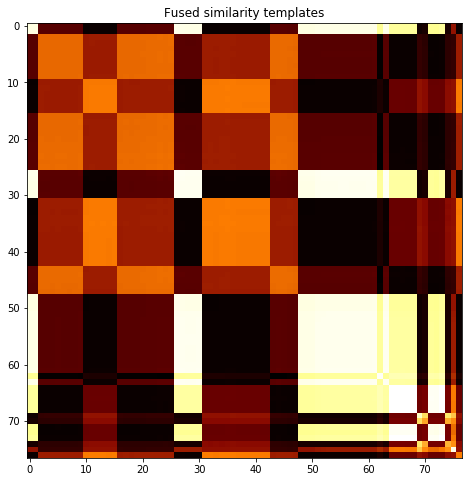

subject 12; gesture 2_0_2


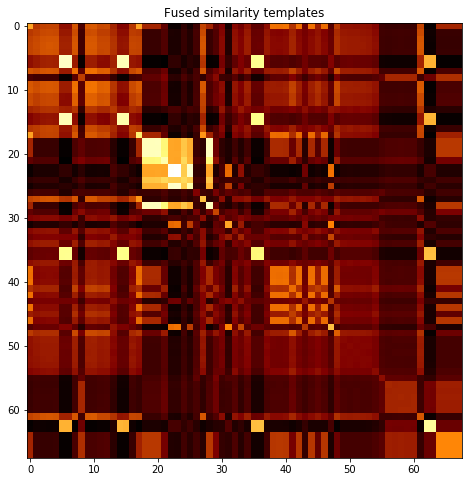

subject 12; gesture 1_1_2


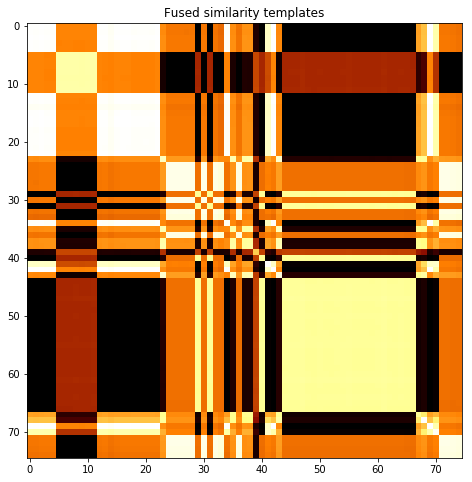

subject 12; gesture 2_1_2


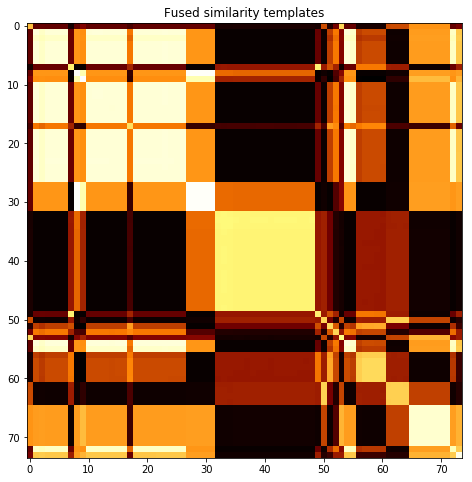

subject 12; gesture 4_0_1


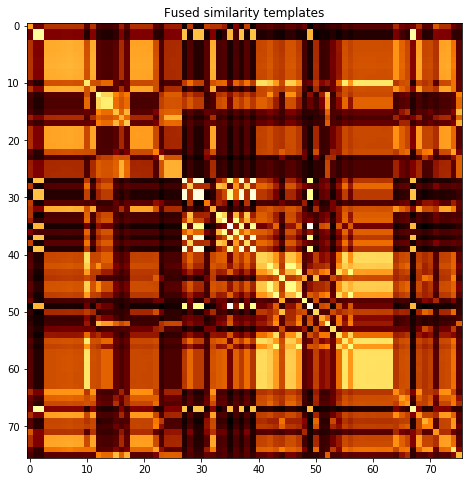

subject 12; gesture 3_0_2


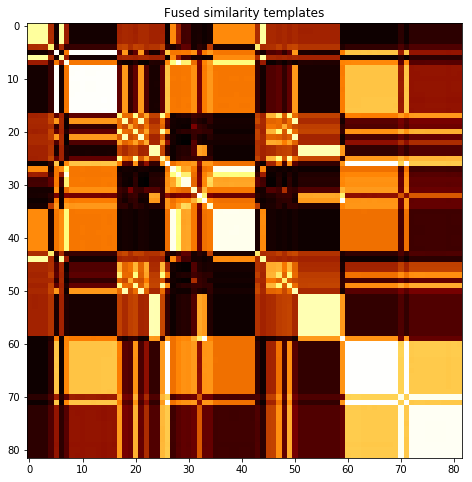

subject 12; gesture 1_1_1


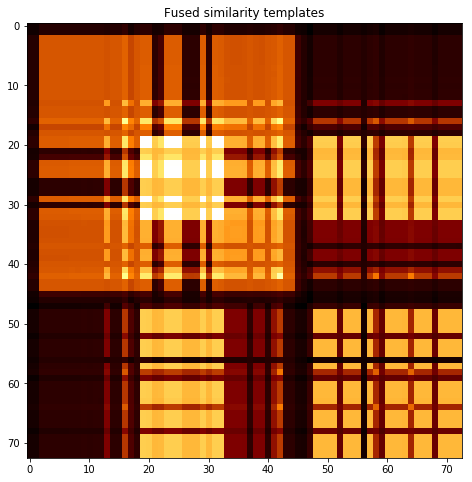

subject 12; gesture 3_1_2


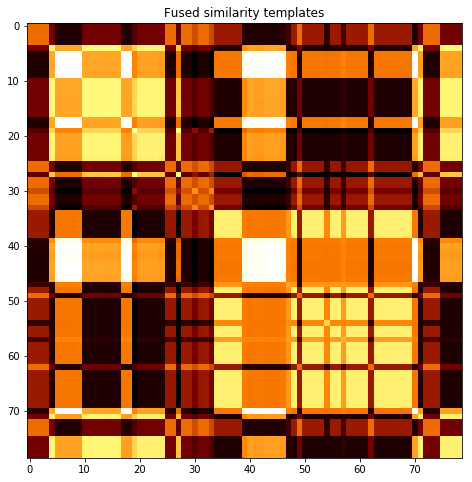

subject 12; gesture 2_1_1


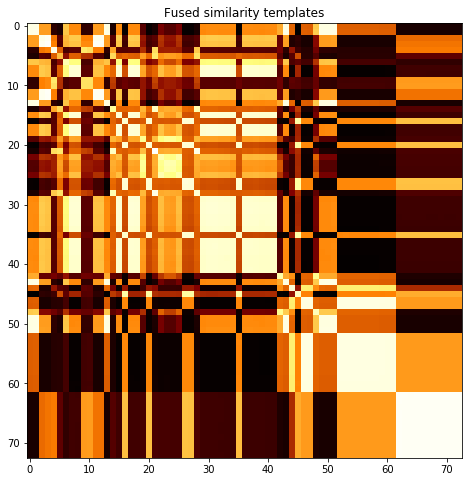

subject 12; gesture 1_0_1


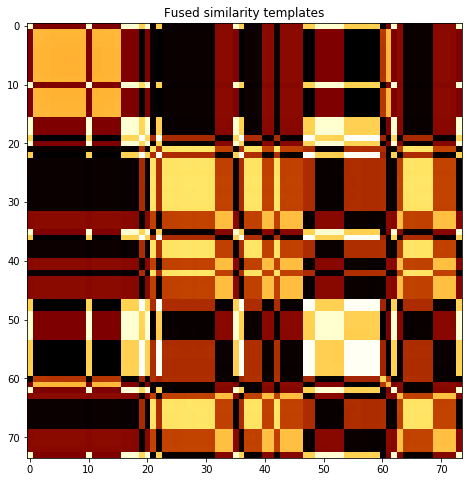

subject 12; gesture 3_1_1


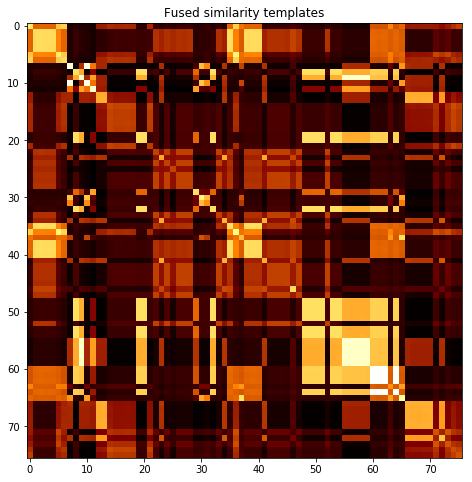

subject 12; gesture 1_0_2


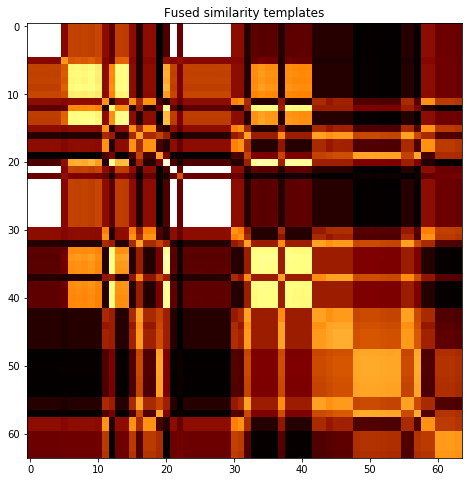

subject 12; gesture 4_0_2


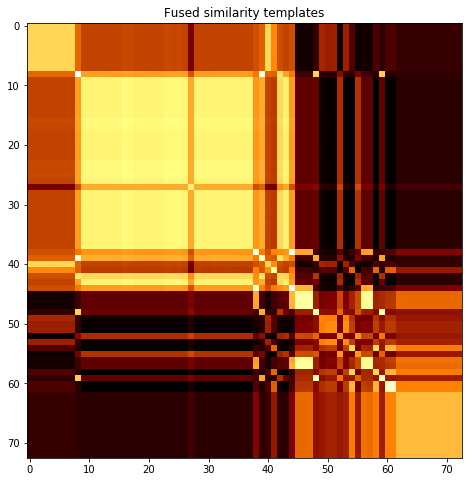

subject 19; gesture 3_0_1


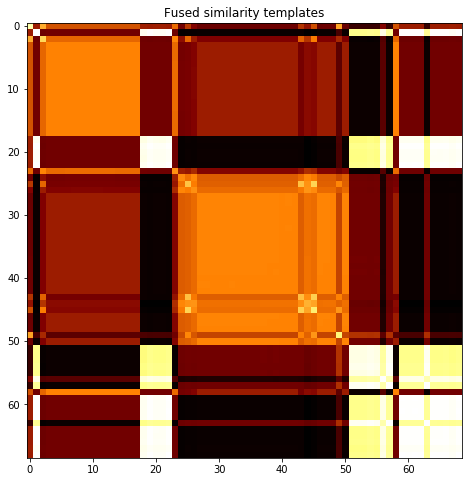

subject 19; gesture 4_1_1


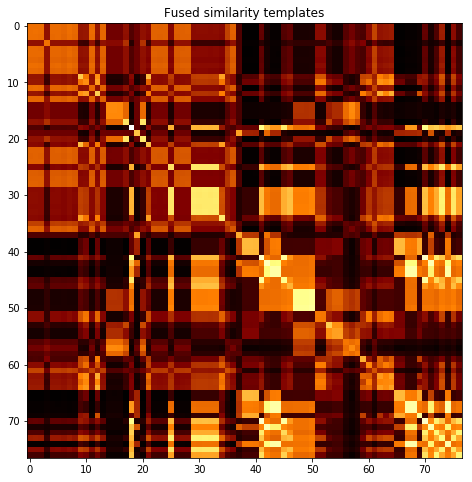

subject 19; gesture 2_0_1


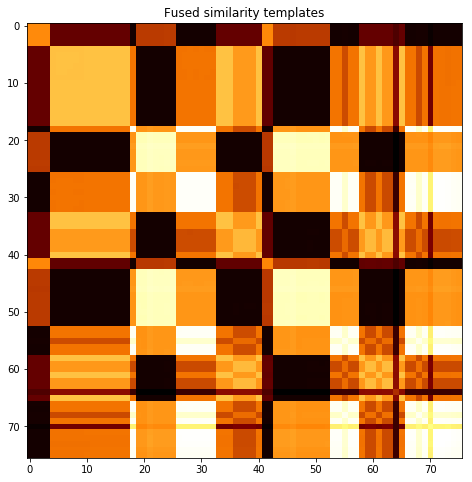

subject 19; gesture 4_1_2


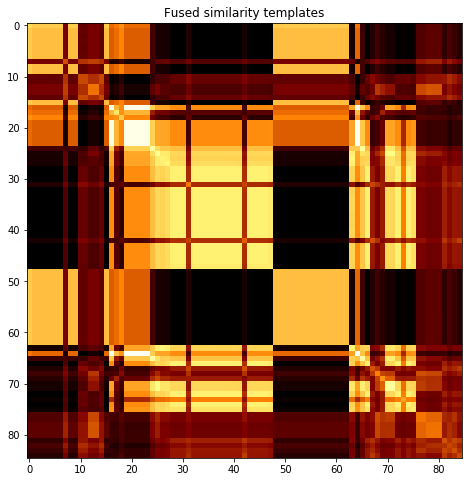

subject 19; gesture 2_0_2


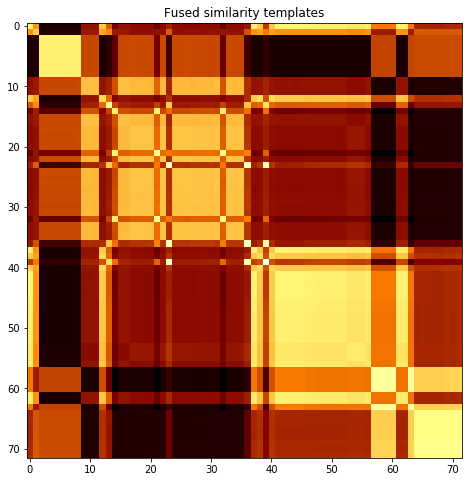

subject 19; gesture 1_1_2


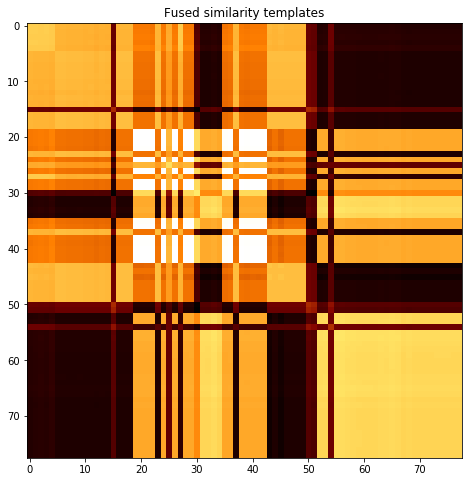

subject 19; gesture 2_1_2


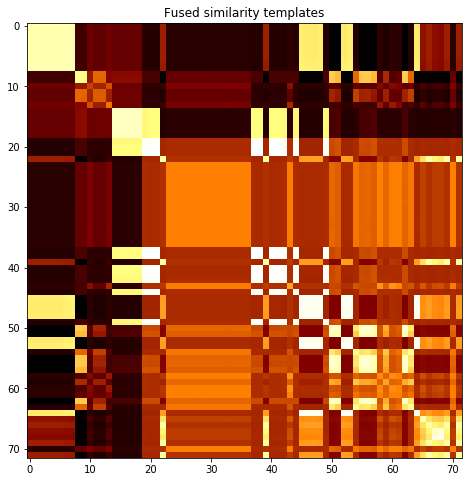

subject 19; gesture 4_0_1


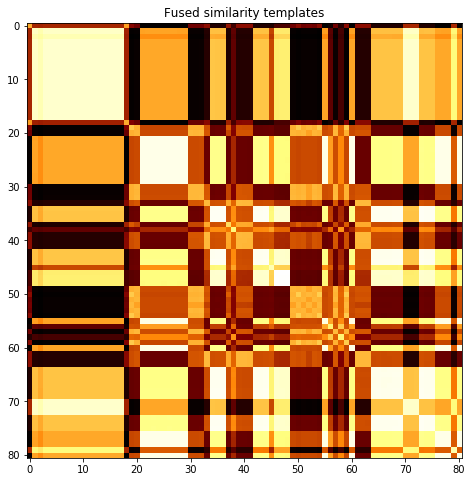

subject 19; gesture 3_0_2


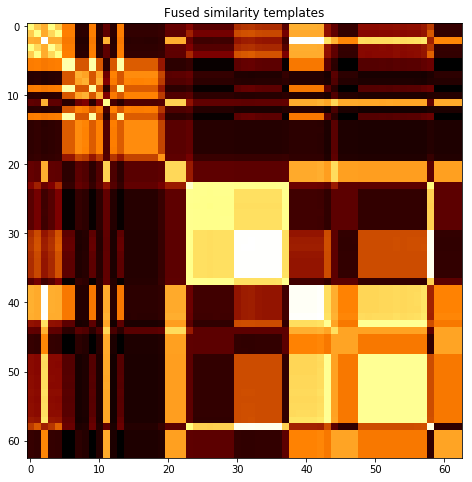

subject 19; gesture 1_1_1


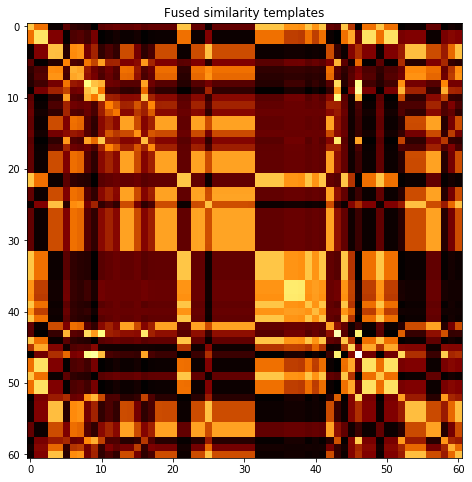

subject 19; gesture 3_1_2


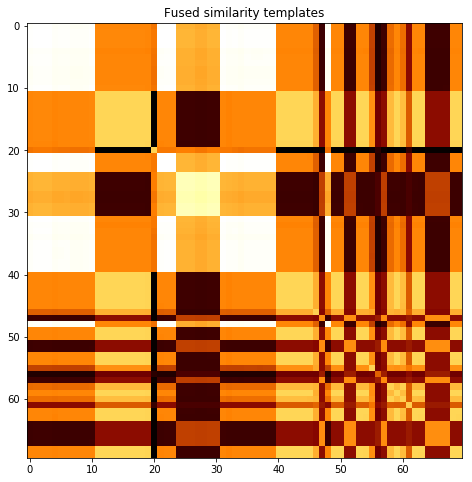

subject 19; gesture 2_1_1


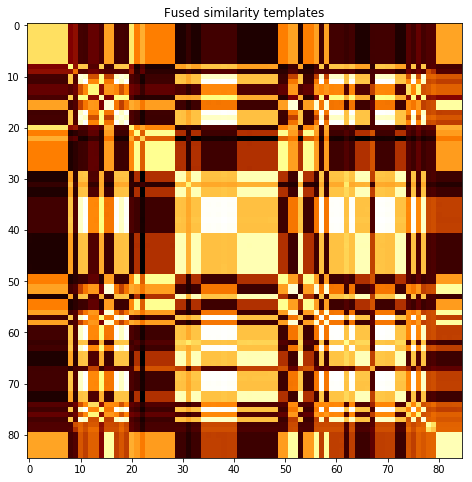

subject 19; gesture 1_0_1


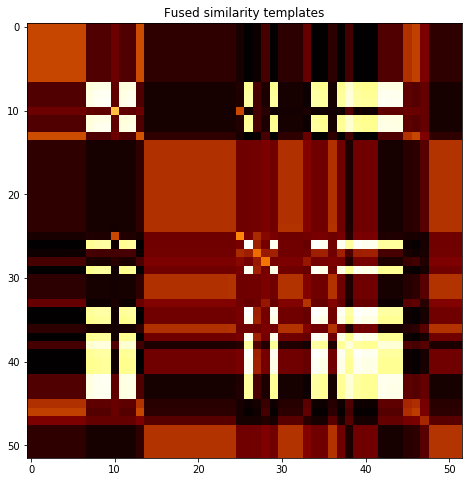

subject 19; gesture 3_1_1


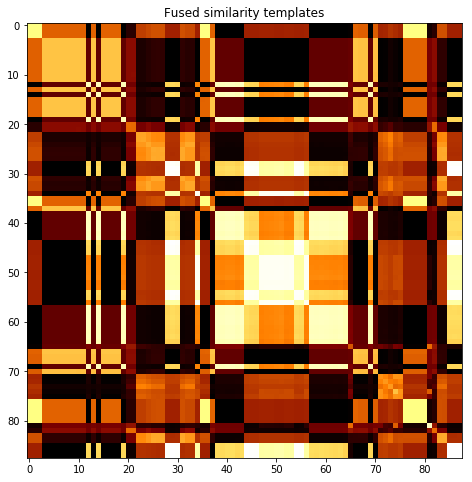

subject 19; gesture 1_0_2


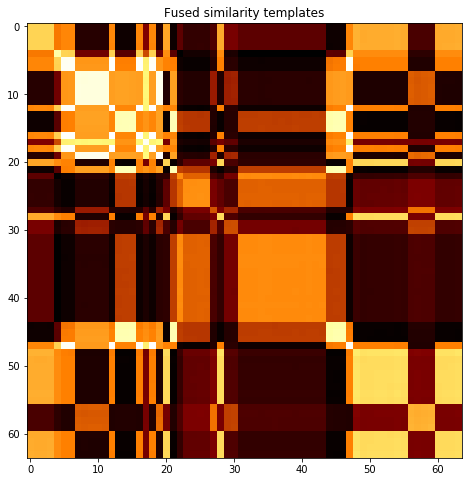

subject 19; gesture 4_0_2


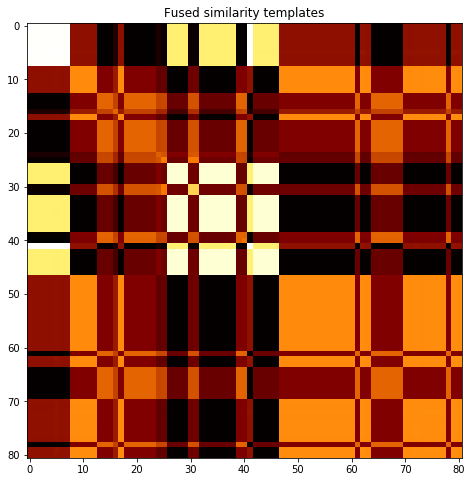

subject 07; gesture 3_0_1


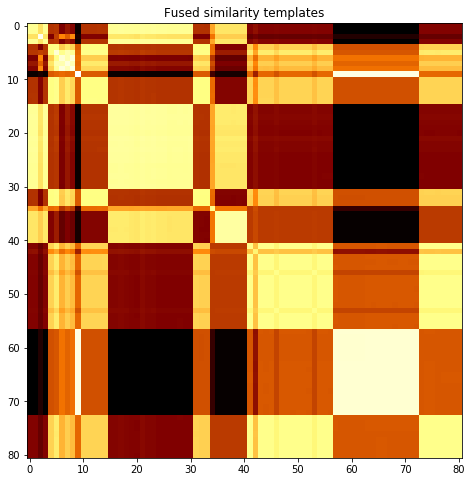

subject 07; gesture 4_1_1


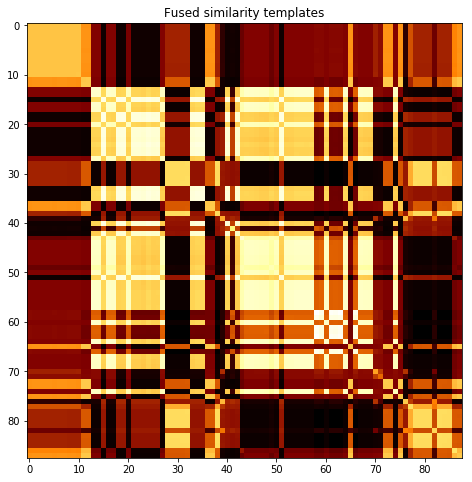

subject 07; gesture 2_0_1


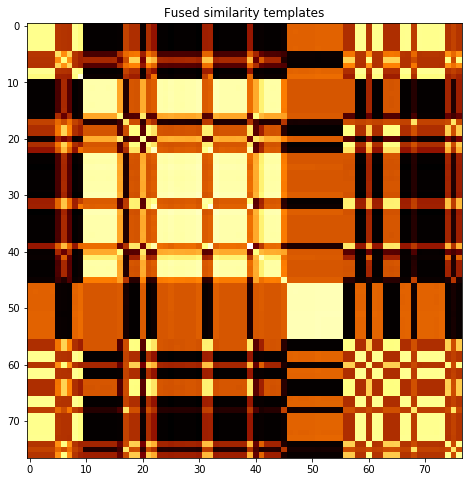

subject 07; gesture 4_1_2


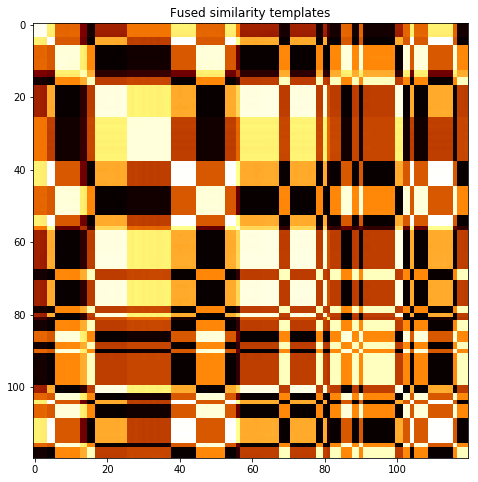

subject 07; gesture 2_0_2


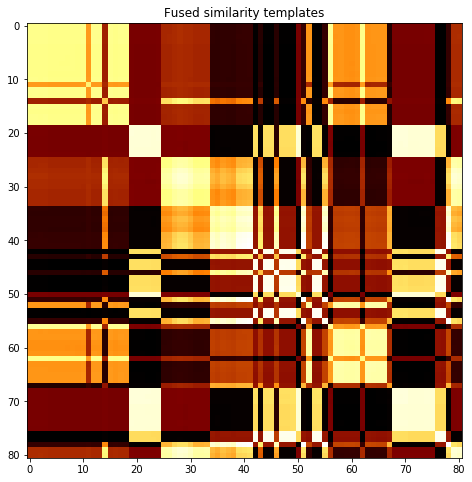

subject 07; gesture 1_1_2


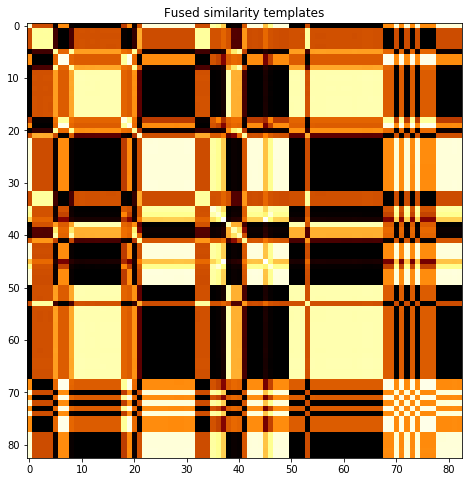

subject 07; gesture 2_1_2


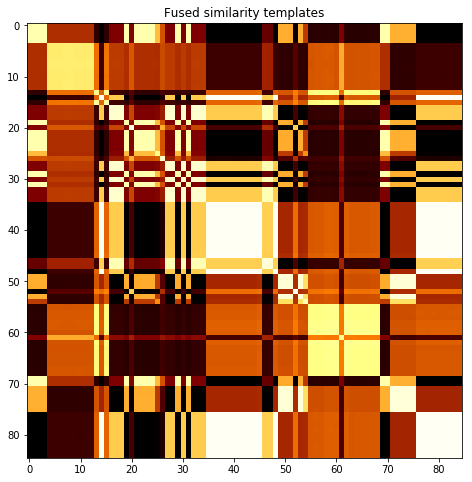

subject 07; gesture 4_0_1


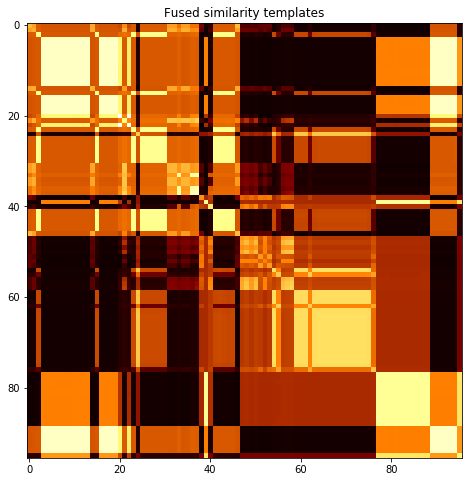

subject 07; gesture 3_0_2


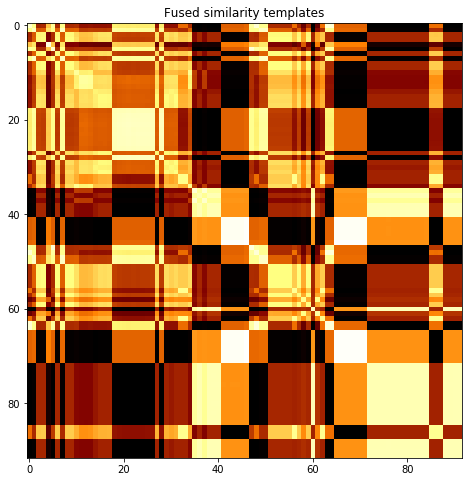

subject 07; gesture 1_1_1


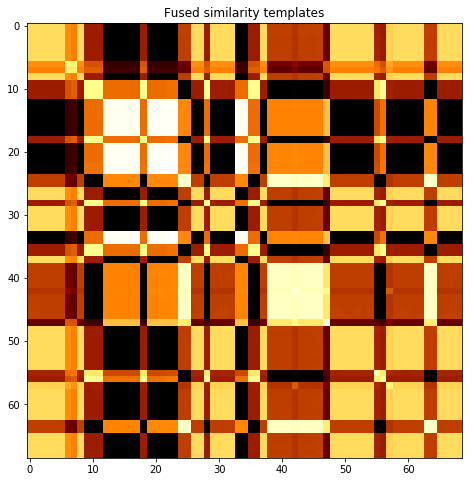

subject 07; gesture 3_1_2


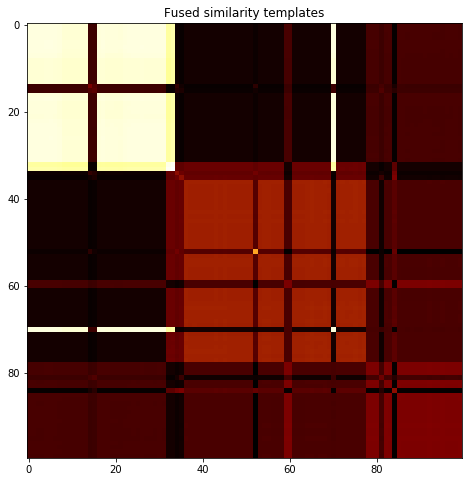

subject 07; gesture 2_1_1


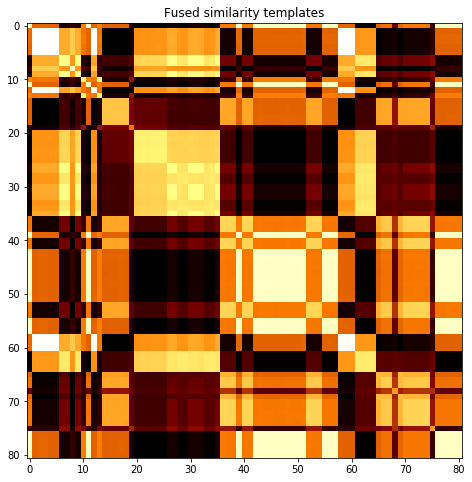

subject 07; gesture 1_0_1


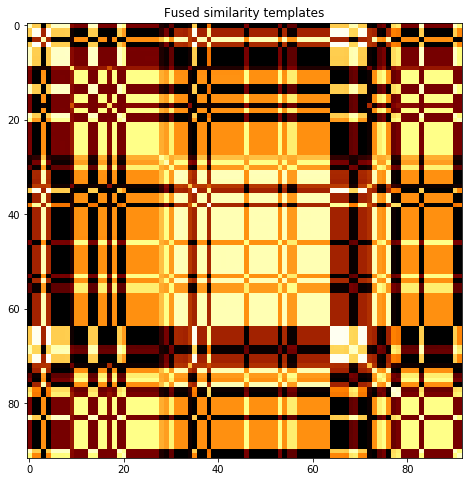

subject 07; gesture 3_1_1


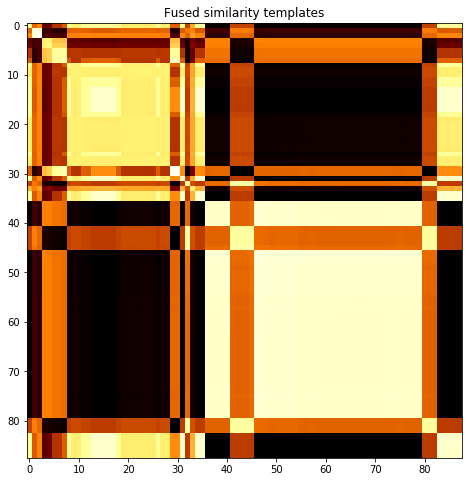

subject 07; gesture 1_0_2


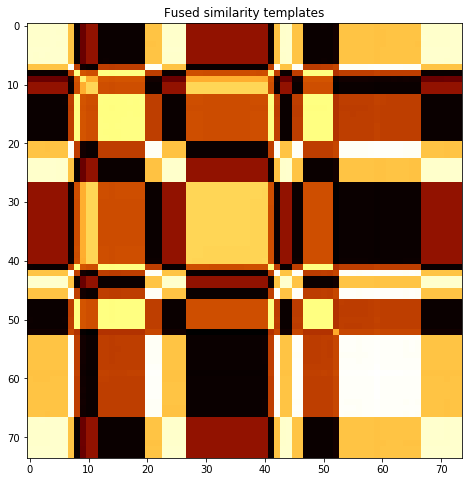

subject 07; gesture 4_0_2


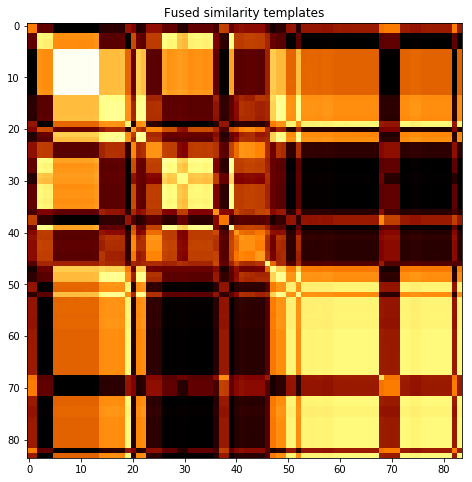

subject 20; gesture 3_0_1


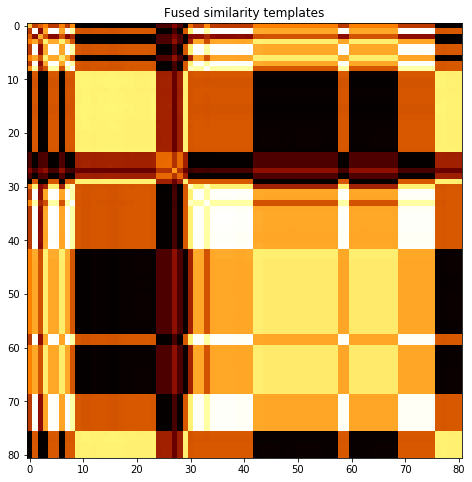

subject 20; gesture 4_1_1


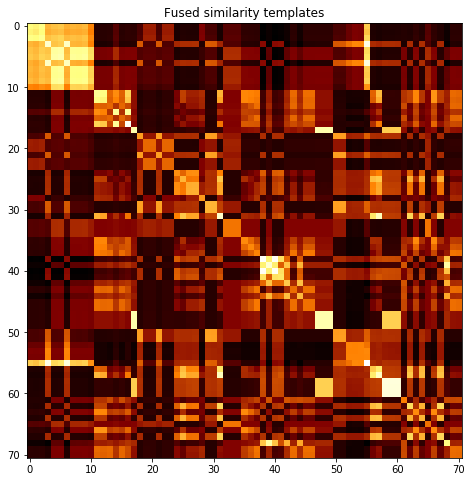

subject 20; gesture 2_0_1


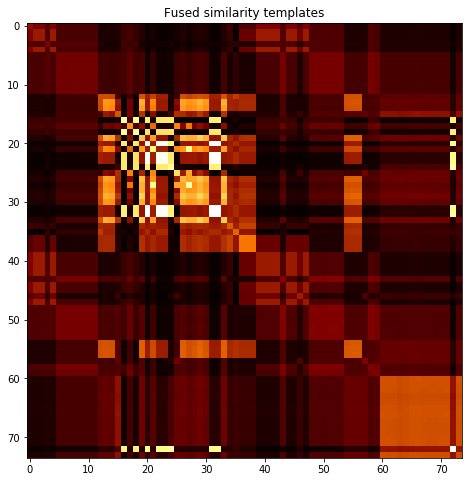

subject 20; gesture 4_1_2


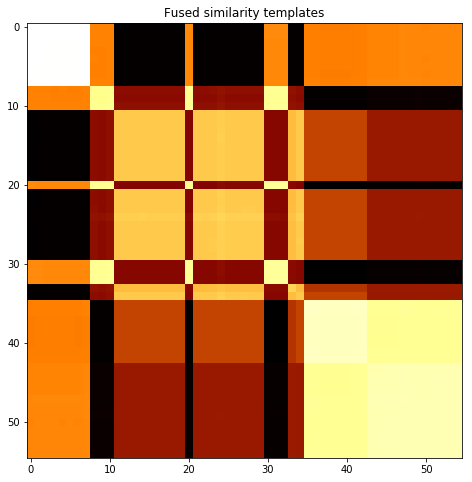

subject 20; gesture 2_0_2


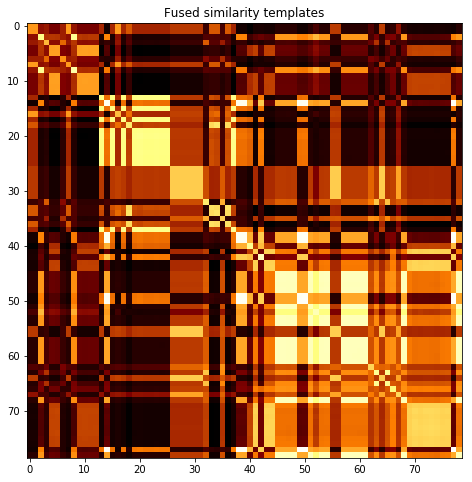

subject 20; gesture 1_1_2


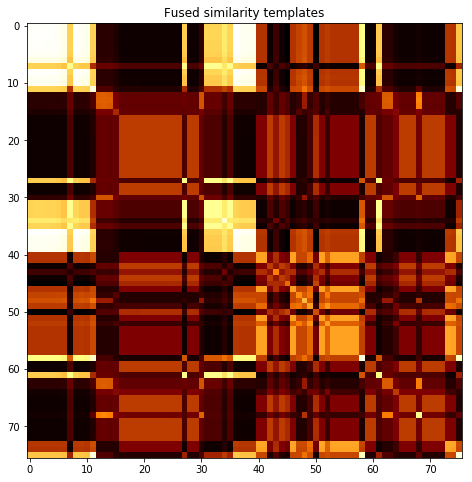

subject 20; gesture 2_1_2


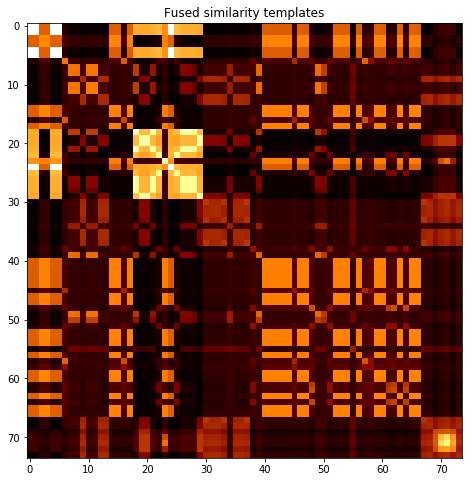

subject 20; gesture 4_0_1


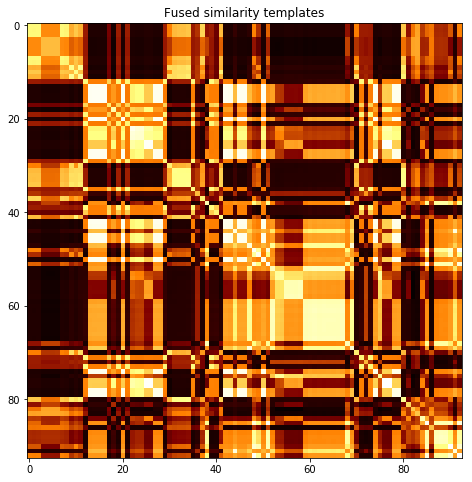

subject 20; gesture 3_0_2


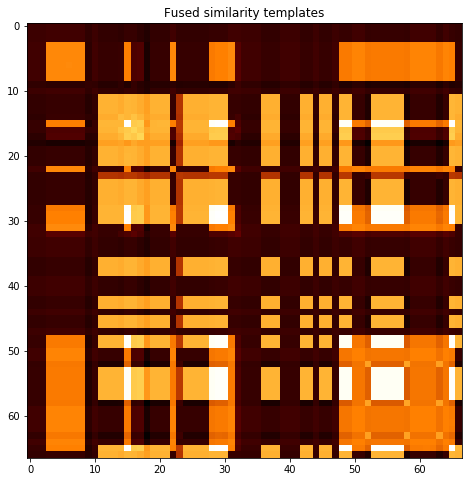

subject 20; gesture 1_1_1


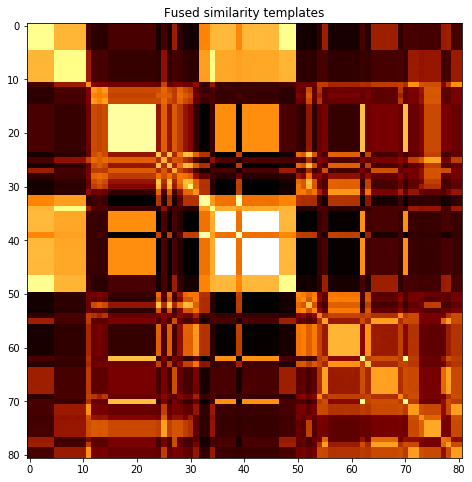

subject 20; gesture 3_1_2


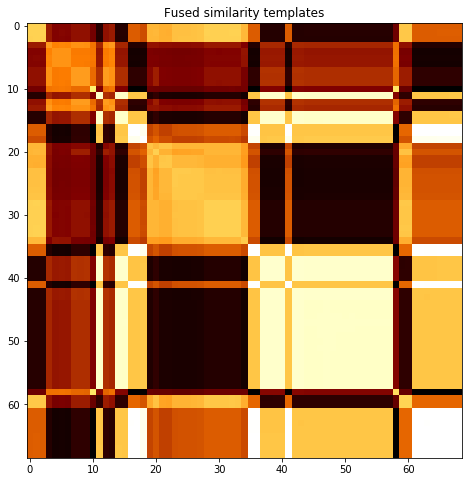

subject 20; gesture 2_1_1


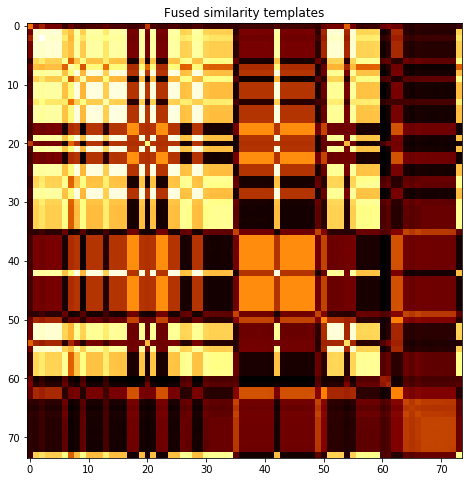

subject 20; gesture 1_0_1


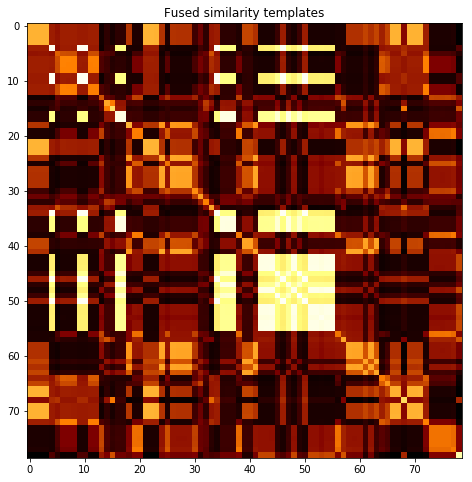

subject 20; gesture 3_1_1


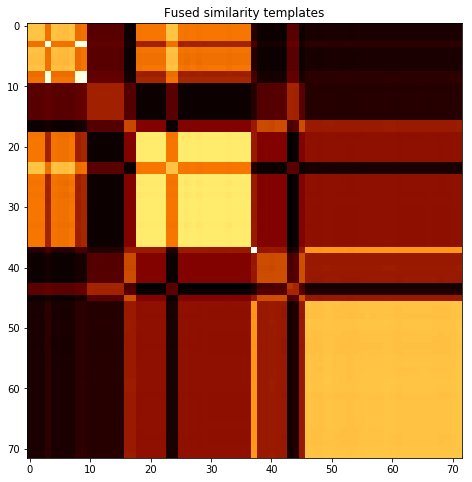

subject 20; gesture 1_0_2


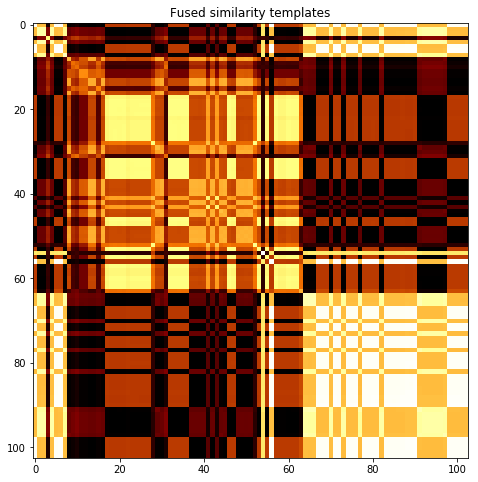

subject 20; gesture 4_0_2


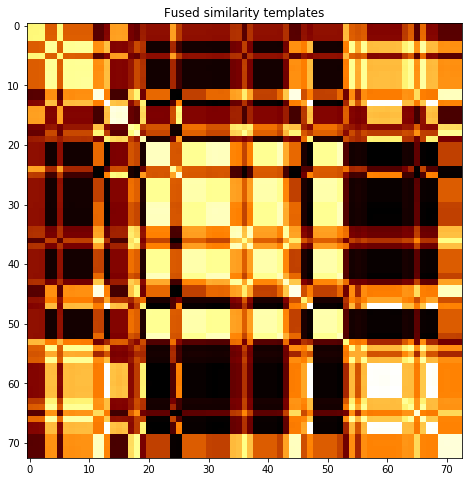

subject 31; gesture 3_0_1


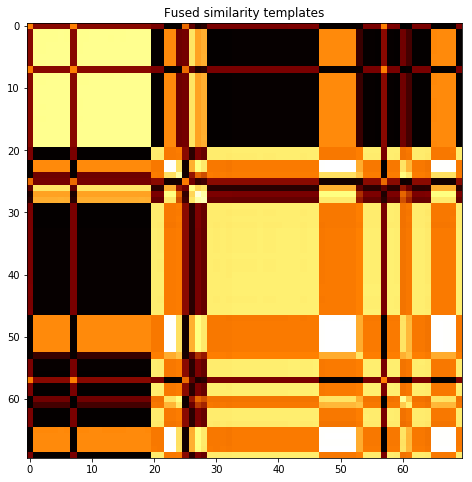

subject 31; gesture 4_1_1


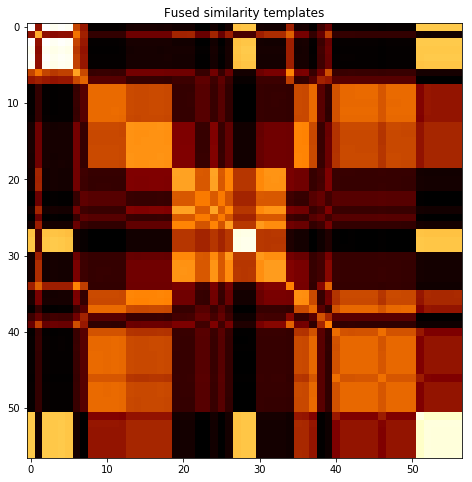

subject 31; gesture 2_0_1


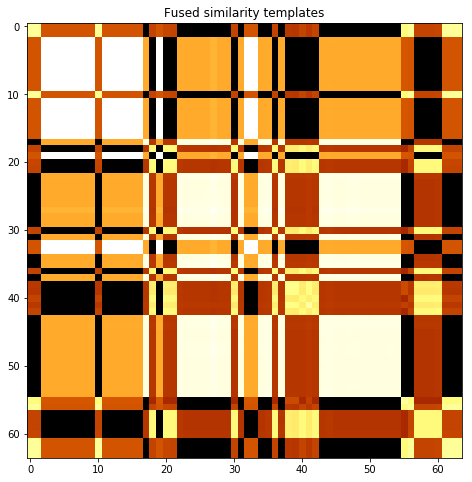

subject 31; gesture 4_1_2


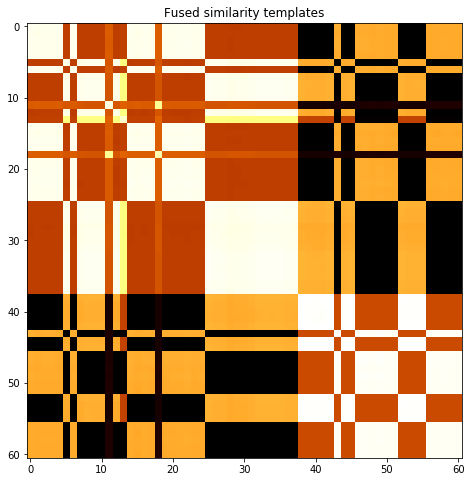

subject 31; gesture 2_0_2


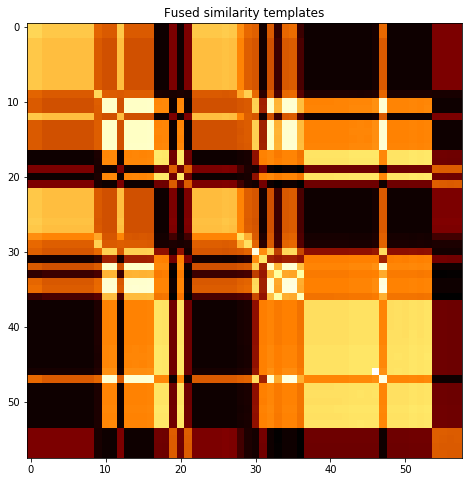

subject 31; gesture 1_1_2


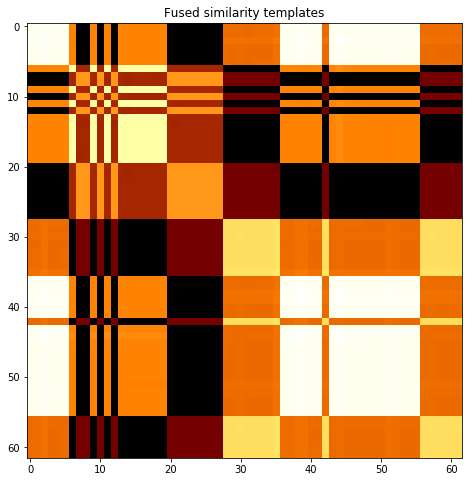

subject 31; gesture 2_1_2


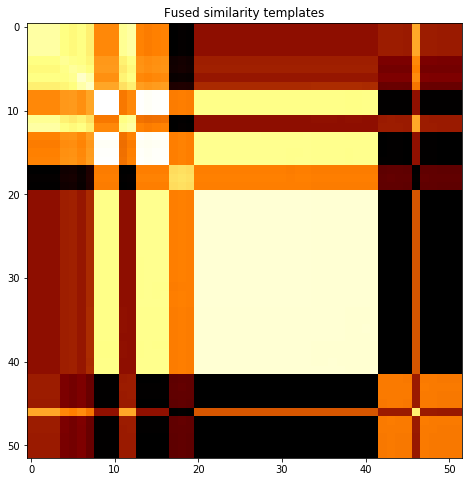

subject 31; gesture 4_0_1


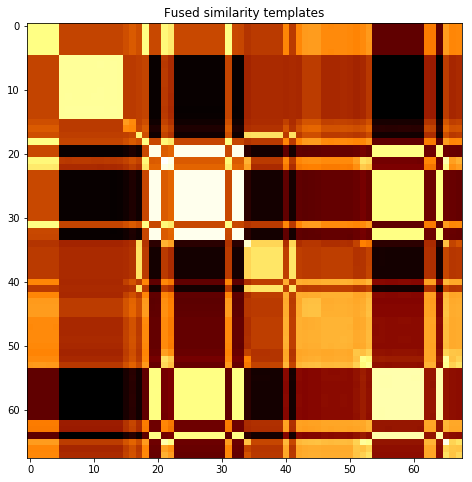

subject 31; gesture 3_0_2


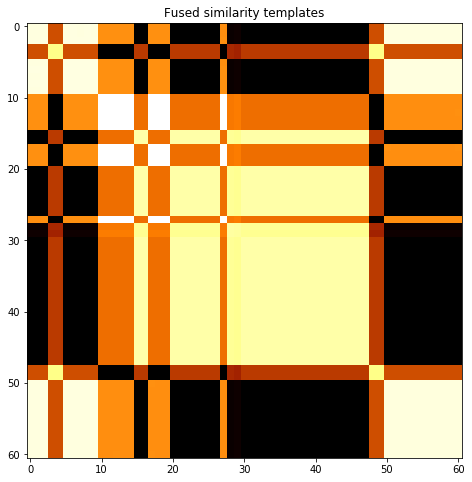

subject 31; gesture 1_1_1


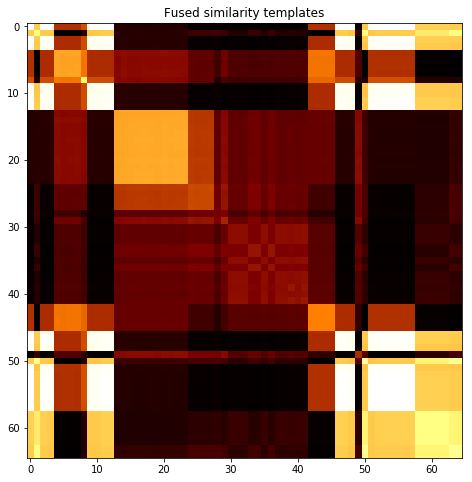

subject 31; gesture 3_1_2


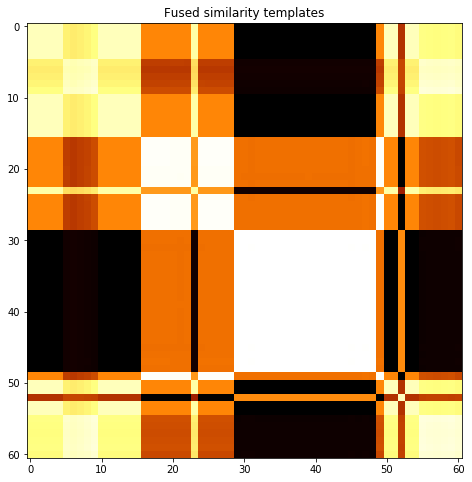

subject 31; gesture 2_1_1


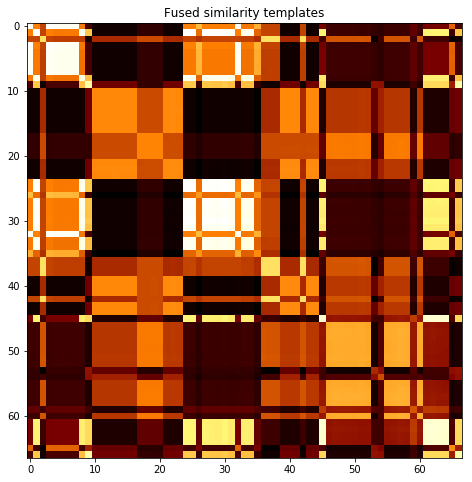

subject 31; gesture 1_0_1


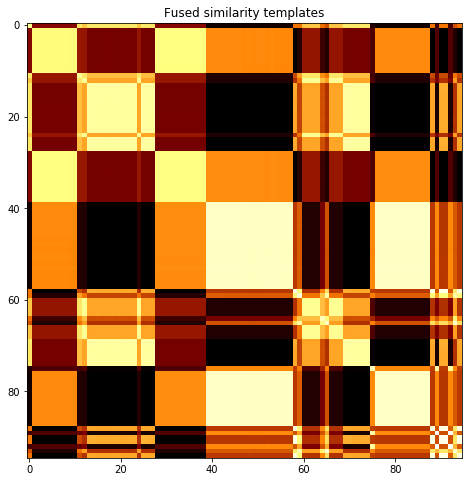

subject 31; gesture 3_1_1


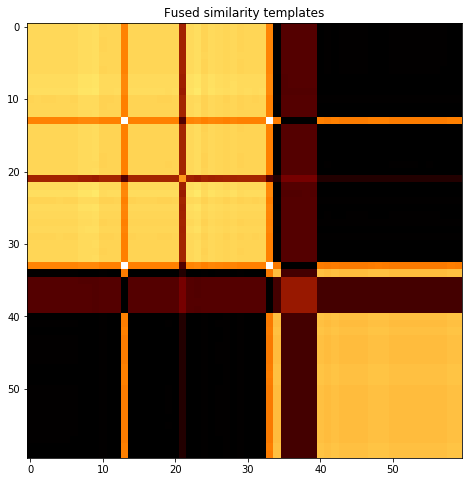

subject 31; gesture 1_0_2


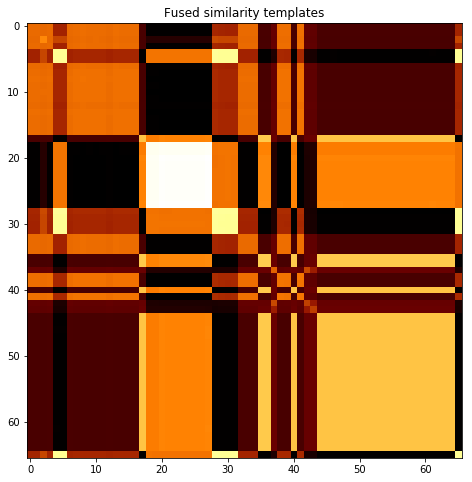

subject 31; gesture 4_0_2


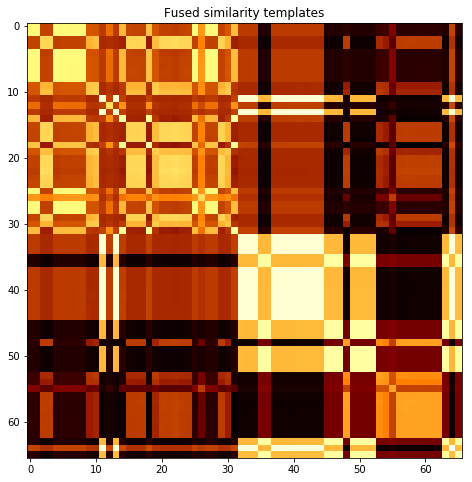

subject 13; gesture 3_0_1


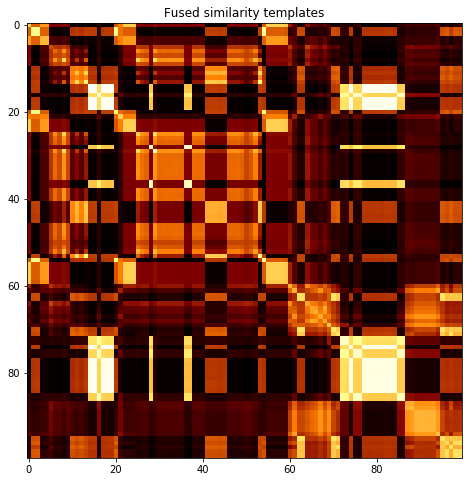

subject 13; gesture 4_1_1


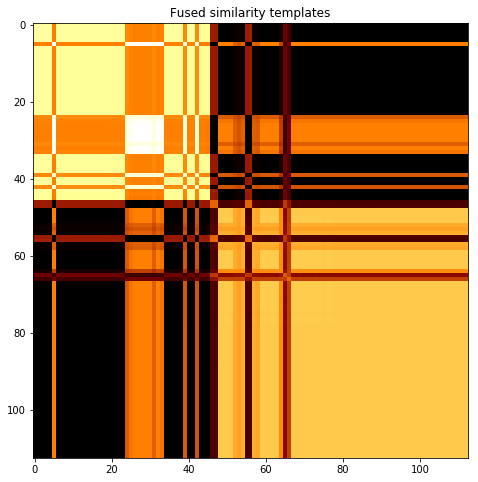

subject 13; gesture 2_0_1


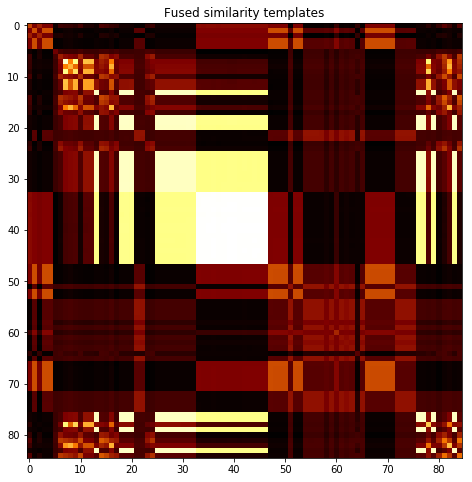

subject 13; gesture 4_1_2


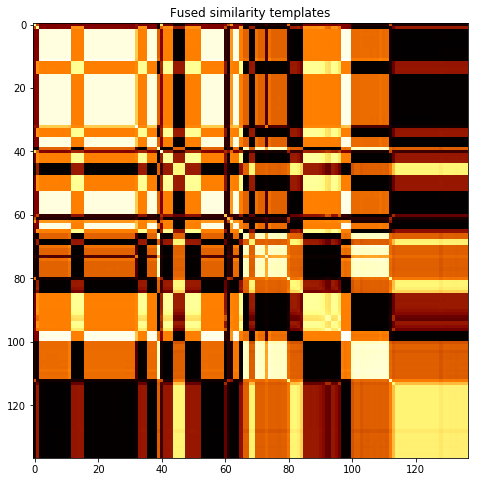

subject 13; gesture 2_0_2


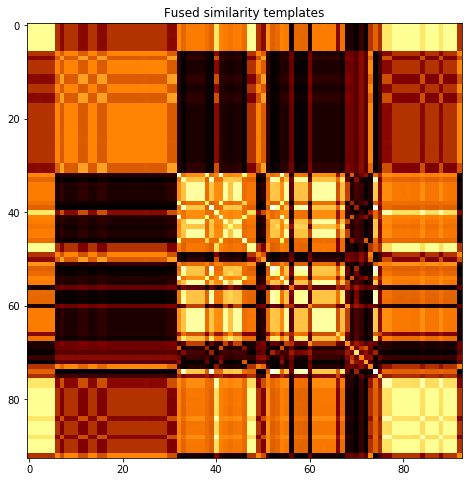

subject 13; gesture 1_1_2


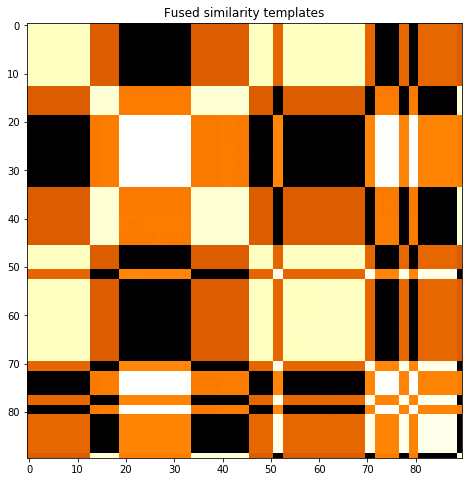

subject 13; gesture 2_1_2


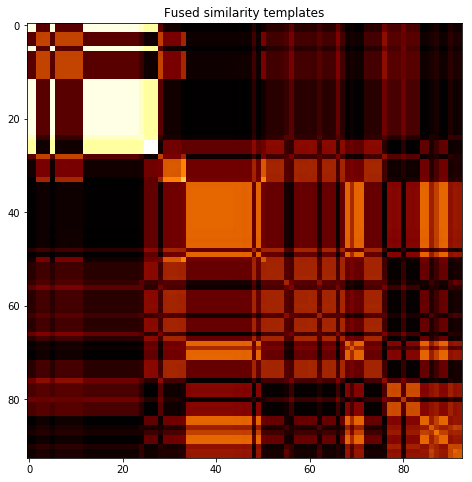

subject 13; gesture 4_0_1


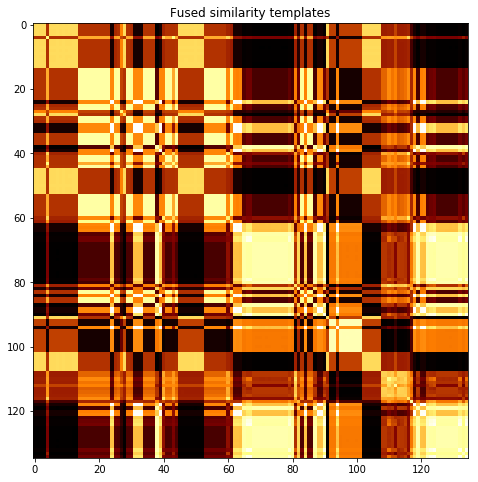

subject 13; gesture 3_0_2


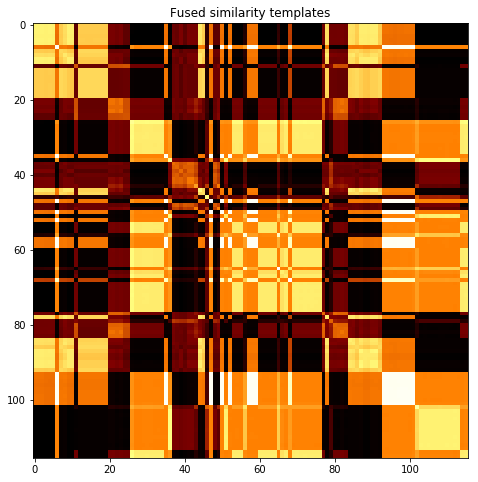

subject 13; gesture 1_1_1


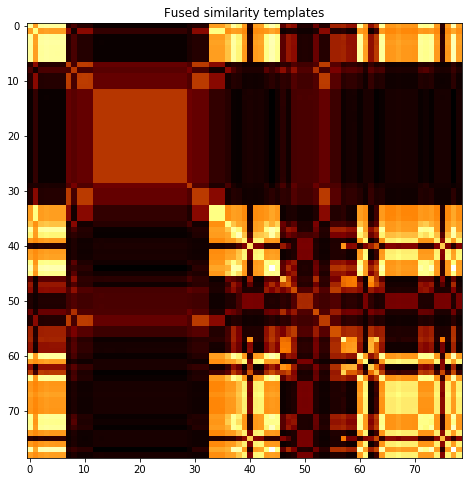

subject 13; gesture 3_1_2


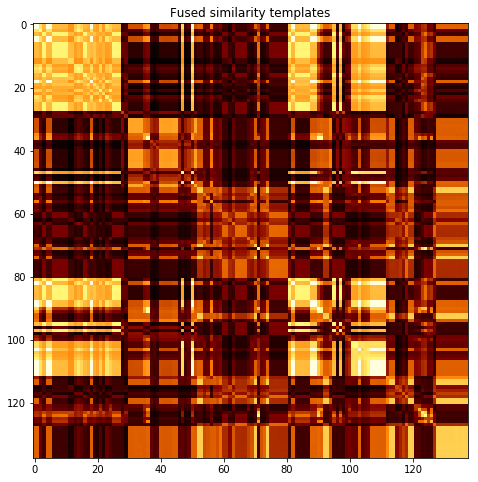

subject 13; gesture 2_1_1


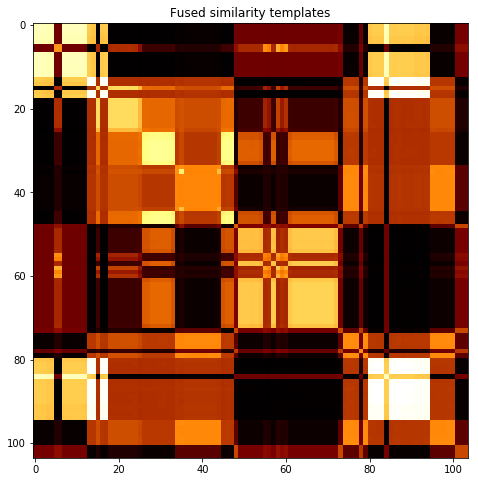

subject 13; gesture 1_0_1


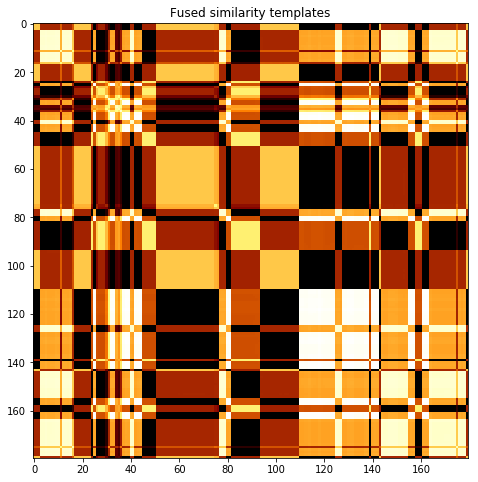

subject 13; gesture 3_1_1


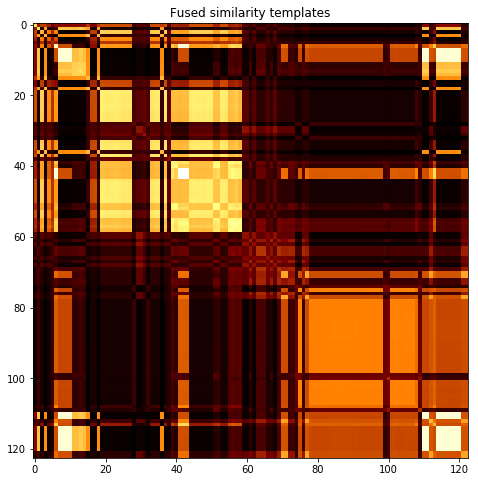

subject 13; gesture 1_0_2


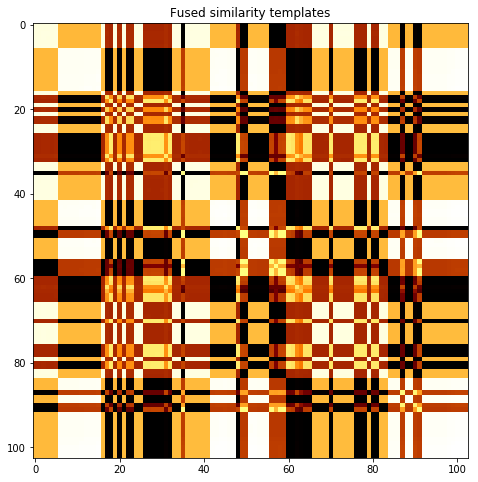

subject 13; gesture 4_0_2


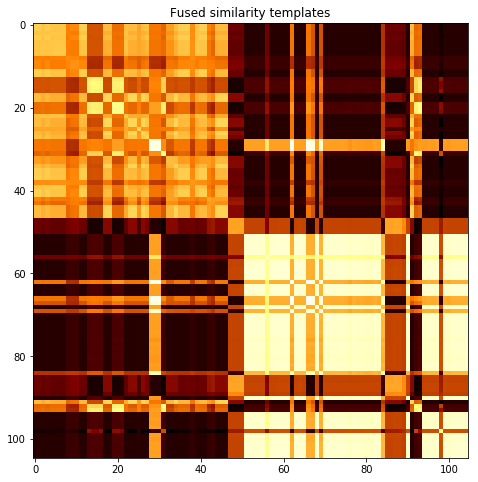

subject 36; gesture 3_0_1


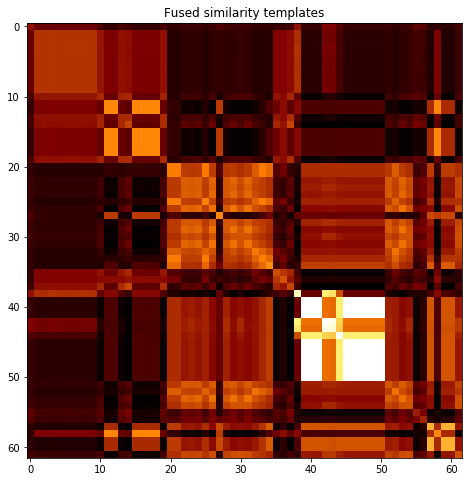

subject 36; gesture 4_1_1


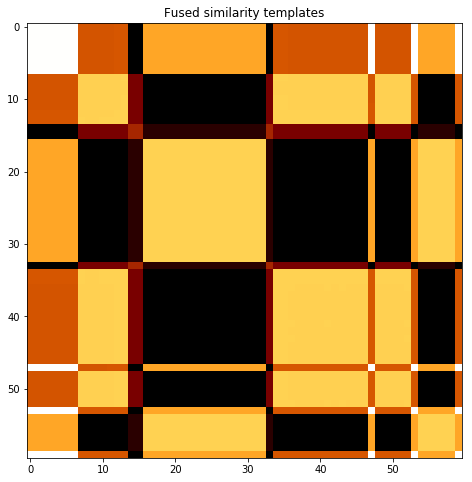

subject 36; gesture 2_0_1


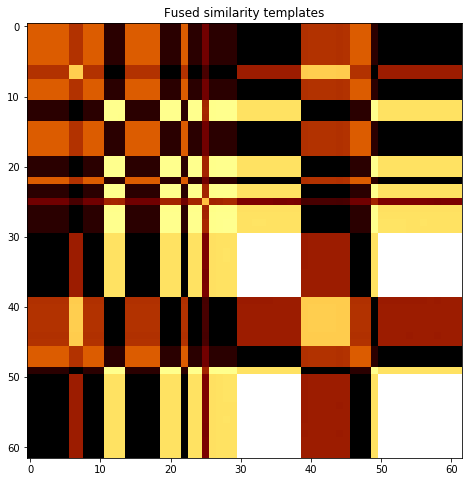

subject 36; gesture 4_1_2


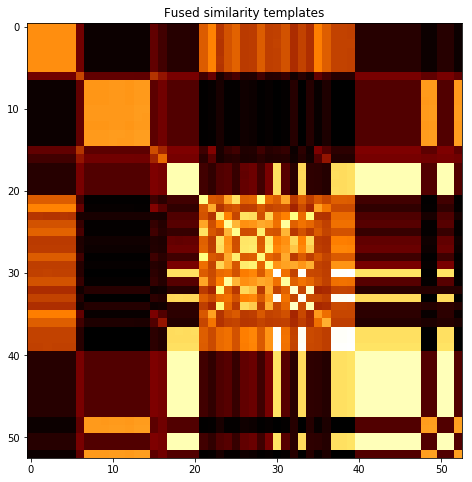

subject 36; gesture 2_0_2


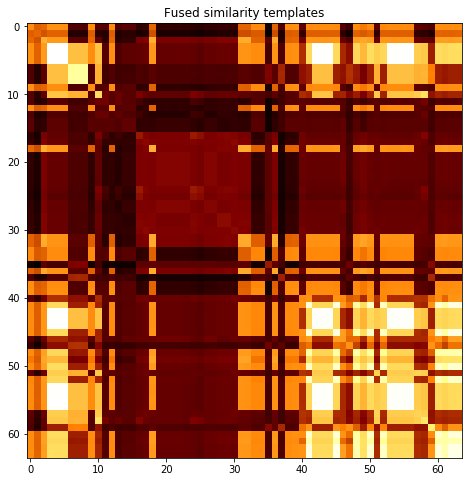

subject 36; gesture 1_1_2


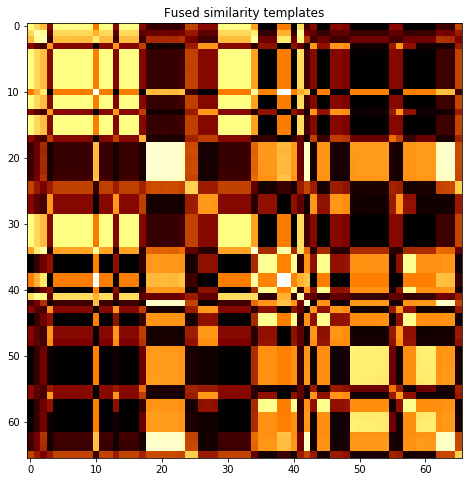

subject 36; gesture 2_1_2


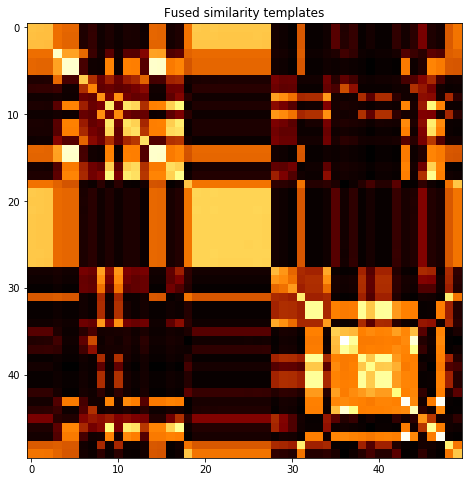

subject 36; gesture 4_0_1


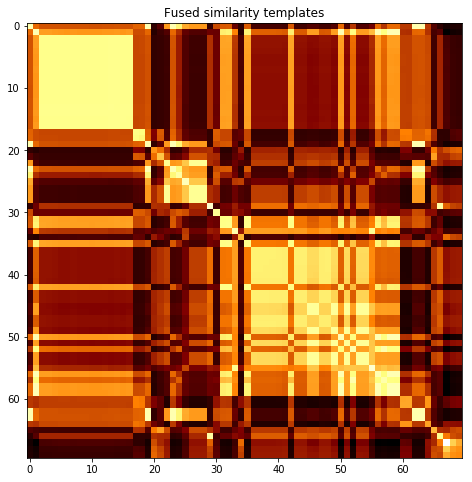

subject 36; gesture 3_0_2


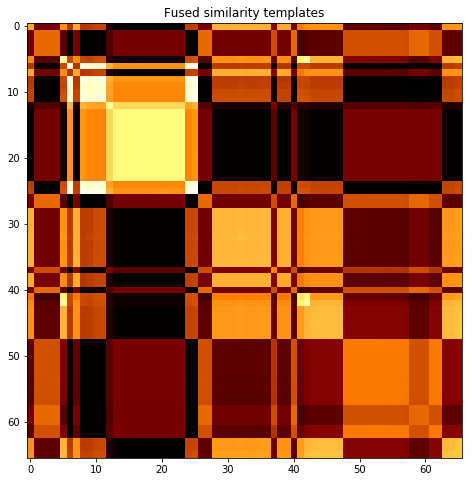

subject 36; gesture 1_1_1


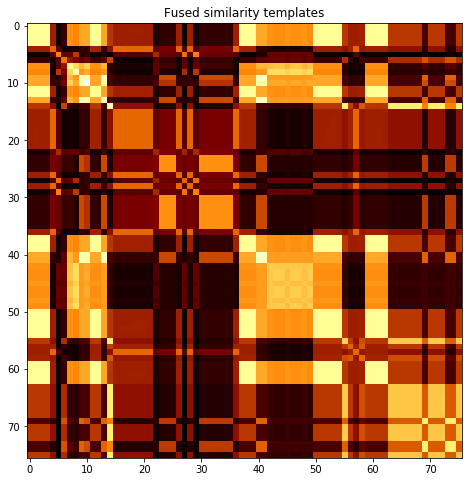

subject 36; gesture 3_1_2


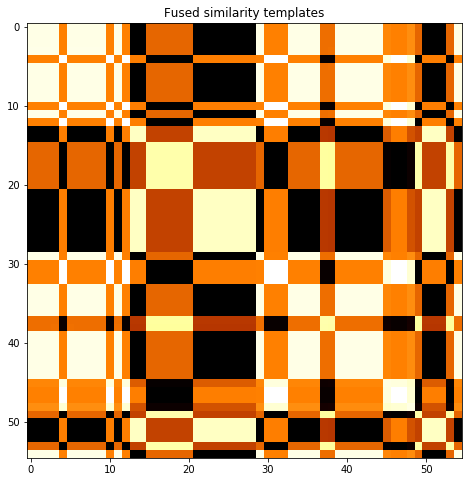

subject 36; gesture 2_1_1


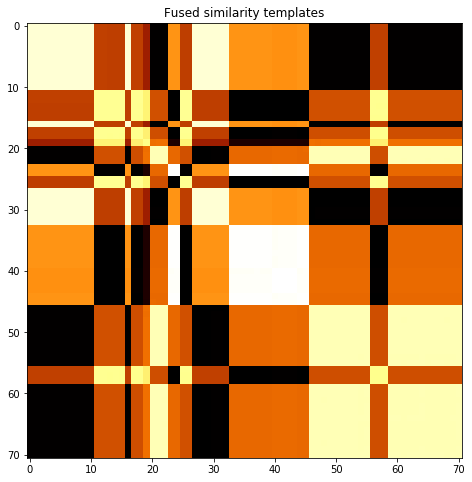

subject 36; gesture 1_0_1


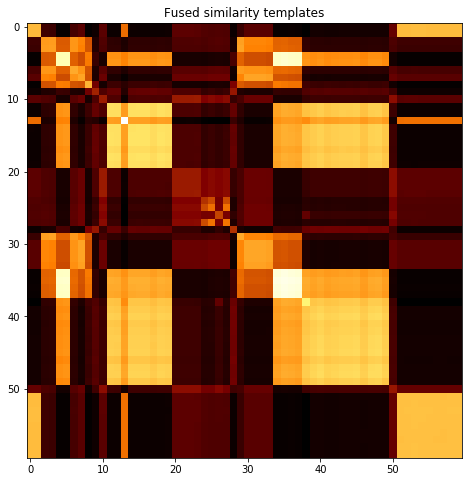

subject 36; gesture 3_1_1


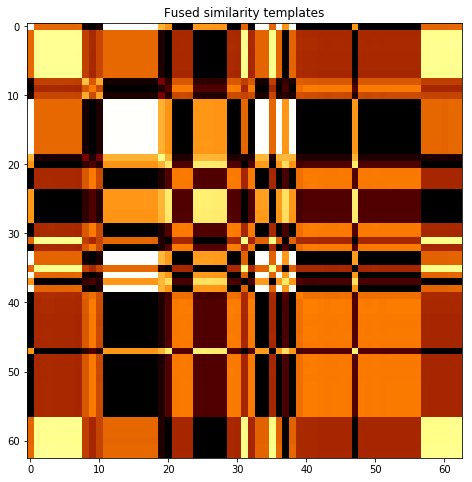

subject 36; gesture 1_0_2


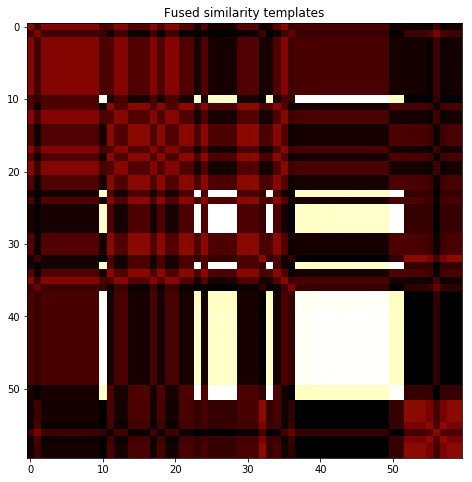

subject 36; gesture 4_0_2


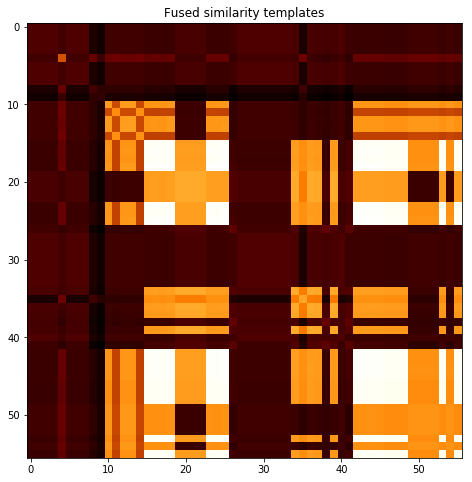

subject 24; gesture 3_0_1


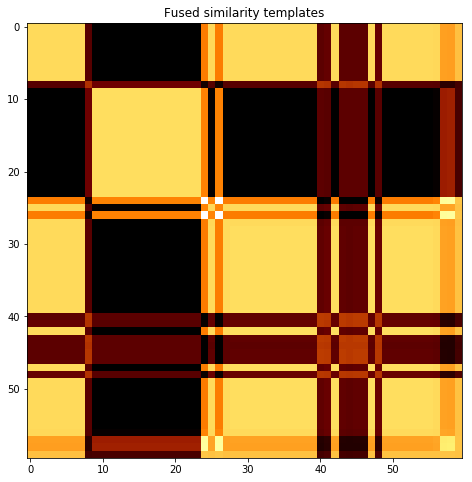

subject 24; gesture 4_1_1


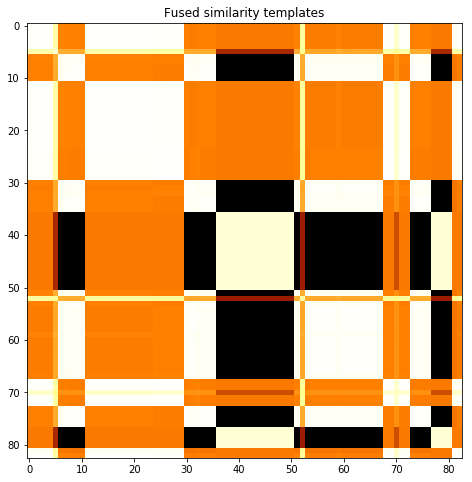

subject 24; gesture 2_0_1


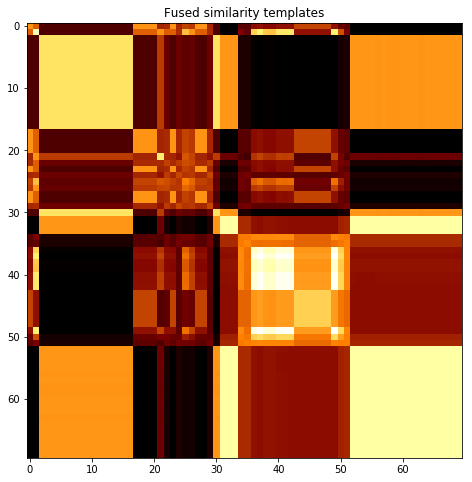

subject 24; gesture 4_1_2


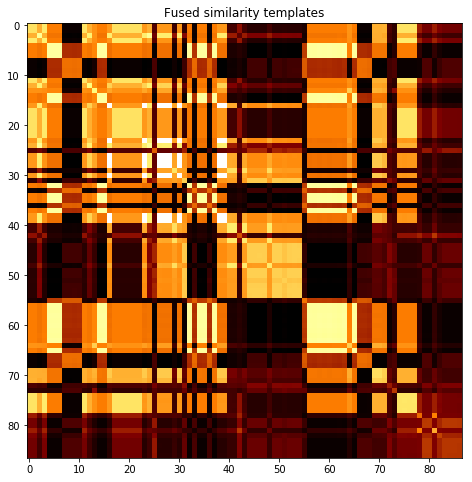

subject 24; gesture 2_0_2


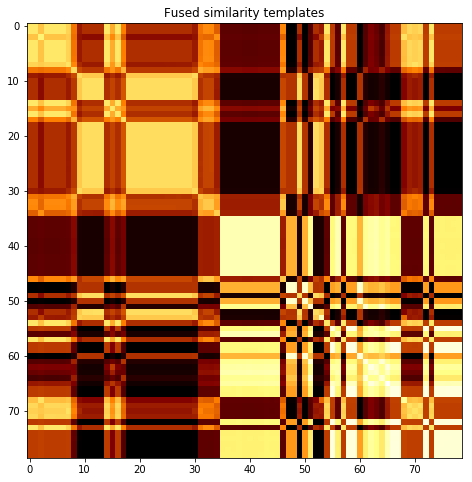

subject 24; gesture 1_1_2


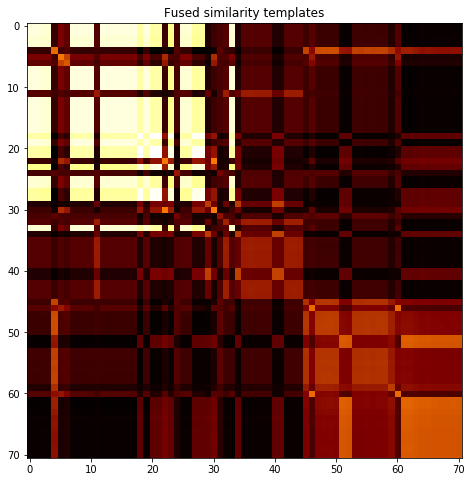

subject 24; gesture 2_1_2


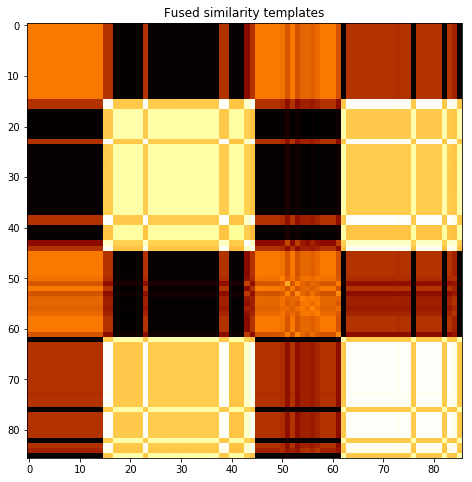

subject 24; gesture 4_0_1


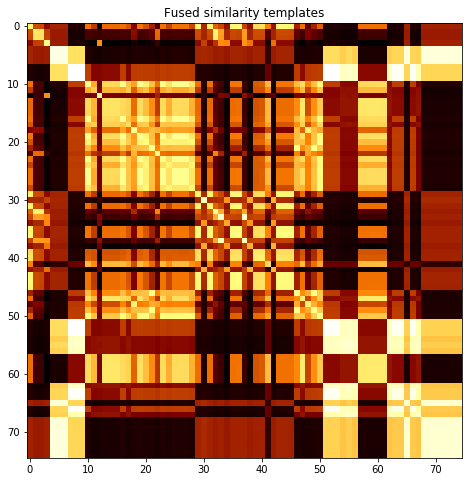

subject 24; gesture 3_0_2


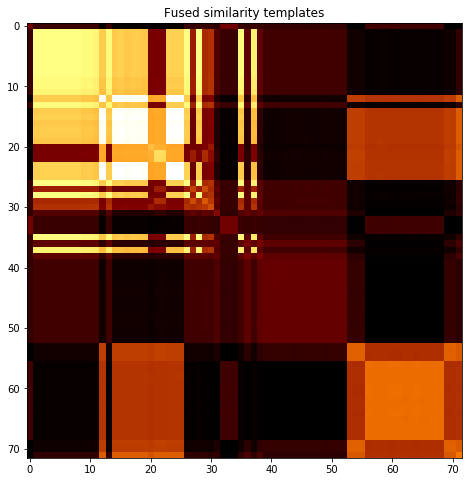

subject 24; gesture 1_1_1


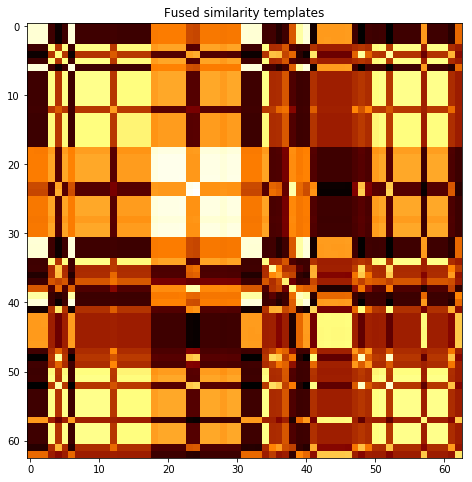

subject 24; gesture 3_1_2


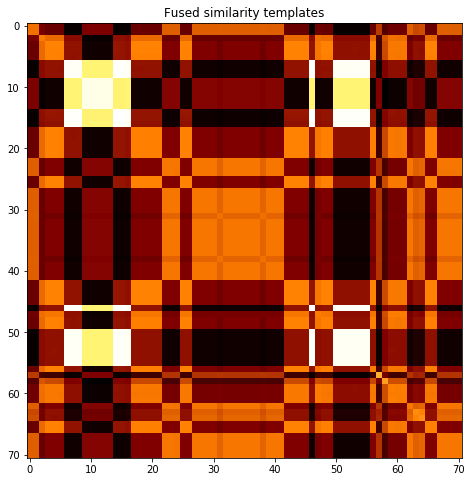

subject 24; gesture 2_1_1


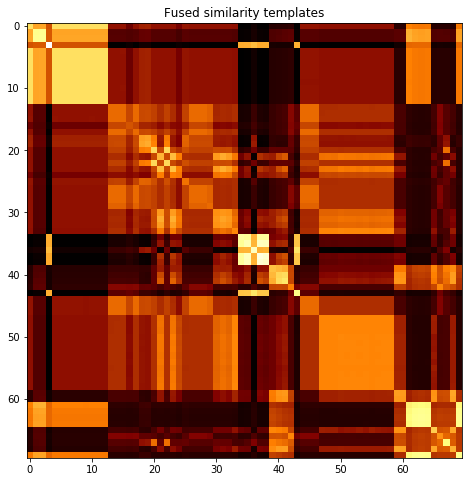

subject 24; gesture 1_0_1


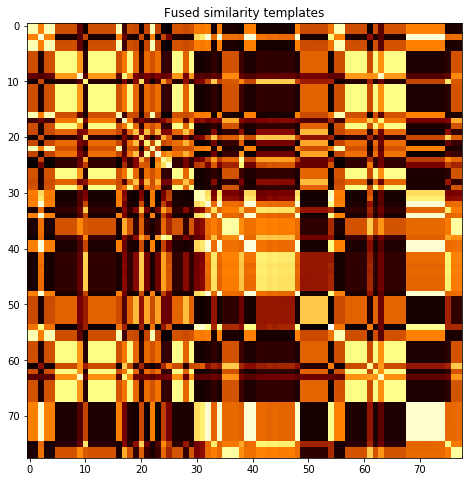

subject 24; gesture 3_1_1


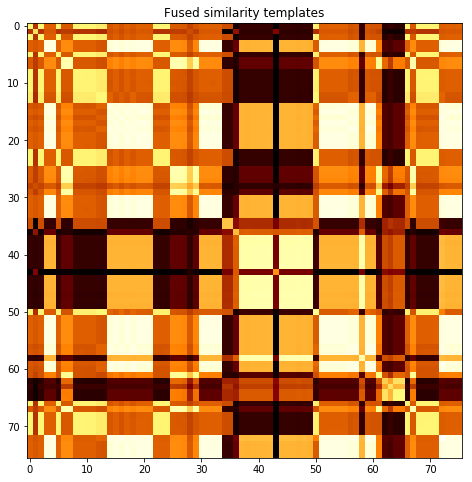

subject 24; gesture 1_0_2


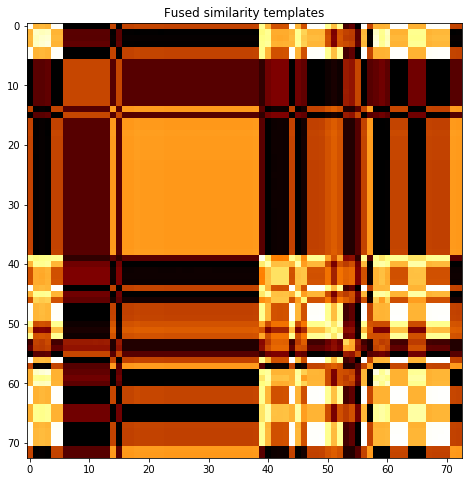

subject 24; gesture 4_0_2


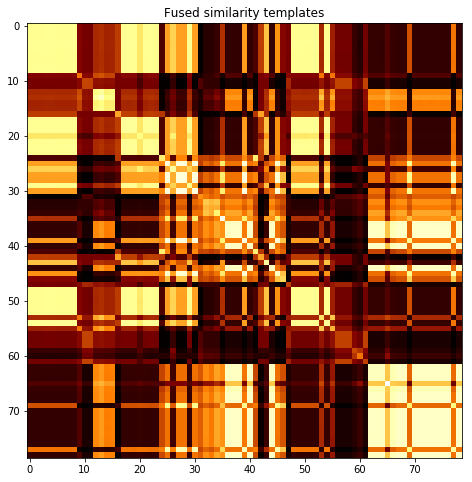

subject 33; gesture 3_0_1


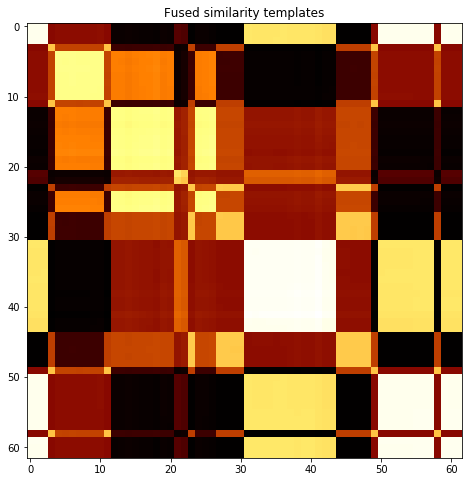

subject 33; gesture 4_1_1


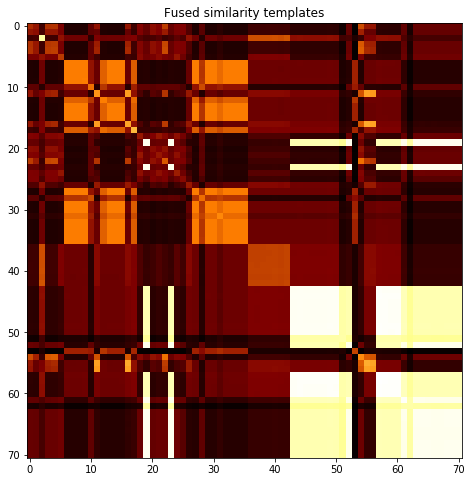

subject 33; gesture 2_0_1


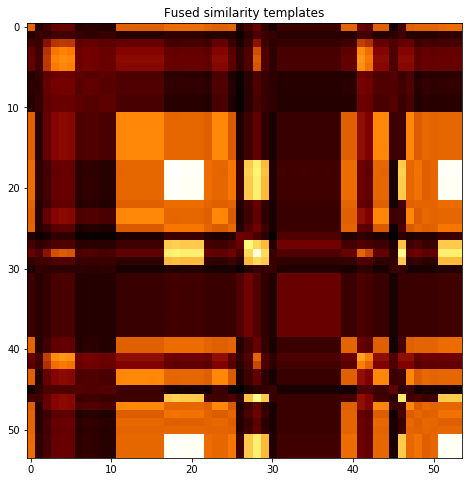

subject 33; gesture 4_1_2


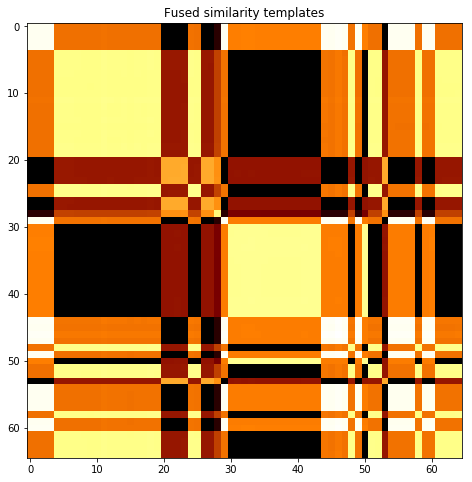

subject 33; gesture 2_0_2


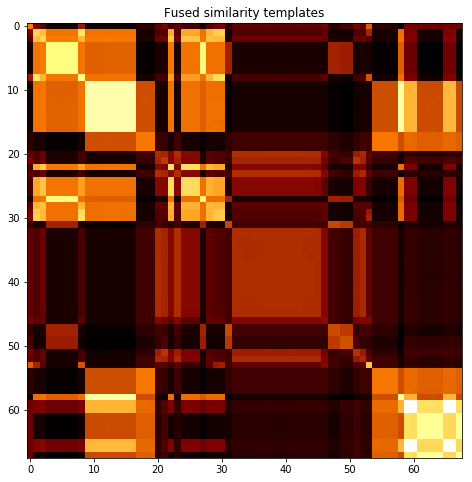

subject 33; gesture 1_1_2


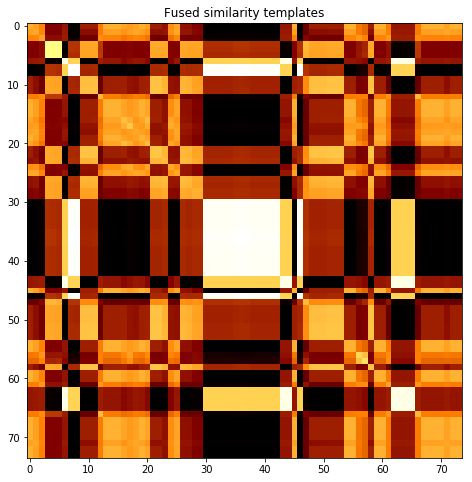

subject 33; gesture 2_1_2


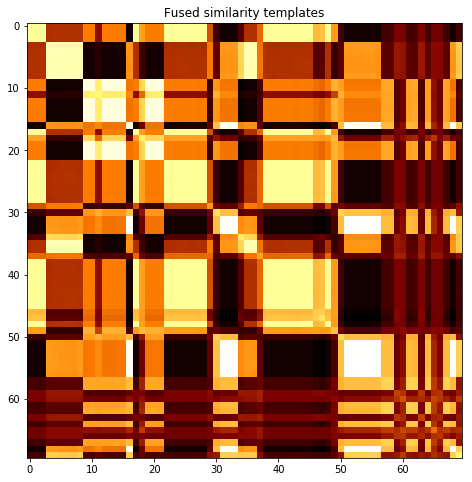

subject 33; gesture 4_0_1


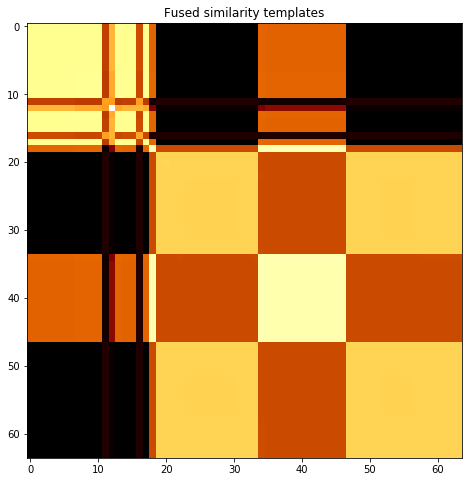

subject 33; gesture 3_0_2


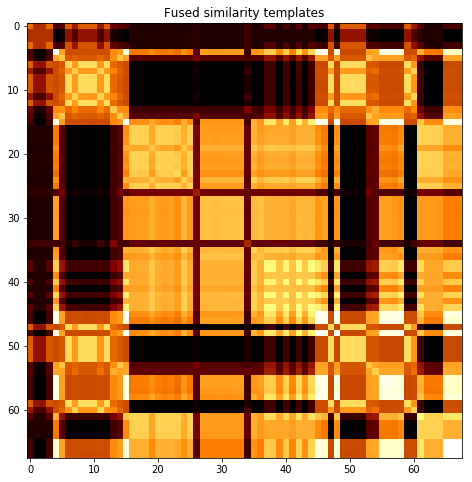

subject 33; gesture 1_1_1


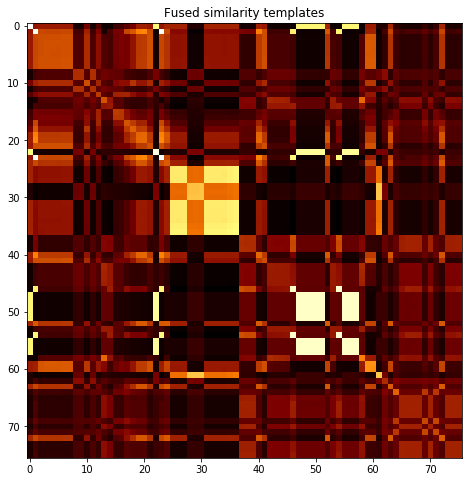

subject 33; gesture 3_1_2


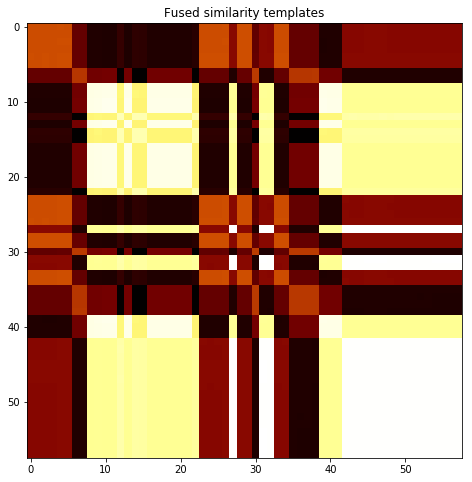

subject 33; gesture 2_1_1


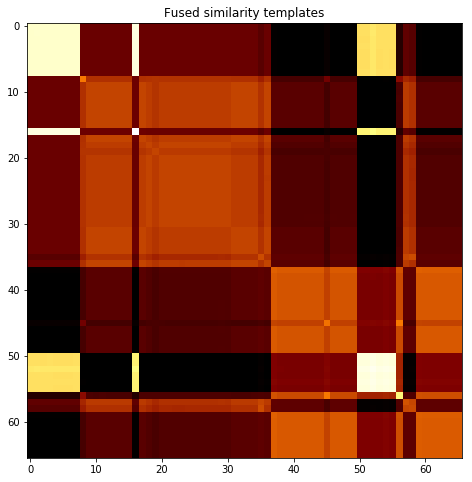

subject 33; gesture 1_0_1


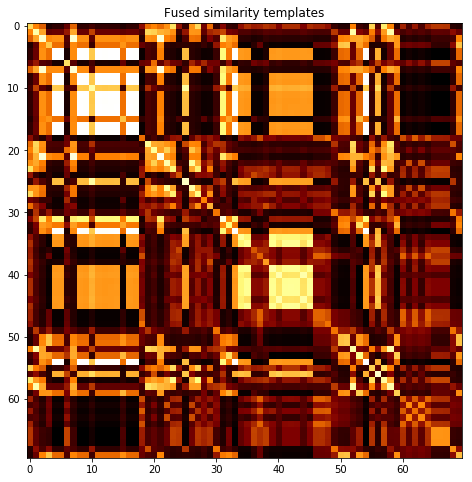

subject 33; gesture 3_1_1


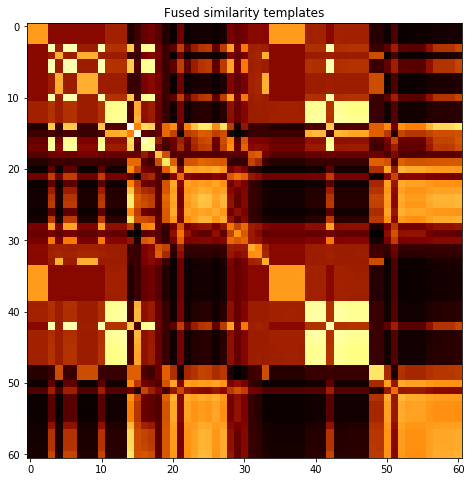

subject 33; gesture 1_0_2


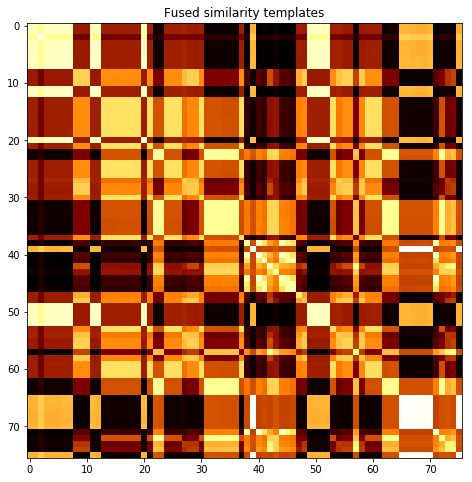

subject 33; gesture 4_0_2


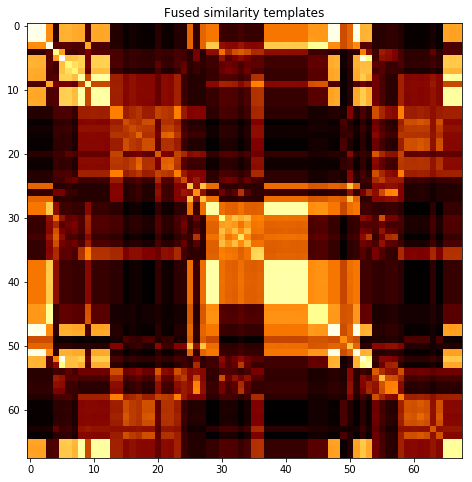

subject 11; gesture 3_0_1


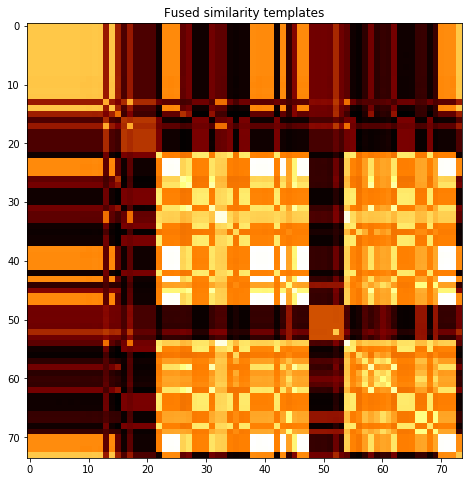

subject 11; gesture 4_1_1


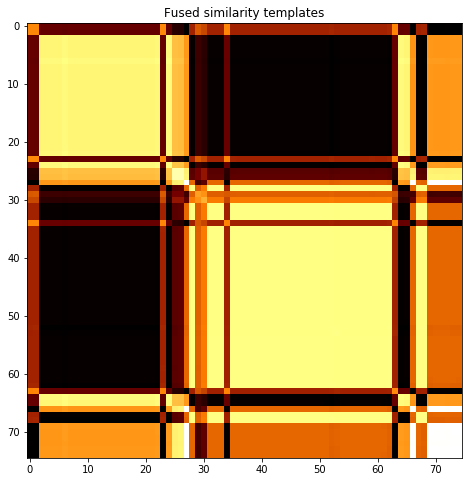

subject 11; gesture 2_0_1


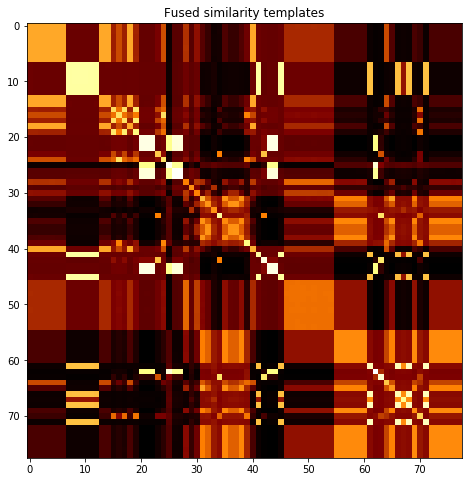

subject 11; gesture 4_1_2


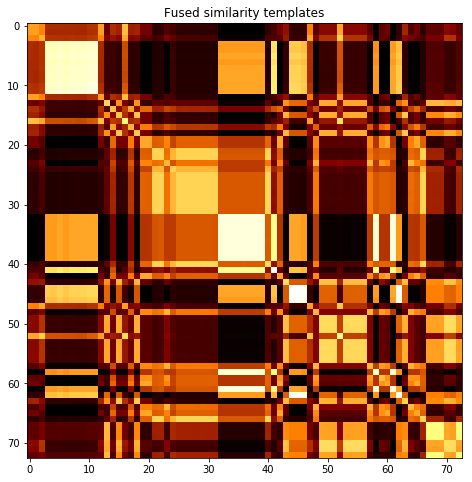

subject 11; gesture 2_0_2


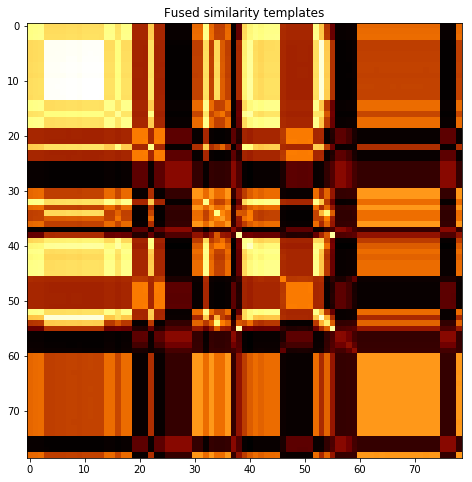

subject 11; gesture 1_1_2


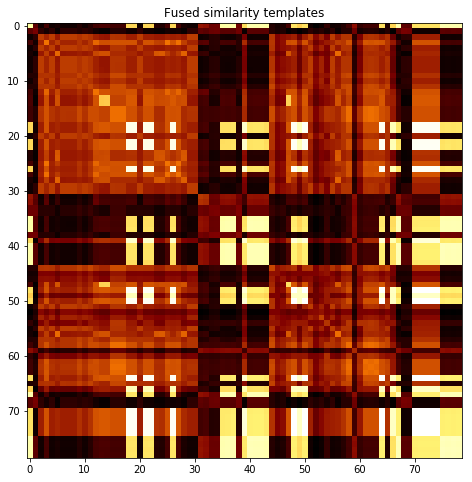

subject 11; gesture 2_1_2


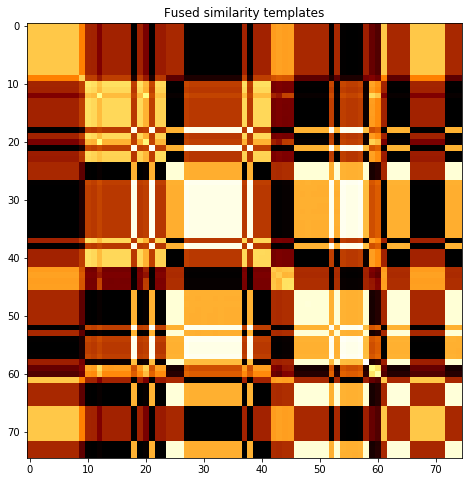

subject 11; gesture 4_0_1


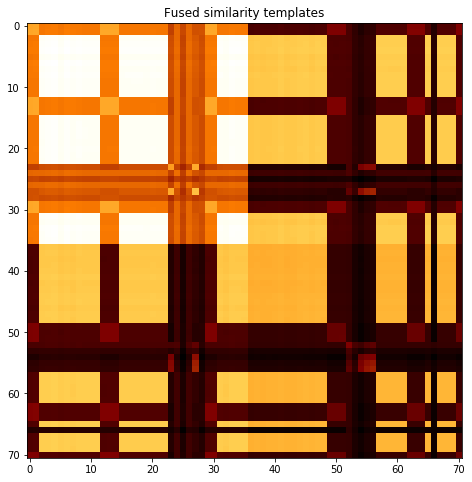

subject 11; gesture 3_0_2


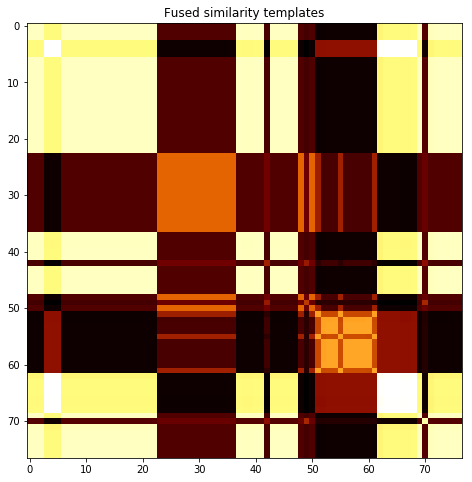

subject 11; gesture 1_1_1


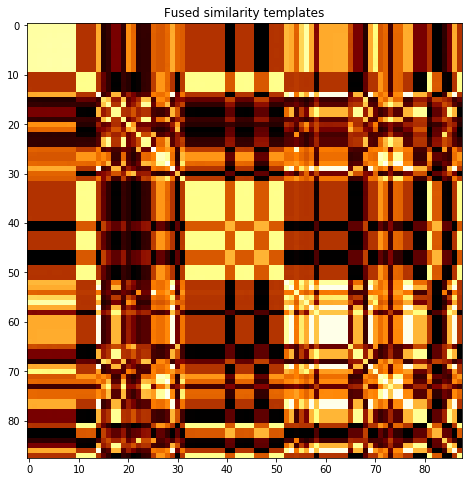

subject 11; gesture 3_1_2


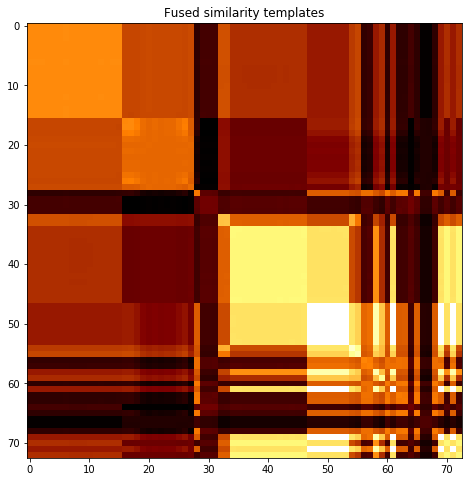

subject 11; gesture 2_1_1


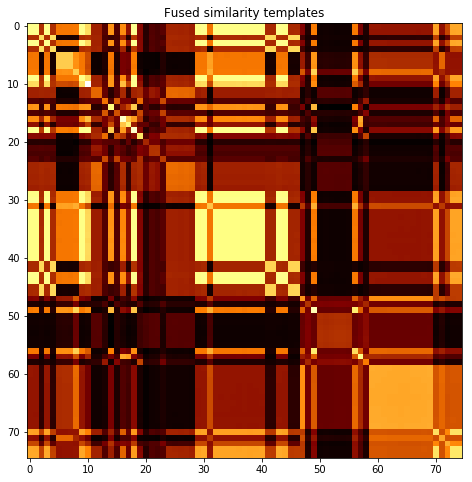

subject 11; gesture 1_0_1


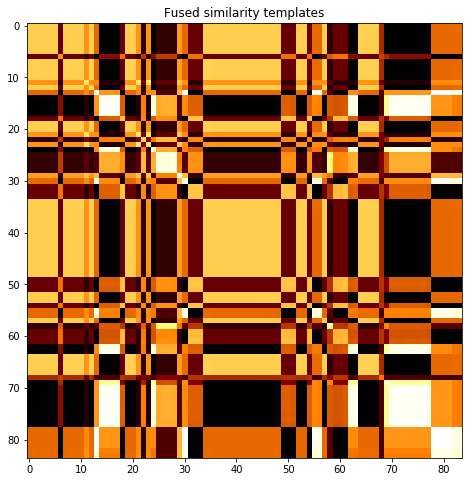

subject 11; gesture 3_1_1


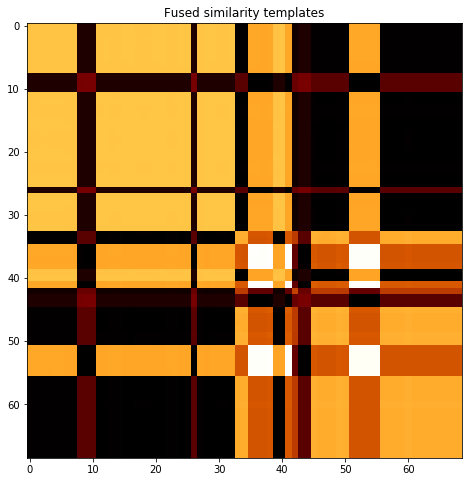

subject 11; gesture 1_0_2


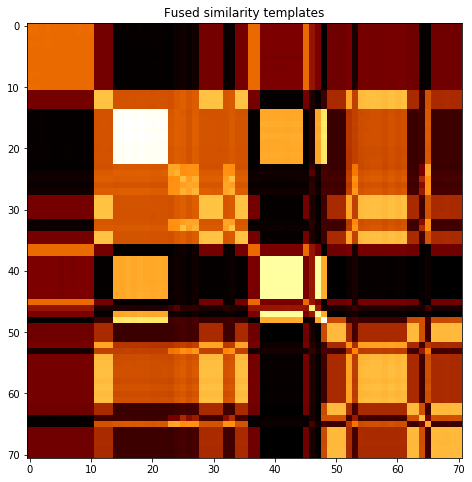

subject 11; gesture 4_0_2


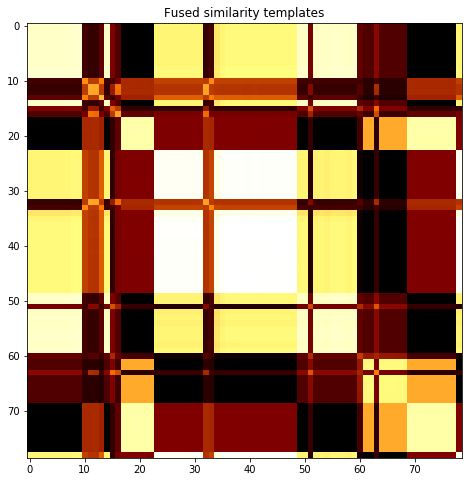

subject 35; gesture 3_0_1


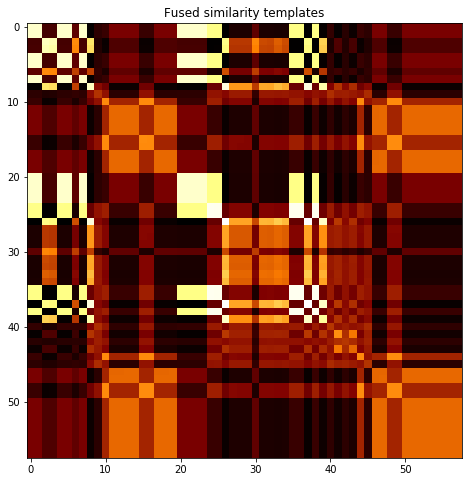

subject 35; gesture 4_1_1


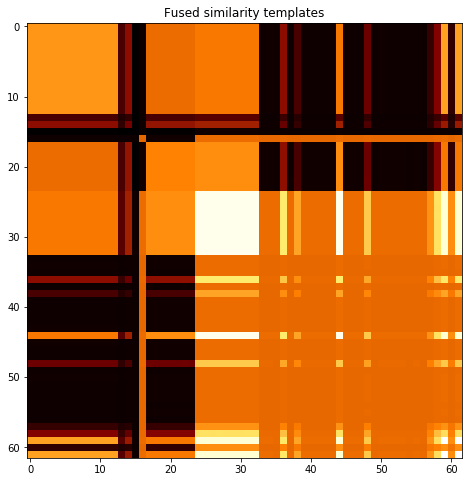

subject 35; gesture 2_0_1


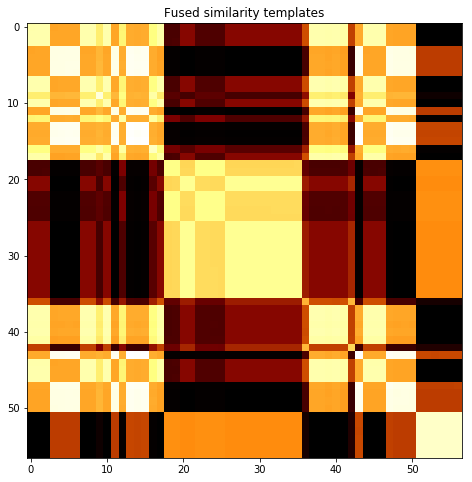

subject 35; gesture 4_1_2


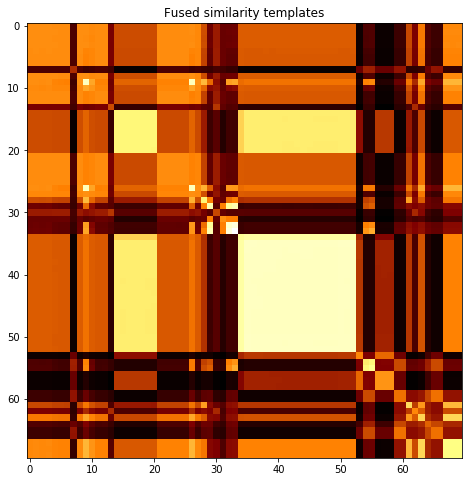

subject 35; gesture 2_0_2


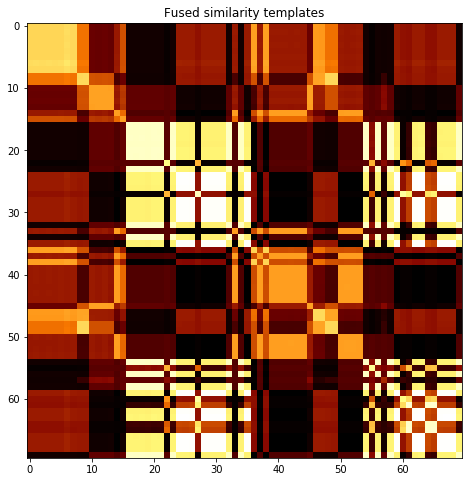

subject 35; gesture 1_1_2


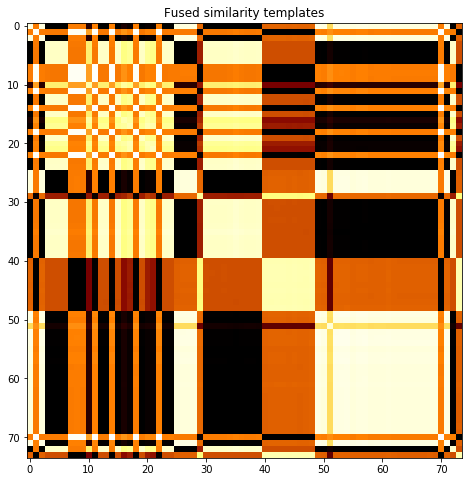

subject 35; gesture 2_1_2


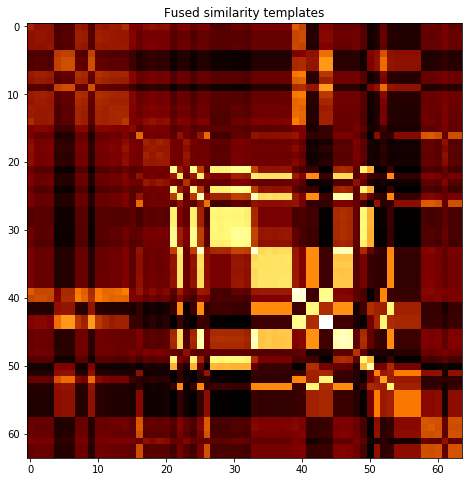

subject 35; gesture 4_0_1


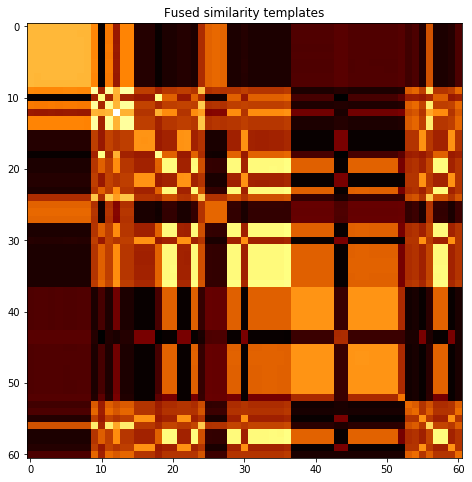

subject 35; gesture 3_0_2


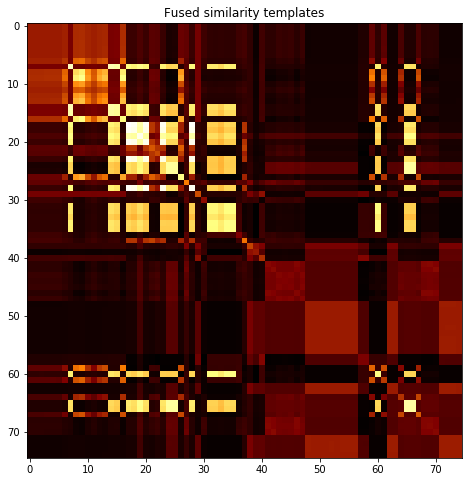

subject 35; gesture 1_1_1


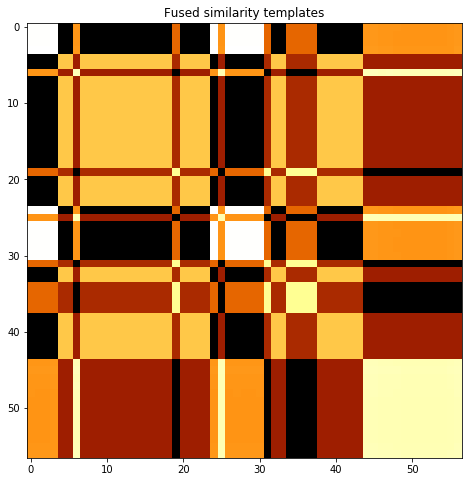

subject 35; gesture 3_1_2


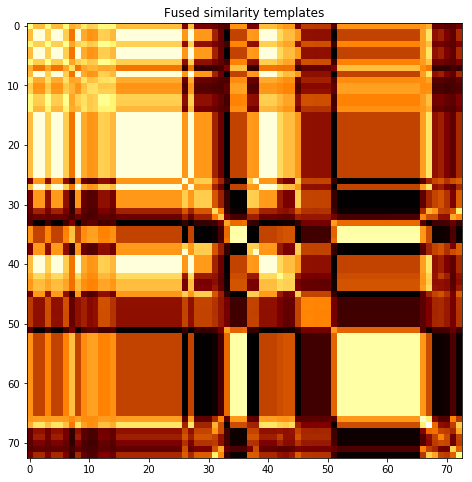

subject 35; gesture 2_1_1


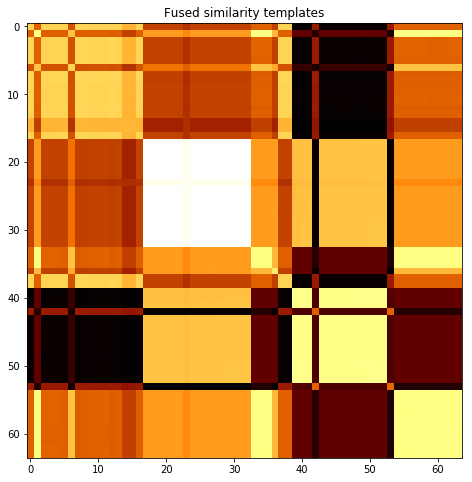

subject 35; gesture 1_0_1


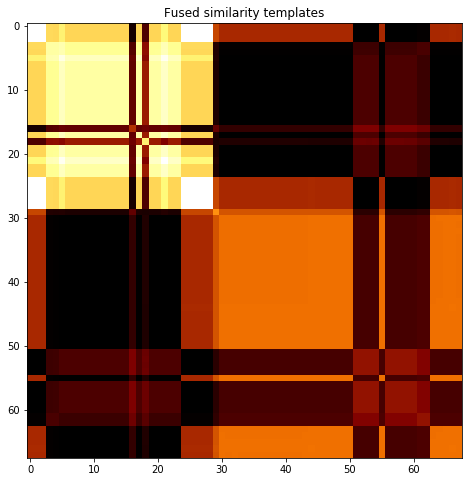

subject 35; gesture 3_1_1


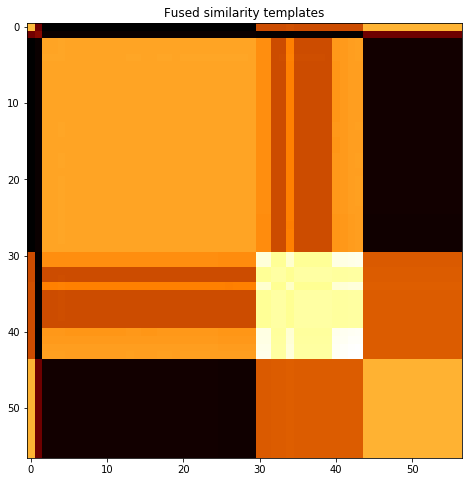

subject 35; gesture 1_0_2


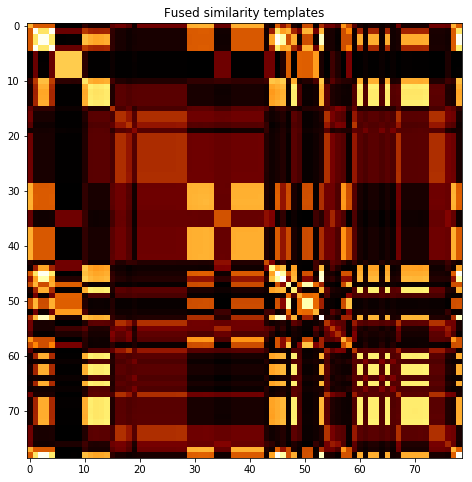

subject 35; gesture 4_0_2


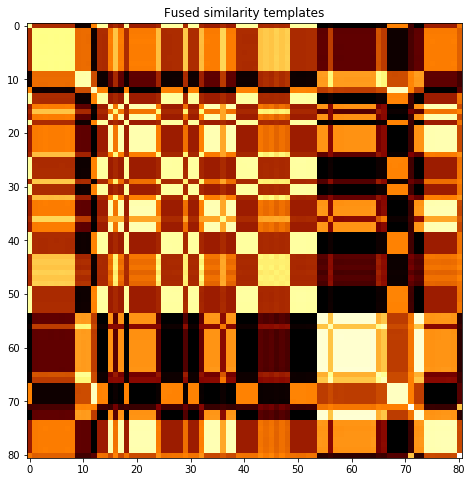

subject 22; gesture 3_0_1


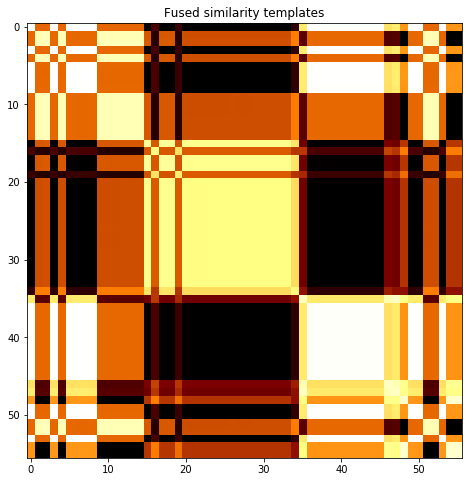

subject 22; gesture 4_1_1


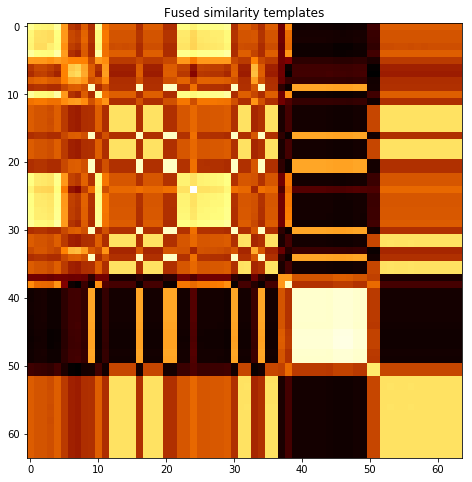

subject 22; gesture 2_0_1


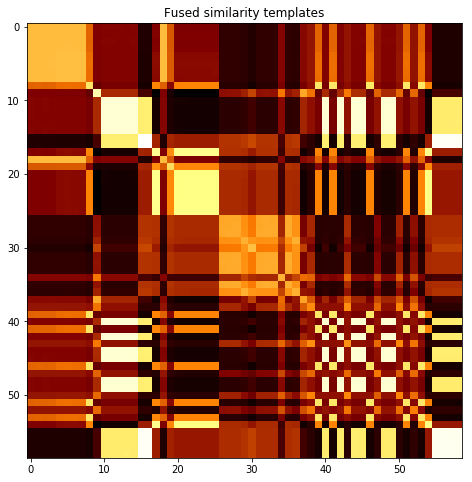

subject 22; gesture 4_1_2


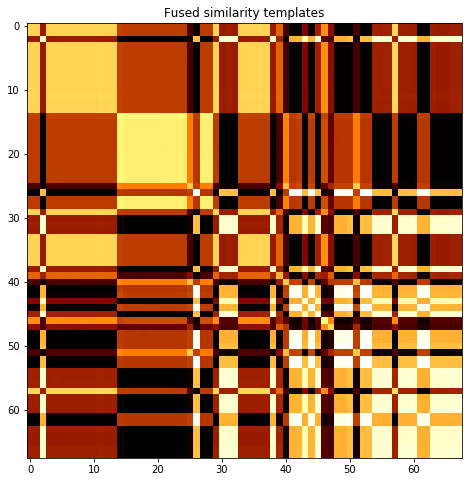

subject 22; gesture 2_0_2


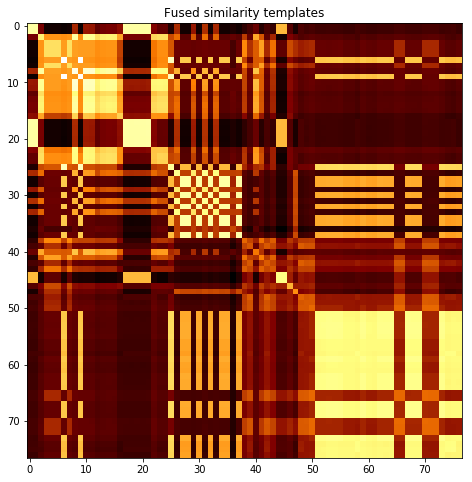

subject 22; gesture 1_1_2


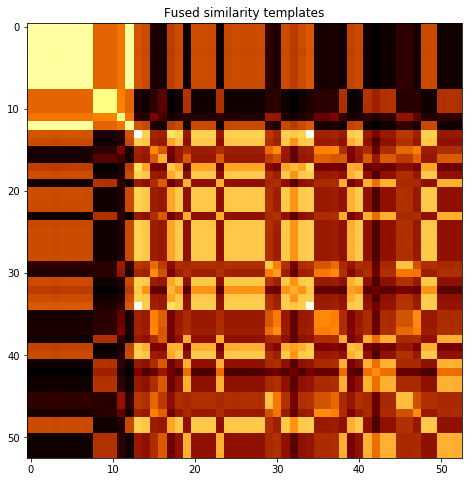

subject 22; gesture 2_1_2


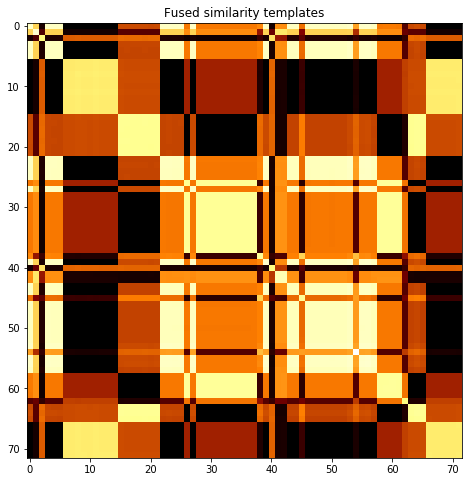

subject 22; gesture 4_0_1


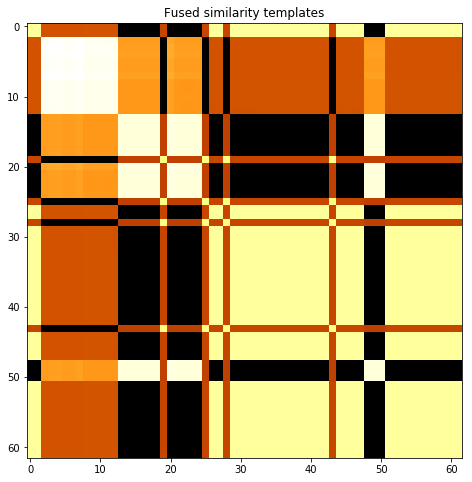

subject 22; gesture 3_0_2


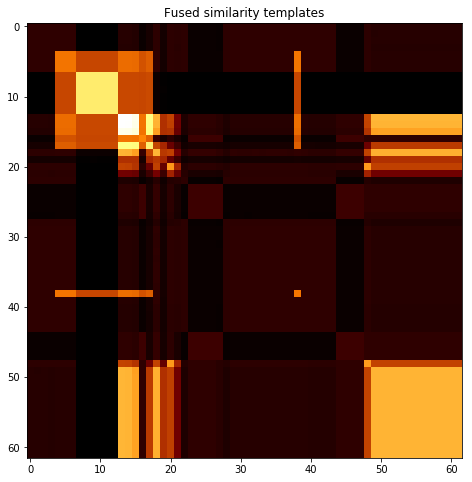

subject 22; gesture 1_1_1


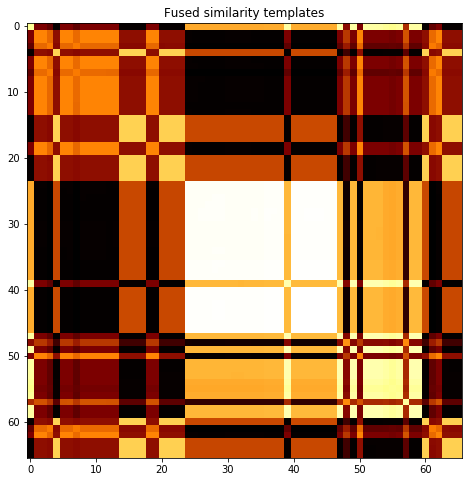

subject 22; gesture 3_1_2


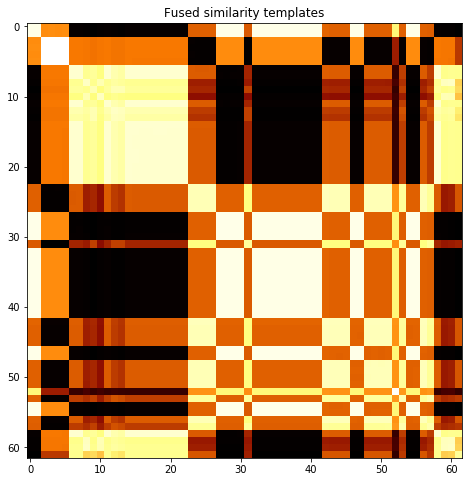

subject 22; gesture 2_1_1


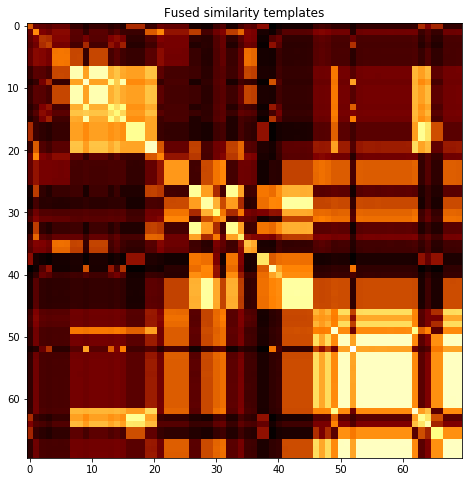

subject 22; gesture 1_0_1


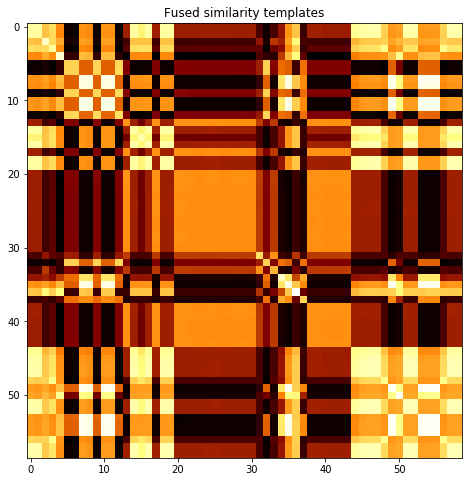

subject 22; gesture 3_1_1


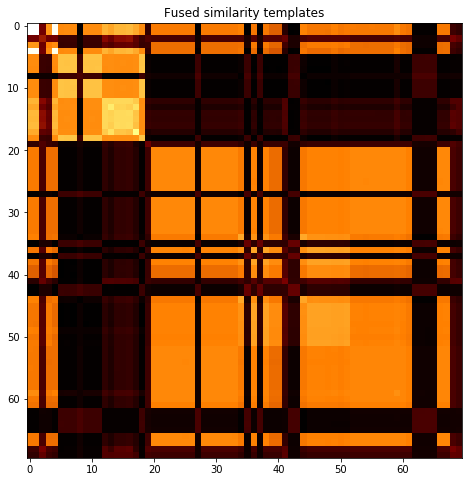

subject 22; gesture 1_0_2


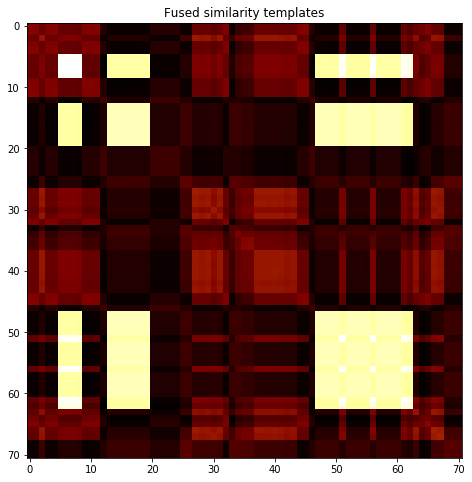

subject 22; gesture 4_0_2


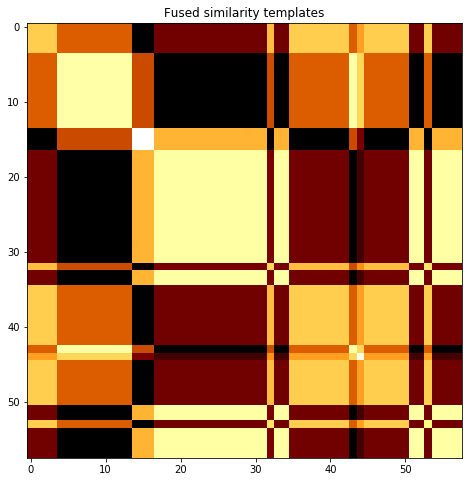

subject 34; gesture 3_0_1


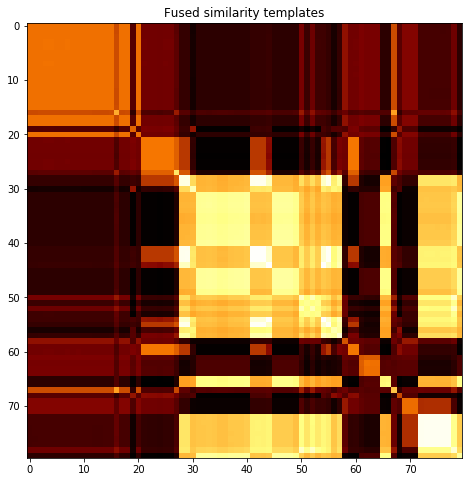

subject 34; gesture 4_1_1


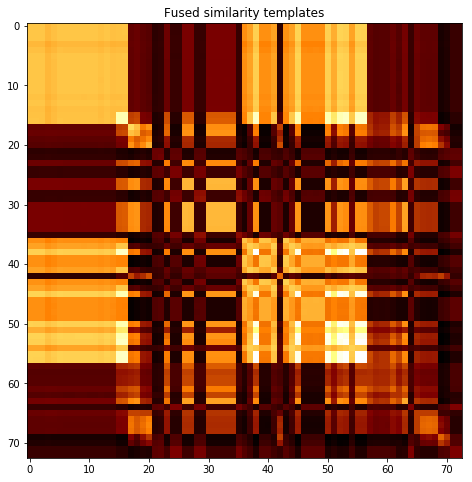

subject 34; gesture 2_0_1


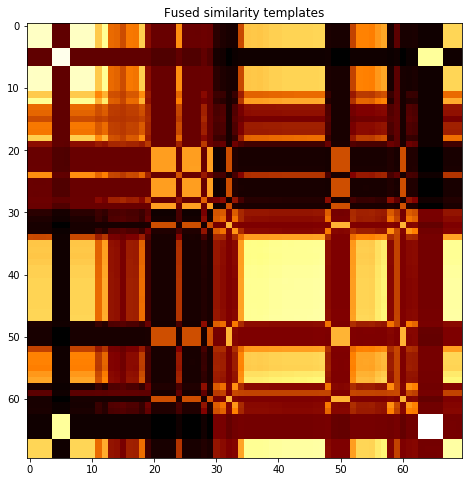

subject 34; gesture 4_1_2


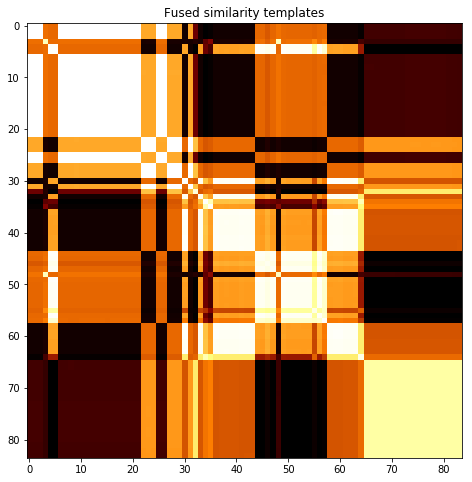

subject 34; gesture 2_0_2


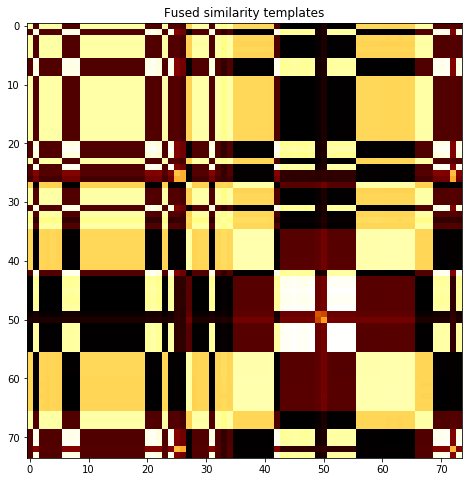

subject 34; gesture 1_1_2


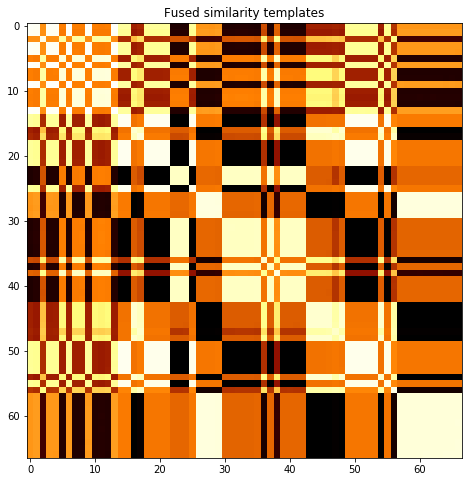

subject 34; gesture 2_1_2


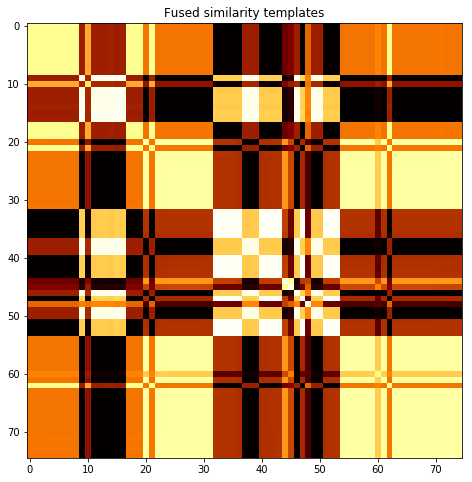

subject 34; gesture 4_0_1


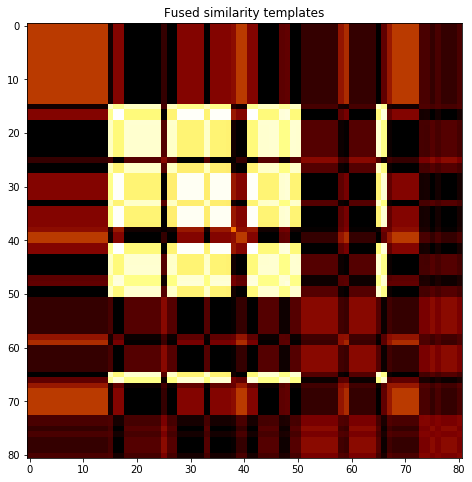

subject 34; gesture 3_0_2


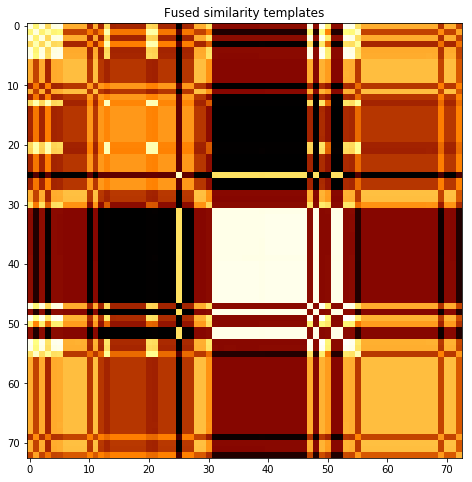

subject 34; gesture 1_1_1


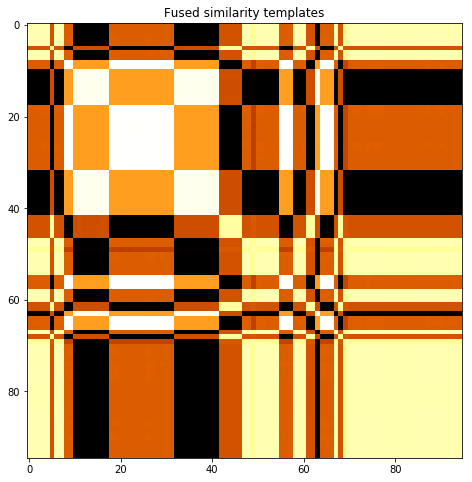

subject 34; gesture 3_1_2


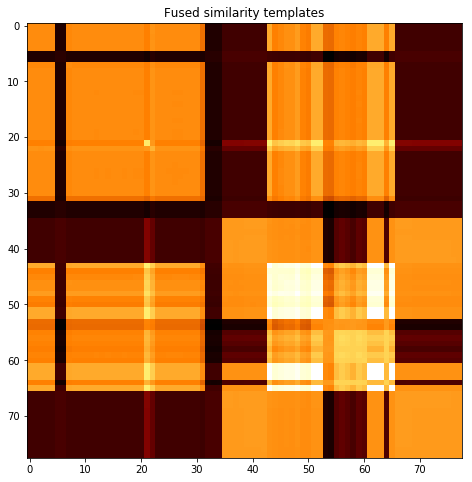

subject 34; gesture 2_1_1


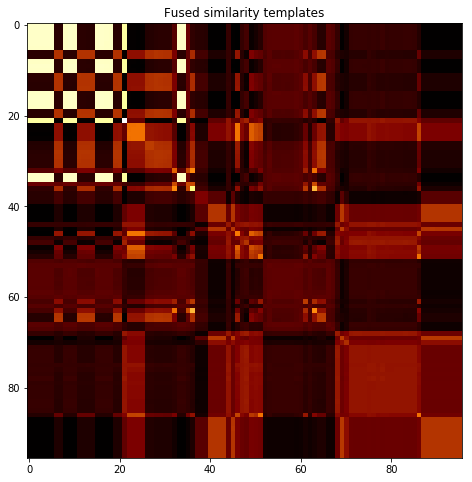

subject 34; gesture 1_0_1


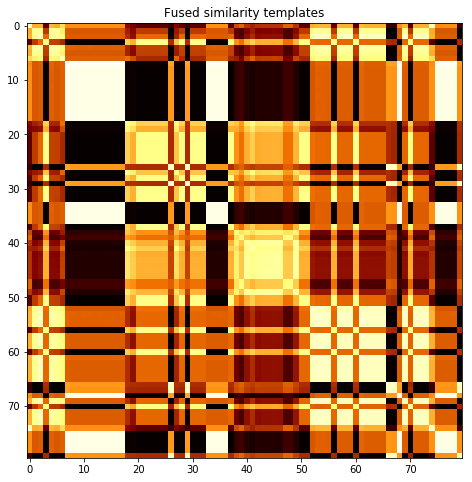

subject 34; gesture 3_1_1


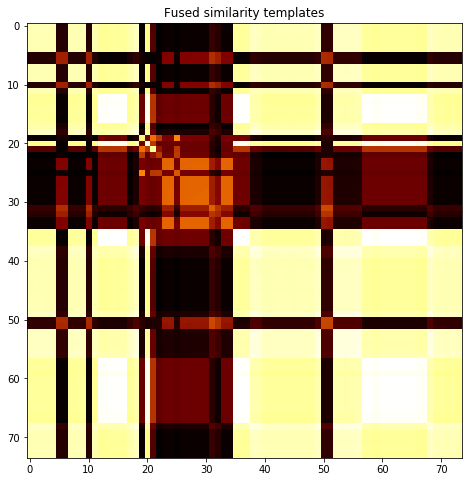

subject 34; gesture 1_0_2


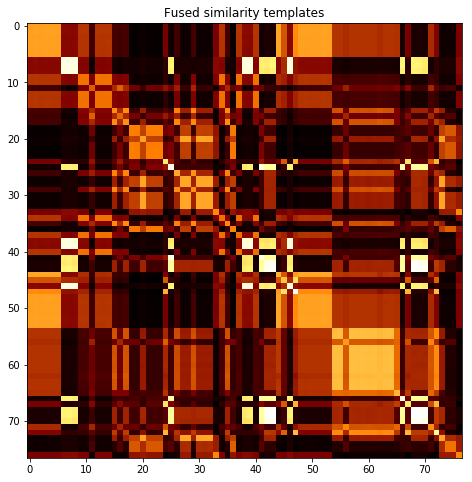

subject 34; gesture 4_0_2


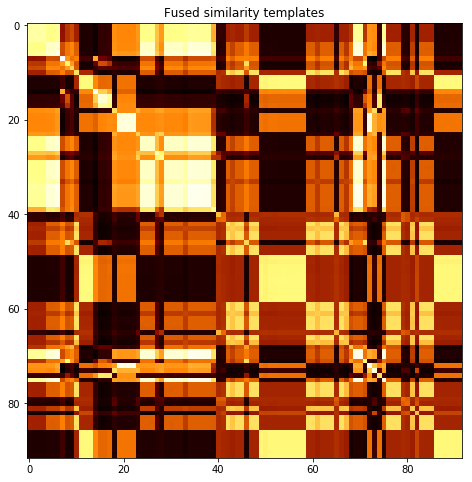

subject 10; gesture 3_0_1


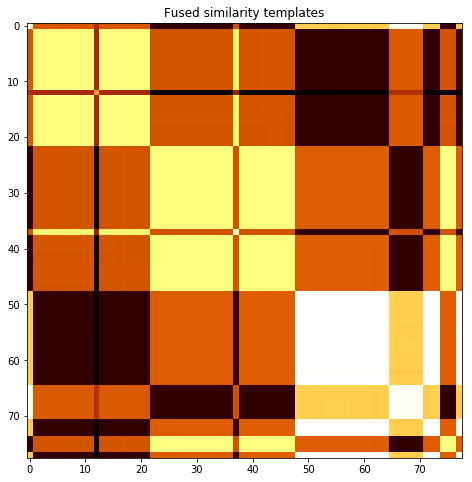

subject 10; gesture 4_1_1


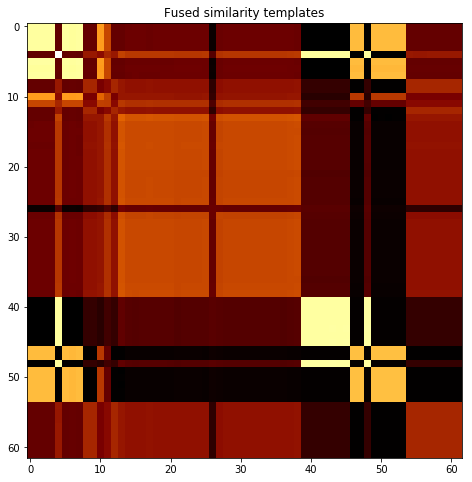

subject 10; gesture 2_0_1


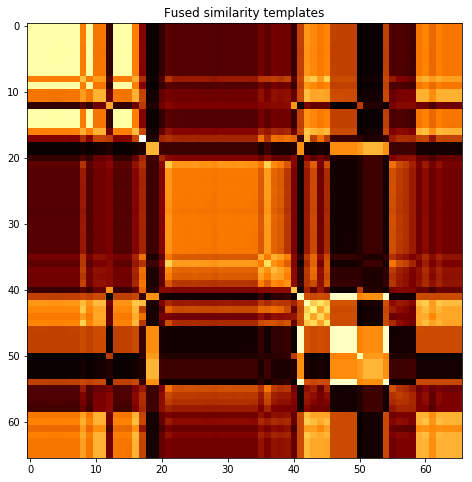

subject 10; gesture 4_1_2


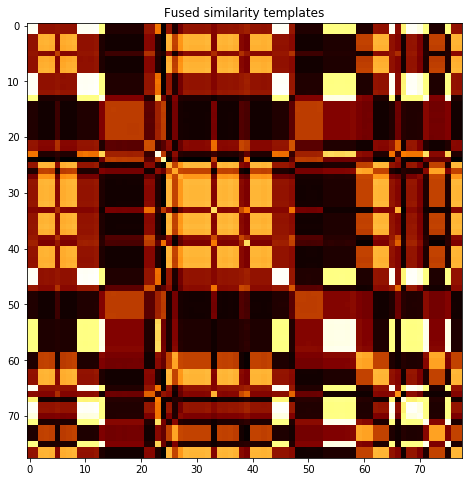

subject 10; gesture 2_0_2


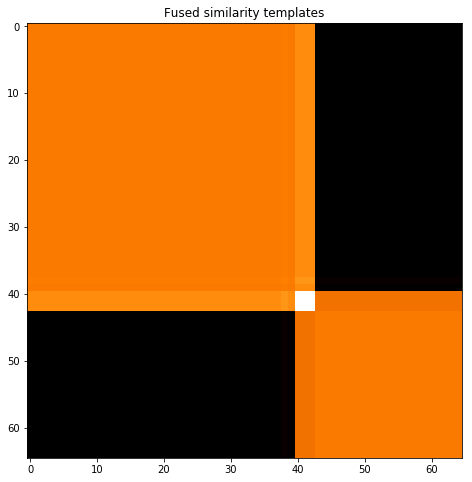

subject 10; gesture 1_1_2


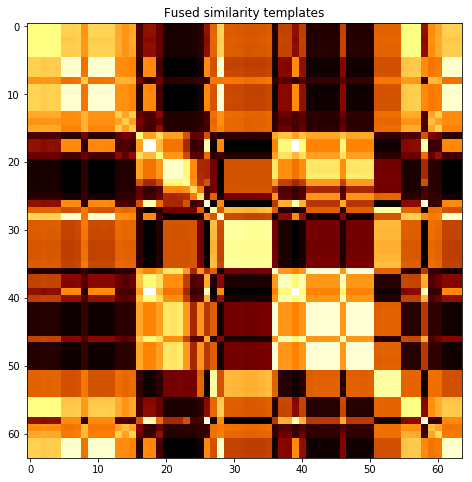

subject 10; gesture 2_1_2


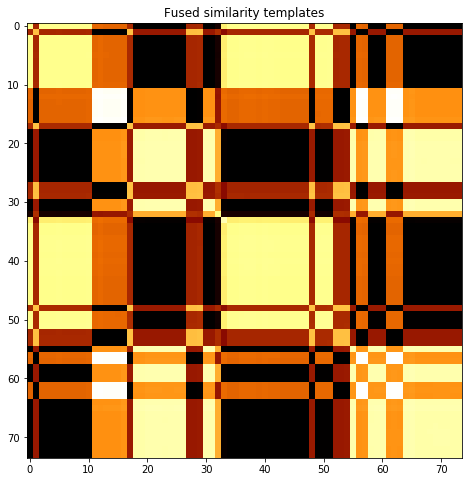

subject 10; gesture 4_0_1


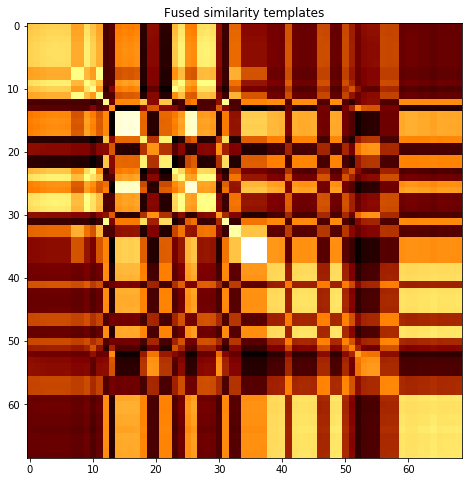

subject 10; gesture 3_0_2


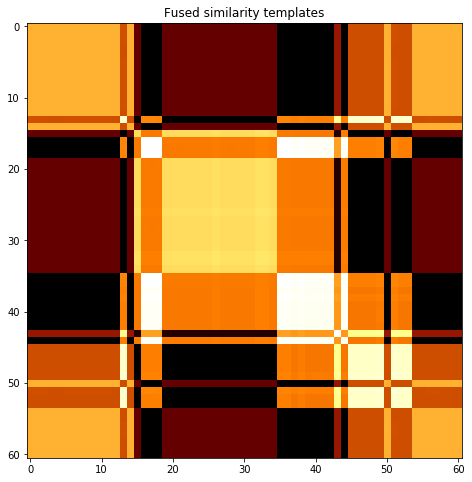

subject 10; gesture 1_1_1


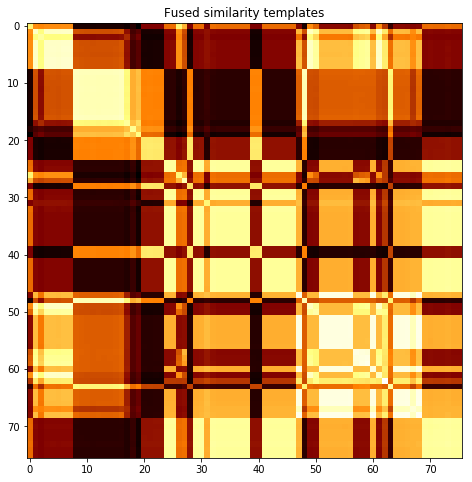

subject 10; gesture 3_1_2


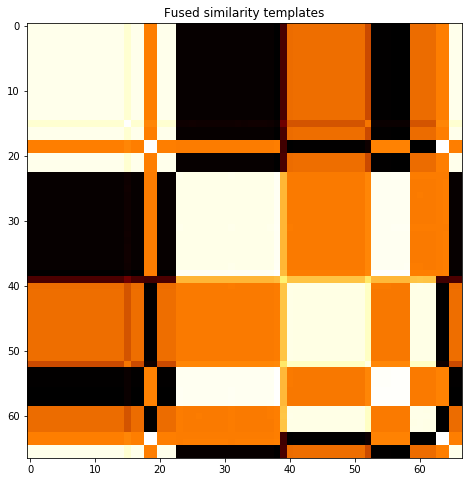

subject 10; gesture 2_1_1


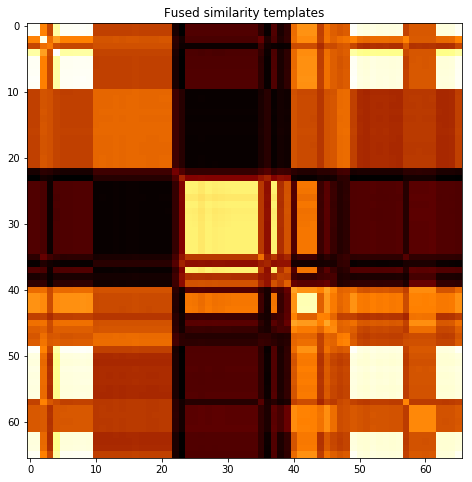

subject 10; gesture 1_0_1


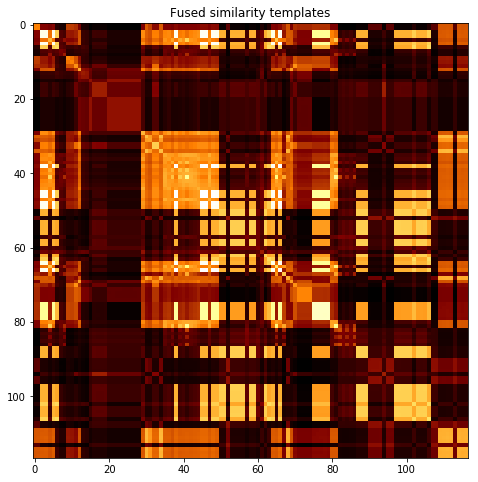

subject 10; gesture 3_1_1


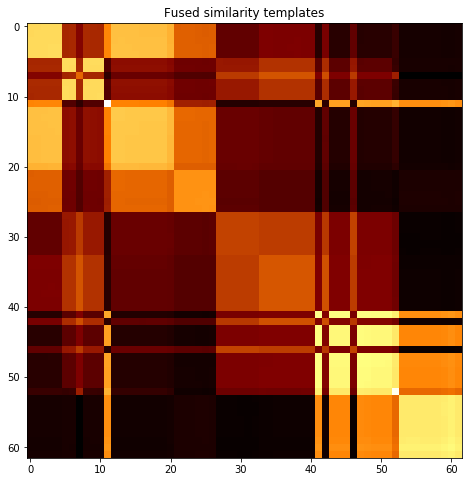

subject 10; gesture 1_0_2


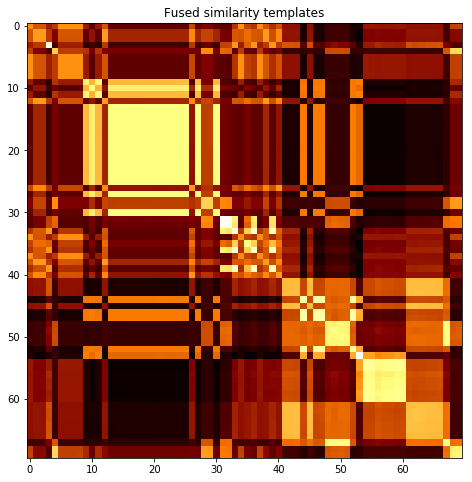

subject 10; gesture 4_0_2


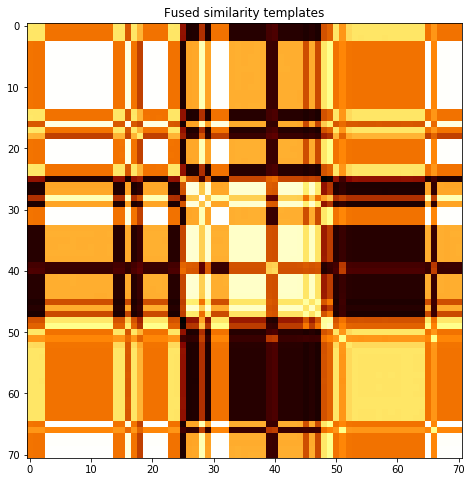

subject 02; gesture 3_0_1


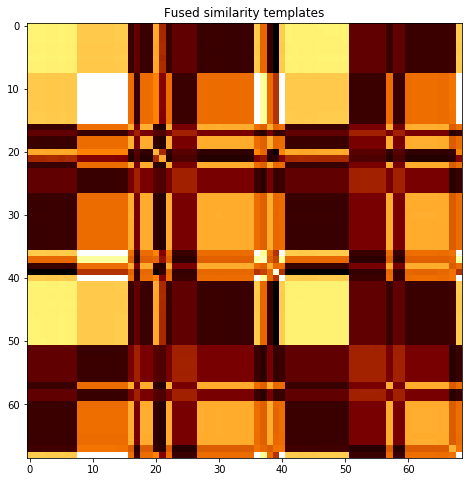

subject 02; gesture 4_1_1


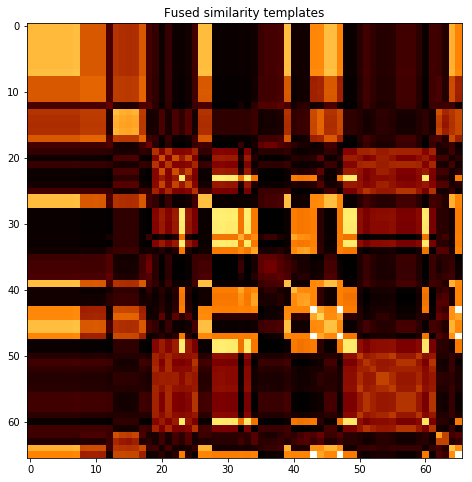

subject 02; gesture 2_0_1


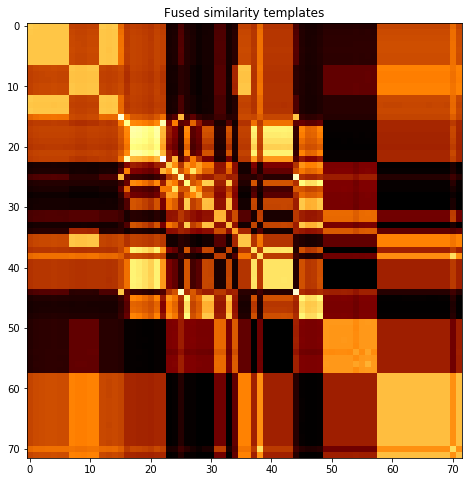

subject 02; gesture 4_1_2


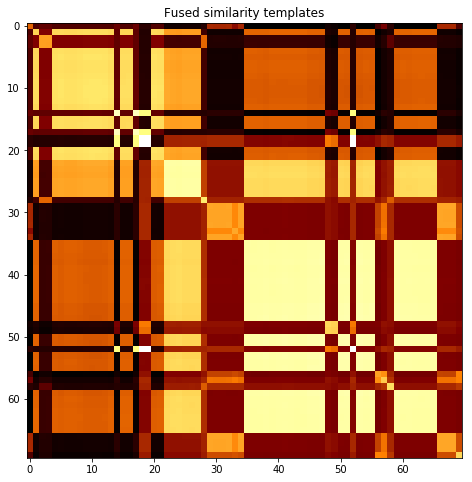

subject 02; gesture 2_0_2


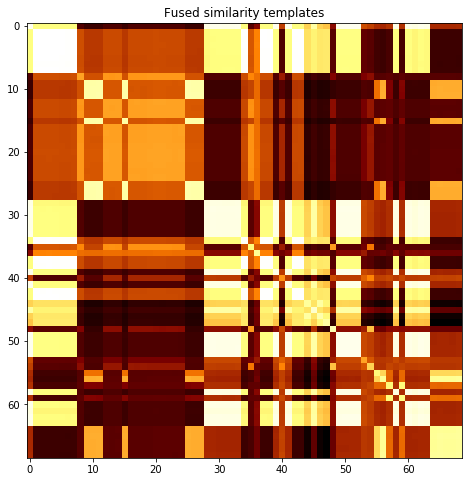

subject 02; gesture 1_1_2


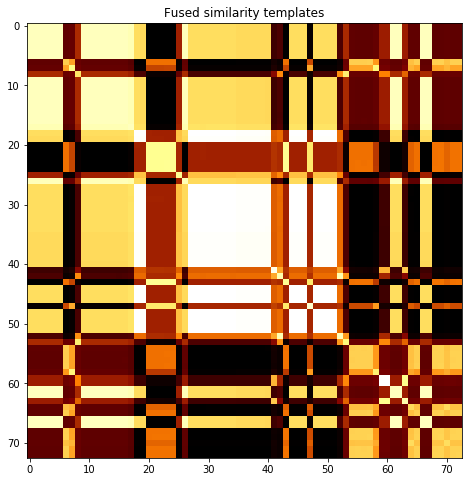

subject 02; gesture 2_1_2


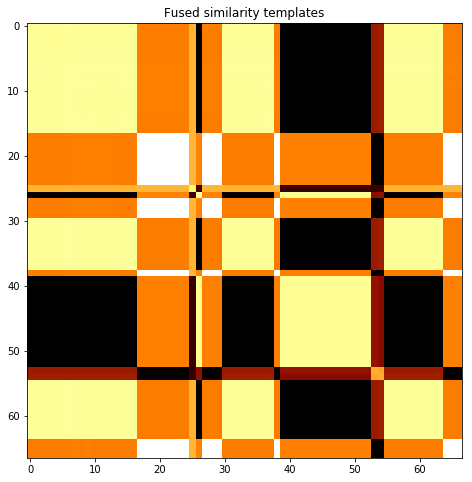

subject 02; gesture 4_0_1


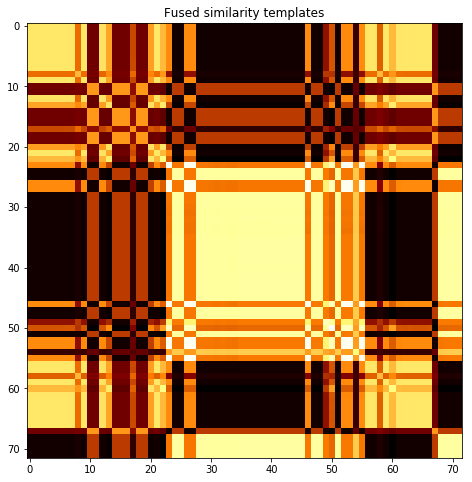

subject 02; gesture 3_0_2


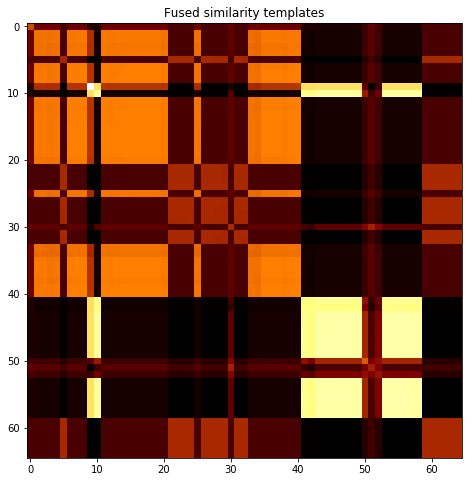

subject 02; gesture 1_1_1


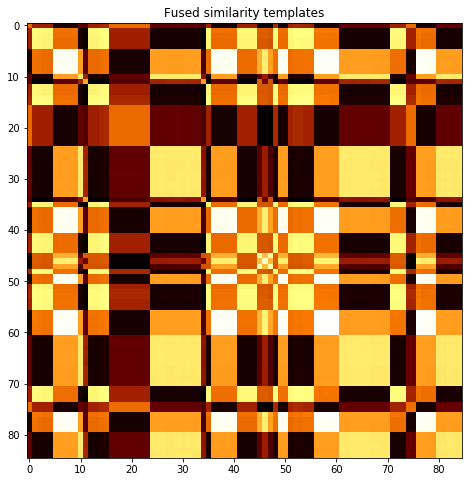

subject 02; gesture 3_1_2


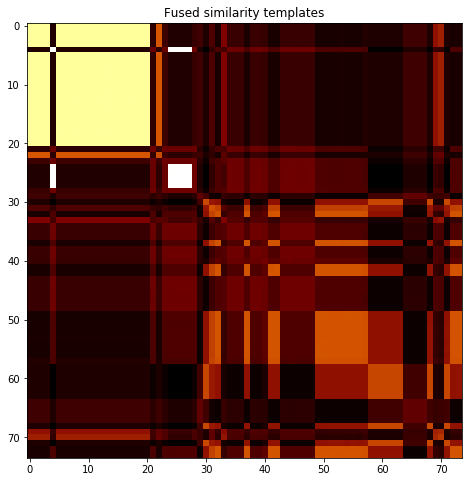

subject 02; gesture 2_1_1


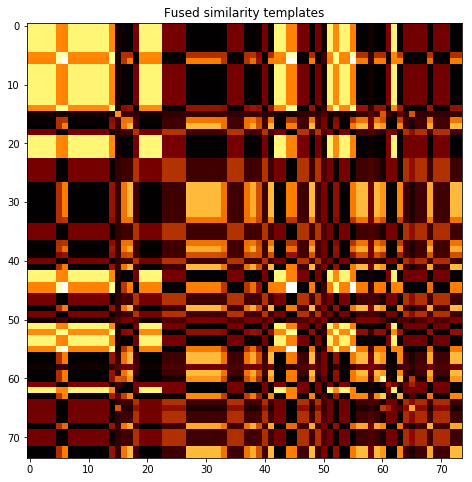

subject 02; gesture 1_0_1


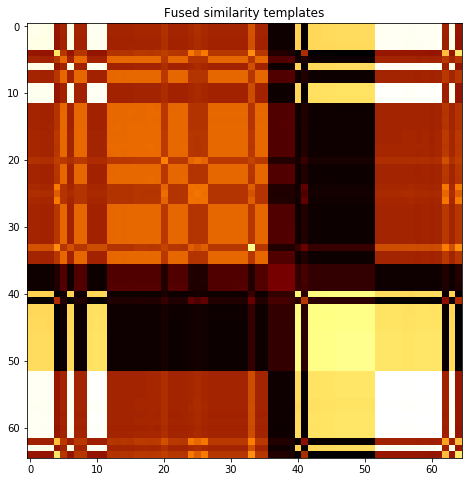

subject 02; gesture 3_1_1


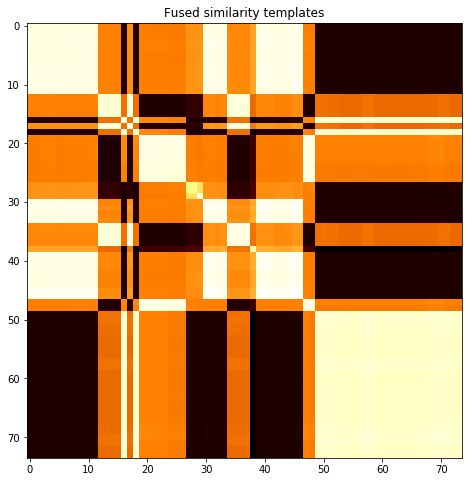

subject 02; gesture 1_0_2


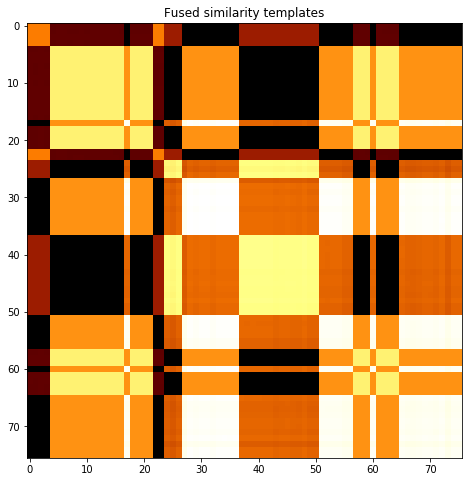

subject 02; gesture 4_0_2


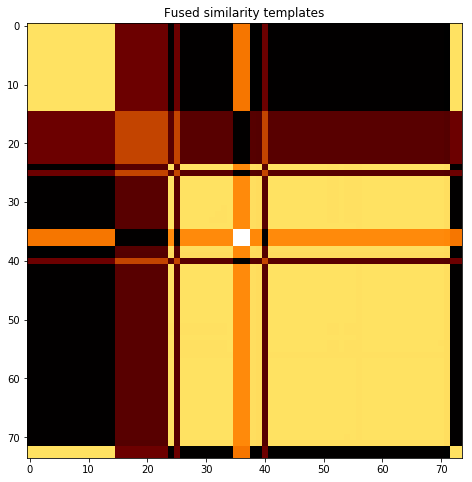

In [10]:
dict_fused = {}
for s, gdict in ant_syn_dict.items():
    dict_fused[s] = {}
    dict_antag[s] = {}
    for g, a in gdict.items():
        snf = SNF(a, k=0.2)
        # calculate graph weights to find knn
        snf.calc_weights()
        snf.normalize_weights()
        # generate and normalize knn graphs
        snf.calc_knn_weights()
        snf.normalize_knn_weights()
        # fuse graphs
        snf.network_fusion(eta=0.2, iters=50)
        # plot matrix
        print(f"subject {s}; gesture {g}")
        snf.plot_template()
        # save template to dict
        dict_fused[s][g] = snf.fused_similarity_template

subject 30; gesture 3_0_1; avg 1.0748790002755584; sd 0.011152880841240905
subject 30; gesture 3_0_1; PoV: 0.9804452938452315


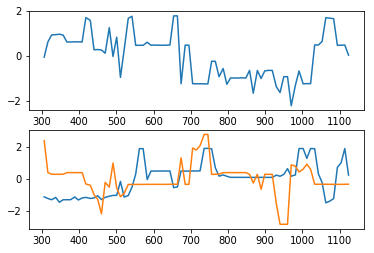

subject 30; gesture 4_1_1; avg 1.132290446778887; sd 0.007427421891244132
subject 30; gesture 4_1_1; PoV: 0.9903364197503985


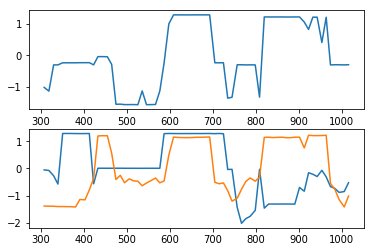

subject 30; gesture 2_0_1; avg 2.8388233896812065; sd 0.024699176516867587
subject 30; gesture 2_0_1; PoV: 0.9890258578942195


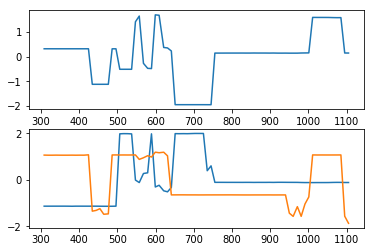

subject 30; gesture 4_1_2; avg 1.5130616618372752; sd 0.017040091980993613
subject 30; gesture 4_1_2; PoV: 0.9835359360509623


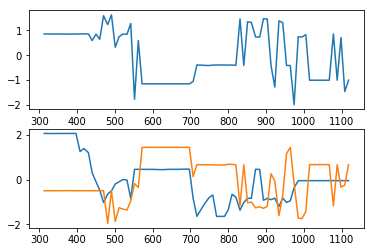

subject 30; gesture 2_0_2; avg 1.1134564913944789; sd 0.010168971996422128
subject 30; gesture 2_0_2; PoV: 0.9837509077460311


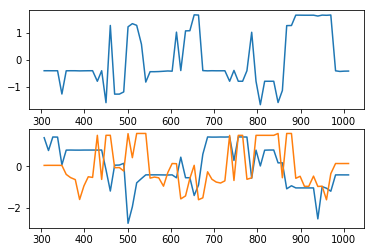

subject 30; gesture 1_1_2; avg 1.2413257990808622; sd 0.023631072491494702
subject 30; gesture 1_1_2; PoV: 0.9683456858591404


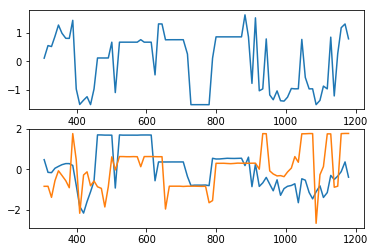

subject 30; gesture 2_1_2; avg 1.44467732463328; sd 0.031114096987612826
subject 30; gesture 2_1_2; PoV: 0.9652487090056318


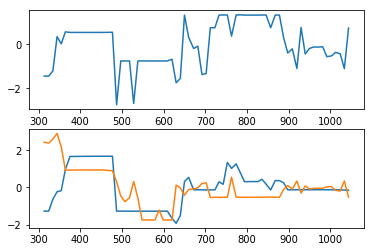

subject 30; gesture 4_0_1; avg 0.8545240449948222; sd 0.010456281222598812
subject 30; gesture 4_0_1; PoV: 0.9776846516480238


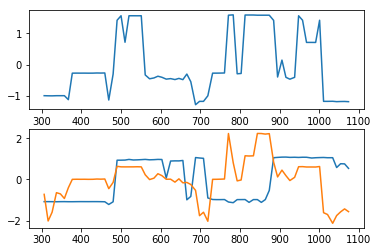

subject 30; gesture 3_0_2; avg 1.8849936457006935; sd 0.01687959295861209
subject 30; gesture 3_0_2; PoV: 0.987989765701569


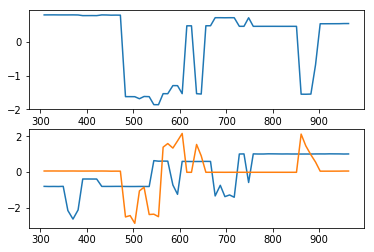

subject 30; gesture 1_1_1; avg 0.8268245925794485; sd 0.009054145198075025
subject 30; gesture 1_1_1; PoV: 0.9818821350888952


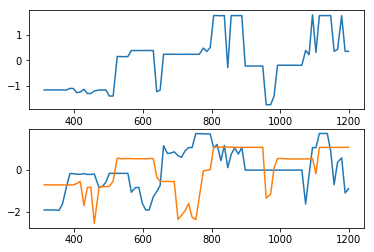

subject 30; gesture 3_1_2; avg 1.603500648498372; sd 0.016167909905751038
subject 30; gesture 3_1_2; PoV: 0.9881489900576269


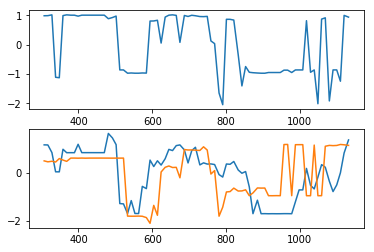

subject 30; gesture 2_1_1; avg 1.7244041195206783; sd 0.010835671536078575
subject 30; gesture 2_1_1; PoV: 0.9916772091682992


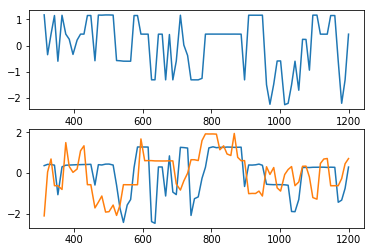

subject 30; gesture 1_0_1; avg 0.9849237482292219; sd 0.01127524237518779
subject 30; gesture 1_0_1; PoV: 0.9847187453239944


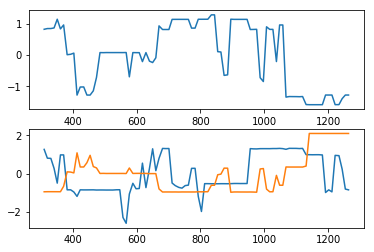

subject 30; gesture 3_1_1; avg 0.6854301315139774; sd 0.005151468225854751
subject 30; gesture 3_1_1; PoV: 0.9896748873695035


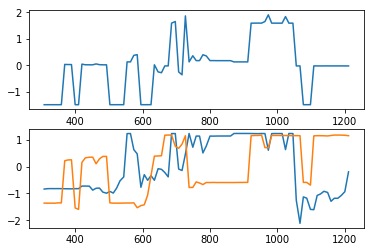

subject 30; gesture 1_0_2; avg 0.9973369204477385; sd 0.007411436652909311
subject 30; gesture 1_0_2; PoV: 0.9885340912979055


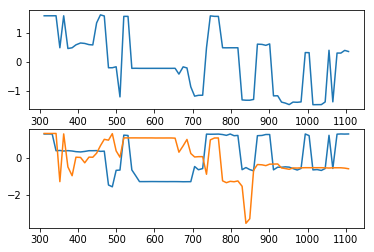

subject 30; gesture 4_0_2; avg 1.122576249804153; sd 0.02627463870653056
subject 30; gesture 4_0_2; PoV: 0.962910068082354


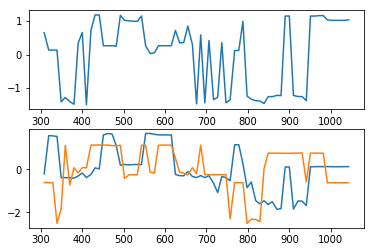

subject 06; gesture 3_0_1; avg 3.2270925069643206; sd 0.02910312099423024
subject 06; gesture 3_0_1; PoV: 0.9882747021689547


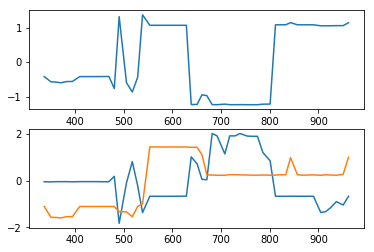

subject 06; gesture 4_1_1; avg 2.974344992544239; sd 0.03747015617323576
subject 06; gesture 4_1_1; PoV: 0.9831494200477272


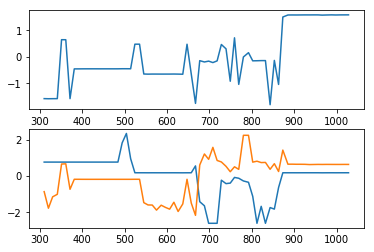

subject 06; gesture 2_0_1; avg 4.356193089960965; sd 0.03255629363628823
subject 06; gesture 2_0_1; PoV: 0.9923850435670253


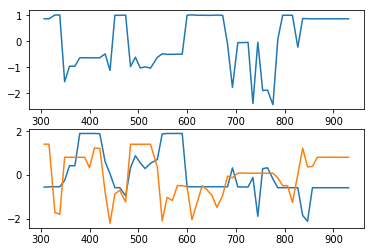

subject 06; gesture 4_1_2; avg 2.109027217629426; sd 0.03123528221419721
subject 06; gesture 4_1_2; PoV: 0.9828798006109055


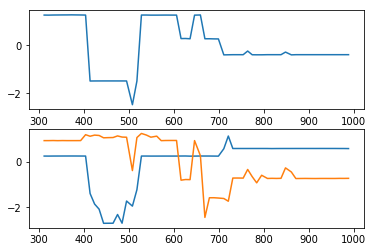

subject 06; gesture 2_0_2; avg 3.08469270463033; sd 0.041946351327561374
subject 06; gesture 2_0_2; PoV: 0.9884605492691497


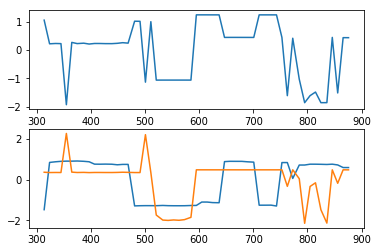

subject 06; gesture 1_1_2; avg 2.5314090345483544; sd 0.022507602371936525
subject 06; gesture 1_1_2; PoV: 0.9886254033099


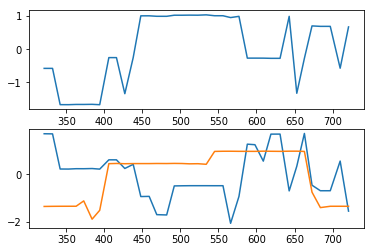

subject 06; gesture 2_1_2; avg 4.018075813795327; sd 0.04061799929486917
subject 06; gesture 2_1_2; PoV: 0.9905047725322909


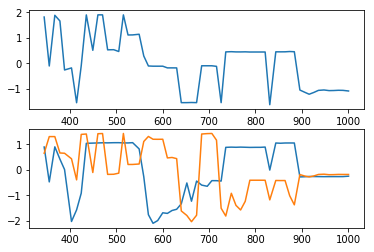

subject 06; gesture 4_0_1; avg 1.2573192906475936; sd 0.01458515987898731
subject 06; gesture 4_0_1; PoV: 0.9763372917771997


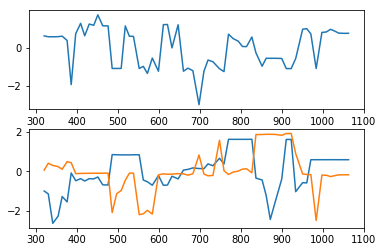

subject 06; gesture 3_0_2; avg 1.9580918100327585; sd 0.03191630446953238
subject 06; gesture 3_0_2; PoV: 0.9766922003950778


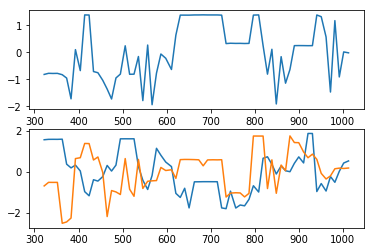

subject 06; gesture 1_1_1; avg 1.7113567570867785; sd 0.010900278405761396
subject 06; gesture 1_1_1; PoV: 0.9934059667701105


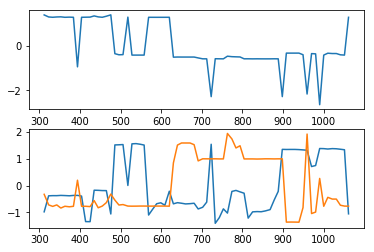

subject 06; gesture 3_1_2; avg 1.7412615385874; sd 0.021297588317269807
subject 06; gesture 3_1_2; PoV: 0.9811769682243283


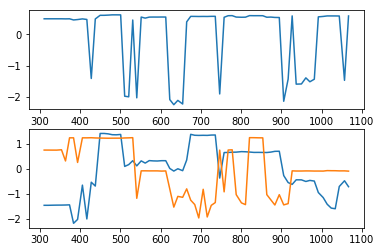

subject 06; gesture 2_1_1; avg 1.1916062469456283; sd 0.009718730859560858
subject 06; gesture 2_1_1; PoV: 0.986870872044205


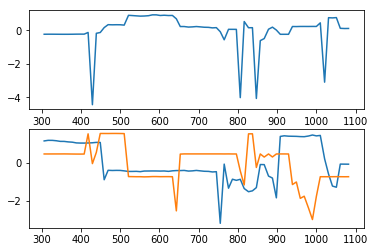

subject 06; gesture 1_0_1; avg 1.0353590064881604; sd 0.008486801476001749
subject 06; gesture 1_0_1; PoV: 0.9857053501558708


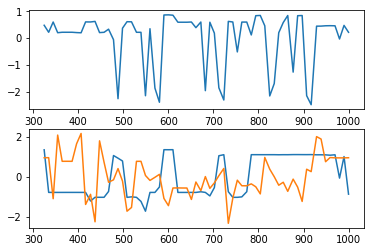

subject 06; gesture 3_1_1; avg 0.9694380264997257; sd 0.008322437998400146
subject 06; gesture 3_1_1; PoV: 0.9870427045909925


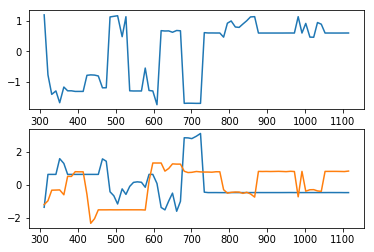

subject 06; gesture 1_0_2; avg 1.4635081862008572; sd 0.011793298918928318
subject 06; gesture 1_0_2; PoV: 0.9872619943038867


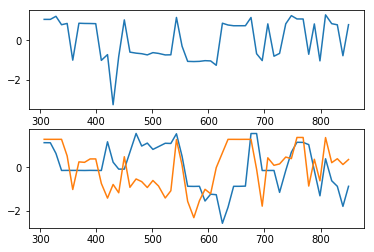

subject 06; gesture 4_0_2; avg 1.1454603034634856; sd 0.011671269993663842
subject 06; gesture 4_0_2; PoV: 0.9847763077928039


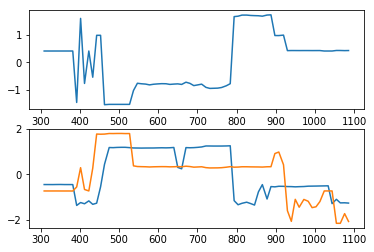

subject 09; gesture 3_0_1; avg 1.3613980340468603; sd 0.011630887726263793
subject 09; gesture 3_0_1; PoV: 0.9885182807140148


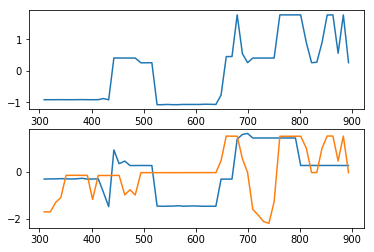

subject 09; gesture 4_1_1; avg 9.203005739182103; sd 0.050055478597807984
subject 09; gesture 4_1_1; PoV: 0.9941798707824532


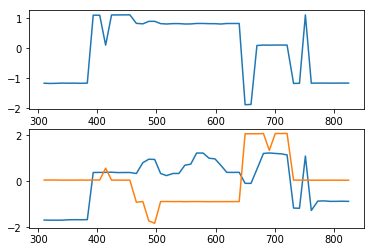

subject 09; gesture 2_0_1; avg 1.6491897650822374; sd 0.01581719363188306
subject 09; gesture 2_0_1; PoV: 0.9888864402407115


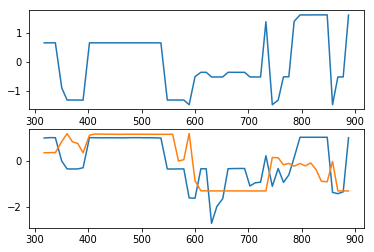

subject 09; gesture 4_1_2; avg 4.246952502038218; sd 0.6467034835452656
subject 09; gesture 4_1_2; PoV: 0.9050534242105926


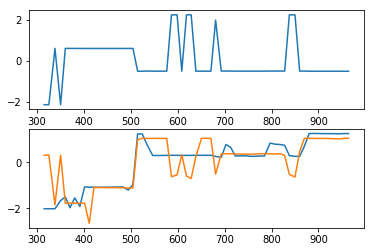

subject 09; gesture 2_0_2; avg 1.3464338645799931; sd 0.013101476722604984
subject 09; gesture 2_0_2; PoV: 0.9848049005963825


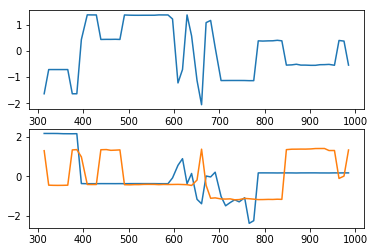

subject 09; gesture 1_1_2; avg 1.0271653416775575; sd 0.00792958321366916
subject 09; gesture 1_1_2; PoV: 0.9876389500033864


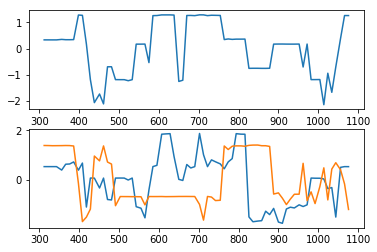

subject 09; gesture 2_1_2; avg 1.9261573099065077; sd 0.02373545383886597
subject 09; gesture 2_1_2; PoV: 0.9846296492689949


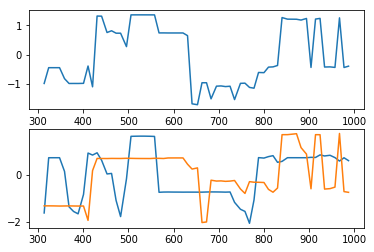

subject 09; gesture 4_0_1; avg 4.295599936505076; sd 0.02694697887431162
subject 09; gesture 4_0_1; PoV: 0.9944840033922199


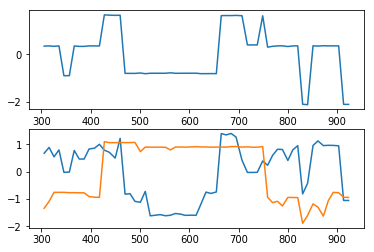

subject 09; gesture 3_0_2; avg 2.2072952189629174; sd 0.01647965185376657
subject 09; gesture 3_0_2; PoV: 0.990203223662602


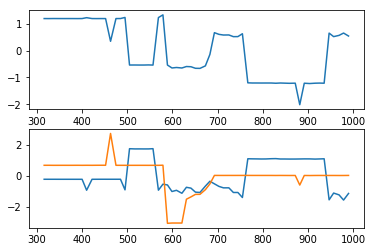

subject 09; gesture 1_1_1; avg 4.90250467514184; sd 0.022131422588195445
subject 09; gesture 1_1_1; PoV: 0.9956291964053771


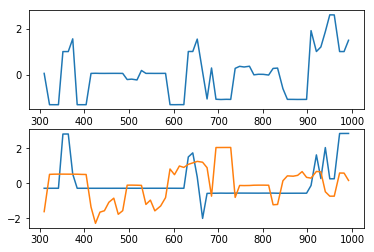

subject 09; gesture 3_1_2; avg 1.6282153403005504; sd 0.01107037877661152
subject 09; gesture 3_1_2; PoV: 0.9919373014074243


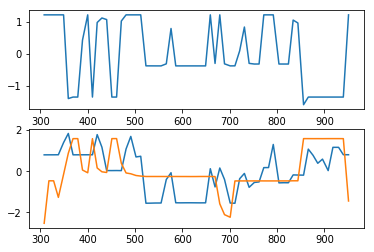

subject 09; gesture 2_1_1; avg 1.4009787758559988; sd 0.007845634582840709
subject 09; gesture 2_1_1; PoV: 0.993024837223109


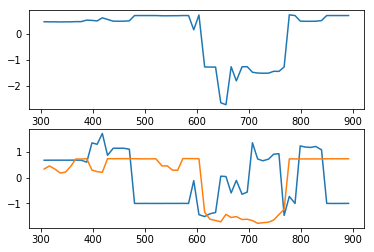

subject 09; gesture 1_0_1; avg 1.0703282855584622; sd 0.030747420681572803
subject 09; gesture 1_0_1; PoV: 0.9720485004329245


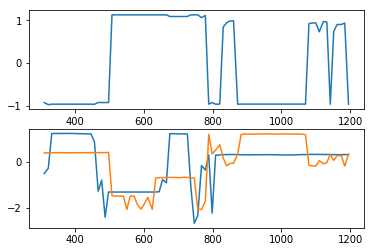

subject 09; gesture 3_1_1; avg 3.7414153133367005; sd 0.03144184896699916
subject 09; gesture 3_1_1; PoV: 0.9884684964356091


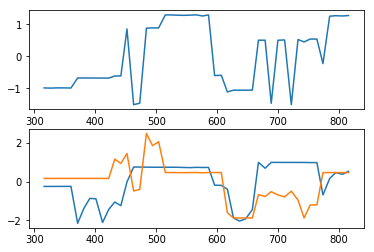

subject 09; gesture 1_0_2; avg 0.8949605013226444; sd 0.006379301710100814
subject 09; gesture 1_0_2; PoV: 0.9888223020699999


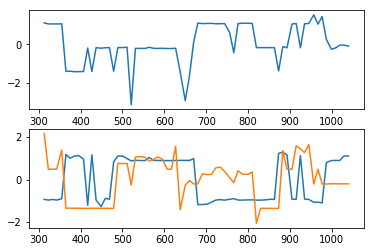

subject 09; gesture 4_0_2; avg 1.4876966271755774; sd 0.012096778013481123
subject 09; gesture 4_0_2; PoV: 0.9913539121168553


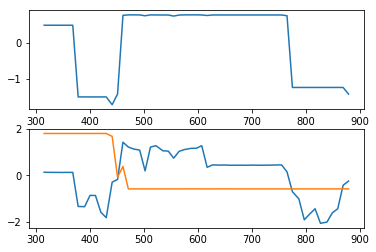

subject 03; gesture 3_0_1; avg 0.8813119304736019; sd 0.0063656957737033065
subject 03; gesture 3_0_1; PoV: 0.9895948900757551


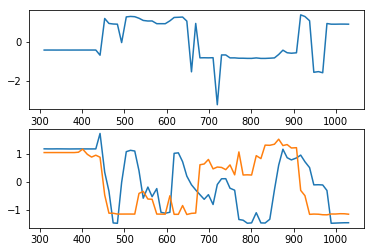

subject 03; gesture 4_1_1; avg 1.1753361997863532; sd 0.01915026751515515
subject 03; gesture 4_1_1; PoV: 0.9791038377377159


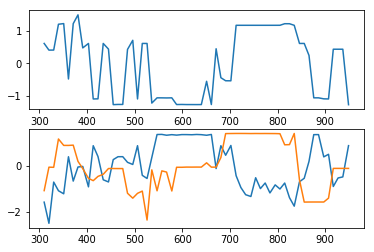

subject 03; gesture 2_0_1; avg 1.2641999903552223; sd 0.013378180001175336
subject 03; gesture 2_0_1; PoV: 0.9814218117622578


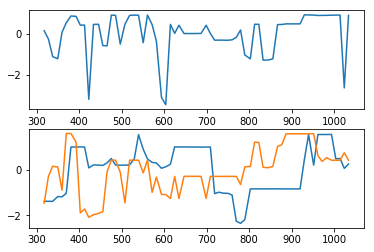

subject 03; gesture 4_1_2; avg 1.7994156181334726; sd 0.0137424034898151
subject 03; gesture 4_1_2; PoV: 0.9891858526971798


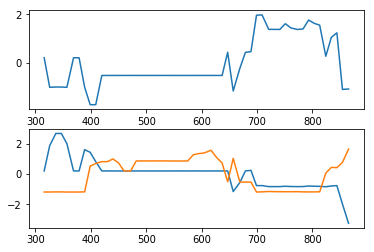

subject 03; gesture 2_0_2; avg 1.8876903875816646; sd 0.03346560458462824
subject 03; gesture 2_0_2; PoV: 0.9760844025051439


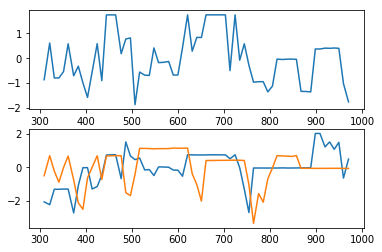

subject 03; gesture 1_1_2; avg 2.0303425769600656; sd 0.01693150664979065
subject 03; gesture 1_1_2; PoV: 0.9909981947463103


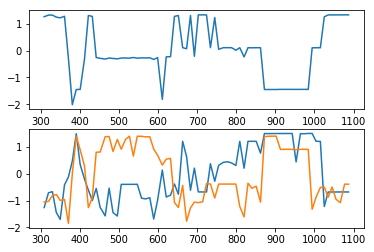

subject 03; gesture 2_1_2; avg 0.866737924145492; sd 0.006038209289901692
subject 03; gesture 2_1_2; PoV: 0.9906507739720359


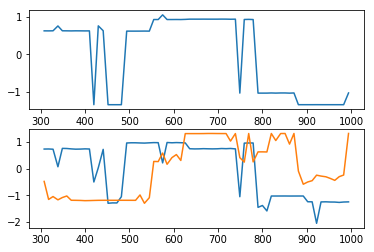

subject 03; gesture 4_0_1; avg 2.528726930143097; sd 0.027433425580896967
subject 03; gesture 4_0_1; PoV: 0.9892052215749713


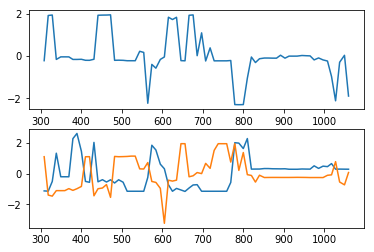

subject 03; gesture 3_0_2; avg 1.9312927250278473; sd 0.012231629032207508
subject 03; gesture 3_0_2; PoV: 0.9897500260590103


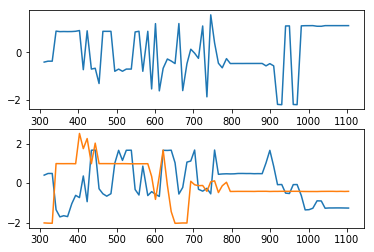

subject 03; gesture 1_1_1; avg 1.3936244750126314; sd 0.019447048412726316
subject 03; gesture 1_1_1; PoV: 0.979915147242426


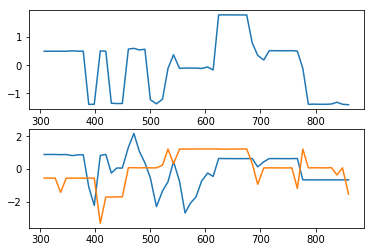

subject 03; gesture 3_1_2; avg 1.9032968195683464; sd 0.01196836702814571
subject 03; gesture 3_1_2; PoV: 0.9911265969783064


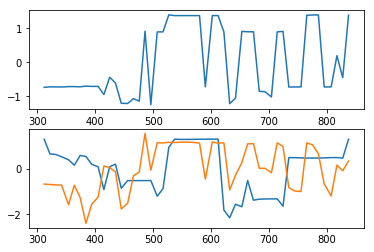

subject 03; gesture 2_1_1; avg 4.322576473643044; sd 0.038197866828970244
subject 03; gesture 2_1_1; PoV: 0.9898755452929575


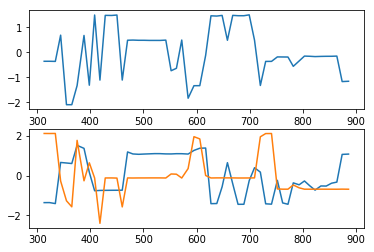

subject 03; gesture 1_0_1; avg 4.5711753384816225; sd 0.02469532238606481
subject 03; gesture 1_0_1; PoV: 0.9960687192986213


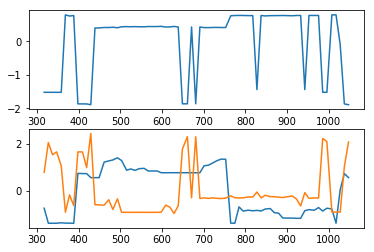

subject 03; gesture 3_1_1; avg 1.30105980090212; sd 0.01673953590793769
subject 03; gesture 3_1_1; PoV: 0.9772639518634678


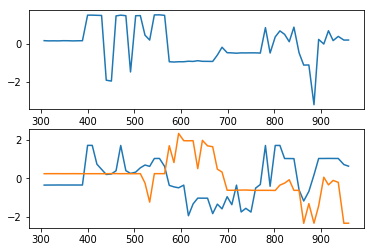

subject 03; gesture 1_0_2; avg 1.3650370730216592; sd 0.013623041757216924
subject 03; gesture 1_0_2; PoV: 0.983431967626993


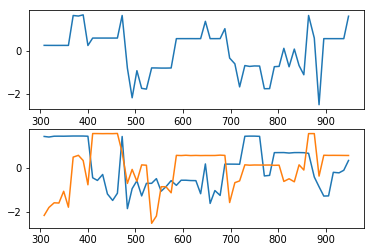

subject 03; gesture 4_0_2; avg 1.1709306183444226; sd 0.013826259795340072
subject 03; gesture 4_0_2; PoV: 0.9761320930843127


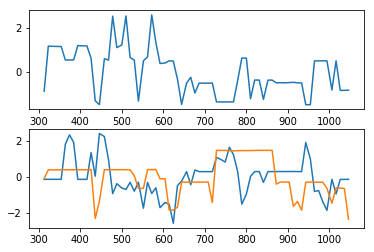

subject 05; gesture 3_0_1; avg 0.9742804972369095; sd 0.010278113059130328
subject 05; gesture 3_0_1; PoV: 0.985611124352192


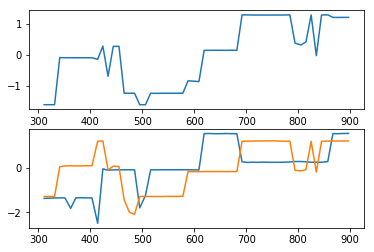

subject 05; gesture 4_1_1; avg 1.584119938777055; sd 0.009012489870084727
subject 05; gesture 4_1_1; PoV: 0.9909779716246508


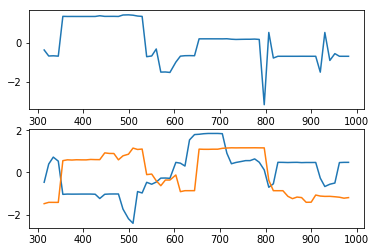

subject 05; gesture 2_0_1; avg 0.8861390206044888; sd 0.007080452880249143
subject 05; gesture 2_0_1; PoV: 0.9890873171250028


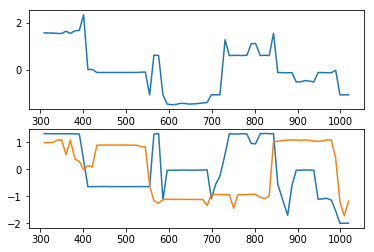

subject 05; gesture 4_1_2; avg 0.9882110816902295; sd 0.008919331429855022
subject 05; gesture 4_1_2; PoV: 0.9884674691281129


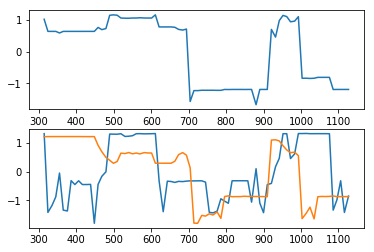

subject 05; gesture 2_0_2; avg 1.0858563793637643; sd 0.020543106437246283
subject 05; gesture 2_0_2; PoV: 0.974248758045126


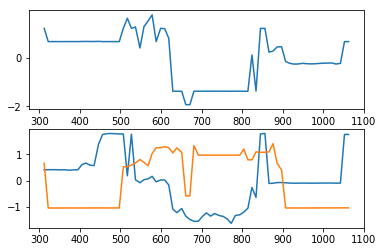

subject 05; gesture 1_1_2; avg 2.4184923212841087; sd 0.03549194617117154
subject 05; gesture 1_1_2; PoV: 0.9813077651022266


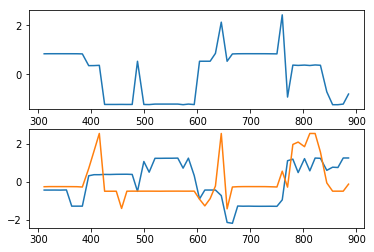

subject 05; gesture 2_1_2; avg 2.0448076208806447; sd 0.015116462584639424
subject 05; gesture 2_1_2; PoV: 0.9931156212206134


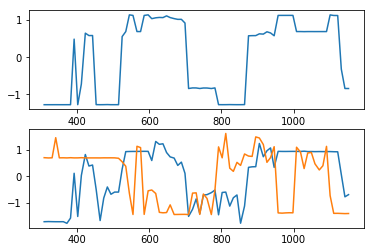

subject 05; gesture 4_0_1; avg 1.6000640010788691; sd 0.019899056908393144
subject 05; gesture 4_0_1; PoV: 0.9861142611090103


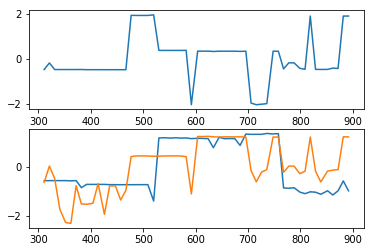

subject 05; gesture 3_0_2; avg 0.7901340590327584; sd 0.006105787174529328
subject 05; gesture 3_0_2; PoV: 0.9860364663435643


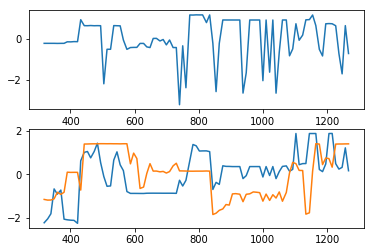

subject 05; gesture 1_1_1; avg 1.4596127454095629; sd 0.019115865705662607
subject 05; gesture 1_1_1; PoV: 0.9793676502478539


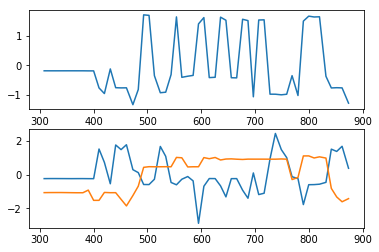

subject 05; gesture 3_1_2; avg 1.3589799241250589; sd 0.01435801011561979
subject 05; gesture 3_1_2; PoV: 0.9838817819665991


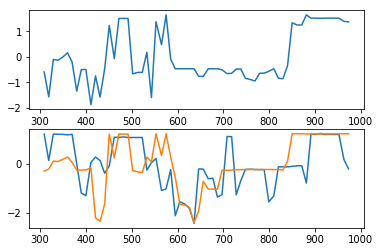

subject 05; gesture 2_1_1; avg 1.1726083413079964; sd 0.009562574777905997
subject 05; gesture 2_1_1; PoV: 0.9878682640237769


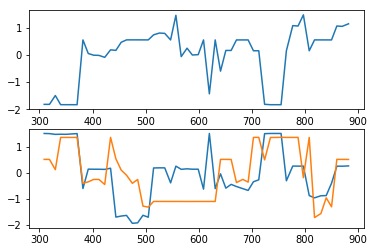

subject 05; gesture 1_0_1; avg 1.4568399598843573; sd 0.03483385828499664
subject 05; gesture 1_0_1; PoV: 0.9740530815540474


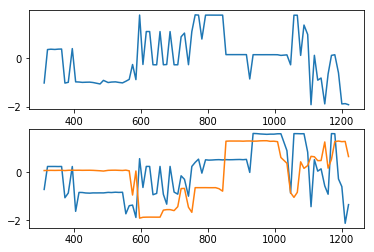

subject 05; gesture 3_1_1; avg 4.6492812870440545; sd 0.02839419586401774
subject 05; gesture 3_1_1; PoV: 0.9942737490270582


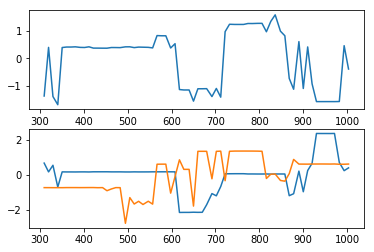

subject 05; gesture 1_0_2; avg 1.6820617792324994; sd 0.03250725290644326
subject 05; gesture 1_0_2; PoV: 0.9725675570253426


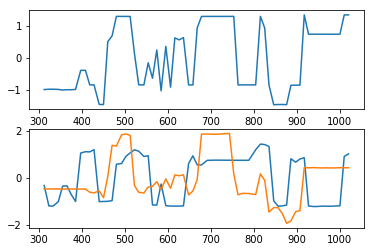

subject 05; gesture 4_0_2; avg 1.481338486463108; sd 0.008358578246051282
subject 05; gesture 4_0_2; PoV: 0.9909391240062083


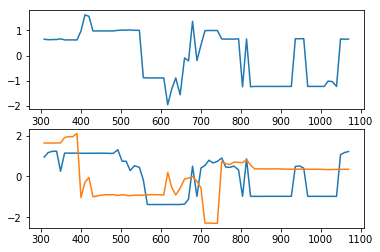

subject 21; gesture 3_0_1; avg 0.952809129027085; sd 0.010924002075537675
subject 21; gesture 3_0_1; PoV: 0.9824123754278709


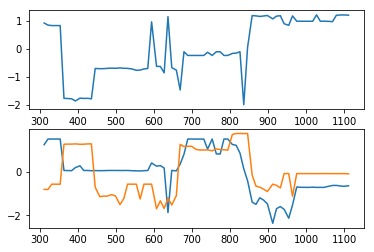

subject 21; gesture 4_1_1; avg 2.117897060382683; sd 0.01250812620841826
subject 21; gesture 4_1_1; PoV: 0.9920887320978813


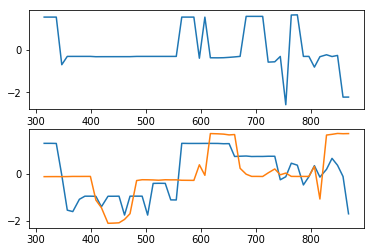

subject 21; gesture 2_0_1; avg 1.3994139496787956; sd 0.01622533643106815
subject 21; gesture 2_0_1; PoV: 0.9842335724471234


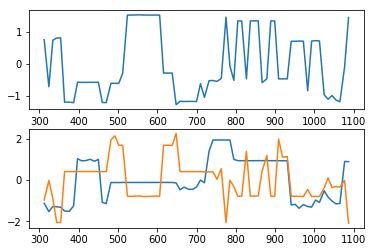

subject 21; gesture 4_1_2; avg 2.533378407198077; sd 0.04091372299864813
subject 21; gesture 4_1_2; PoV: 0.9817623978461021


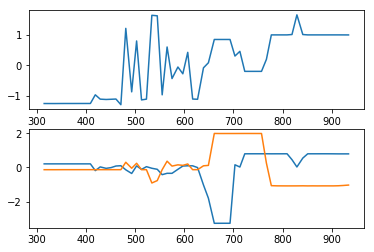

subject 21; gesture 2_0_2; avg 1.7096011087412224; sd 0.0120552424427515
subject 21; gesture 2_0_2; PoV: 0.9857422659208085


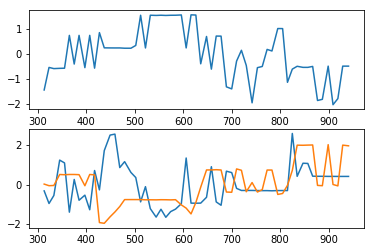

subject 21; gesture 1_1_2; avg 1.59345468786199; sd 0.014093487013185298
subject 21; gesture 1_1_2; PoV: 0.9908554781021932


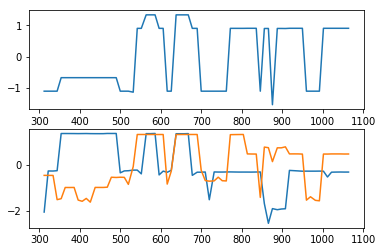

subject 21; gesture 2_1_2; avg 2.2894035232215764; sd 0.01800848164023151
subject 21; gesture 2_1_2; PoV: 0.9885245091570586


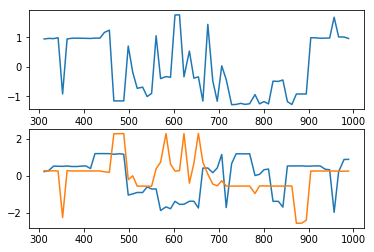

subject 21; gesture 4_0_1; avg 1.1647310246652298; sd 0.011727605276979242
subject 21; gesture 4_0_1; PoV: 0.9830053976285389


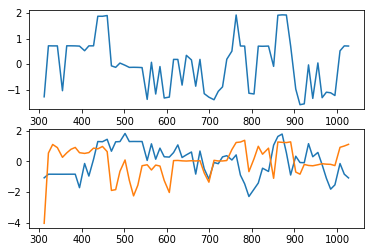

subject 21; gesture 3_0_2; avg 3.2299048584307037; sd 0.01774359585255184
subject 21; gesture 3_0_2; PoV: 0.9927899619498538


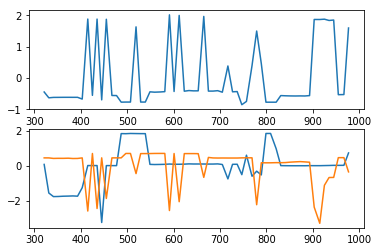

subject 21; gesture 1_1_1; avg 1.4345995249793044; sd 0.10199560316439281
subject 21; gesture 1_1_1; PoV: 0.9471993789596244


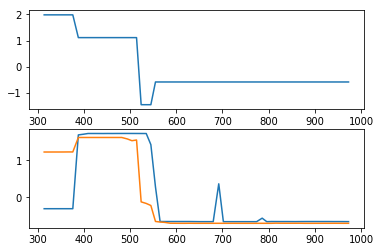

subject 21; gesture 3_1_2; avg 1.2300091616247852; sd 0.019658923177461592
subject 21; gesture 3_1_2; PoV: 0.9860061638100677


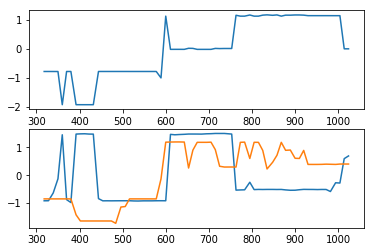

subject 21; gesture 2_1_1; avg 0.7961751302101888; sd 0.015178874180190587
subject 21; gesture 2_1_1; PoV: 0.977314658843402


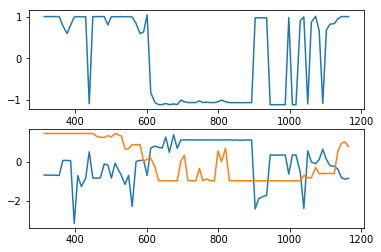

subject 21; gesture 1_0_1; avg 1.685032766553063; sd 0.022065211342026388
subject 21; gesture 1_0_1; PoV: 0.9801896653089925


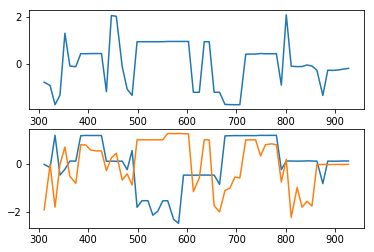

subject 21; gesture 3_1_1; avg 2.0479502023106555; sd 0.014664967867986154
subject 21; gesture 3_1_1; PoV: 0.9909228668522139


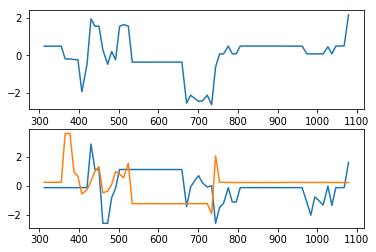

subject 21; gesture 1_0_2; avg 1.0320176993521493; sd 0.011011731518254079
subject 21; gesture 1_0_2; PoV: 0.9865394723329659


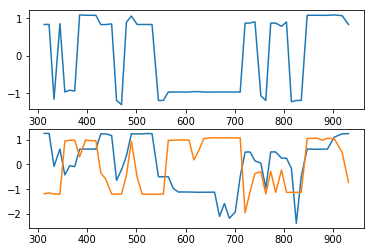

subject 21; gesture 4_0_2; avg 1.1760682393792636; sd 0.009685940263007961
subject 21; gesture 4_0_2; PoV: 0.9875509632443922


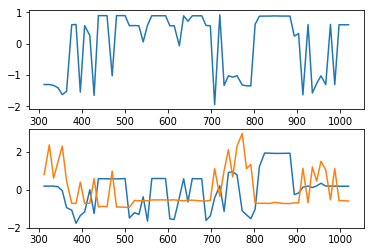

subject 17; gesture 3_0_1; avg 2.1649477151809773; sd 0.018268991484455963
subject 17; gesture 3_0_1; PoV: 0.9859622289652313


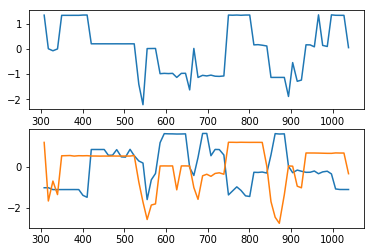

subject 17; gesture 4_1_1; avg 1.4746691125929012; sd 0.012790791639440899
subject 17; gesture 4_1_1; PoV: 0.9904798396795034


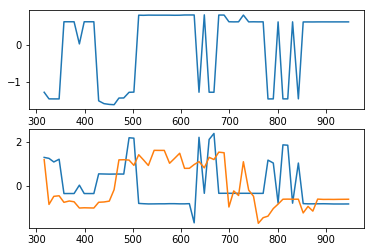

subject 17; gesture 2_0_1; avg 1.5119221736710384; sd 0.012963598748567605
subject 17; gesture 2_0_1; PoV: 0.9887526086803354


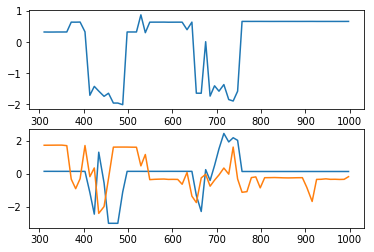

subject 17; gesture 4_1_2; avg 3.1799483508089827; sd 0.10543449919223845
subject 17; gesture 4_1_2; PoV: 0.9749440030301487


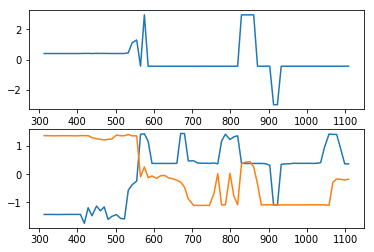

subject 17; gesture 2_0_2; avg 1.5612772019583891; sd 0.018341472256018558
subject 17; gesture 2_0_2; PoV: 0.9788269283635543


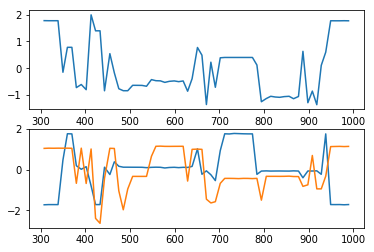

subject 17; gesture 1_1_2; avg 1.445380441391098; sd 0.009736268153470349
subject 17; gesture 1_1_2; PoV: 0.9904102902591315


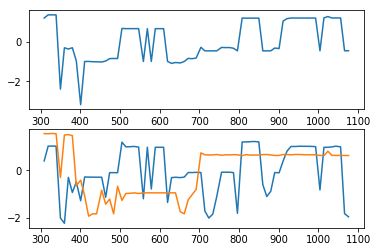

subject 17; gesture 2_1_2; avg 1.6358662590768382; sd 0.028519763454243507
subject 17; gesture 2_1_2; PoV: 0.9794689187238923


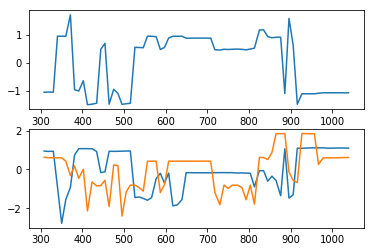

subject 17; gesture 4_0_1; avg 3.8795589591700446; sd 0.04475717813365289
subject 17; gesture 4_0_1; PoV: 0.9822399882811632


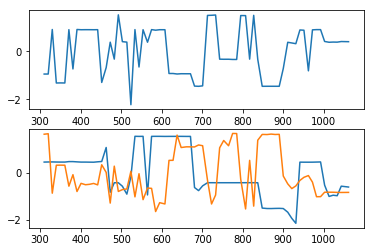

subject 17; gesture 3_0_2; avg 1.760034477600141; sd 0.025139892909273102
subject 17; gesture 3_0_2; PoV: 0.97928594080014


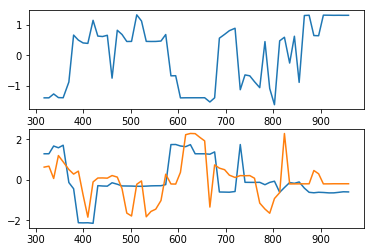

subject 17; gesture 1_1_1; avg 1.3884077322728106; sd 0.01236669662022739
subject 17; gesture 1_1_1; PoV: 0.9883268281856097


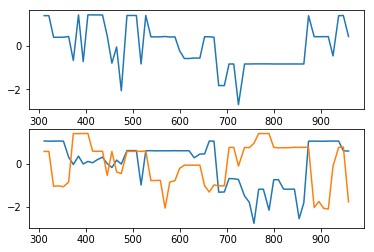

subject 17; gesture 3_1_2; avg 1.100945864141572; sd 0.009534597393559021
subject 17; gesture 3_1_2; PoV: 0.9860696590208933


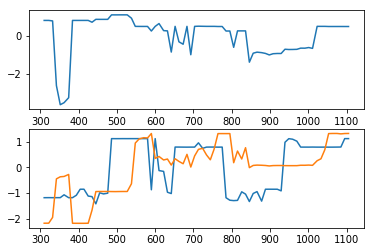

subject 17; gesture 2_1_1; avg 1.070239951150407; sd 0.010411260595477333
subject 17; gesture 2_1_1; PoV: 0.9872377562075452


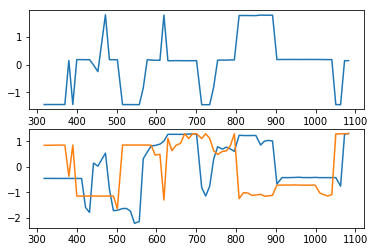

subject 17; gesture 1_0_1; avg 1.3209388092966725; sd 0.014354607224153484
subject 17; gesture 1_0_1; PoV: 0.9810590116010582


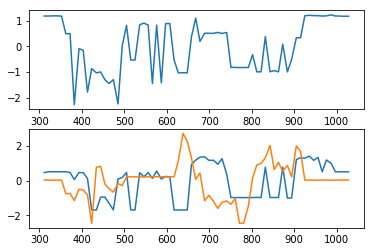

subject 17; gesture 3_1_1; avg 1.740210618830606; sd 0.02904891983378337
subject 17; gesture 3_1_1; PoV: 0.9675614170809999


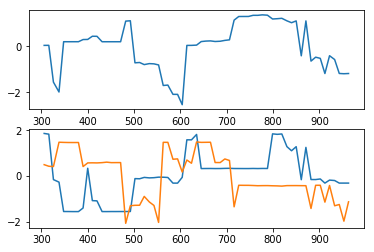

subject 17; gesture 1_0_2; avg 1.1566540907184668; sd 0.025766735348776826
subject 17; gesture 1_0_2; PoV: 0.9737859527587183


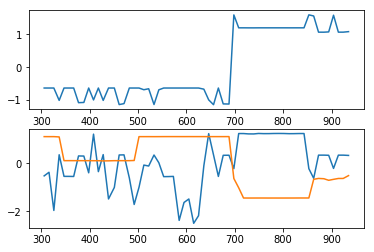

subject 17; gesture 4_0_2; avg 1.1425697246507402; sd 0.014690240758599789
subject 17; gesture 4_0_2; PoV: 0.9783170866651851


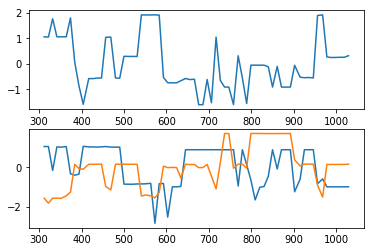

subject 01; gesture 3_0_1; avg 1.257919541826558; sd 0.010681580265260256
subject 01; gesture 3_0_1; PoV: 0.987693770392291


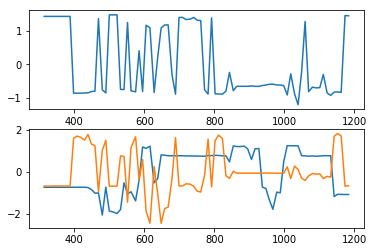

subject 01; gesture 4_1_1; avg 2.9471960863265316; sd 0.016072131469233707
subject 01; gesture 4_1_1; PoV: 0.993668651532632


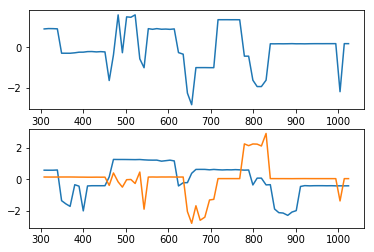

subject 01; gesture 2_0_1; avg 1.1279870465122595; sd 0.009733830174194182
subject 01; gesture 2_0_1; PoV: 0.9879323709823382


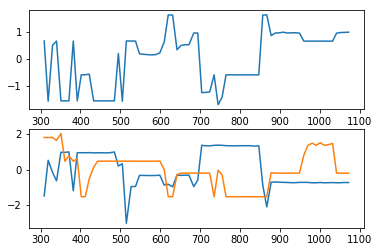

subject 01; gesture 4_1_2; avg 1.365539028913601; sd 0.10153274088383915
subject 01; gesture 4_1_2; PoV: 0.9394445645516729


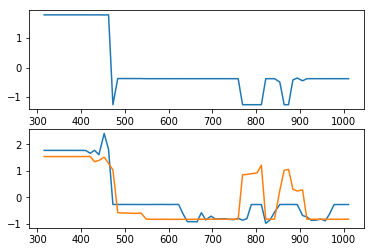

subject 01; gesture 2_0_2; avg 1.632666877922154; sd 0.012618688886787703
subject 01; gesture 2_0_2; PoV: 0.9894014158092183


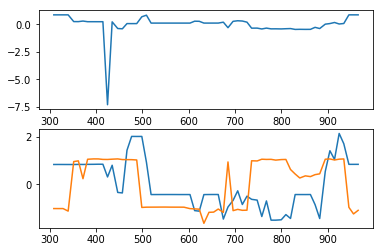

subject 01; gesture 1_1_2; avg 2.1276752912440338; sd 0.06820624996127861
subject 01; gesture 1_1_2; PoV: 0.9773798156227713


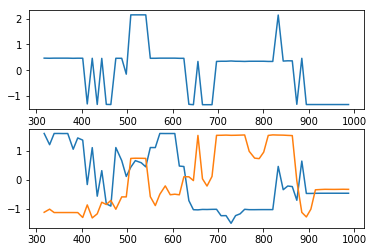

subject 01; gesture 2_1_2; avg 0.9263432053593346; sd 0.00666080844208875
subject 01; gesture 2_1_2; PoV: 0.9896984984495489


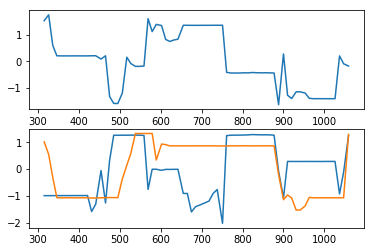

subject 01; gesture 4_0_1; avg 1.2860565798161643; sd 0.04398558022543274
subject 01; gesture 4_0_1; PoV: 0.9542166604519056


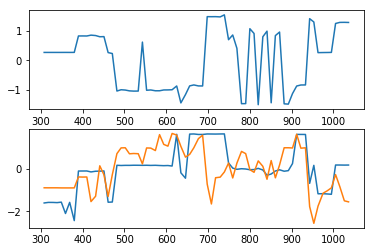

subject 01; gesture 3_0_2; avg 0.9725501555914261; sd 0.008303508133254391
subject 01; gesture 3_0_2; PoV: 0.9874904402096732


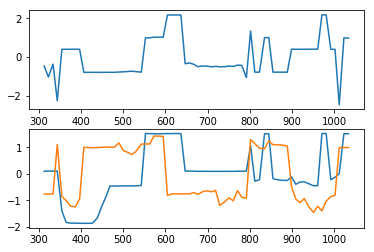

subject 01; gesture 1_1_1; avg 1.420741934365865; sd 0.011935803081268844
subject 01; gesture 1_1_1; PoV: 0.987167859256679


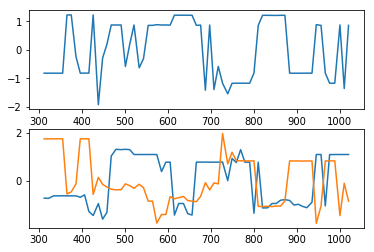

subject 01; gesture 3_1_2; avg 1.1095157328742051; sd 0.011335048175582032
subject 01; gesture 3_1_2; PoV: 0.9818957863442064


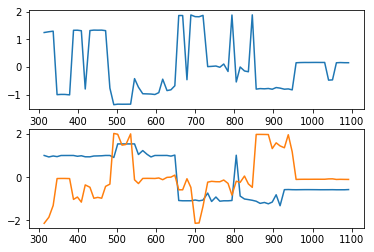

subject 01; gesture 2_1_1; avg 0.9946867238746191; sd 0.005665838200841515
subject 01; gesture 2_1_1; PoV: 0.992303158534636


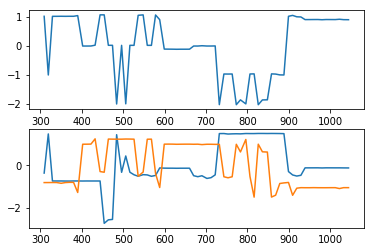

subject 01; gesture 1_0_1; avg 1.4551975092916691; sd 0.013806852699258078
subject 01; gesture 1_0_1; PoV: 0.9898022010882868


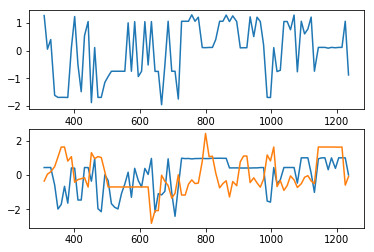

subject 01; gesture 3_1_1; avg 1.027708220378051; sd 0.008780101646380866
subject 01; gesture 3_1_1; PoV: 0.9876767145775195


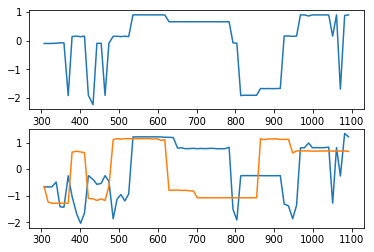

subject 01; gesture 1_0_2; avg 1.1535274531432138; sd 0.010264220425634909
subject 01; gesture 1_0_2; PoV: 0.9851811139965689


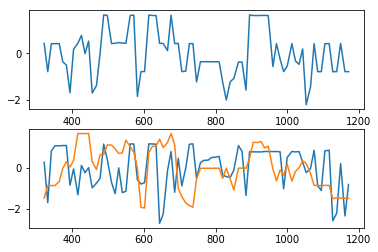

subject 01; gesture 4_0_2; avg 0.913771711076668; sd 0.006896824467045804
subject 01; gesture 4_0_2; PoV: 0.9896983539965526


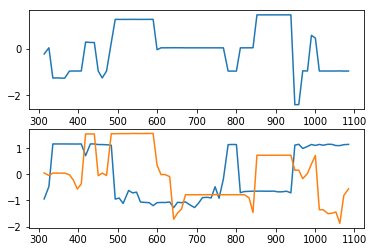

subject 16; gesture 3_0_1; avg 0.8982176956450911; sd 0.011640049566281714
subject 16; gesture 3_0_1; PoV: 0.984315499586186


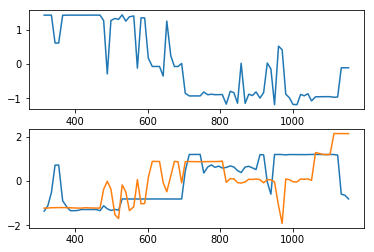

subject 16; gesture 4_1_1; avg 2.2675296074954763; sd 0.03104457607629633
subject 16; gesture 4_1_1; PoV: 0.9763537441729654


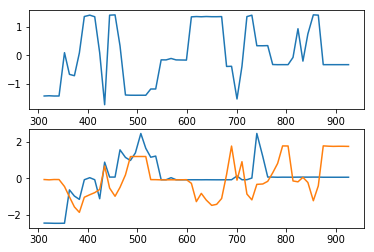

subject 16; gesture 2_0_1; avg 1.9544409479335245; sd 0.018724337058600108
subject 16; gesture 2_0_1; PoV: 0.9872474011412274


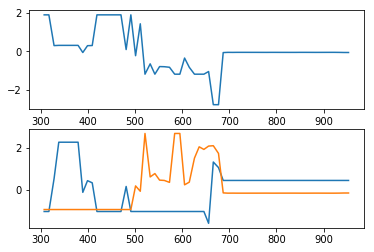

subject 16; gesture 4_1_2; avg 2.239029850773593; sd 0.015452196724481872
subject 16; gesture 4_1_2; PoV: 0.9918048616857479


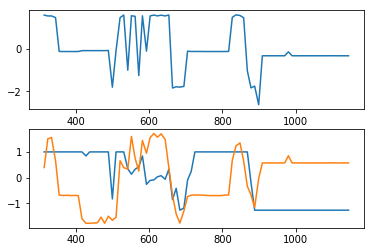

subject 16; gesture 2_0_2; avg 1.4807043971313347; sd 0.012995651815056186
subject 16; gesture 2_0_2; PoV: 0.9885887772177888


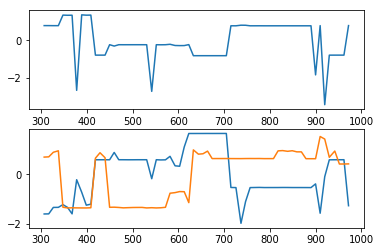

subject 16; gesture 1_1_2; avg 1.1744898867277498; sd 0.00941179937769578
subject 16; gesture 1_1_2; PoV: 0.9891576321623649


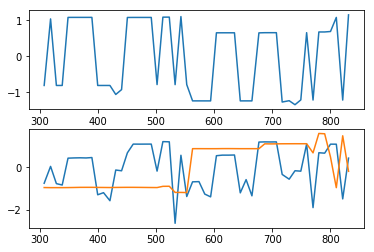

subject 16; gesture 2_1_2; avg 1.0173708577679281; sd 0.014148535832067507
subject 16; gesture 2_1_2; PoV: 0.9814126353159871


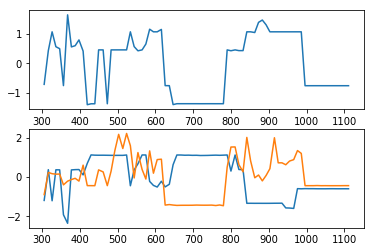

subject 16; gesture 4_0_1; avg 0.9534606604246876; sd 0.009197337307582786
subject 16; gesture 4_0_1; PoV: 0.9865850045680624


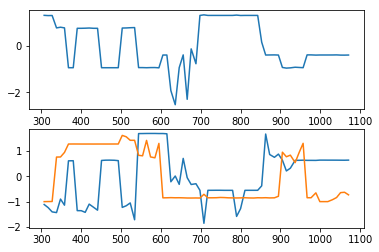

subject 16; gesture 3_0_2; avg 2.4419014267484043; sd 0.02200456938619809
subject 16; gesture 3_0_2; PoV: 0.9886773491723605


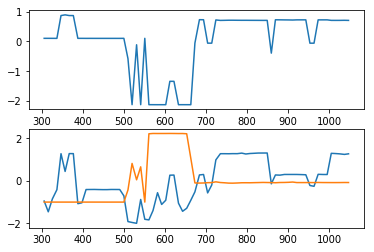

subject 16; gesture 1_1_1; avg 1.305039909110727; sd 0.01753896799023935
subject 16; gesture 1_1_1; PoV: 0.982315772408175


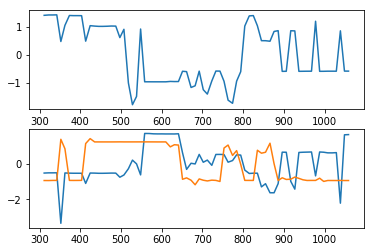

subject 16; gesture 3_1_2; avg 1.4015357126354022; sd 0.012851557857771168
subject 16; gesture 3_1_2; PoV: 0.9865327927955114


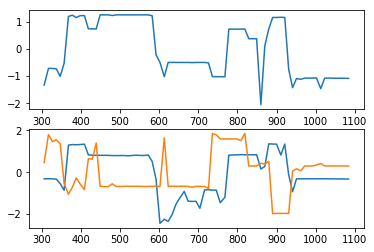

subject 16; gesture 2_1_1; avg 2.5706550159353982; sd 0.02906464852246452
subject 16; gesture 2_1_1; PoV: 0.9778946554534258


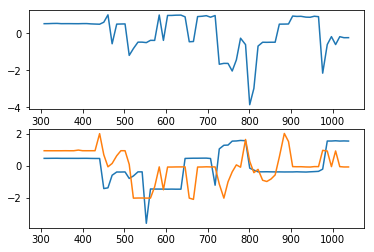

subject 16; gesture 1_0_1; avg 2.9453452740681536; sd 0.07132482882252215
subject 16; gesture 1_0_1; PoV: 0.966584840665891


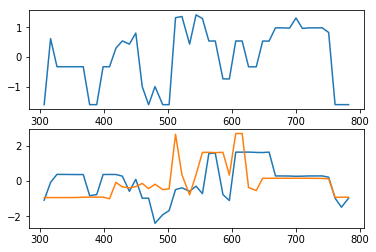

subject 16; gesture 3_1_1; avg 1.0732044109819148; sd 0.016295362871081305
subject 16; gesture 3_1_1; PoV: 0.9803261207341322


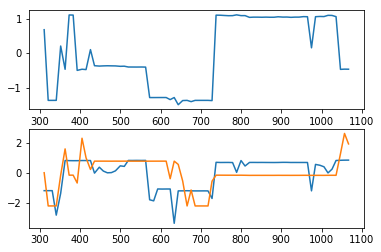

subject 16; gesture 1_0_2; avg 1.620929436463051; sd 0.020245590066628252
subject 16; gesture 1_0_2; PoV: 0.9770338534398232


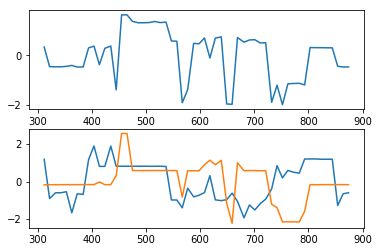

subject 16; gesture 4_0_2; avg 0.973461802607166; sd 0.007581401906758269
subject 16; gesture 4_0_2; PoV: 0.9900144447713023


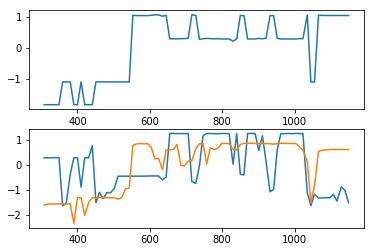

subject 26; gesture 3_0_1; avg 1.3039253120647425; sd 0.01605641341329689
subject 26; gesture 3_0_1; PoV: 0.9811440524548881


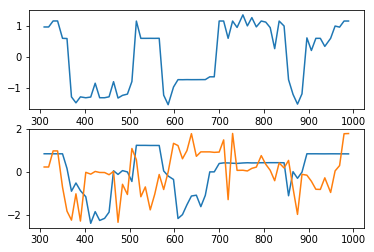

subject 26; gesture 4_1_1; avg 1.3764339357063493; sd 0.01746460636690785
subject 26; gesture 4_1_1; PoV: 0.9779478777279742


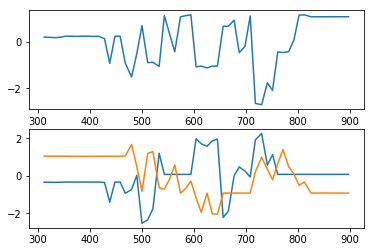

subject 26; gesture 2_0_1; avg 1.0213501252231085; sd 0.010128541122536689
subject 26; gesture 2_0_1; PoV: 0.9865546478101568


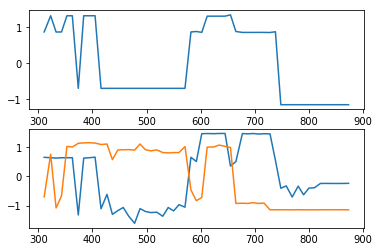

subject 26; gesture 4_1_2; avg 0.6041707756932134; sd 0.4777012626216088
subject 26; gesture 4_1_2; PoV: 0.6014551441234774


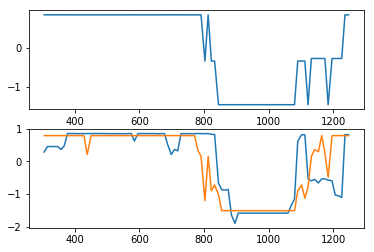

subject 26; gesture 2_0_2; avg 1.7965062724559553; sd 0.027224018309810107
subject 26; gesture 2_0_2; PoV: 0.9798764768913656


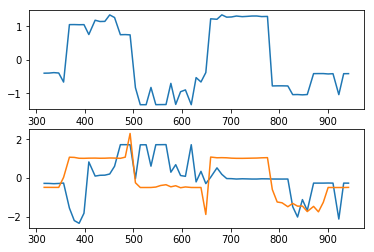

subject 26; gesture 1_1_2; avg 1.2980011534145037; sd 0.014323262546559367
subject 26; gesture 1_1_2; PoV: 0.9803671411260139


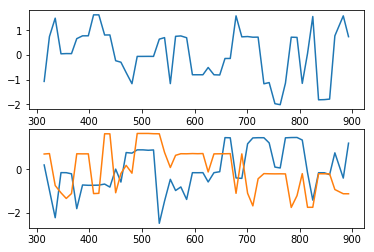

subject 26; gesture 2_1_2; avg 2.1524595096493266; sd 0.013430413570120217
subject 26; gesture 2_1_2; PoV: 0.9909741167486595


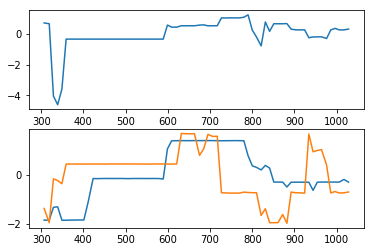

subject 26; gesture 4_0_1; avg 1.7592933791050498; sd 0.017234108971095605
subject 26; gesture 4_0_1; PoV: 0.9879627668658207


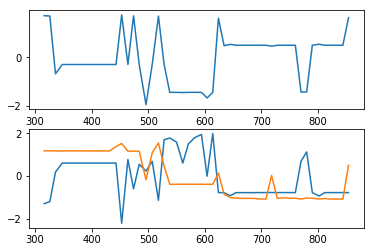

subject 26; gesture 3_0_2; avg 2.6408480702573884; sd 0.02949538784360833
subject 26; gesture 3_0_2; PoV: 0.982732392002439


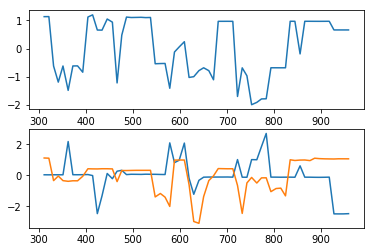

subject 26; gesture 1_1_1; avg 1.318506222348089; sd 0.01486436199096495
subject 26; gesture 1_1_1; PoV: 0.9815679208195255


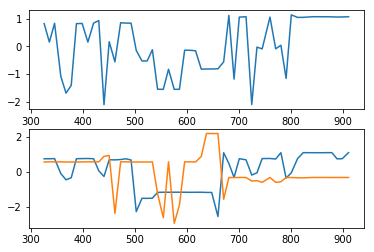

subject 26; gesture 3_1_2; avg 1.055682207982903; sd 0.010909190841927612
subject 26; gesture 3_1_2; PoV: 0.9842137313322143


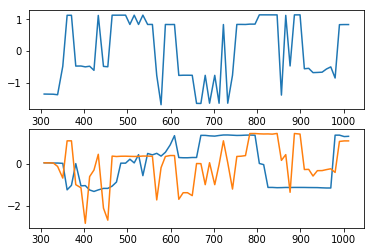

subject 26; gesture 2_1_1; avg 2.3414775116114077; sd 0.013780980031234593
subject 26; gesture 2_1_1; PoV: 0.9890488526234992


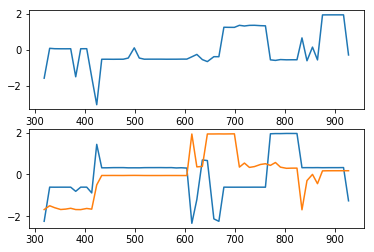

subject 26; gesture 1_0_1; avg 0.6281930207778192; sd 0.006981154633686178
subject 26; gesture 1_0_1; PoV: 0.9873220703518428


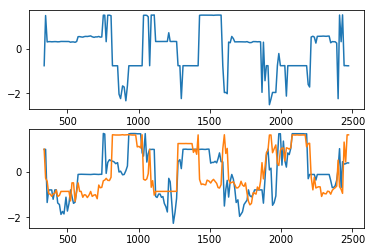

subject 26; gesture 3_1_1; avg 0.9729128266046276; sd 0.007219995619934014
subject 26; gesture 3_1_1; PoV: 0.9900291772403214


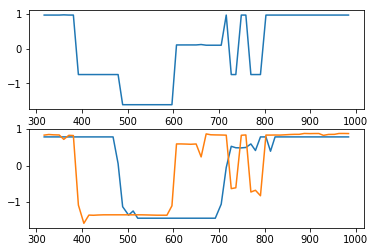

subject 26; gesture 1_0_2; avg 1.4148112023649424; sd 0.017146398393651875
subject 26; gesture 1_0_2; PoV: 0.9769086608560958


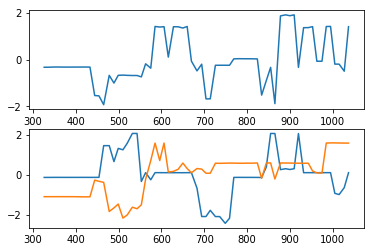

subject 26; gesture 4_0_2; avg 2.363064602589595; sd 0.014904505837577603
subject 26; gesture 4_0_2; PoV: 0.9912086997263838


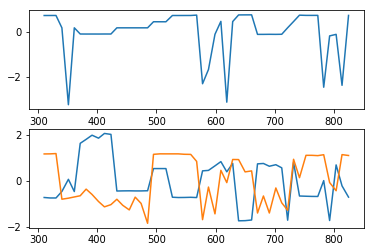

subject 32; gesture 3_0_1; avg 1.0240898925287754; sd 0.00912765045292424
subject 32; gesture 3_0_1; PoV: 0.9905352849819479


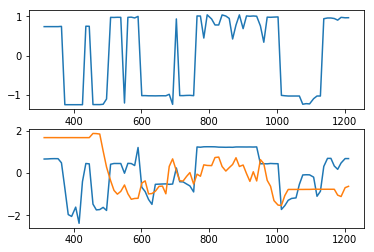

subject 32; gesture 4_1_1; avg 1.9039883646676314; sd 0.012486715076959623
subject 32; gesture 4_1_1; PoV: 0.9926065757717326


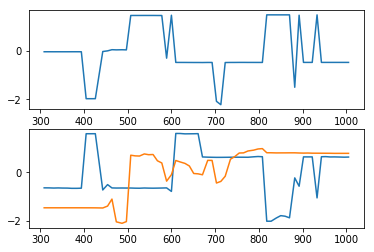

subject 32; gesture 2_0_1; avg 0.9358179657562418; sd 0.008602561754176176
subject 32; gesture 2_0_1; PoV: 0.9862947031371793


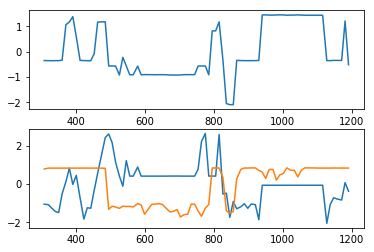

subject 32; gesture 4_1_2; avg 1.0016759157225608; sd 0.007889578594412439
subject 32; gesture 4_1_2; PoV: 0.9870879067947959


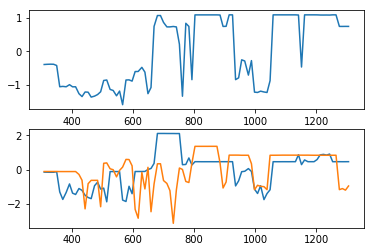

subject 32; gesture 2_0_2; avg 0.9854053693367558; sd 0.010524653513000524
subject 32; gesture 2_0_2; PoV: 0.9843647904629604


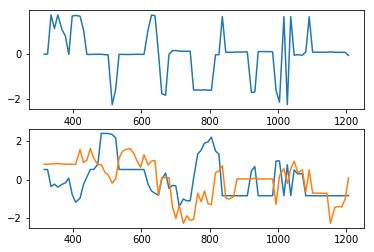

subject 32; gesture 1_1_2; avg 1.1841670691167054; sd 0.009221070108963047
subject 32; gesture 1_1_2; PoV: 0.9887467789949598


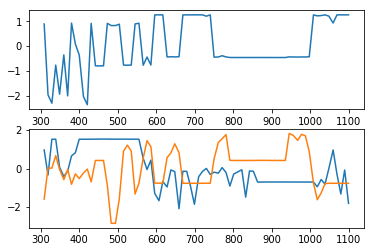

subject 32; gesture 2_1_2; avg 0.8946787179196709; sd 0.007929351326085644
subject 32; gesture 2_1_2; PoV: 0.9885468206238873


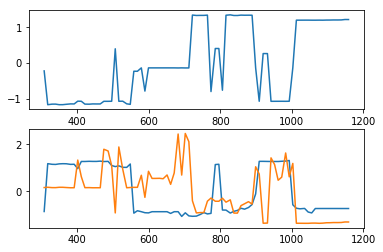

subject 32; gesture 4_0_1; avg 0.9021988464616898; sd 0.009449295707147098
subject 32; gesture 4_0_1; PoV: 0.9858856497136247


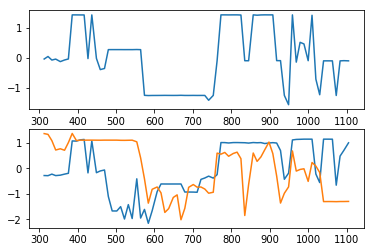

subject 32; gesture 3_0_2; avg 1.3550301384801944; sd 0.014556349282158949
subject 32; gesture 3_0_2; PoV: 0.9858763750783468


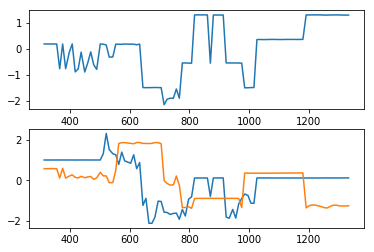

subject 32; gesture 1_1_1; avg 1.3856782591143388; sd 0.0072356188028623895
subject 32; gesture 1_1_1; PoV: 0.9930433425656826


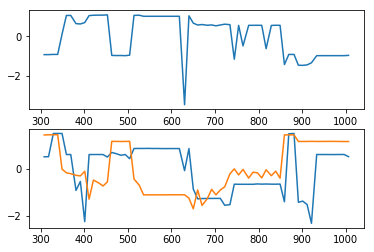

subject 32; gesture 3_1_2; avg 0.6328124116070527; sd 0.005027466846097173
subject 32; gesture 3_1_2; PoV: 0.9893217210533385


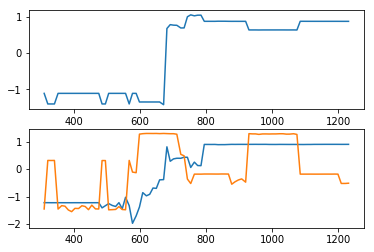

subject 32; gesture 2_1_1; avg 1.2086208483692022; sd 0.015122554748361742
subject 32; gesture 2_1_1; PoV: 0.9777577161536277


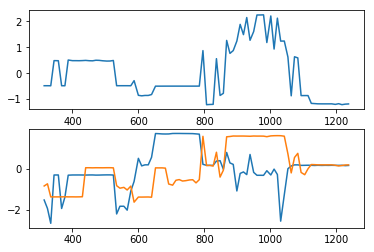

subject 32; gesture 1_0_1; avg 1.7348952930301427; sd 0.011788024149657288
subject 32; gesture 1_0_1; PoV: 0.9911429423639911


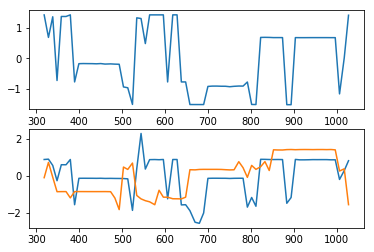

subject 32; gesture 3_1_1; avg 0.7591950995462131; sd 0.006459141284827035
subject 32; gesture 3_1_1; PoV: 0.987979451706228


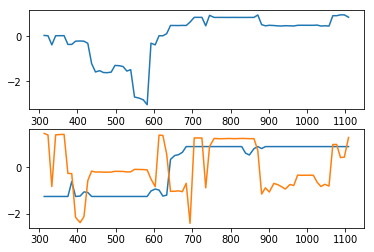

subject 32; gesture 1_0_2; avg 1.1407487591587309; sd 0.007972461439079646
subject 32; gesture 1_0_2; PoV: 0.9903565752983203


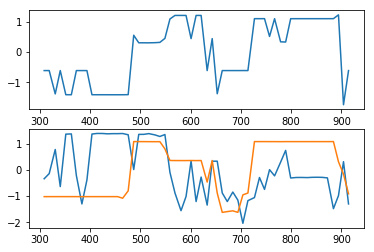

subject 32; gesture 4_0_2; avg 1.1216623272803208; sd 0.013417435391780962
subject 32; gesture 4_0_2; PoV: 0.9860734351274613


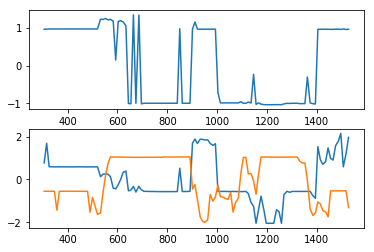

subject 04; gesture 3_0_1; avg 1.2462102106036252; sd 0.009194781123148699
subject 04; gesture 3_0_1; PoV: 0.9908677922556183


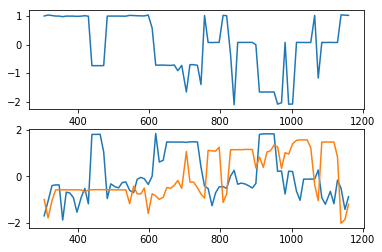

subject 04; gesture 4_1_1; avg 1.3840360442354391; sd 0.012862635533496753
subject 04; gesture 4_1_1; PoV: 0.9847286985672641


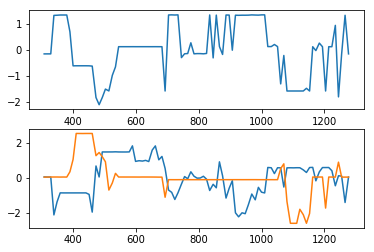

subject 04; gesture 2_0_1; avg 1.7099466236359386; sd 0.015245838067253043
subject 04; gesture 2_0_1; PoV: 0.987978914803519


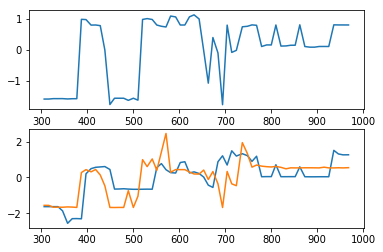

subject 04; gesture 4_1_2; avg 1.0900406142776526; sd 0.01622834146860854
subject 04; gesture 4_1_2; PoV: 0.9817941492745731


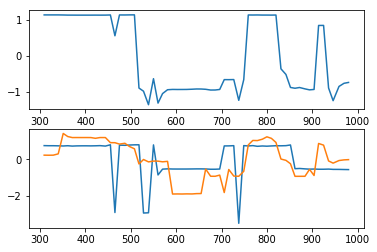

subject 04; gesture 2_0_2; avg 1.6660222276946228; sd 0.01697654395399343
subject 04; gesture 2_0_2; PoV: 0.9771528176439556


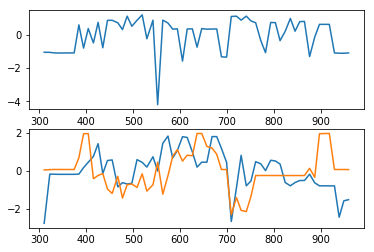

subject 04; gesture 1_1_2; avg 1.4114985199795453; sd 0.03090905877995748
subject 04; gesture 1_1_2; PoV: 0.9811706035245615


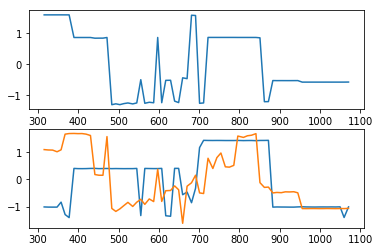

subject 04; gesture 2_1_2; avg 1.0385176805734466; sd 0.007616698944364076
subject 04; gesture 2_1_2; PoV: 0.9902094192571146


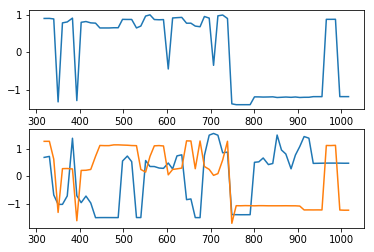

subject 04; gesture 4_0_1; avg 3.3719164087294926; sd 0.05361069257526954
subject 04; gesture 4_0_1; PoV: 0.9742083892277779


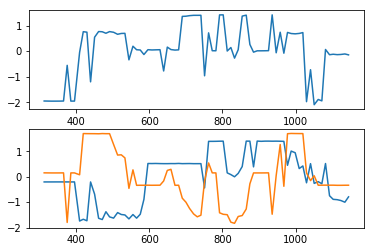

subject 04; gesture 3_0_2; avg 1.2855315421184796; sd 0.013812181244758229
subject 04; gesture 3_0_2; PoV: 0.9804574874914989


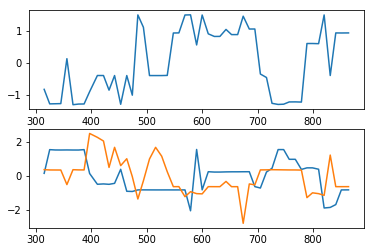

subject 04; gesture 1_1_1; avg 0.9633859407793469; sd 0.010783318756027001
subject 04; gesture 1_1_1; PoV: 0.9823744422050507


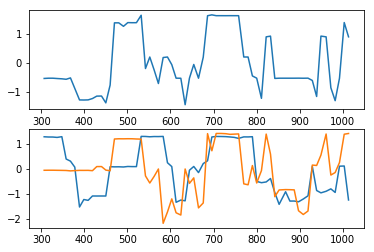

subject 04; gesture 3_1_2; avg 1.4418394435377149; sd 0.01369838344774938
subject 04; gesture 3_1_2; PoV: 0.9846348926602253


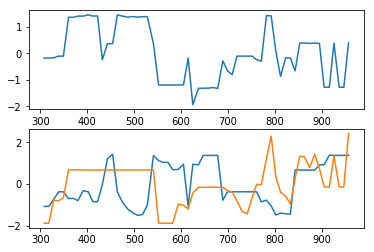

subject 04; gesture 2_1_1; avg 1.3839438302829816; sd 0.009466243594786374
subject 04; gesture 2_1_1; PoV: 0.9910276029147629


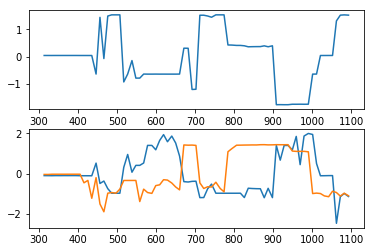

subject 04; gesture 1_0_1; avg 1.937996082492082; sd 0.03722436892496027
subject 04; gesture 1_0_1; PoV: 0.9764751572898926


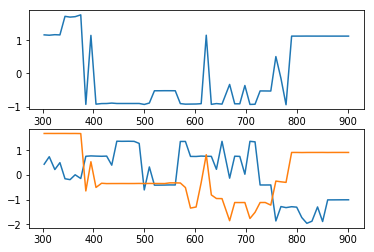

subject 04; gesture 3_1_1; avg 0.9753894722660549; sd 0.006313365145632363
subject 04; gesture 3_1_1; PoV: 0.9910645007921448


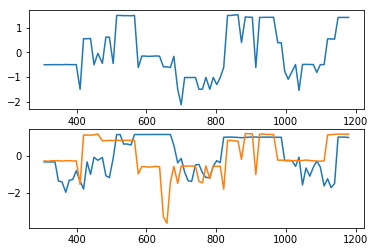

subject 04; gesture 1_0_2; avg 1.1760062927938308; sd 0.017488639937458358
subject 04; gesture 1_0_2; PoV: 0.9802430903604463


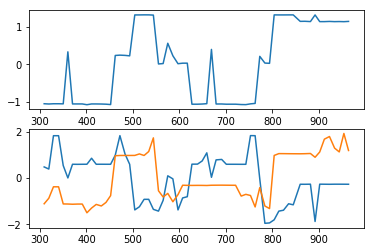

subject 04; gesture 4_0_2; avg 1.5060143657327882; sd 0.013059808168309768
subject 04; gesture 4_0_2; PoV: 0.9872534178369771


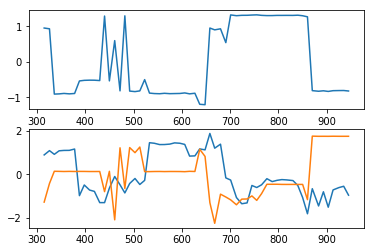

subject 08; gesture 3_0_1; avg 1.5416102537186047; sd 0.01194905889917268
subject 08; gesture 3_0_1; PoV: 0.9895163425921957


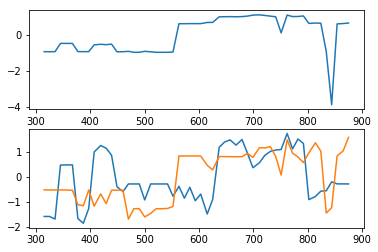

subject 08; gesture 4_1_1; avg 1.3486333518678064; sd 0.014482738789591977
subject 08; gesture 4_1_1; PoV: 0.9866447288986308


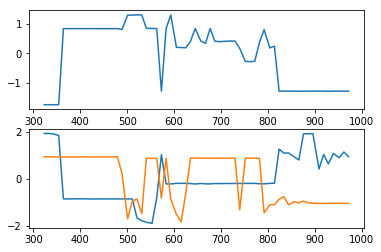

subject 08; gesture 2_0_1; avg 1.7390352932329431; sd 0.01968186527055399
subject 08; gesture 2_0_1; PoV: 0.9809447196963758


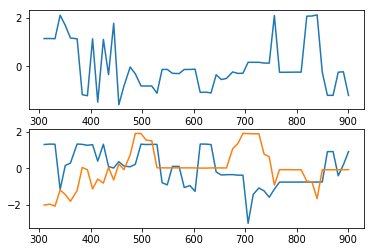

subject 08; gesture 4_1_2; avg 2.9320792350037483; sd 0.14479815487854927
subject 08; gesture 4_1_2; PoV: 0.9620712232983382


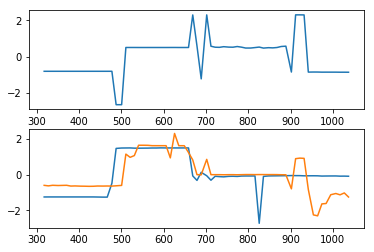

subject 08; gesture 2_0_2; avg 1.3429550835750004; sd 0.031579052448136836
subject 08; gesture 2_0_2; PoV: 0.9694222774400585


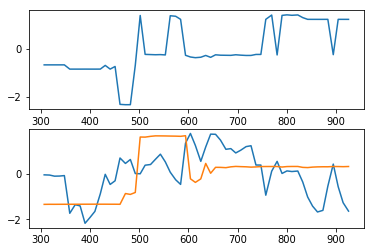

subject 08; gesture 1_1_2; avg 0.8193379242985775; sd 0.006389191706373236
subject 08; gesture 1_1_2; PoV: 0.9892809815374307


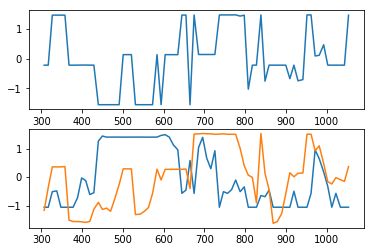

subject 08; gesture 2_1_2; avg 1.1060962338688813; sd 0.023477360434983413
subject 08; gesture 2_1_2; PoV: 0.9747192191113127


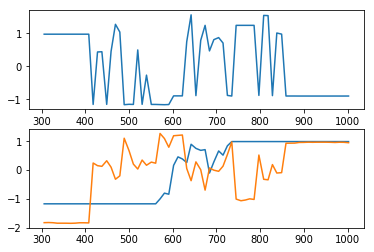

subject 08; gesture 4_0_1; avg 2.1377287928750084; sd 0.05023749688249185
subject 08; gesture 4_0_1; PoV: 0.9760909618971657


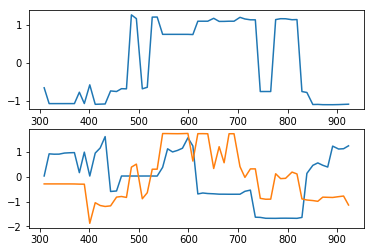

subject 08; gesture 3_0_2; avg 1.3293775385406745; sd 0.015034740718894693
subject 08; gesture 3_0_2; PoV: 0.9813231308807662


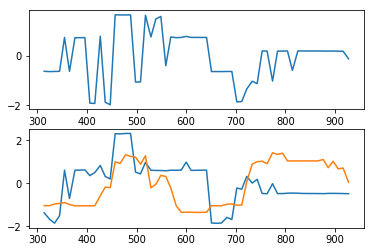

subject 08; gesture 1_1_1; avg 1.5846722832551838; sd 0.013749027220205216
subject 08; gesture 1_1_1; PoV: 0.986580813895112


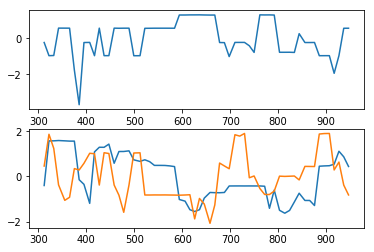

subject 08; gesture 3_1_2; avg 1.9124744438722574; sd 0.018877557086077117
subject 08; gesture 3_1_2; PoV: 0.9818198526721007


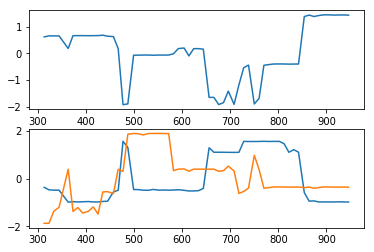

subject 08; gesture 2_1_1; avg 4.547692409226897; sd 0.06704843617295923
subject 08; gesture 2_1_1; PoV: 0.9873513323191444


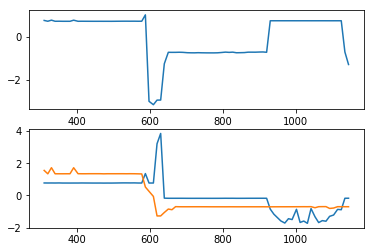

subject 08; gesture 1_0_1; avg 1.8504008046539622; sd 0.012403277105428033
subject 08; gesture 1_0_1; PoV: 0.9927285643805043


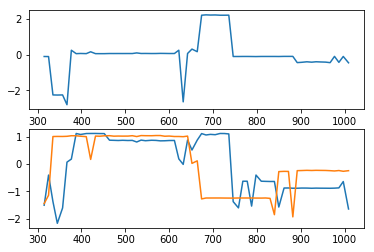

subject 08; gesture 3_1_1; avg 1.632955559854308; sd 0.012436790091931783
subject 08; gesture 3_1_1; PoV: 0.9904552808761447


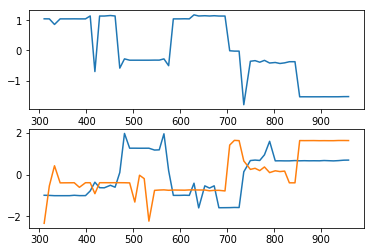

subject 08; gesture 1_0_2; avg 1.4941148204995098; sd 0.016769011732803343
subject 08; gesture 1_0_2; PoV: 0.9832975963424077


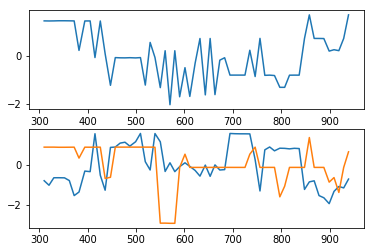

subject 08; gesture 4_0_2; avg 7.903648097791874; sd 0.10962202071795953
subject 08; gesture 4_0_2; PoV: 0.9907843499524195


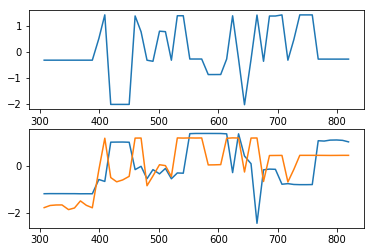

subject 27; gesture 3_0_1; avg 1.161103461837856; sd 0.01595457260578146
subject 27; gesture 3_0_1; PoV: 0.9762311414386518


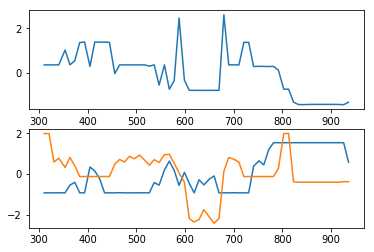

subject 27; gesture 4_1_1; avg 0.8670674947988217; sd 0.008108675356197977
subject 27; gesture 4_1_1; PoV: 0.9875557376309047


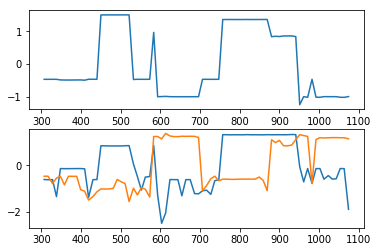

subject 27; gesture 2_0_1; avg 0.9992587206375622; sd 0.01815610958474562
subject 27; gesture 2_0_1; PoV: 0.9677541906214789


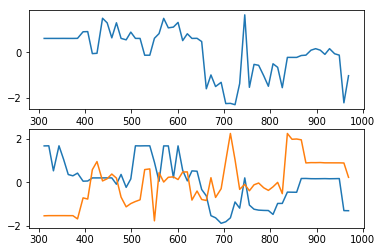

subject 27; gesture 4_1_2; avg 1.0550076570174047; sd 0.010955053395666903
subject 27; gesture 4_1_2; PoV: 0.9883505123980096


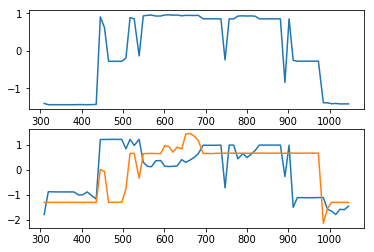

subject 27; gesture 2_0_2; avg 1.2040158234084266; sd 0.012876097836717431
subject 27; gesture 2_0_2; PoV: 0.9798459763217658


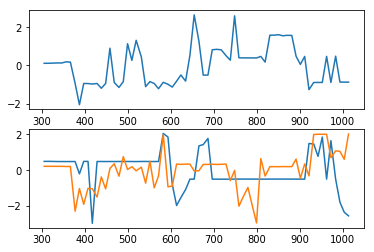

subject 27; gesture 1_1_2; avg 2.257713999316468; sd 0.018527020216879967
subject 27; gesture 1_1_2; PoV: 0.9912895699151482


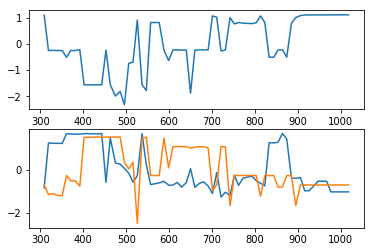

subject 27; gesture 2_1_2; avg 3.72613016117352; sd 0.030545816390337724
subject 27; gesture 2_1_2; PoV: 0.9901434847544712


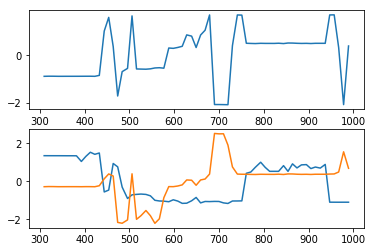

subject 27; gesture 4_0_1; avg 1.3745391292665818; sd 0.012157041750704704
subject 27; gesture 4_0_1; PoV: 0.9845435195180658


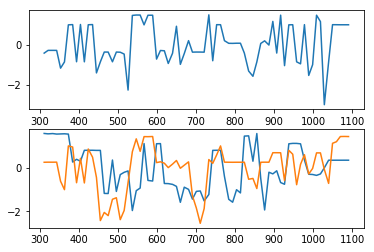

subject 27; gesture 3_0_2; avg 1.8117358527425083; sd 0.022958818234158615
subject 27; gesture 3_0_2; PoV: 0.9875146381515466


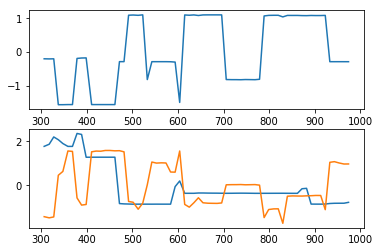

subject 27; gesture 1_1_1; avg 1.1431559799322202; sd 0.008853389383308943
subject 27; gesture 1_1_1; PoV: 0.987993799454888


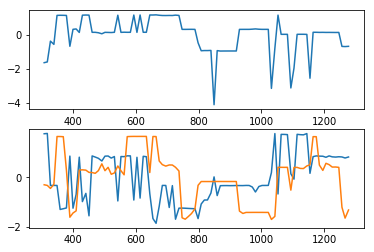

subject 27; gesture 3_1_2; avg 1.6454622407982522; sd 0.04206060414637185
subject 27; gesture 3_1_2; PoV: 0.9715108523743631


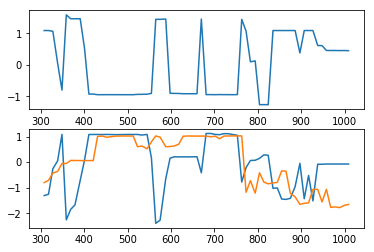

subject 27; gesture 2_1_1; avg 0.9524053435385951; sd 0.00860581368015564
subject 27; gesture 2_1_1; PoV: 0.9874312372194696


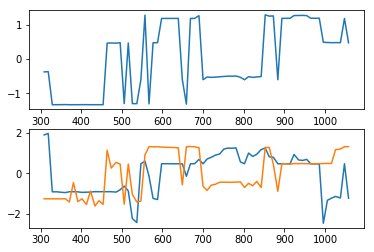

subject 27; gesture 1_0_1; avg 1.6571757928096023; sd 0.015007426552883354
subject 27; gesture 1_0_1; PoV: 0.9868239216829647


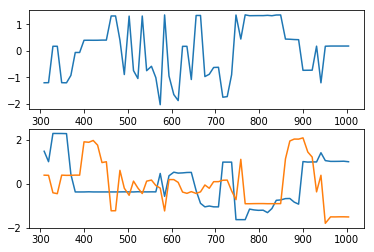

subject 27; gesture 3_1_1; avg 0.9341694784787409; sd 0.009438841937454171
subject 27; gesture 3_1_1; PoV: 0.98719290610481


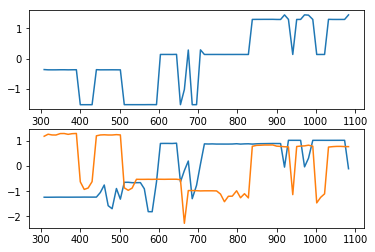

subject 27; gesture 1_0_2; avg 1.0862324770668084; sd 0.008529312011721094
subject 27; gesture 1_0_2; PoV: 0.9901125091576747


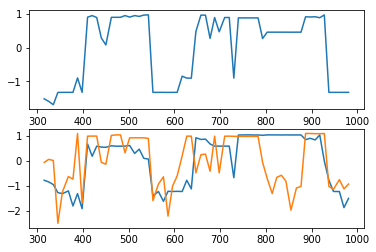

subject 27; gesture 4_0_2; avg 0.9167074733442877; sd 0.0179910106041919
subject 27; gesture 4_0_2; PoV: 0.9712966906327265


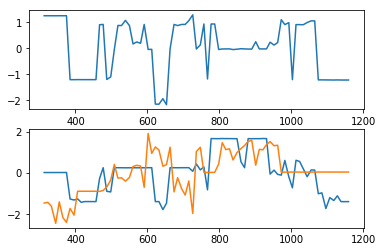

subject 14; gesture 3_0_1; avg 1.088707318369538; sd 0.011856605770468076
subject 14; gesture 3_0_1; PoV: 0.9838468981177091


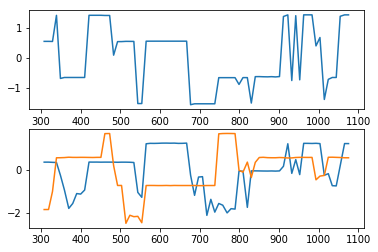

subject 14; gesture 4_1_1; avg 1.3317671058091445; sd 0.012725632296076686
subject 14; gesture 4_1_1; PoV: 0.9883325304231064


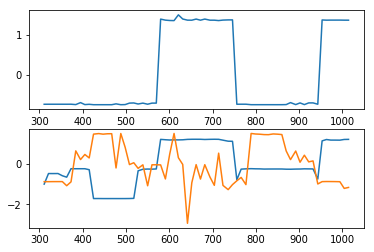

subject 14; gesture 2_0_1; avg 1.524480633614153; sd 0.033251236569134174
subject 14; gesture 2_0_1; PoV: 0.9817568209273081


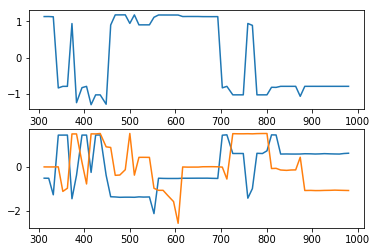

subject 14; gesture 4_1_2; avg 0.9606366273081789; sd 0.008077684442437295
subject 14; gesture 4_1_2; PoV: 0.986187074386124


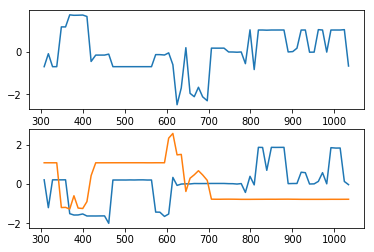

subject 14; gesture 2_0_2; avg 1.9616783294270348; sd 0.016495044465148254
subject 14; gesture 2_0_2; PoV: 0.9882328018391593


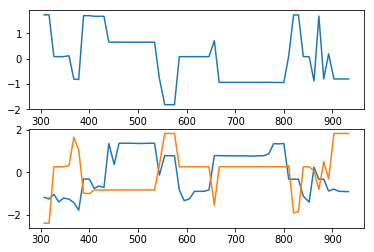

subject 14; gesture 1_1_2; avg 1.5112999055711933; sd 0.011333525055056927
subject 14; gesture 1_1_2; PoV: 0.9888507494117713


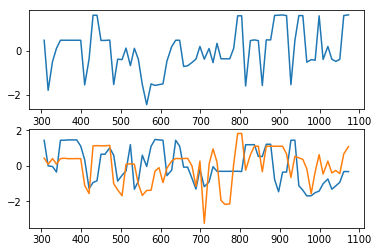

subject 14; gesture 2_1_2; avg 0.9443894005631155; sd 0.006726225499687622
subject 14; gesture 2_1_2; PoV: 0.9903107152047176


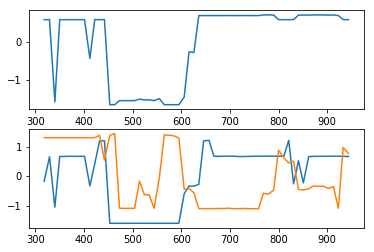

subject 14; gesture 4_0_1; avg 1.1352131052450585; sd 0.008092555614744115
subject 14; gesture 4_0_1; PoV: 0.9895119714940969


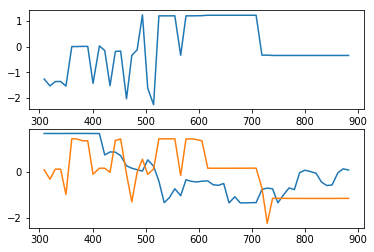

subject 14; gesture 3_0_2; avg 2.4724731572864713; sd 0.01500113822820223
subject 14; gesture 3_0_2; PoV: 0.9927869554313665


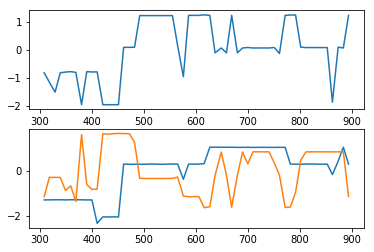

subject 14; gesture 1_1_1; avg 1.563190808077721; sd 0.013909968091556398
subject 14; gesture 1_1_1; PoV: 0.9854105013734966


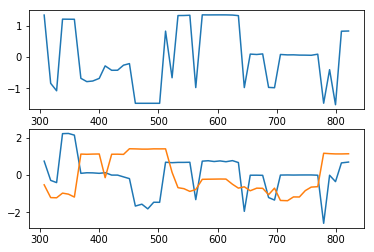

subject 14; gesture 3_1_2; avg 1.02011335929896; sd 0.013555025746395182
subject 14; gesture 3_1_2; PoV: 0.9765181075884455


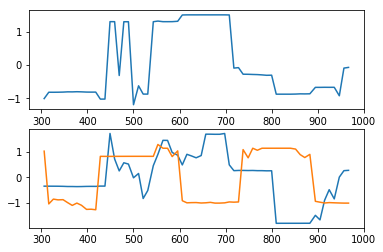

subject 14; gesture 2_1_1; avg 0.9950736943240466; sd 0.006857746159651046
subject 14; gesture 2_1_1; PoV: 0.9909591843756083


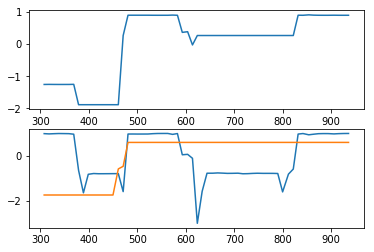

subject 14; gesture 1_0_1; avg 2.123205026602566; sd 0.01441151473188472
subject 14; gesture 1_0_1; PoV: 0.9901560254907865


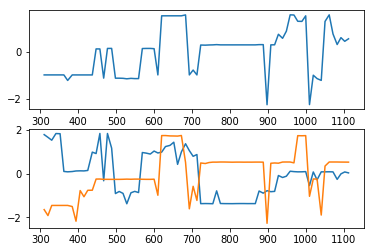

subject 14; gesture 3_1_1; avg 1.7134474506801591; sd 0.02766405261242935
subject 14; gesture 3_1_1; PoV: 0.9792111180949539


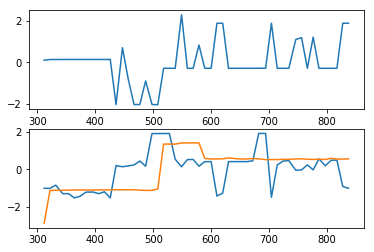

subject 14; gesture 1_0_2; avg 1.4162623314838603; sd 0.009417831946578066
subject 14; gesture 1_0_2; PoV: 0.992446958445743


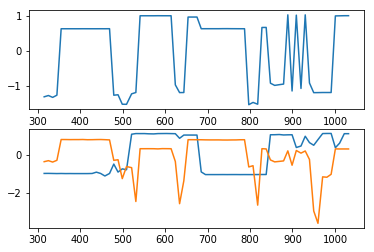

subject 14; gesture 4_0_2; avg 0.8446111629756513; sd 0.006415247039246663
subject 14; gesture 4_0_2; PoV: 0.9882412296057412


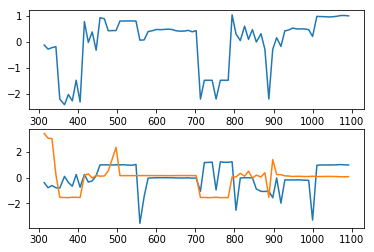

subject 23; gesture 3_0_1; avg 1.382129233810389; sd 0.014871982546392685
subject 23; gesture 3_0_1; PoV: 0.9823486501303975


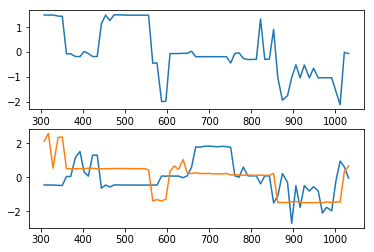

subject 23; gesture 4_1_1; avg 0.9675820948930549; sd 0.009552235143119968
subject 23; gesture 4_1_1; PoV: 0.9864983459407577


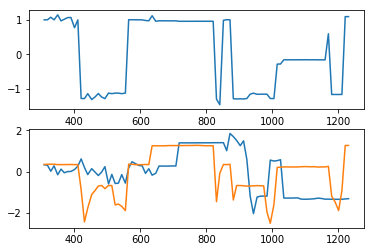

subject 23; gesture 2_0_1; avg 1.366837066621145; sd 0.010517115305293617
subject 23; gesture 2_0_1; PoV: 0.988420438325617


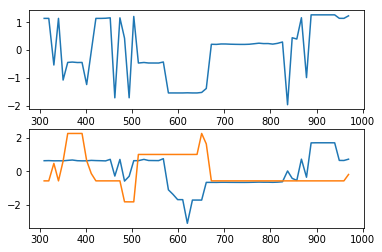

subject 23; gesture 4_1_2; avg 1.2497664897990757; sd 0.01983120306977079
subject 23; gesture 4_1_2; PoV: 0.9760370252250343


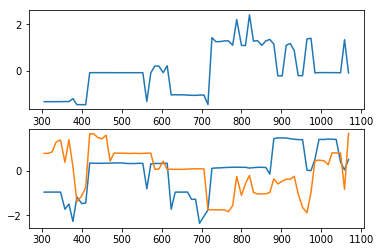

subject 23; gesture 2_0_2; avg 2.4497714517746916; sd 0.024941465934540535
subject 23; gesture 2_0_2; PoV: 0.9854768596400586


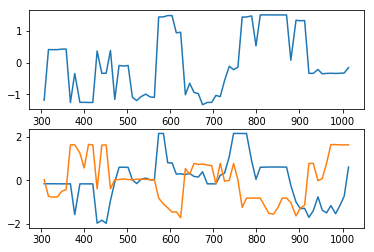

subject 23; gesture 1_1_2; avg 0.8407105238985596; sd 0.006478549977407467
subject 23; gesture 1_1_2; PoV: 0.9873026726961205


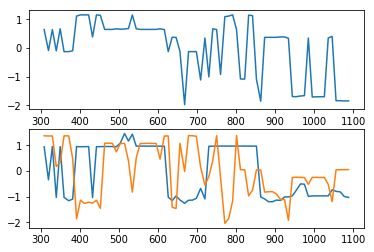

subject 23; gesture 2_1_2; avg 3.1835217004058456; sd 0.019620152305957813
subject 23; gesture 2_1_2; PoV: 0.9916544315799034


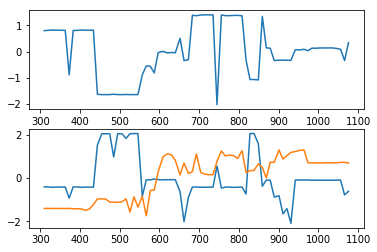

subject 23; gesture 4_0_1; avg 1.7157645959339292; sd 0.013707726573566394
subject 23; gesture 4_0_1; PoV: 0.9894542969096828


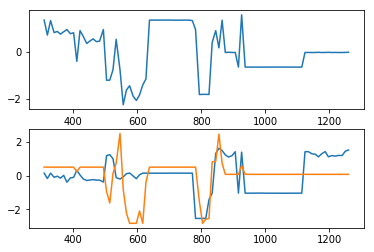

subject 23; gesture 3_0_2; avg 1.3689287328915796; sd 0.01602154649563899
subject 23; gesture 3_0_2; PoV: 0.983876802128951


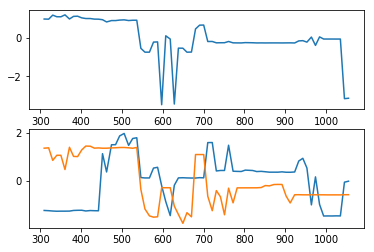

subject 23; gesture 1_1_1; avg 0.9172631986761065; sd 0.009684632710371564
subject 23; gesture 1_1_1; PoV: 0.9808920959856919


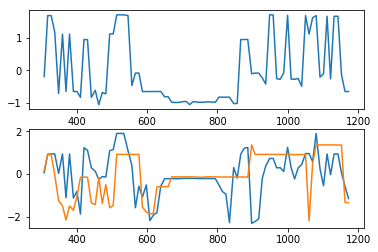

subject 23; gesture 3_1_2; avg 1.0876467616743806; sd 0.008760677178290406
subject 23; gesture 3_1_2; PoV: 0.9873898532092544


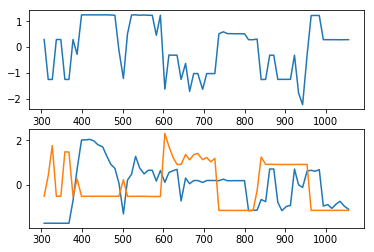

subject 23; gesture 2_1_1; avg 1.282711144379241; sd 0.012894217759945963
subject 23; gesture 2_1_1; PoV: 0.9858760703063592


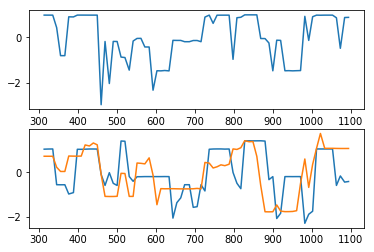

subject 23; gesture 1_0_1; avg 1.3252136990207226; sd 0.01027905637357995
subject 23; gesture 1_0_1; PoV: 0.987675930914414


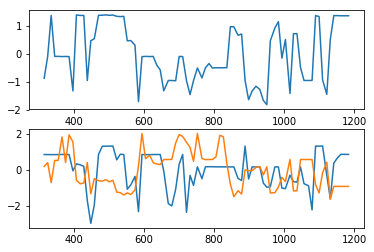

subject 23; gesture 3_1_1; avg 1.0365307711644751; sd 0.019486763601301204
subject 23; gesture 3_1_1; PoV: 0.9739436854555106


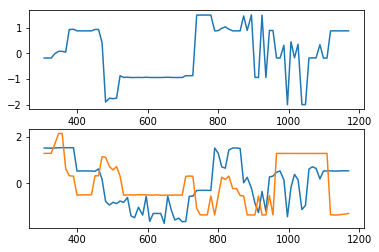

subject 23; gesture 1_0_2; avg 1.2439304123132648; sd 0.009331945699303576
subject 23; gesture 1_0_2; PoV: 0.9888293979601469


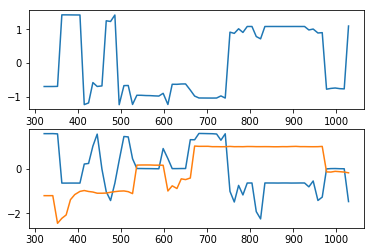

subject 23; gesture 4_0_2; avg 0.9491295146932045; sd 0.010074978644921849
subject 23; gesture 4_0_2; PoV: 0.9838678401764712


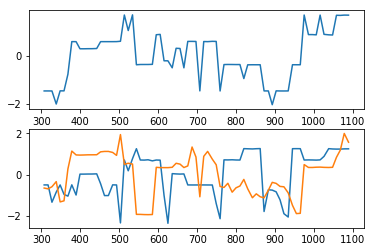

subject 25; gesture 3_0_1; avg 1.5112700177871459; sd 0.018137007531736405
subject 25; gesture 3_0_1; PoV: 0.9809927128135827


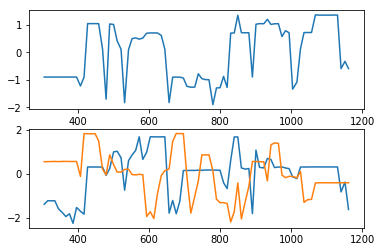

subject 25; gesture 4_1_1; avg 0.9218612083102484; sd 0.02108202615567121
subject 25; gesture 4_1_1; PoV: 0.9747624366299342


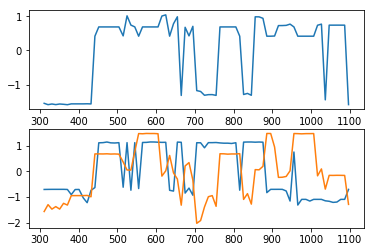

subject 25; gesture 2_0_1; avg 0.9025788010091368; sd 0.006580430036471465
subject 25; gesture 2_0_1; PoV: 0.9864610234841369


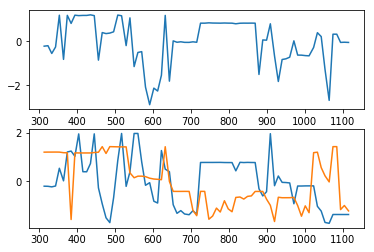

subject 25; gesture 4_1_2; avg 4.020635561912851; sd 0.04534698841740311
subject 25; gesture 4_1_2; PoV: 0.9847235469098364


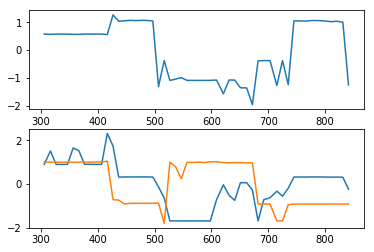

subject 25; gesture 2_0_2; avg 1.5819111611820642; sd 0.01560121393658684
subject 25; gesture 2_0_2; PoV: 0.9810197947234172


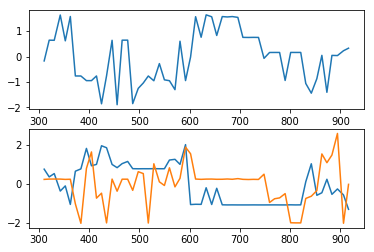

subject 25; gesture 1_1_2; avg 1.2017775981759413; sd 0.015422228707150019
subject 25; gesture 1_1_2; PoV: 0.9833075689188616


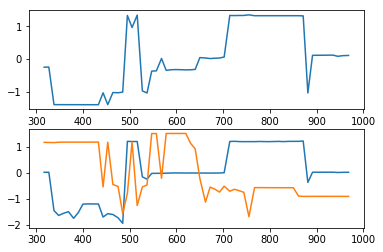

subject 25; gesture 2_1_2; avg 4.259105595650216; sd 0.023358344631035696
subject 25; gesture 2_1_2; PoV: 0.993509598063716


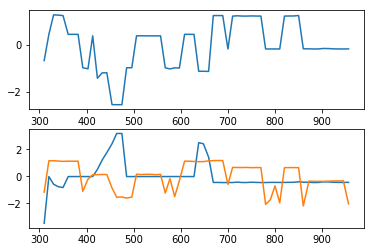

subject 25; gesture 4_0_1; avg 1.4444917431997002; sd 0.02054090885087007
subject 25; gesture 4_0_1; PoV: 0.9779034624377281


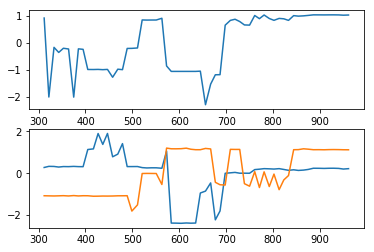

subject 25; gesture 3_0_2; avg 1.4351014612320596; sd 0.014419203534486204
subject 25; gesture 3_0_2; PoV: 0.9857048804741946


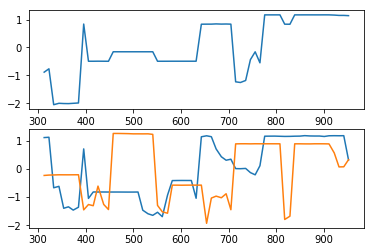

subject 25; gesture 1_1_1; avg 1.5896800506279976; sd 0.013997595557235716
subject 25; gesture 1_1_1; PoV: 0.984152958423425


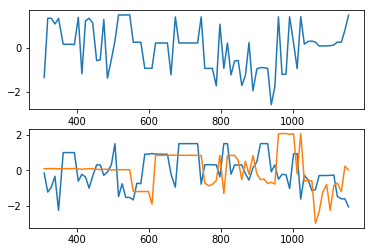

subject 25; gesture 3_1_2; avg 2.373139543426208; sd 0.020038543872006327
subject 25; gesture 3_1_2; PoV: 0.9875978504494539


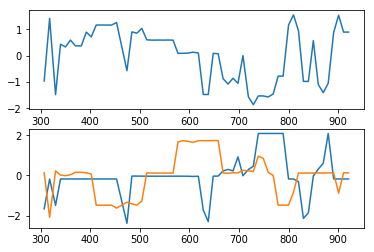

subject 25; gesture 2_1_1; avg 1.6958992453620008; sd 0.012825619248197829
subject 25; gesture 2_1_1; PoV: 0.9890243314464747


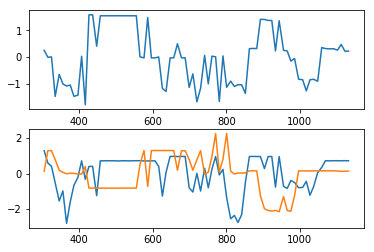

subject 25; gesture 1_0_1; avg 0.9664997458691853; sd 0.0074196628878389894
subject 25; gesture 1_0_1; PoV: 0.9898417400332781


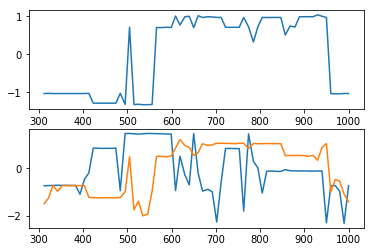

subject 25; gesture 3_1_1; avg 2.0665154323901085; sd 0.023399012327276647
subject 25; gesture 3_1_1; PoV: 0.987078187084818


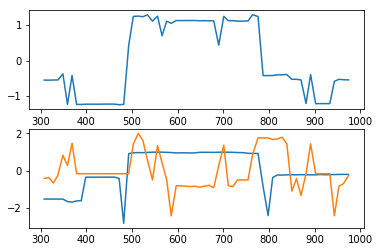

subject 25; gesture 1_0_2; avg 2.649484791600975; sd 0.03524963880598149
subject 25; gesture 1_0_2; PoV: 0.9806409002066963


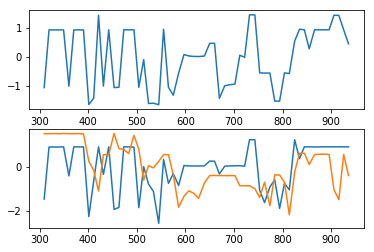

subject 25; gesture 4_0_2; avg 1.2409141899545644; sd 0.014824330234902351
subject 25; gesture 4_0_2; PoV: 0.9844472104391386


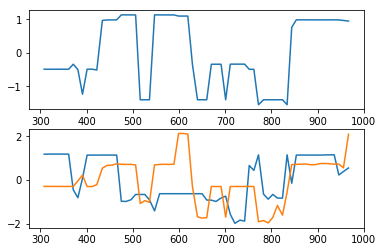

subject 18; gesture 3_0_1; avg 0.9945577782524253; sd 0.009107963815549599
subject 18; gesture 3_0_1; PoV: 0.9884970874614207


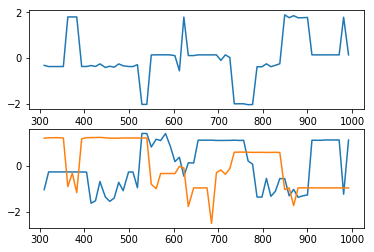

subject 18; gesture 4_1_1; avg 1.1428291176530947; sd 0.01318450834517418
subject 18; gesture 4_1_1; PoV: 0.9831036016527338


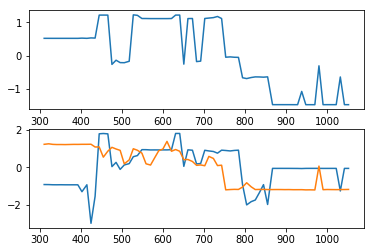

subject 18; gesture 2_0_1; avg 1.9284306744976023; sd 0.02771227914739533
subject 18; gesture 2_0_1; PoV: 0.9770083527546168


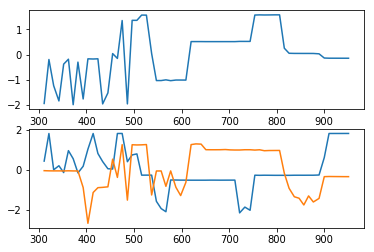

subject 18; gesture 4_1_2; avg 1.2348791559617422; sd 0.01096956495017573
subject 18; gesture 4_1_2; PoV: 0.9856037002213079


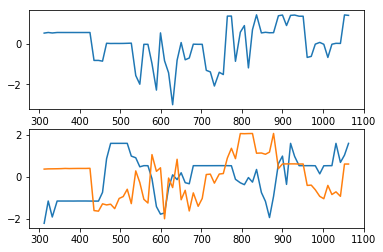

subject 18; gesture 2_0_2; avg 1.6438721787308284; sd 0.011805771068450393
subject 18; gesture 2_0_2; PoV: 0.9917199501436007


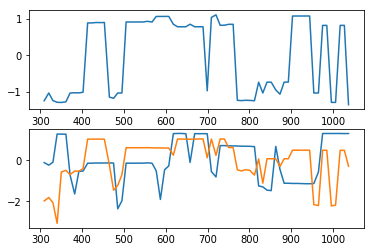

subject 18; gesture 1_1_2; avg 1.8170364609936633; sd 0.012344208763165243
subject 18; gesture 1_1_2; PoV: 0.9923724875395167


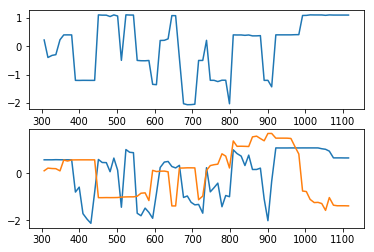

subject 18; gesture 2_1_2; avg 1.17765070335899; sd 0.03250596501183265
subject 18; gesture 2_1_2; PoV: 0.9690847166218215


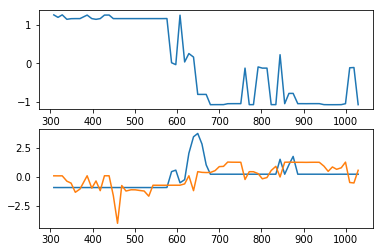

subject 18; gesture 4_0_1; avg 1.1138776829640773; sd 0.016528492376199157
subject 18; gesture 4_0_1; PoV: 0.9806497986033166


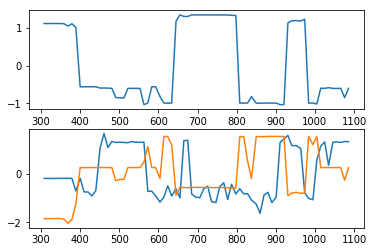

subject 18; gesture 3_0_2; avg 1.685418519366197; sd 0.017767542622953197
subject 18; gesture 3_0_2; PoV: 0.979884221623334


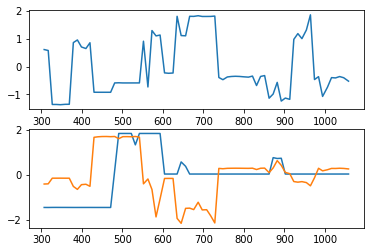

subject 18; gesture 1_1_1; avg 1.3467161210613225; sd 0.023738067650972926
subject 18; gesture 1_1_1; PoV: 0.9751254455745295


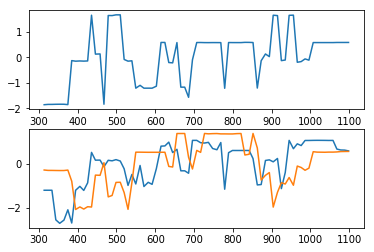

subject 18; gesture 3_1_2; avg 0.6759581140868752; sd 0.005447566209168494
subject 18; gesture 3_1_2; PoV: 0.9876013229490777


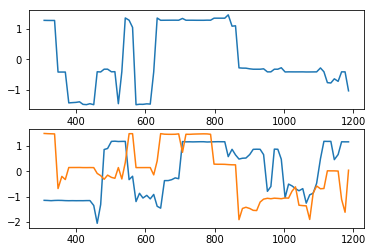

subject 18; gesture 2_1_1; avg 0.9694261824051105; sd 0.008061602593769004
subject 18; gesture 2_1_1; PoV: 0.9889014229091916


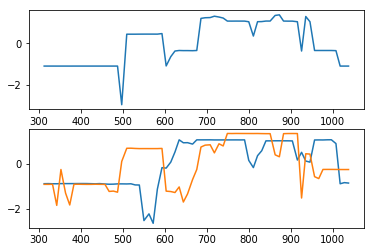

subject 18; gesture 1_0_1; avg 3.1699604860615; sd 0.02301518263280496
subject 18; gesture 1_0_1; PoV: 0.9916149983120223


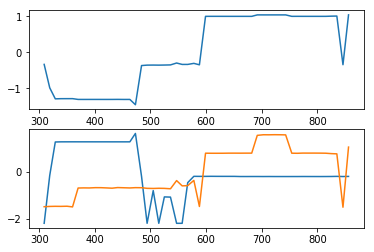

subject 18; gesture 3_1_1; avg 1.121237211167333; sd 0.02623772404120512
subject 18; gesture 3_1_1; PoV: 0.9670156652574525


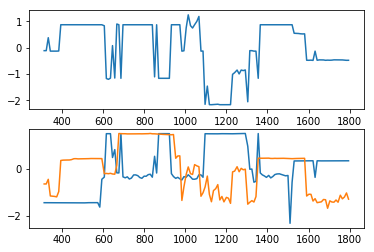

subject 18; gesture 1_0_2; avg 1.3852490602827414; sd 0.01624187005435838
subject 18; gesture 1_0_2; PoV: 0.9847694850188284


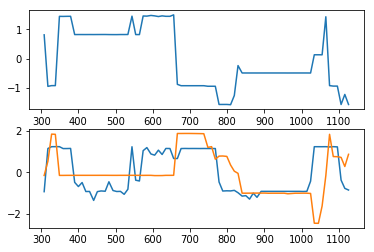

subject 18; gesture 4_0_2; avg 1.0295453151058582; sd 0.007134864590458072
subject 18; gesture 4_0_2; PoV: 0.9903562848374959


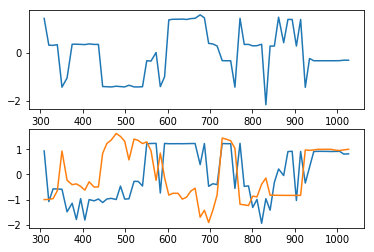

subject 29; gesture 3_0_1; avg 1.4623580189756078; sd 0.01597271337866506
subject 29; gesture 3_0_1; PoV: 0.9858568949451059


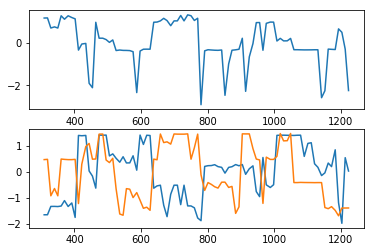

subject 29; gesture 4_1_1; avg 2.7194958418334516; sd 0.0703462656324172
subject 29; gesture 4_1_1; PoV: 0.9715264100207205


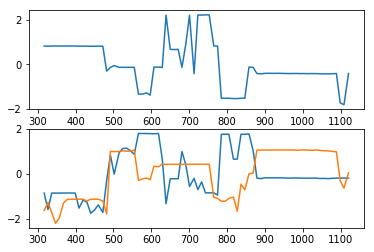

subject 29; gesture 2_0_1; avg 1.5577633580291725; sd 0.01969459600951957
subject 29; gesture 2_0_1; PoV: 0.9826371946642861


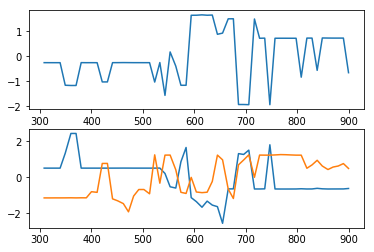

subject 29; gesture 4_1_2; avg 1.02076724525348; sd 0.00820265514736848
subject 29; gesture 4_1_2; PoV: 0.9891271656858093


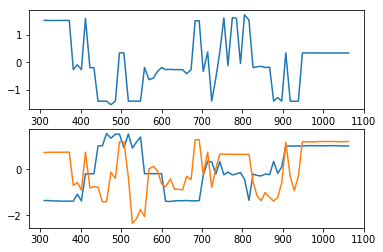

subject 29; gesture 2_0_2; avg 1.208883539970142; sd 0.011379730653617049
subject 29; gesture 2_0_2; PoV: 0.9839209823861838


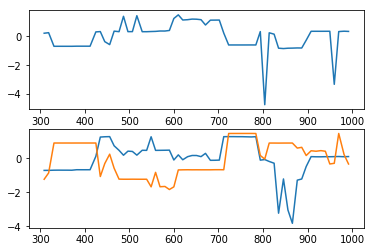

subject 29; gesture 1_1_2; avg 1.245924203741389; sd 0.0076881150881954454
subject 29; gesture 1_1_2; PoV: 0.9917847099288292


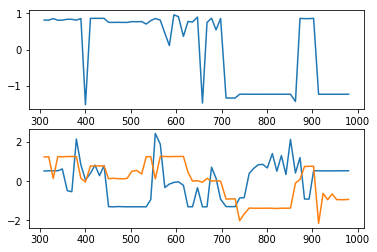

subject 29; gesture 2_1_2; avg 2.469646598262801; sd 0.014990881226695606
subject 29; gesture 2_1_2; PoV: 0.991385550179645


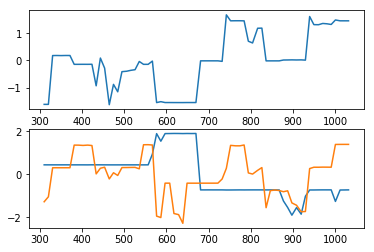

subject 29; gesture 4_0_1; avg 1.695238455527124; sd 0.03253412482522912
subject 29; gesture 4_0_1; PoV: 0.9761772243123539


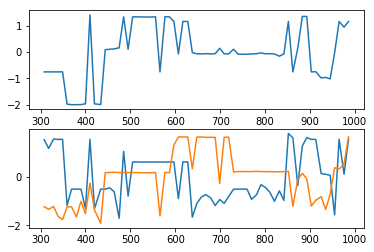

subject 29; gesture 3_0_2; avg 1.0221748132777717; sd 0.016469468114380336
subject 29; gesture 3_0_2; PoV: 0.9772226015961942


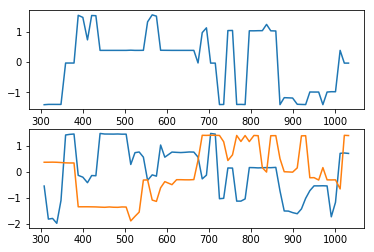

subject 29; gesture 1_1_1; avg 1.1985451839885597; sd 0.009051179784314573
subject 29; gesture 1_1_1; PoV: 0.9890238184051883


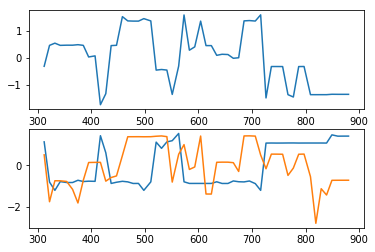

subject 29; gesture 3_1_2; avg 0.9098661047748244; sd 0.012735558204893933
subject 29; gesture 3_1_2; PoV: 0.9823499702900933


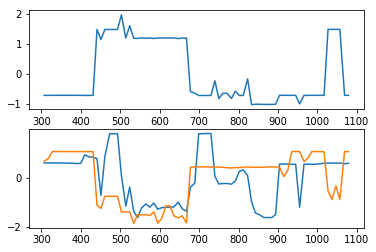

subject 29; gesture 2_1_1; avg 0.9244703630999356; sd 0.04929517312553908
subject 29; gesture 2_1_1; PoV: 0.9410502908588195


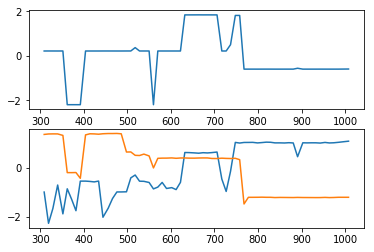

subject 29; gesture 1_0_1; avg 1.0621634095274446; sd 0.008713166352204508
subject 29; gesture 1_0_1; PoV: 0.9878335305487114


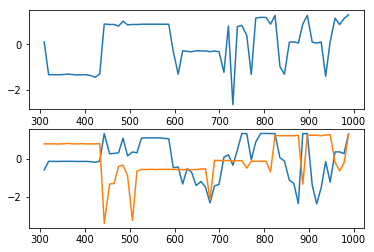

subject 29; gesture 3_1_1; avg 1.4218511920059589; sd 0.019646484659499384
subject 29; gesture 3_1_1; PoV: 0.9862018962445465


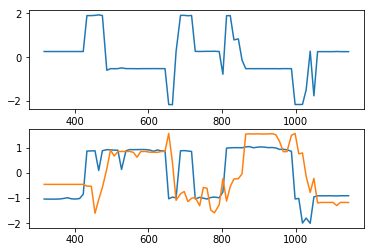

subject 29; gesture 1_0_2; avg 1.558316935850369; sd 0.013988644822699162
subject 29; gesture 1_0_2; PoV: 0.985799092369755


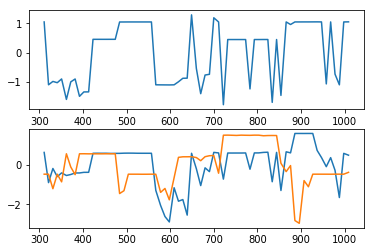

subject 29; gesture 4_0_2; avg 1.2322132900463025; sd 0.012904425098817153
subject 29; gesture 4_0_2; PoV: 0.9883403497211503


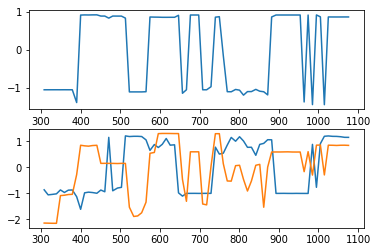

subject 15; gesture 3_0_1; avg 3.1852973109261202; sd 0.0349892798660411
subject 15; gesture 3_0_1; PoV: 0.9843529281898712


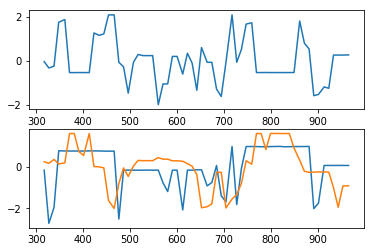

subject 15; gesture 4_1_1; avg 1.6513492605053137; sd 0.017229492258550756
subject 15; gesture 4_1_1; PoV: 0.9807345415576689


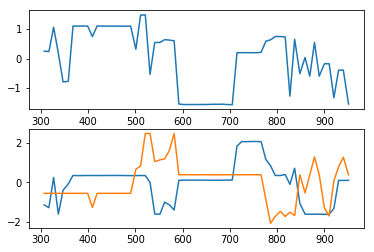

subject 15; gesture 2_0_1; avg 1.0184495112991856; sd 0.0071260831788150765
subject 15; gesture 2_0_1; PoV: 0.9908828120006803


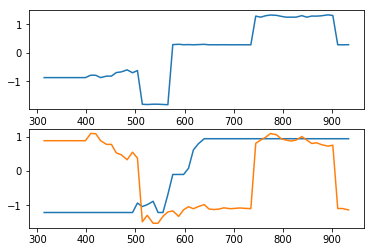

subject 15; gesture 4_1_2; avg 0.9376849830523962; sd 0.006777361201504246
subject 15; gesture 4_1_2; PoV: 0.9901222332436738


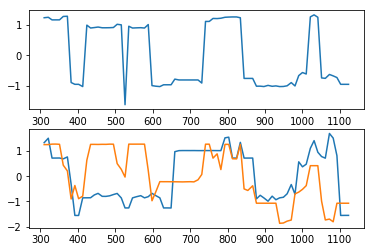

subject 15; gesture 2_0_2; avg 1.0826200258888279; sd 0.01189092103222012
subject 15; gesture 2_0_2; PoV: 0.9850262679440617


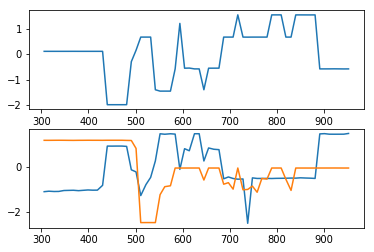

subject 15; gesture 1_1_2; avg 0.9943362409375974; sd 0.008563910257144288
subject 15; gesture 1_1_2; PoV: 0.9865659165251471


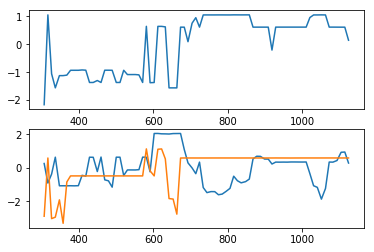

subject 15; gesture 2_1_2; avg 1.9883243942297535; sd 0.032785715170056344
subject 15; gesture 2_1_2; PoV: 0.985062575921761


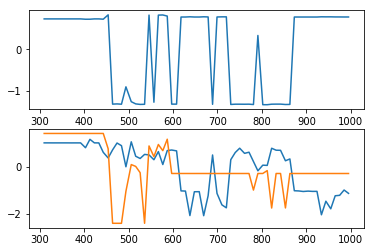

subject 15; gesture 4_0_1; avg 1.439194280502239; sd 0.0299915194939248
subject 15; gesture 4_0_1; PoV: 0.9642168983520634


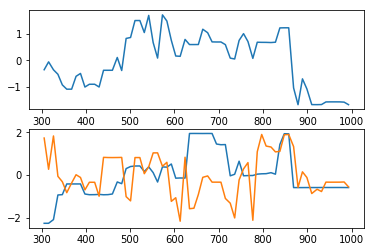

subject 15; gesture 3_0_2; avg 1.5941349789320898; sd 0.014336798856333773
subject 15; gesture 3_0_2; PoV: 0.9860552117925614


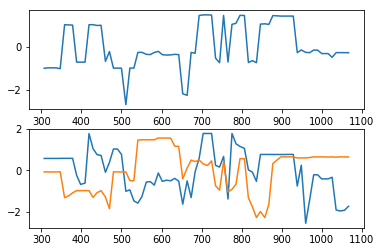

subject 15; gesture 1_1_1; avg 1.712048490283714; sd 0.02560959514116686
subject 15; gesture 1_1_1; PoV: 0.9833137490763704


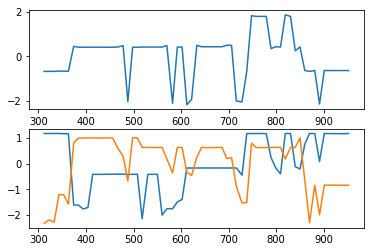

subject 15; gesture 3_1_2; avg 2.012670415236606; sd 0.011322141417562655
subject 15; gesture 3_1_2; PoV: 0.9925182182388735


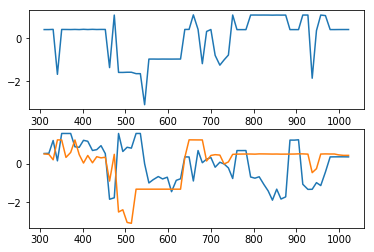

subject 15; gesture 2_1_1; avg 1.0925829216537013; sd 0.009504650220940427
subject 15; gesture 2_1_1; PoV: 0.9820739751861992


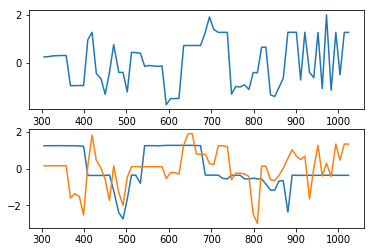

subject 15; gesture 1_0_1; avg 1.8692891256384734; sd 0.03926799429696239
subject 15; gesture 1_0_1; PoV: 0.9711595997188326


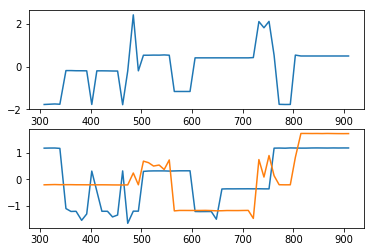

subject 15; gesture 3_1_1; avg 1.8668533730927988; sd 0.012693695941319768
subject 15; gesture 3_1_1; PoV: 0.9916454089831814


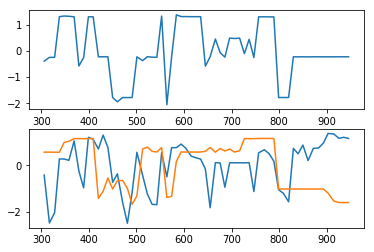

subject 15; gesture 1_0_2; avg 1.675865873096811; sd 0.017882601002937752
subject 15; gesture 1_0_2; PoV: 0.9806176420361554


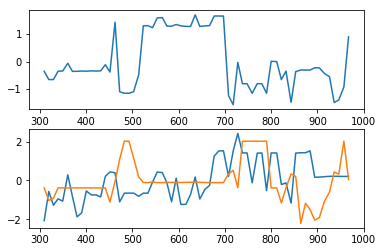

subject 15; gesture 4_0_2; avg 1.705493678457872; sd 0.018936939127168085
subject 15; gesture 4_0_2; PoV: 0.9837613621824873


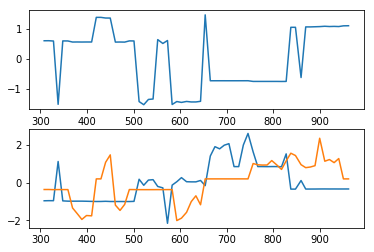

subject 28; gesture 3_0_1; avg 2.5795423411752663; sd 0.012426696302142758
subject 28; gesture 3_0_1; PoV: 0.9948792311380042


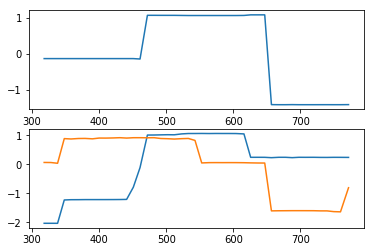

subject 28; gesture 4_1_1; avg 2.3563474671996385; sd 0.02935426870393695
subject 28; gesture 4_1_1; PoV: 0.9842757157175905


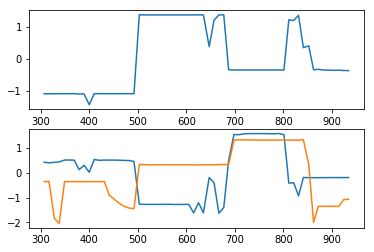

subject 28; gesture 2_0_1; avg 1.5721764646075695; sd 1.206110014219304
subject 28; gesture 2_0_1; PoV: 0.6943405358630037


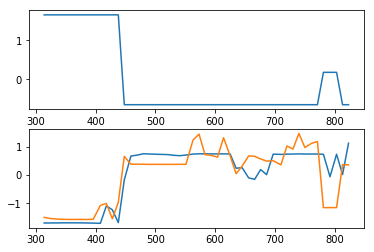

subject 28; gesture 4_1_2; avg 1.5826401726090882; sd 0.02029506279239958
subject 28; gesture 4_1_2; PoV: 0.9768096590538174


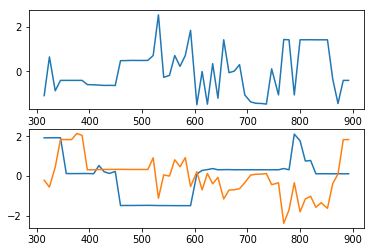

subject 28; gesture 2_0_2; avg 1.764714402297279; sd 0.01499668422446046
subject 28; gesture 2_0_2; PoV: 0.9833561563056364


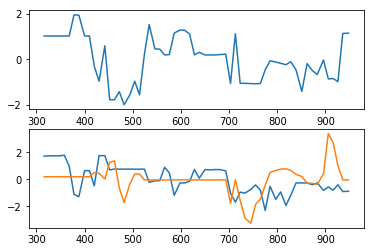

subject 28; gesture 1_1_2; avg 2.156690521970797; sd 0.014459647766497795
subject 28; gesture 1_1_2; PoV: 0.9907824490193559


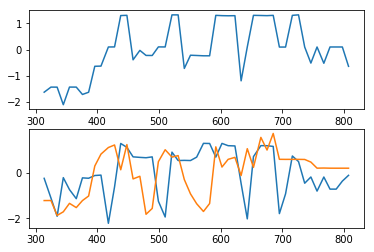

subject 28; gesture 2_1_2; avg 0.913036194078649; sd 0.010317969153271713
subject 28; gesture 2_1_2; PoV: 0.9851390563733182


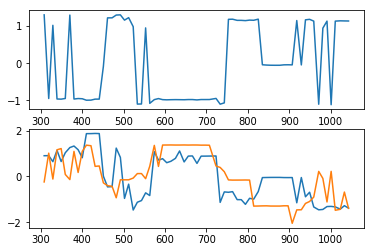

subject 28; gesture 4_0_1; avg 1.4593692401640925; sd 0.016881451987998654
subject 28; gesture 4_0_1; PoV: 0.9847032649657353


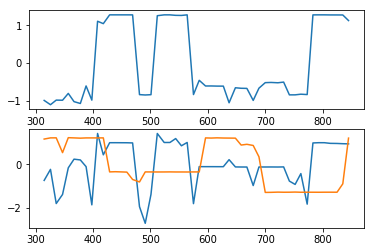

subject 28; gesture 3_0_2; avg 1.3722061124606393; sd 0.012276533508042725
subject 28; gesture 3_0_2; PoV: 0.9883704005590666


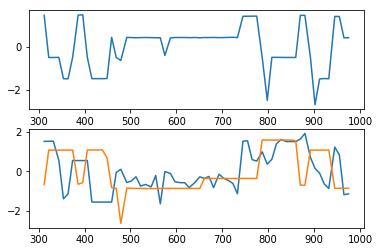

subject 28; gesture 1_1_1; avg 2.341593668956258; sd 0.03748429588086235
subject 28; gesture 1_1_1; PoV: 0.9825099002517853


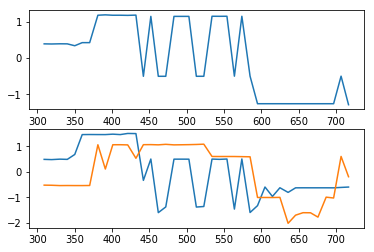

subject 28; gesture 3_1_2; avg 1.8340738432287322; sd 0.026807196834883792
subject 28; gesture 3_1_2; PoV: 0.9794433487552996


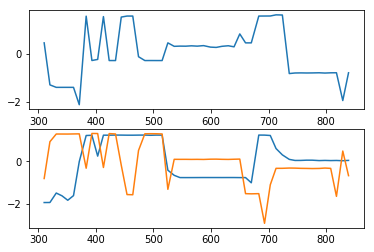

subject 28; gesture 2_1_1; avg 2.6720979605686757; sd 0.038845439245493364
subject 28; gesture 2_1_1; PoV: 0.9831136562085597


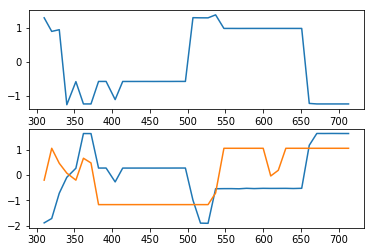

subject 28; gesture 1_0_1; avg 1.6417011349492157; sd 0.011222439463089795
subject 28; gesture 1_0_1; PoV: 0.9903773168520981


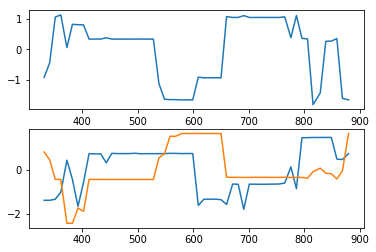

subject 28; gesture 3_1_1; avg 2.167078808258654; sd 0.01612616435261073
subject 28; gesture 3_1_1; PoV: 0.9915533911639647


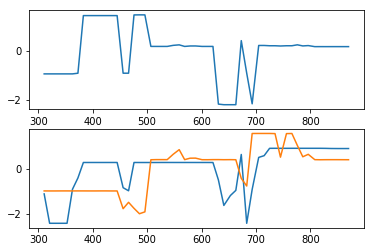

subject 28; gesture 1_0_2; avg 1.6342856038374616; sd 0.013848805606534662
subject 28; gesture 1_0_2; PoV: 0.9891440641253705


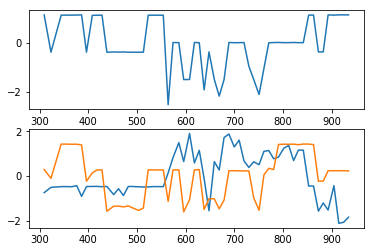

subject 28; gesture 4_0_2; avg 1.1838572055178258; sd 0.01061301466907347
subject 28; gesture 4_0_2; PoV: 0.9895125898641779


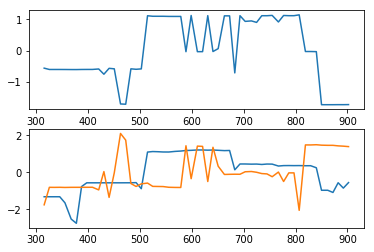

subject 12; gesture 3_0_1; avg 1.0496869866155643; sd 0.012932143993470658
subject 12; gesture 3_0_1; PoV: 0.9792591662896962


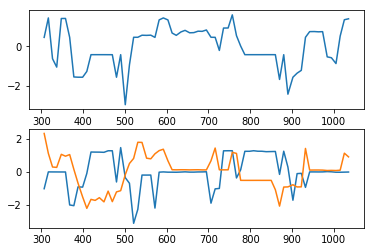

subject 12; gesture 4_1_1; avg 1.7935142362744623; sd 0.011303860256025066
subject 12; gesture 4_1_1; PoV: 0.9917353126056021


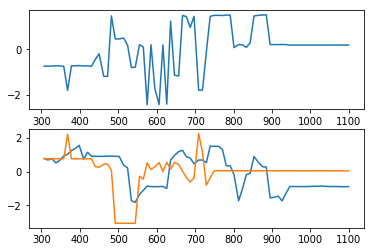

subject 12; gesture 2_0_1; avg 3.363613101834744; sd 0.015012938411613148
subject 12; gesture 2_0_1; PoV: 0.996045399416337


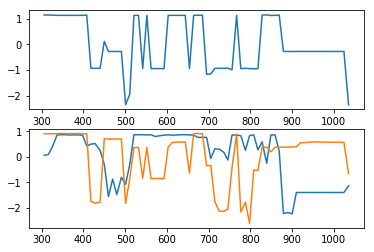

subject 12; gesture 4_1_2; avg 1.2750320539029016; sd 0.012950797180528535
subject 12; gesture 4_1_2; PoV: 0.9875940476762751


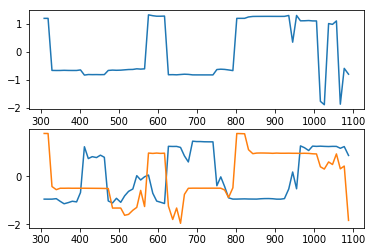

subject 12; gesture 2_0_2; avg 2.063257498312042; sd 0.026875124283382193
subject 12; gesture 2_0_2; PoV: 0.9736861030419873


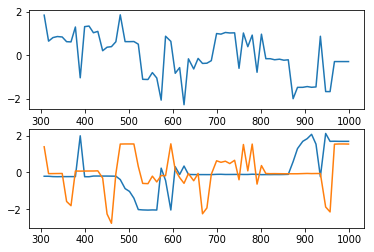

subject 12; gesture 1_1_2; avg 0.9655848476952206; sd 0.007770573751146734
subject 12; gesture 1_1_2; PoV: 0.9887610843254768


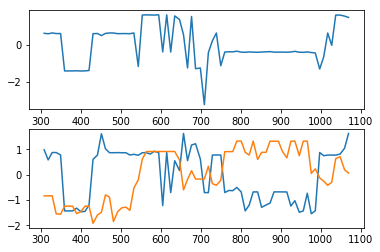

subject 12; gesture 2_1_2; avg 1.2556523587845672; sd 0.01887029664514198
subject 12; gesture 2_1_2; PoV: 0.9784721703715287


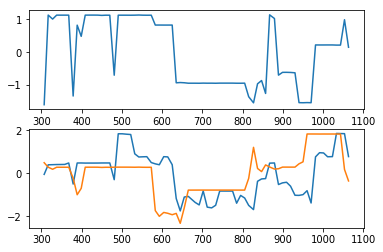

subject 12; gesture 4_0_1; avg 1.4573373782820405; sd 0.013675660091408819
subject 12; gesture 4_0_1; PoV: 0.9808860829379276


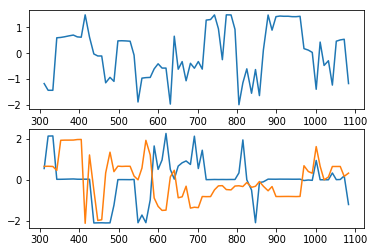

subject 12; gesture 3_0_2; avg 1.0983381845310574; sd 0.01154437461498614
subject 12; gesture 3_0_2; PoV: 0.9794474740469493


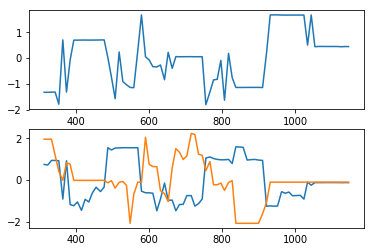

subject 12; gesture 1_1_1; avg 3.53949105592019; sd 0.041958885501068306
subject 12; gesture 1_1_1; PoV: 0.989200169678277


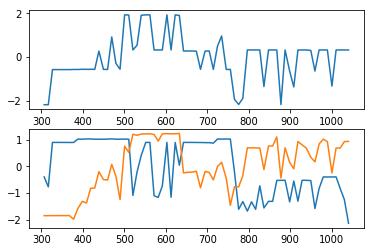

subject 12; gesture 3_1_2; avg 2.1948127396651977; sd 0.03029307970904523
subject 12; gesture 3_1_2; PoV: 0.9824678774461841


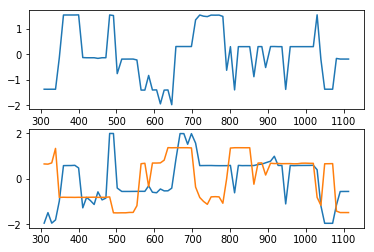

subject 12; gesture 2_1_1; avg 1.1297136955958234; sd 0.01525659849817474
subject 12; gesture 2_1_1; PoV: 0.976389550647848


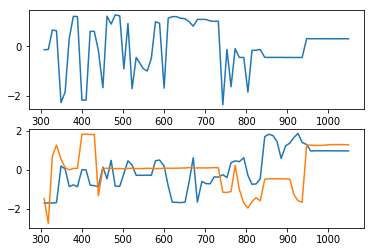

subject 12; gesture 1_0_1; avg 1.2829392982203138; sd 0.010704870584114658
subject 12; gesture 1_0_1; PoV: 0.987160028543147


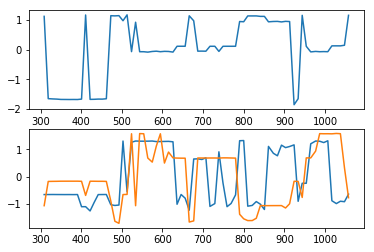

subject 12; gesture 3_1_1; avg 1.572153463488633; sd 0.017151641268810424
subject 12; gesture 3_1_1; PoV: 0.9782337682847675


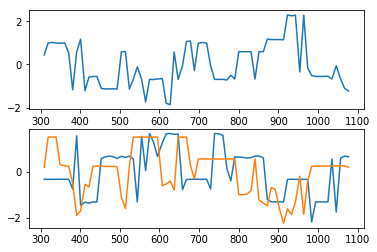

subject 12; gesture 1_0_2; avg 1.5265231067312288; sd 0.015366414749601385
subject 12; gesture 1_0_2; PoV: 0.9826619466322942


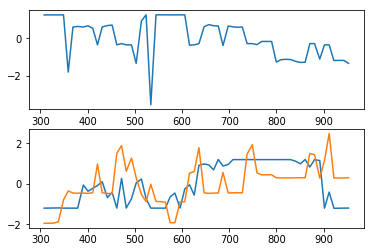

subject 12; gesture 4_0_2; avg 1.1013884523820092; sd 0.017759238511523
subject 12; gesture 4_0_2; PoV: 0.9767328810809689


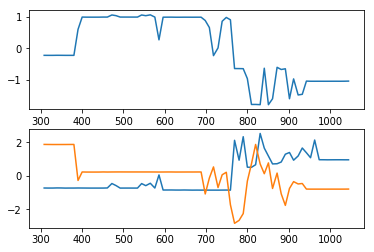

subject 19; gesture 3_0_1; avg 1.0084374924956747; sd 0.011622045944233547
subject 19; gesture 3_0_1; PoV: 0.9843120441502419


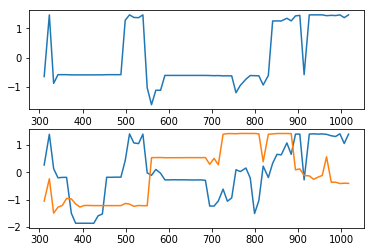

subject 19; gesture 4_1_1; avg 1.1134520474582428; sd 0.015668179682971406
subject 19; gesture 4_1_1; PoV: 0.9722876478041842


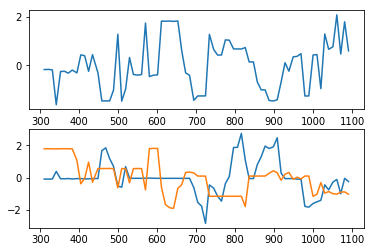

subject 19; gesture 2_0_1; avg 1.6193552782476968; sd 0.012720105965830975
subject 19; gesture 2_0_1; PoV: 0.990719231984536


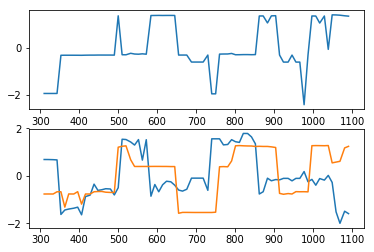

subject 19; gesture 4_1_2; avg 0.9139456990306312; sd 0.011997682535292334
subject 19; gesture 4_1_2; PoV: 0.9821692164802885


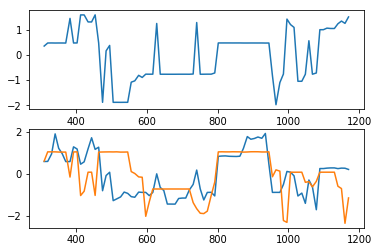

subject 19; gesture 2_0_2; avg 0.9567431413746; sd 0.007055980261173401
subject 19; gesture 2_0_2; PoV: 0.9879679751779296


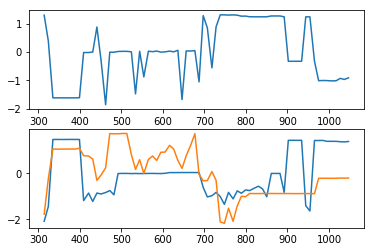

subject 19; gesture 1_1_2; avg 2.2040144029546886; sd 0.017766805410028636
subject 19; gesture 1_1_2; PoV: 0.9914198149948337


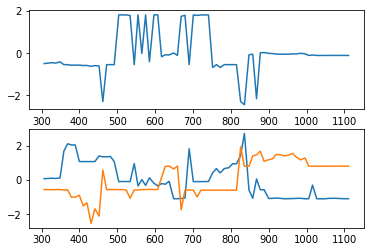

subject 19; gesture 2_1_2; avg 1.0354978610228032; sd 0.01125473223978447
subject 19; gesture 2_1_2; PoV: 0.9801149064061788


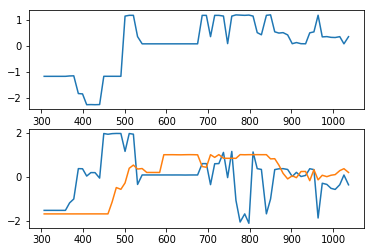

subject 19; gesture 4_0_1; avg 1.6346985730903407; sd 0.008712277378020982
subject 19; gesture 4_0_1; PoV: 0.9934466317624134


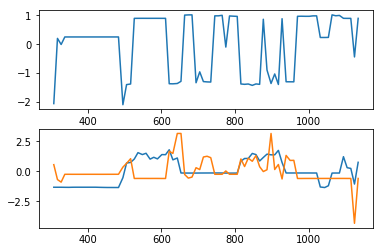

subject 19; gesture 3_0_2; avg 2.6698514661575543; sd 0.019550290968793137
subject 19; gesture 3_0_2; PoV: 0.9876526459768842


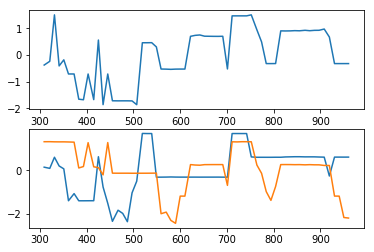

subject 19; gesture 1_1_1; avg 1.1530665751096116; sd 0.00904205593030413
subject 19; gesture 1_1_1; PoV: 0.9861810199434625


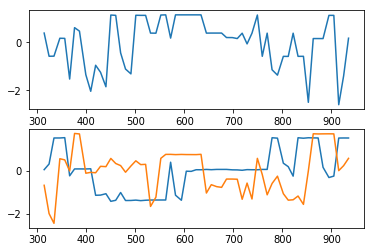

subject 19; gesture 3_1_2; avg 1.7241536449804171; sd 0.009593224680914603
subject 19; gesture 3_1_2; PoV: 0.9939295225424618


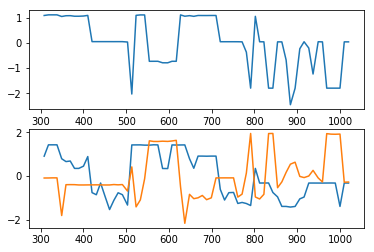

subject 19; gesture 2_1_1; avg 1.6565418464761736; sd 0.012643818695943757
subject 19; gesture 2_1_1; PoV: 0.9889461722825843


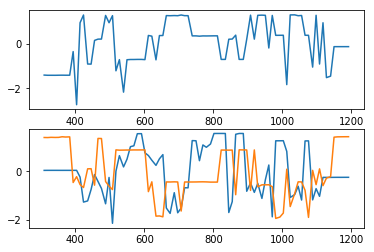

subject 19; gesture 1_0_1; avg 1.457535597018365; sd 0.025877836574787785
subject 19; gesture 1_0_1; PoV: 0.9773680173015996


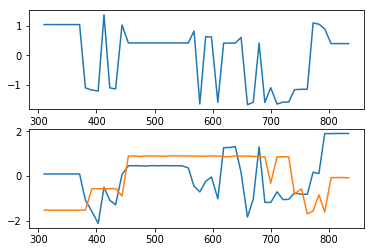

subject 19; gesture 3_1_1; avg 0.8192525075269455; sd 0.007688350388951518
subject 19; gesture 3_1_1; PoV: 0.9855780248544648


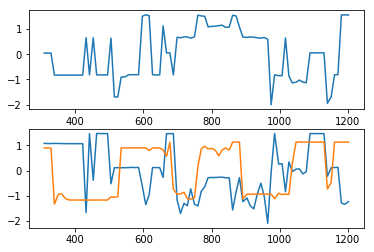

subject 19; gesture 1_0_2; avg 1.522179479327383; sd 0.019638614955157757
subject 19; gesture 1_0_2; PoV: 0.9784696287578998


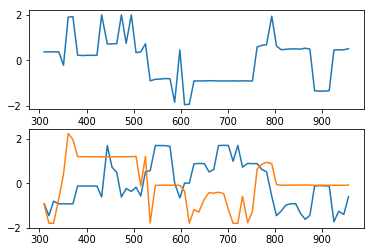

subject 19; gesture 4_0_2; avg 0.8442869801320477; sd 0.009501586215226177
subject 19; gesture 4_0_2; PoV: 0.9848943402018869


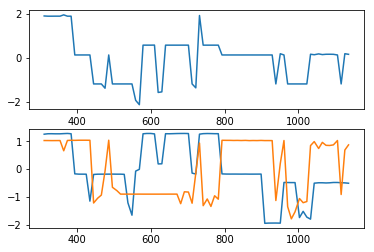

subject 07; gesture 3_0_1; avg 1.1307851661726565; sd 0.006542994330176369
subject 07; gesture 3_0_1; PoV: 0.9918082467848258


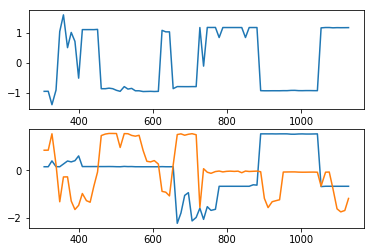

subject 07; gesture 4_1_1; avg 1.171272538129175; sd 0.010670337928199202
subject 07; gesture 4_1_1; PoV: 0.9865582149466952


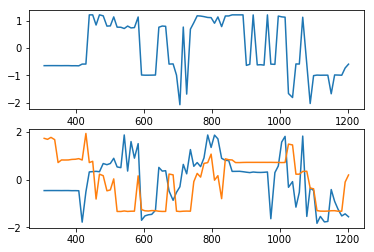

subject 07; gesture 2_0_1; avg 0.9384563766572261; sd 0.007033847820033327
subject 07; gesture 2_0_1; PoV: 0.9884543978551901


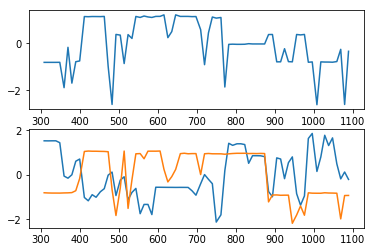

subject 07; gesture 4_1_2; avg 0.6326700238749035; sd 0.00403653090123128
subject 07; gesture 4_1_2; PoV: 0.990427464565158


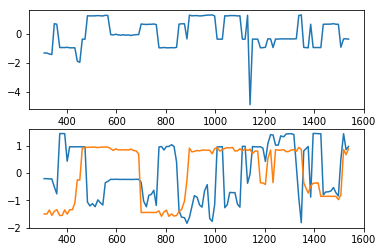

subject 07; gesture 2_0_2; avg 1.0890840749636816; sd 0.00881681371871542
subject 07; gesture 2_0_2; PoV: 0.9863545099980462


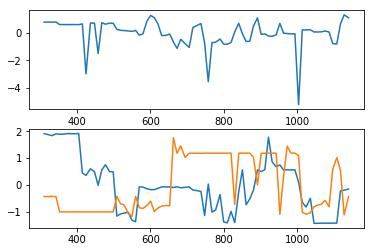

subject 07; gesture 1_1_2; avg 0.7415038791723153; sd 0.006673754512786405
subject 07; gesture 1_1_2; PoV: 0.9874048008023408


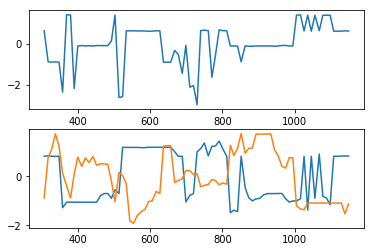

subject 07; gesture 2_1_2; avg 0.823669366214425; sd 0.00760701929732569
subject 07; gesture 2_1_2; PoV: 0.9847279415937509


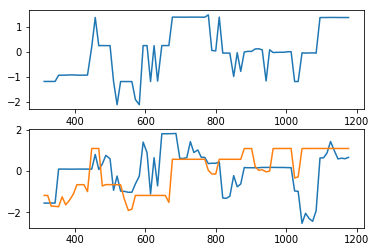

subject 07; gesture 4_0_1; avg 0.8749305209963247; sd 0.008933313759544323
subject 07; gesture 4_0_1; PoV: 0.983348106575611


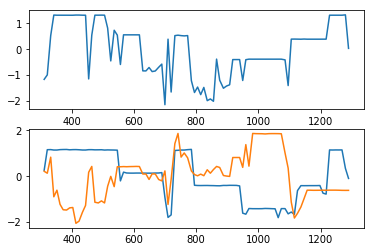

subject 07; gesture 3_0_2; avg 0.7229130178512886; sd 0.005289314132643281
subject 07; gesture 3_0_2; PoV: 0.9883049883124996


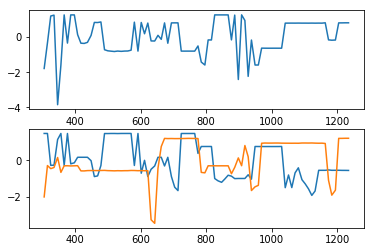

subject 07; gesture 1_1_1; avg 0.9377831674764112; sd 0.0070798736686648435
subject 07; gesture 1_1_1; PoV: 0.989644920155491


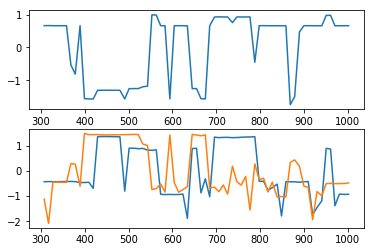

subject 07; gesture 3_1_2; avg 1.055688056980932; sd 0.02107355446020846
subject 07; gesture 3_1_2; PoV: 0.979214784218615


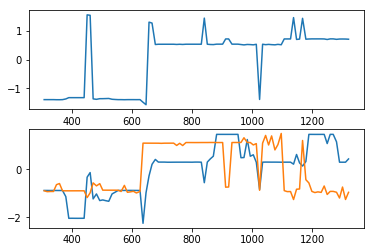

subject 07; gesture 2_1_1; avg 1.0956241953124177; sd 0.008915210975275359
subject 07; gesture 2_1_1; PoV: 0.988291470582886


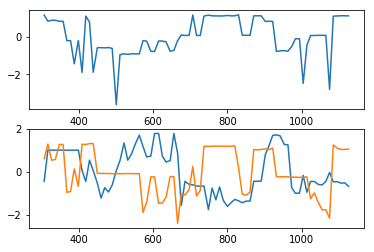

subject 07; gesture 1_0_1; avg 0.9499659532345507; sd 0.007511500829587456
subject 07; gesture 1_0_1; PoV: 0.9892813591252243


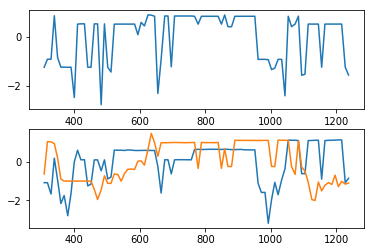

subject 07; gesture 3_1_1; avg 0.8603890145549676; sd 0.013957568903509696
subject 07; gesture 3_1_1; PoV: 0.9800954331811671


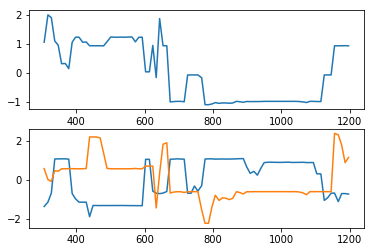

subject 07; gesture 1_0_2; avg 1.3886258611006048; sd 0.01137688750564307
subject 07; gesture 1_0_2; PoV: 0.9896547369521285


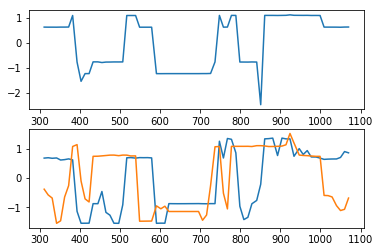

subject 07; gesture 4_0_2; avg 1.159514204519479; sd 0.010717609196315035
subject 07; gesture 4_0_2; PoV: 0.9869021601798538


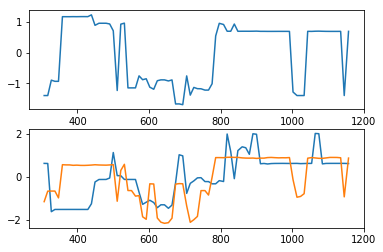

subject 20; gesture 3_0_1; avg 1.8246549594389194; sd 0.01253335140686923
subject 20; gesture 3_0_1; PoV: 0.9923530594638533


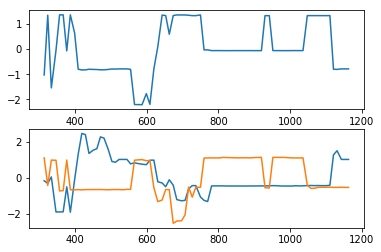

subject 20; gesture 4_1_1; avg 1.195373987497197; sd 0.011557920819724116
subject 20; gesture 4_1_1; PoV: 0.9771269640904228


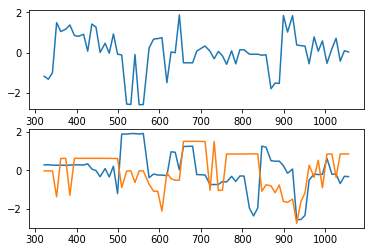

subject 20; gesture 2_0_1; avg 1.2050230784275378; sd 0.01615251428399674
subject 20; gesture 2_0_1; PoV: 0.9741803172194757


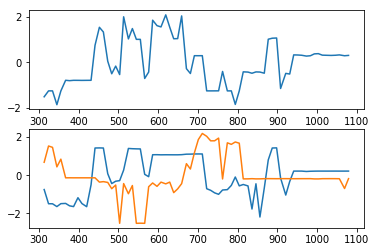

subject 20; gesture 4_1_2; avg 1.5834199554577235; sd 0.013684300993401196
subject 20; gesture 4_1_2; PoV: 0.9883512287363617


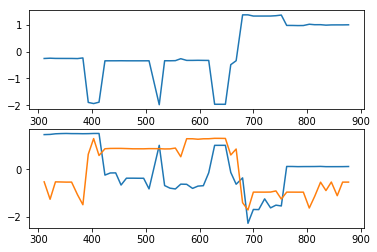

subject 20; gesture 2_0_2; avg 1.1894366785057295; sd 0.011161378120109602
subject 20; gesture 2_0_2; PoV: 0.9825604570868084


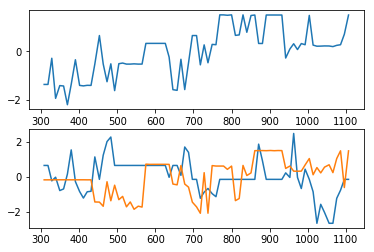

subject 20; gesture 1_1_2; avg 0.9890958794271311; sd 0.011935408540719238
subject 20; gesture 1_1_2; PoV: 0.9822275756000924


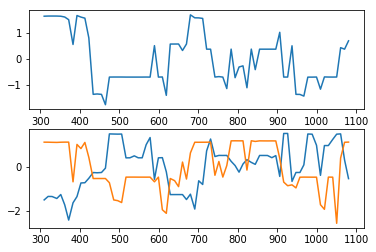

subject 20; gesture 2_1_2; avg 1.2870361209194614; sd 0.014160932393136347
subject 20; gesture 2_1_2; PoV: 0.9800570581780523


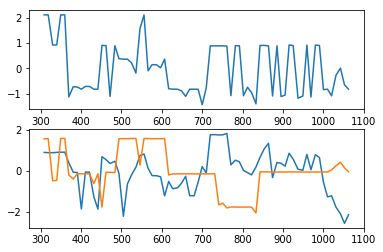

subject 20; gesture 4_0_1; avg 0.9008181635141731; sd 0.007644948504680073
subject 20; gesture 4_0_1; PoV: 0.9841155622678105


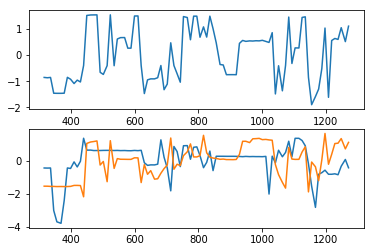

subject 20; gesture 3_0_2; avg 2.432432523816929; sd 0.021454139190660457
subject 20; gesture 3_0_2; PoV: 0.9919458451514187


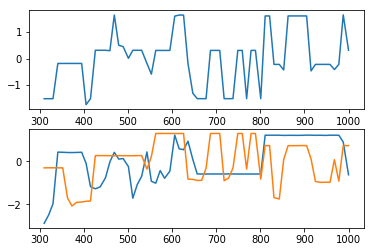

subject 20; gesture 1_1_1; avg 1.369716590971866; sd 0.017550530894824095
subject 20; gesture 1_1_1; PoV: 0.976394152437802


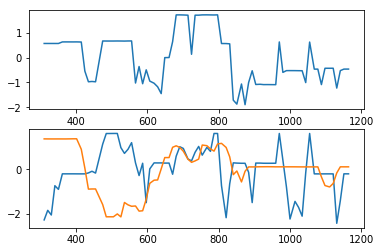

subject 20; gesture 3_1_2; avg 1.3886535484106795; sd 0.009188535659690548
subject 20; gesture 3_1_2; PoV: 0.9918463353153361


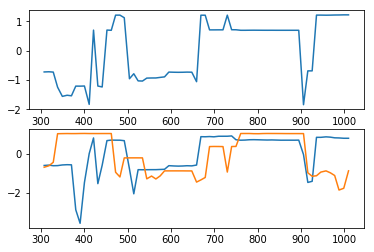

subject 20; gesture 2_1_1; avg 1.4089969389024595; sd 0.012673200548350033
subject 20; gesture 2_1_1; PoV: 0.9892574184376404


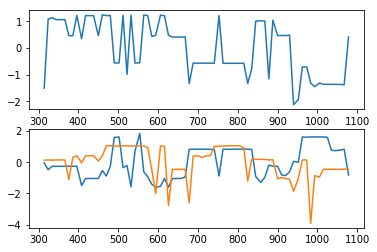

subject 20; gesture 1_0_1; avg 0.9393785802669341; sd 0.010982538201457325
subject 20; gesture 1_0_1; PoV: 0.9790006029333713


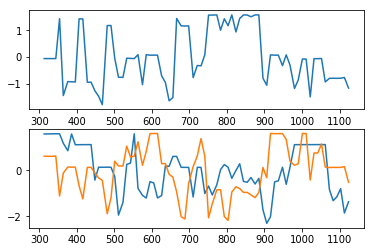

subject 20; gesture 3_1_1; avg 1.449054527636899; sd 0.01495251450592047
subject 20; gesture 3_1_1; PoV: 0.9859357831254157


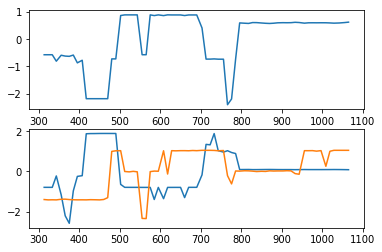

subject 20; gesture 1_0_2; avg 0.8722516043022955; sd 0.008433126634764816
subject 20; gesture 1_0_2; PoV: 0.9870206897884475


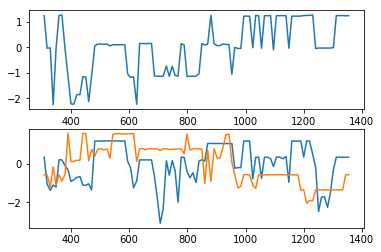

subject 20; gesture 4_0_2; avg 1.4292378259267018; sd 0.013443605337663382
subject 20; gesture 4_0_2; PoV: 0.9842557783301942


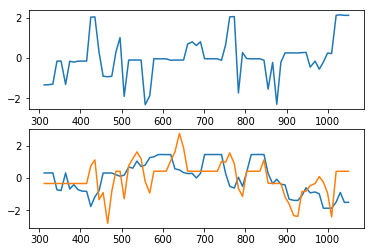

subject 31; gesture 3_0_1; avg 1.5582220887117355; sd 0.013332695878386558
subject 31; gesture 3_0_1; PoV: 0.9896787731065538


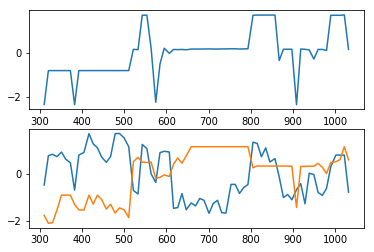

subject 31; gesture 4_1_1; avg 1.4187501935688616; sd 0.013870682042811926
subject 31; gesture 4_1_1; PoV: 0.9830874378271481


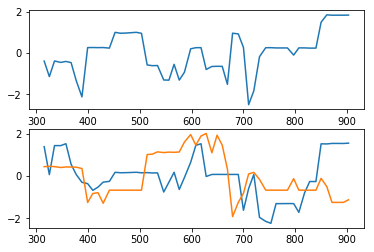

subject 31; gesture 2_0_1; avg 1.4355912151121828; sd 0.007573933108379897
subject 31; gesture 2_0_1; PoV: 0.9936162439231675


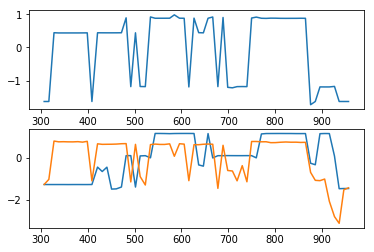

subject 31; gesture 4_1_2; avg 1.1557794564999742; sd 0.00827884898545868
subject 31; gesture 4_1_2; PoV: 0.9899288119704682


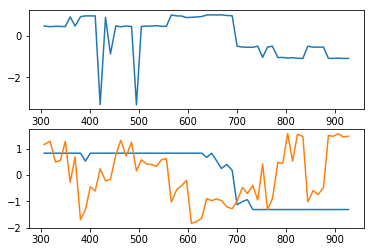

subject 31; gesture 2_0_2; avg 1.6038578665580665; sd 0.014503270324675382
subject 31; gesture 2_0_2; PoV: 0.9880423950630433


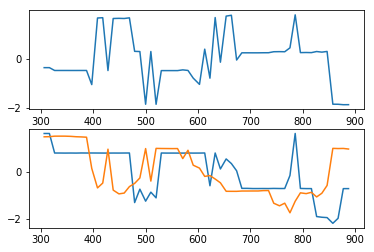

subject 31; gesture 1_1_2; avg 1.1209478627877887; sd 0.010540241829487493
subject 31; gesture 1_1_2; PoV: 0.9896660411205931


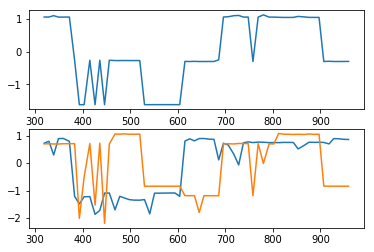

subject 31; gesture 2_1_2; avg 1.5920444301245973; sd 0.019449305888015897
subject 31; gesture 2_1_2; PoV: 0.9871395933988519


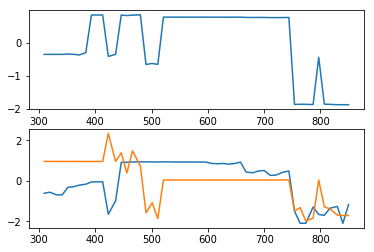

subject 31; gesture 4_0_1; avg 2.4198200604586697; sd 0.015555226649154
subject 31; gesture 4_0_1; PoV: 0.989598506644954


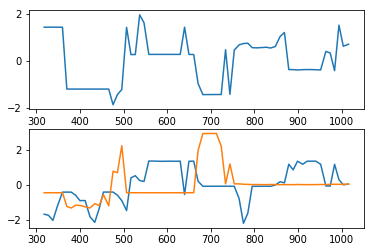

subject 31; gesture 3_0_2; avg 1.0469619681469744; sd 0.03183115477796001
subject 31; gesture 3_0_2; PoV: 0.9647733376913383


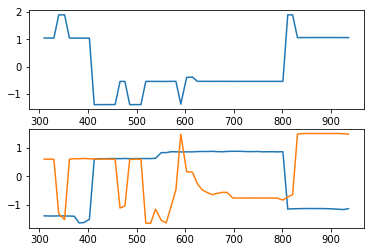

subject 31; gesture 1_1_1; avg 1.8598728676214304; sd 0.026391769077011188
subject 31; gesture 1_1_1; PoV: 0.9818512898446987


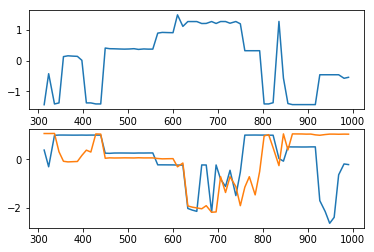

subject 31; gesture 3_1_2; avg 1.3486704817139035; sd 0.01801455882980873
subject 31; gesture 3_1_2; PoV: 0.9831119301443971


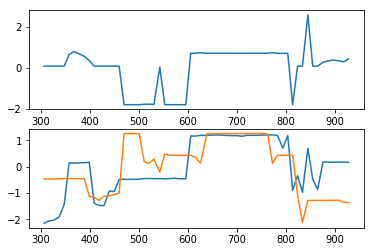

subject 31; gesture 2_1_1; avg 2.32089133746882; sd 0.03170733579272869
subject 31; gesture 2_1_1; PoV: 0.9778705188517038


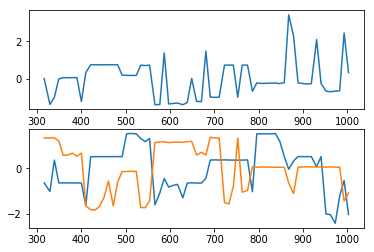

subject 31; gesture 1_0_1; avg 0.8338141997662647; sd 0.0073579585341228574
subject 31; gesture 1_0_1; PoV: 0.9874113089041969


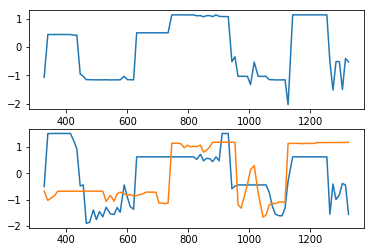

subject 31; gesture 3_1_1; avg 1.3047086064057856; sd 0.023400092969380833
subject 31; gesture 3_1_1; PoV: 0.981408459691325


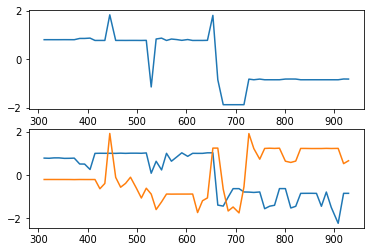

subject 31; gesture 1_0_2; avg 1.4083869690103945; sd 0.010036307241123232
subject 31; gesture 1_0_2; PoV: 0.9907130066998296


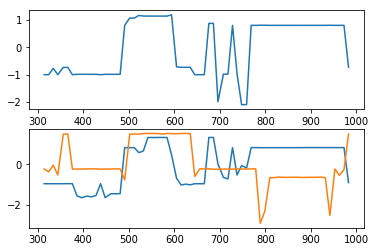

subject 31; gesture 4_0_2; avg 1.3760118286165837; sd 0.013205452771069617
subject 31; gesture 4_0_2; PoV: 0.9851757625630535


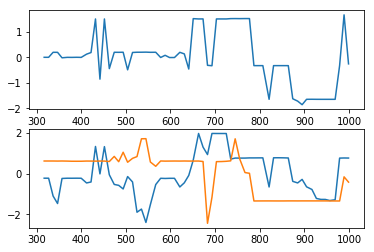

subject 13; gesture 3_0_1; avg 0.7644632619457342; sd 0.007298804698502472
subject 13; gesture 3_0_1; PoV: 0.981105603032948


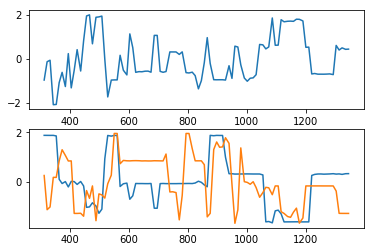

subject 13; gesture 4_1_1; avg 1.0330449065253504; sd 0.012371044522335095
subject 13; gesture 4_1_1; PoV: 0.9868340323033349


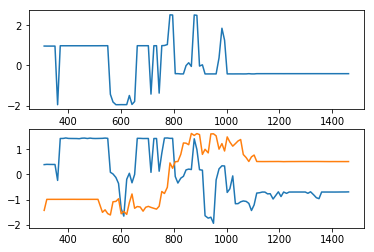

subject 13; gesture 2_0_1; avg 1.5319667846093792; sd 0.017546440240097015
subject 13; gesture 2_0_1; PoV: 0.9849766898212744


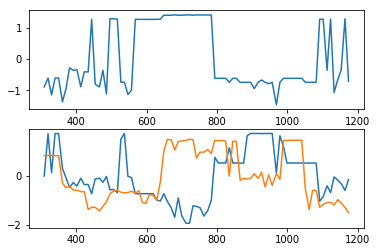

subject 13; gesture 4_1_2; avg 0.8483183953422233; sd 0.006081239371835321
subject 13; gesture 4_1_2; PoV: 0.9896276960442391


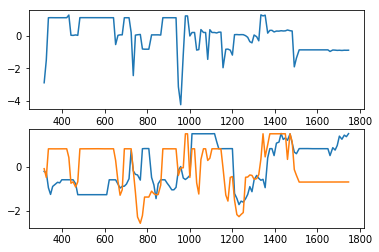

subject 13; gesture 2_0_2; avg 1.488736047125305; sd 0.010758666830783706
subject 13; gesture 2_0_2; PoV: 0.9892311379298114


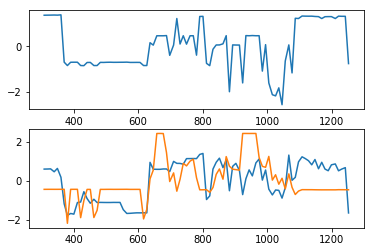

subject 13; gesture 1_1_2; avg 0.641854336880993; sd 0.006640266293184351
subject 13; gesture 1_1_2; PoV: 0.9861376258920569


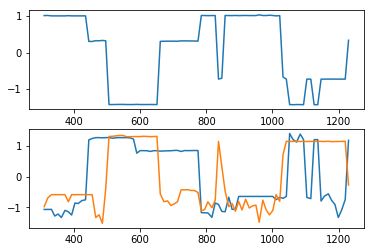

subject 13; gesture 2_1_2; avg 1.0156640608992118; sd 0.013168858799800308
subject 13; gesture 2_1_2; PoV: 0.9796065935975254


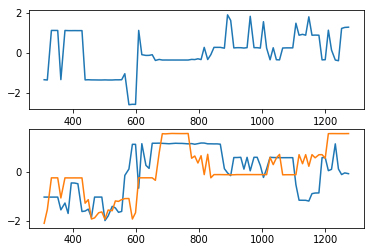

subject 13; gesture 4_0_1; avg 0.5782860219649473; sd 0.0041405682697523444
subject 13; gesture 4_0_1; PoV: 0.9887441432984685


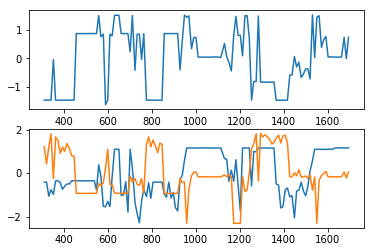

subject 13; gesture 3_0_2; avg 0.8029198713471883; sd 0.007763233498703841
subject 13; gesture 3_0_2; PoV: 0.9862053226195172


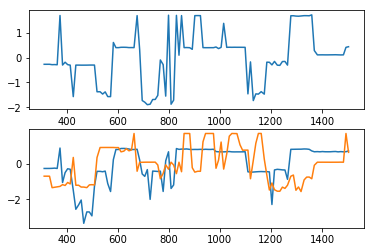

subject 13; gesture 1_1_1; avg 1.772437057458084; sd 0.025330708603297124
subject 13; gesture 1_1_1; PoV: 0.979101734241068


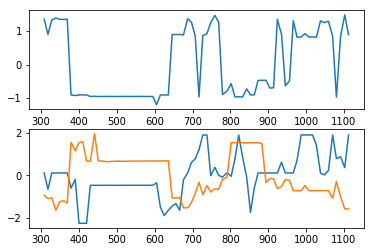

subject 13; gesture 3_1_2; avg 1.0440055213675552; sd 0.00980365372229753
subject 13; gesture 3_1_2; PoV: 0.985068047426325


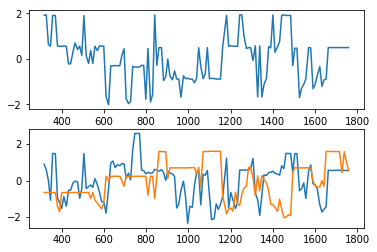

subject 13; gesture 2_1_1; avg 0.7082348391792634; sd 0.00720134821872355
subject 13; gesture 2_1_1; PoV: 0.9834656980559601


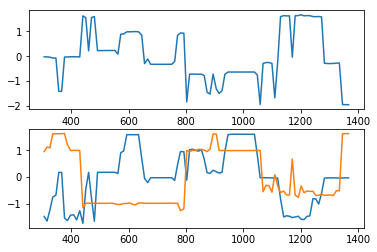

subject 13; gesture 1_0_1; avg 0.35016290972899344; sd 0.0027892350890948822
subject 13; gesture 1_0_1; PoV: 0.9893498100713366


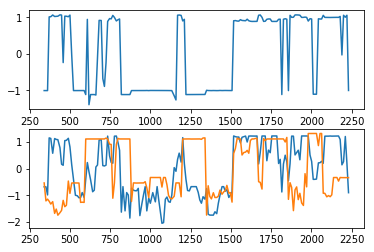

subject 13; gesture 3_1_1; avg 0.9121926155785353; sd 0.014855659611443419
subject 13; gesture 3_1_1; PoV: 0.9743034357451299


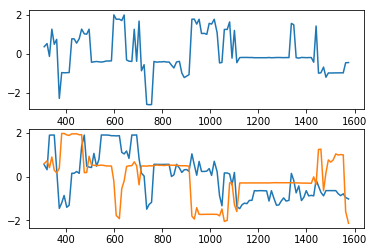

subject 13; gesture 1_0_2; avg 1.0107322306663442; sd 0.007101095823302199
subject 13; gesture 1_0_2; PoV: 0.9918406696181573


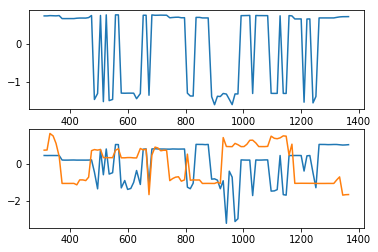

subject 13; gesture 4_0_2; avg 0.8420284737854203; sd 0.01185303515387424
subject 13; gesture 4_0_2; PoV: 0.9818619401433604


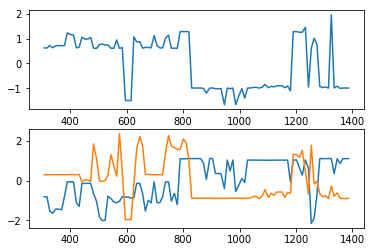

subject 36; gesture 3_0_1; avg 1.4179254684105953; sd 0.016682951876108857
subject 36; gesture 3_0_1; PoV: 0.9794923458814249


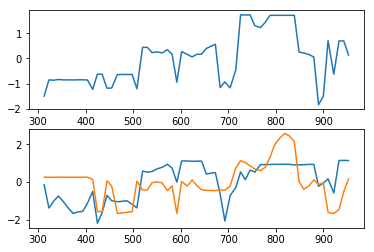

subject 36; gesture 4_1_1; avg 1.6360706219848378; sd 0.015855029918568082
subject 36; gesture 4_1_1; PoV: 0.9896069905667523


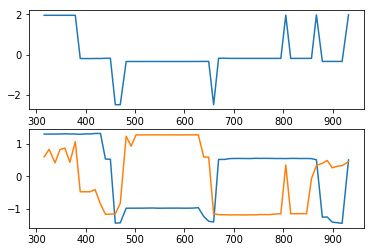

subject 36; gesture 2_0_1; avg 2.117046197483992; sd 0.018852619576414827
subject 36; gesture 2_0_1; PoV: 0.9907811602851962


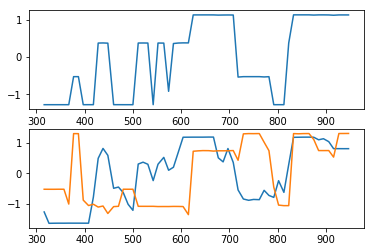

subject 36; gesture 4_1_2; avg 1.4366146405645737; sd 0.02017441318848024
subject 36; gesture 4_1_2; PoV: 0.9780070580348121


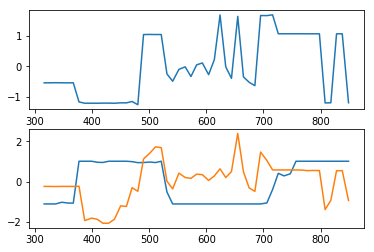

subject 36; gesture 2_0_2; avg 4.644016965292323; sd 0.03471864029552439
subject 36; gesture 2_0_2; PoV: 0.9911458185007729


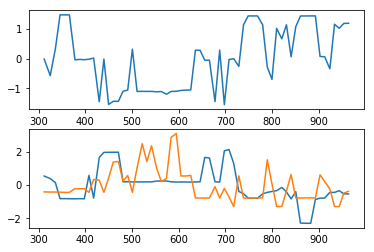

subject 36; gesture 1_1_2; avg 1.0446780269412297; sd 0.013950945510744552
subject 36; gesture 1_1_2; PoV: 0.9791728903199726


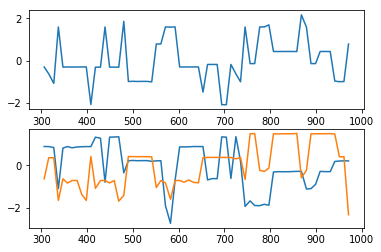

subject 36; gesture 2_1_2; avg 1.3284540414852979; sd 0.01907805565104545
subject 36; gesture 2_1_2; PoV: 0.9718603097156461


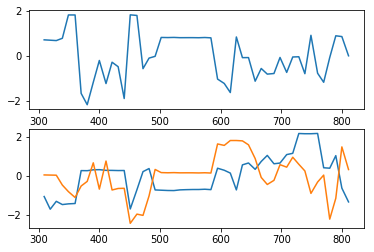

subject 36; gesture 4_0_1; avg 1.017965365305503; sd 0.010937806772950262
subject 36; gesture 4_0_1; PoV: 0.9799941277074109


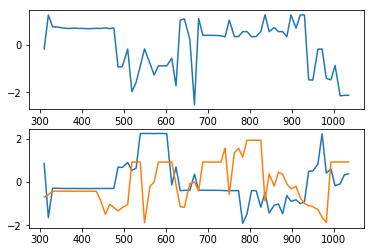

subject 36; gesture 3_0_2; avg 1.0154579715842524; sd 0.008096216742576394
subject 36; gesture 3_0_2; PoV: 0.9878662477481502


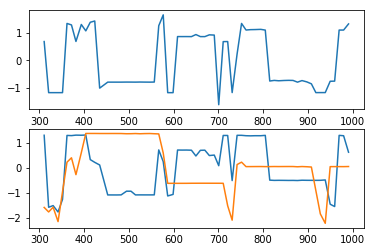

subject 36; gesture 1_1_1; avg 1.3261286679594462; sd 0.021589388643563585
subject 36; gesture 1_1_1; PoV: 0.9753803828188967


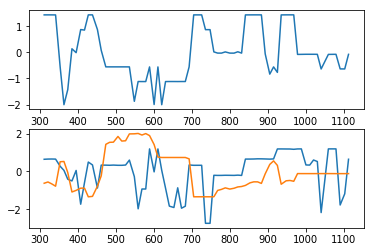

subject 36; gesture 3_1_2; avg 1.0580469521989646; sd 0.009428230268101793
subject 36; gesture 3_1_2; PoV: 0.9884973321269005


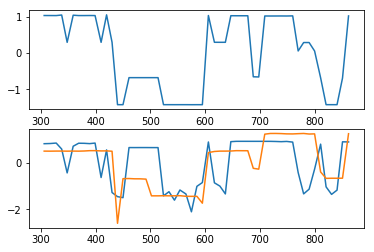

subject 36; gesture 2_1_1; avg 0.7855305442834368; sd 0.008468220390604318
subject 36; gesture 2_1_1; PoV: 0.9855501469567387


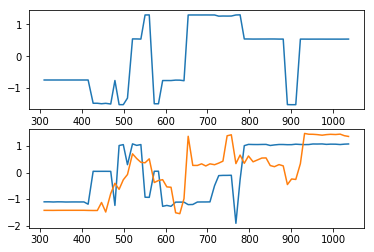

subject 36; gesture 1_0_1; avg 1.5232223102792342; sd 0.023999771704019953
subject 36; gesture 1_0_1; PoV: 0.9769957731940115


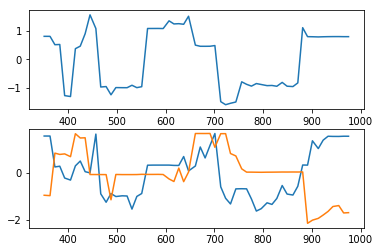

subject 36; gesture 3_1_1; avg 1.4844972264494272; sd 0.0132709325054758
subject 36; gesture 3_1_1; PoV: 0.9881209355117


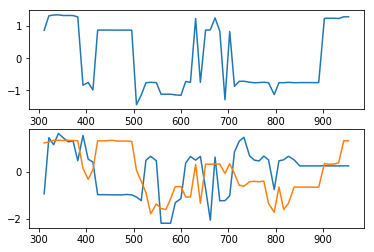

subject 36; gesture 1_0_2; avg 1.2078608420907062; sd 0.032526130999768414
subject 36; gesture 1_0_2; PoV: 0.9730658839925674


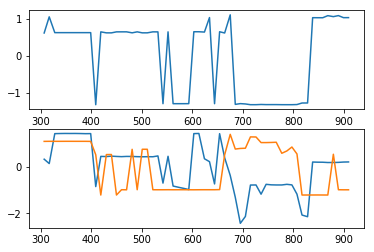

subject 36; gesture 4_0_2; avg 2.999326420785479; sd 0.03399383228058013
subject 36; gesture 4_0_2; PoV: 0.9901029274068763


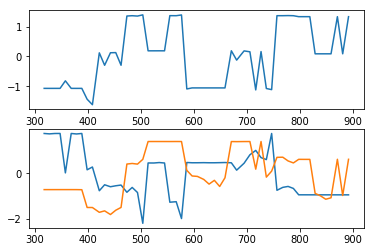

subject 24; gesture 3_0_1; avg 2.0733669164172737; sd 1.6938135375037735
subject 24; gesture 3_0_1; PoV: 0.6326135946851144


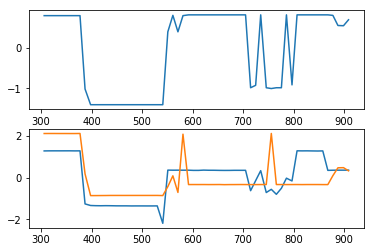

subject 24; gesture 4_1_1; avg 1.2166771057630943; sd 0.025968777869982848
subject 24; gesture 4_1_1; PoV: 0.9756848123718813


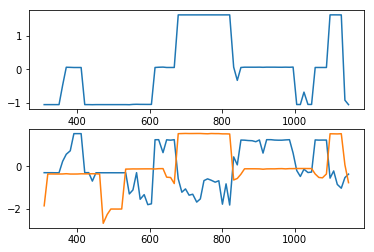

subject 24; gesture 2_0_1; avg 1.4007218367856575; sd 0.022807939774164118
subject 24; gesture 2_0_1; PoV: 0.9780295278187316


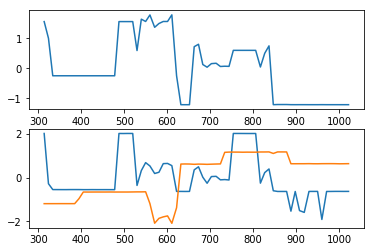

subject 24; gesture 4_1_2; avg 1.21529298707477; sd 0.014913216562566707
subject 24; gesture 4_1_2; PoV: 0.9821473439019953


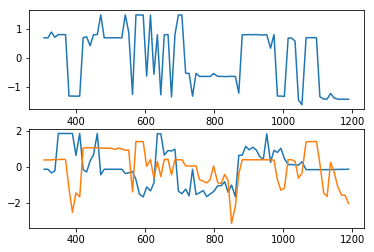

subject 24; gesture 2_0_2; avg 0.8252171876441169; sd 0.006099357304595974
subject 24; gesture 2_0_2; PoV: 0.9889116865919301


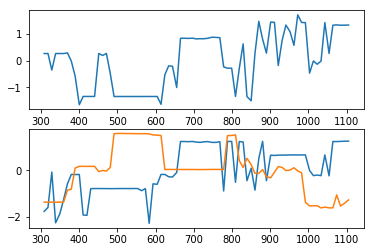

subject 24; gesture 1_1_2; avg 1.6237529615790038; sd 0.020615911509641358
subject 24; gesture 1_1_2; PoV: 0.9836156439693541


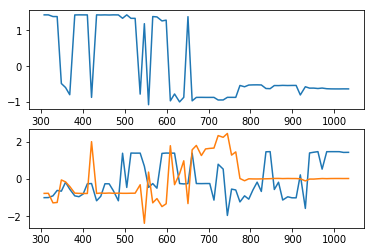

subject 24; gesture 2_1_2; avg 2.346231796932947; sd 0.012459472216609709
subject 24; gesture 2_1_2; PoV: 0.9948861022001106


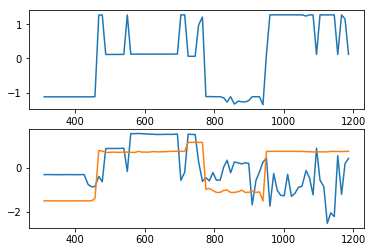

subject 24; gesture 4_0_1; avg 1.1941885445226303; sd 0.009117171328568333
subject 24; gesture 4_0_1; PoV: 0.9869483574120373


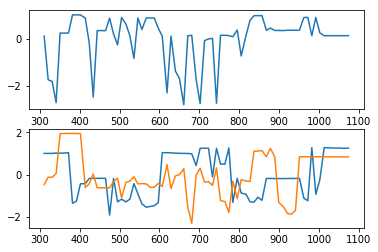

subject 24; gesture 3_0_2; avg 1.3171878177613476; sd 0.02519577682611906
subject 24; gesture 3_0_2; PoV: 0.976987172983304


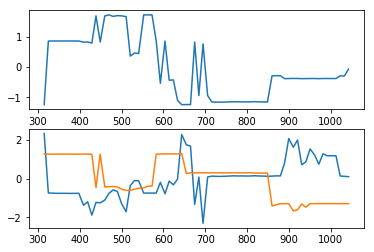

subject 24; gesture 1_1_1; avg 1.4055008569613812; sd 0.010305557031419567
subject 24; gesture 1_1_1; PoV: 0.9886070678834923


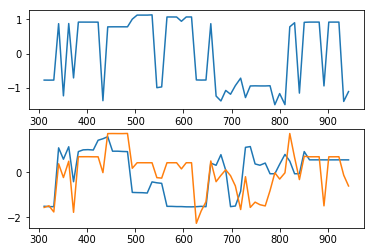

subject 24; gesture 3_1_2; avg 0.9993120699728016; sd 0.007000344769782033
subject 24; gesture 3_1_2; PoV: 0.9901444464432788


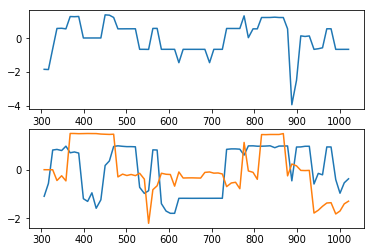

subject 24; gesture 2_1_1; avg 1.4484376369996603; sd 0.015380285378435186
subject 24; gesture 2_1_1; PoV: 0.9791370198530429


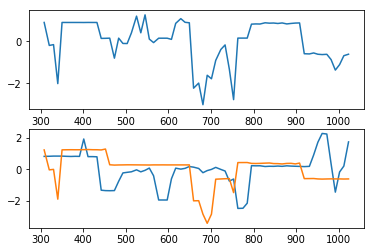

subject 24; gesture 1_0_1; avg 1.0338079240305522; sd 0.010491558619241292
subject 24; gesture 1_0_1; PoV: 0.9826653048563414


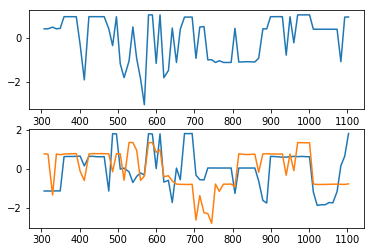

subject 24; gesture 3_1_1; avg 1.2925503322291891; sd 0.012417082897990919
subject 24; gesture 3_1_1; PoV: 0.9875535539454432


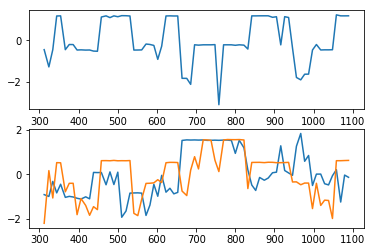

subject 24; gesture 1_0_2; avg 1.0482413720153583; sd 0.009688374801557955
subject 24; gesture 1_0_2; PoV: 0.988124471279805


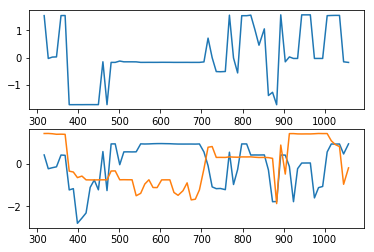

subject 24; gesture 4_0_2; avg 1.598643945856726; sd 0.01699660385147095
subject 24; gesture 4_0_2; PoV: 0.9841225010456284


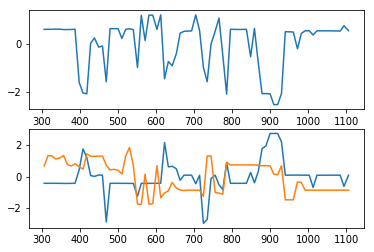

subject 33; gesture 3_0_1; avg 1.3553549415054171; sd 0.02484502012706921
subject 33; gesture 3_0_1; PoV: 0.9733309722959715


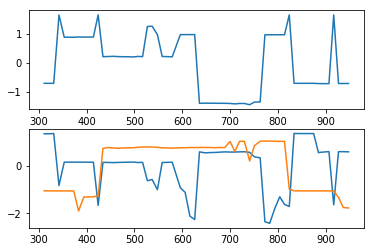

subject 33; gesture 4_1_1; avg 3.647578677450533; sd 0.0215845925893283
subject 33; gesture 4_1_1; PoV: 0.9922045073424461


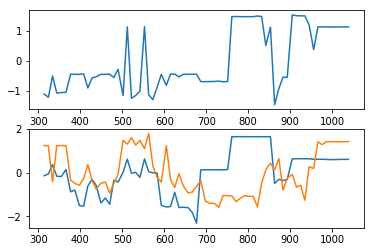

subject 33; gesture 2_0_1; avg 3.818364158692389; sd 0.04033790311379454
subject 33; gesture 2_0_1; PoV: 0.9875594482736018


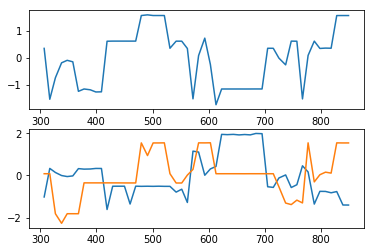

subject 33; gesture 4_1_2; avg 1.0016963644163932; sd 0.009233560875096273
subject 33; gesture 4_1_2; PoV: 0.9887809138780871


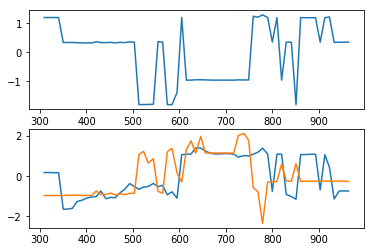

subject 33; gesture 2_0_2; avg 1.9349476018814733; sd 0.018082876475304537
subject 33; gesture 2_0_2; PoV: 0.984283995535967


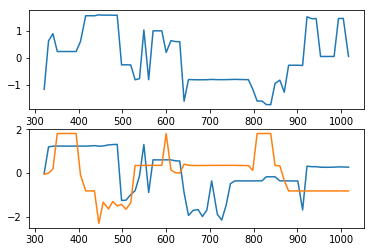

subject 33; gesture 1_1_2; avg 0.9430066260939723; sd 0.007383155501072827
subject 33; gesture 1_1_2; PoV: 0.9885344720939351


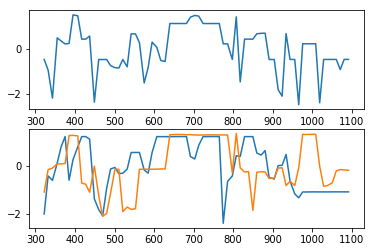

subject 33; gesture 2_1_2; avg 2.514386385279494; sd 0.03515428993585962
subject 33; gesture 2_1_2; PoV: 0.9792267857377464


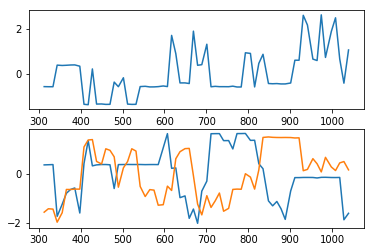

subject 33; gesture 4_0_1; avg 1.55518069320006; sd 0.022174646115700396
subject 33; gesture 4_0_1; PoV: 0.9834585117233386


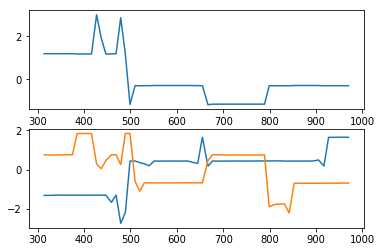

subject 33; gesture 3_0_2; avg 1.6313597859885507; sd 0.0186898376531846
subject 33; gesture 3_0_2; PoV: 0.9861379425154009


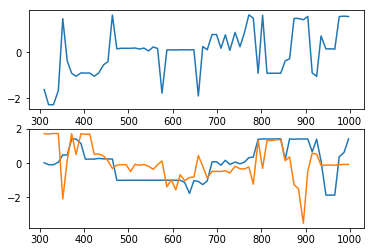

subject 33; gesture 1_1_1; avg 1.0172761689521006; sd 0.012171561663519893
subject 33; gesture 1_1_1; PoV: 0.9754627550718233


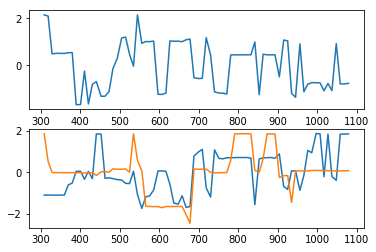

subject 33; gesture 3_1_2; avg 1.9052046693041818; sd 0.023035419794139377
subject 33; gesture 3_1_2; PoV: 0.9901040225051271


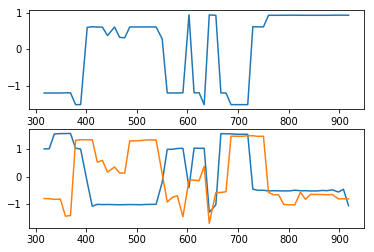

subject 33; gesture 2_1_1; avg 1.1146308835792271; sd 0.007808395452802495
subject 33; gesture 2_1_1; PoV: 0.9897628558045196


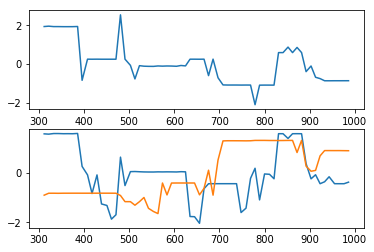

subject 33; gesture 1_0_1; avg 1.2052574178804325; sd 0.014476012018022963
subject 33; gesture 1_0_1; PoV: 0.977441924836698


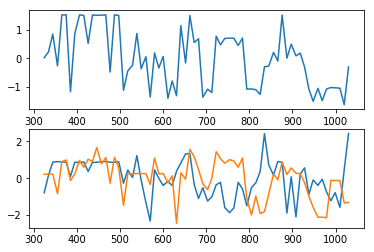

subject 33; gesture 3_1_1; avg 1.4706352483340301; sd 0.015409877524615461
subject 33; gesture 3_1_1; PoV: 0.9806827276635732


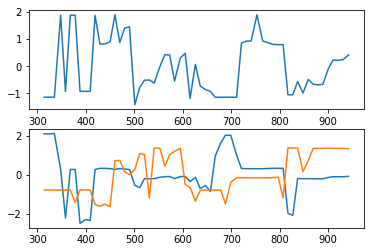

subject 33; gesture 1_0_2; avg 0.8630918380227675; sd 0.00685536309628515
subject 33; gesture 1_0_2; PoV: 0.9866544876087727


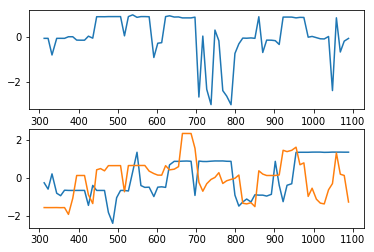

subject 33; gesture 4_0_2; avg 1.382349793886345; sd 0.021329214519012984
subject 33; gesture 4_0_2; PoV: 0.9701421957213016


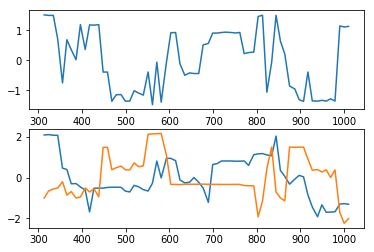

subject 11; gesture 3_0_1; avg 1.9097538216772816; sd 0.01299942596129289
subject 11; gesture 3_0_1; PoV: 0.990863155373162


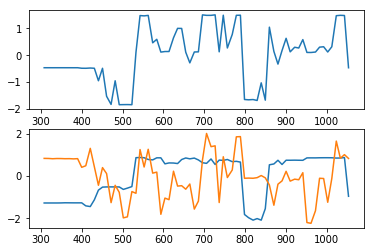

subject 11; gesture 4_1_1; avg 0.8208078566218117; sd 0.013518614009506297
subject 11; gesture 4_1_1; PoV: 0.9810724684508192


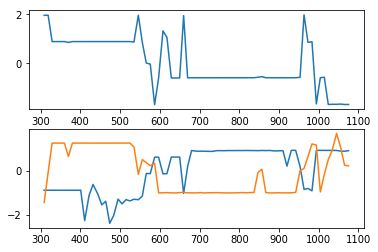

subject 11; gesture 2_0_1; avg 0.870892548191195; sd 0.00910501091697364
subject 11; gesture 2_0_1; PoV: 0.9765306858296363


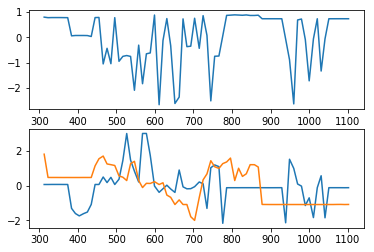

subject 11; gesture 4_1_2; avg 1.2725462515680148; sd 0.010180460996570611
subject 11; gesture 4_1_2; PoV: 0.9855378225449171


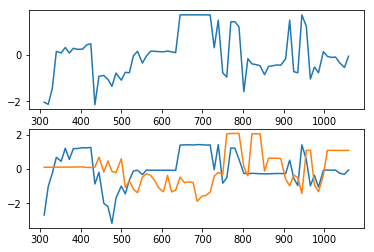

subject 11; gesture 2_0_2; avg 1.458740463219359; sd 0.012702122538018456
subject 11; gesture 2_0_2; PoV: 0.9898913938839896


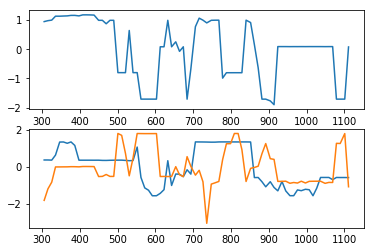

subject 11; gesture 1_1_2; avg 2.3540077913241833; sd 0.024047617687568645
subject 11; gesture 1_1_2; PoV: 0.9881933764954869


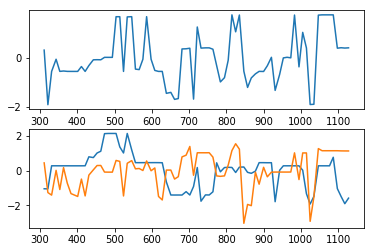

subject 11; gesture 2_1_2; avg 1.093286283851197; sd 0.007177789117780869
subject 11; gesture 2_1_2; PoV: 0.9908394170274076


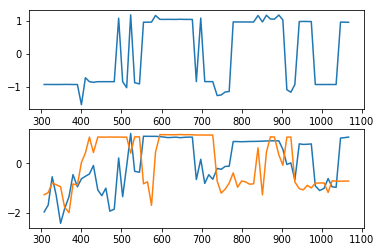

subject 11; gesture 4_0_1; avg 7.682948020040513; sd 0.05186570903803317
subject 11; gesture 4_0_1; PoV: 0.9949486046711609


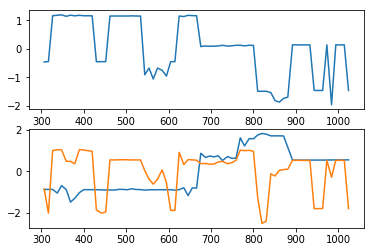

subject 11; gesture 3_0_2; avg 1.39701870944269; sd 0.014631230567460587
subject 11; gesture 3_0_2; PoV: 0.9900572703026694


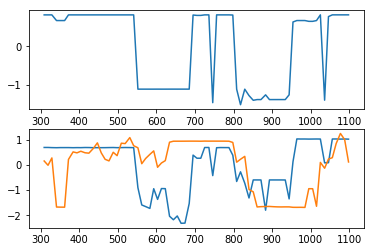

subject 11; gesture 1_1_1; avg 1.1769148748661413; sd 0.008972965037648396
subject 11; gesture 1_1_1; PoV: 0.9867036443135723


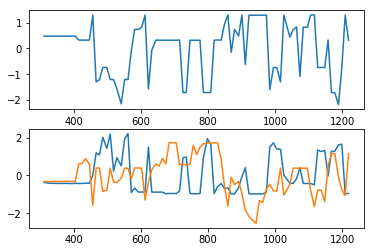

subject 11; gesture 3_1_2; avg 2.4318267704926075; sd 0.027400455304572257
subject 11; gesture 3_1_2; PoV: 0.98576621743251


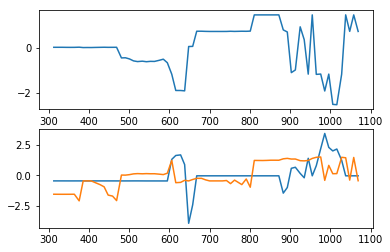

subject 11; gesture 2_1_1; avg 1.5403052934285733; sd 0.014373281550728647
subject 11; gesture 2_1_1; PoV: 0.9850822853892369


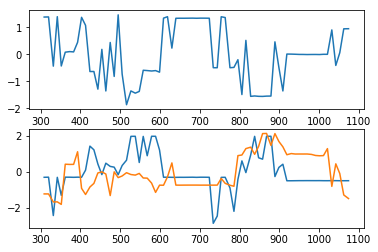

subject 11; gesture 1_0_1; avg 0.9636165896231027; sd 0.010890191996858877
subject 11; gesture 1_0_1; PoV: 0.9840413523061372


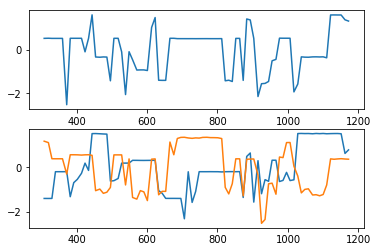

subject 11; gesture 3_1_1; avg 1.4922785580004954; sd 0.01750874997044621
subject 11; gesture 3_1_1; PoV: 0.988074239722001


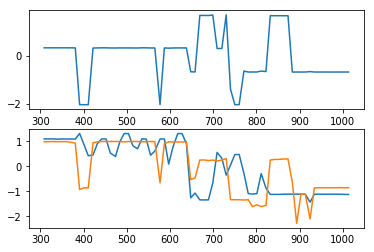

subject 11; gesture 1_0_2; avg 1.2621221500888726; sd 0.009852504819817172
subject 11; gesture 1_0_2; PoV: 0.9872213863372847


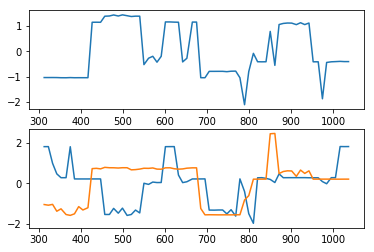

subject 11; gesture 4_0_2; avg 2.347571473761962; sd 0.02405614314660986
subject 11; gesture 4_0_2; PoV: 0.9880967962605205


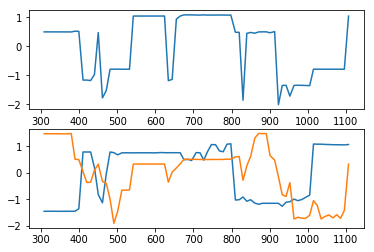

subject 35; gesture 3_0_1; avg 2.041783646407362; sd 0.031143778192898944
subject 35; gesture 3_0_1; PoV: 0.9754129058197124


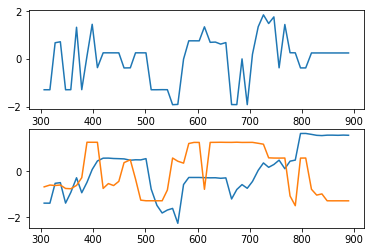

subject 35; gesture 4_1_1; avg 1.9836639065968462; sd 0.07887733717448106
subject 35; gesture 4_1_1; PoV: 0.9650843545708042


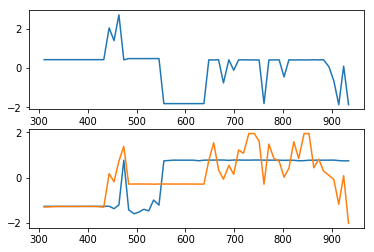

subject 35; gesture 2_0_1; avg 1.415222239916911; sd 0.013290276933424296
subject 35; gesture 2_0_1; PoV: 0.9869422434520019


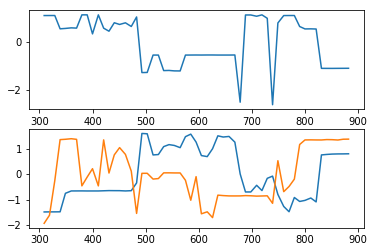

subject 35; gesture 4_1_2; avg 1.962280668089316; sd 0.03358190851593573
subject 35; gesture 4_1_2; PoV: 0.9782379530948688


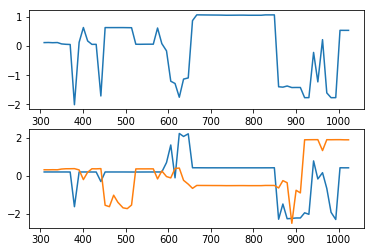

subject 35; gesture 2_0_2; avg 1.6268184681609392; sd 0.014631771542531476
subject 35; gesture 2_0_2; PoV: 0.9857346593124775


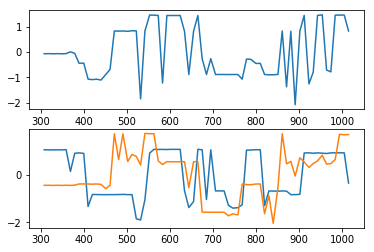

subject 35; gesture 1_1_2; avg 0.8682858516222616; sd 0.00846007427963914
subject 35; gesture 1_1_2; PoV: 0.9871925556400261


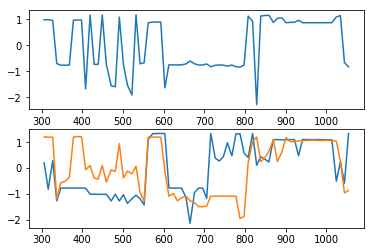

subject 35; gesture 2_1_2; avg 1.818532305953847; sd 0.01944605323222036
subject 35; gesture 2_1_2; PoV: 0.9792704238238338


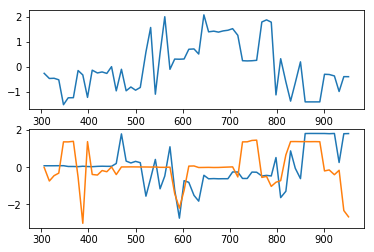

subject 35; gesture 4_0_1; avg 1.847605548760894; sd 0.016862150457203292
subject 35; gesture 4_0_1; PoV: 0.9857820026228871


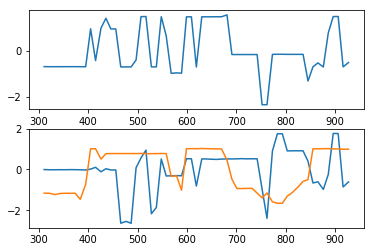

subject 35; gesture 3_0_2; avg 1.8423947598224457; sd 0.02295308400025081
subject 35; gesture 3_0_2; PoV: 0.9783011269241096


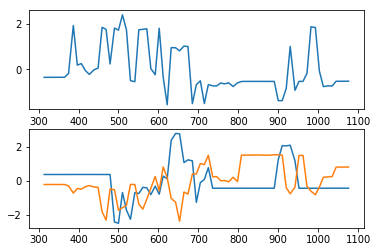

subject 35; gesture 1_1_1; avg 1.2233259994222099; sd 0.007349872790956483
subject 35; gesture 1_1_1; PoV: 0.992105225375669


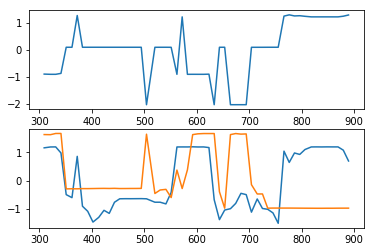

subject 35; gesture 3_1_2; avg 1.9785769927829093; sd 0.024213905035983817
subject 35; gesture 3_1_2; PoV: 0.9836911268505577


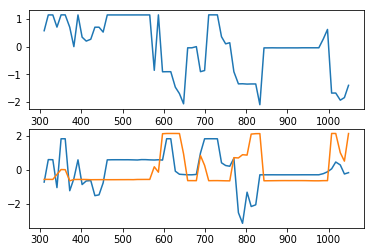

subject 35; gesture 2_1_1; avg 2.225482794035919; sd 0.01393091916718943
subject 35; gesture 2_1_1; PoV: 0.992311098205181


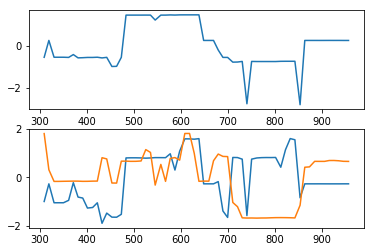

subject 35; gesture 1_0_1; avg 1.1473164128327218; sd 0.014767365543539744
subject 35; gesture 1_0_1; PoV: 0.9848334779665378


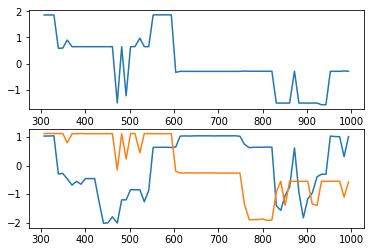

subject 35; gesture 3_1_1; avg 3.04814049553008; sd 0.01790280702718902
subject 35; gesture 3_1_1; PoV: 0.9940809062741833


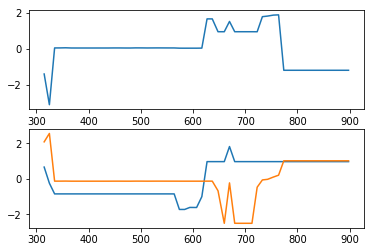

subject 35; gesture 1_0_2; avg 1.401075248486199; sd 0.01588757480807976
subject 35; gesture 1_0_2; PoV: 0.979976552152576


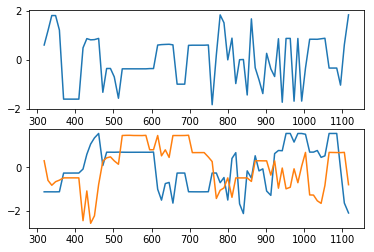

subject 35; gesture 4_0_2; avg 0.8426773183444277; sd 0.006164097295071503
subject 35; gesture 4_0_2; PoV: 0.98779288792522


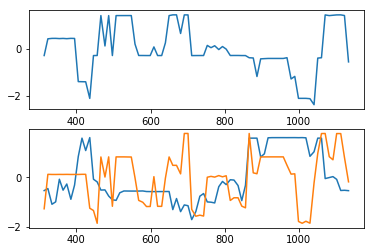

subject 22; gesture 3_0_1; avg 1.339324776231692; sd 0.010676302209442053
subject 22; gesture 3_0_1; PoV: 0.9896026443746845


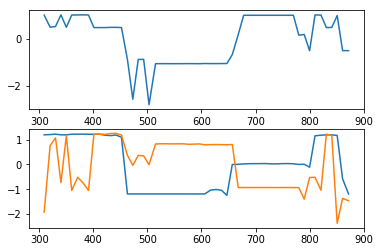

subject 22; gesture 4_1_1; avg 1.3290956671158511; sd 0.01578744296043423
subject 22; gesture 4_1_1; PoV: 0.9823207730926969


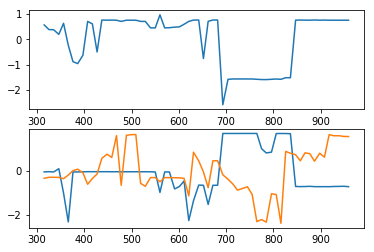

subject 22; gesture 2_0_1; avg 1.6385190419839302; sd 0.01377674282200876
subject 22; gesture 2_0_1; PoV: 0.9850712363176458


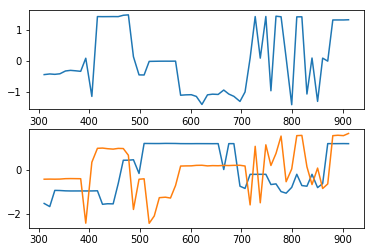

subject 22; gesture 4_1_2; avg 1.0856750028869404; sd 0.00826012559166311
subject 22; gesture 4_1_2; PoV: 0.9890889213349824


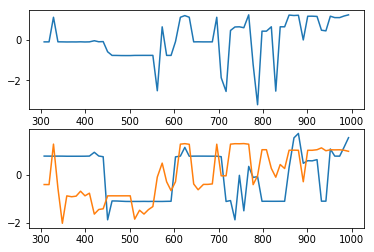

subject 22; gesture 2_0_2; avg 1.81999157038682; sd 0.015720001634638405
subject 22; gesture 2_0_2; PoV: 0.9852580756294558


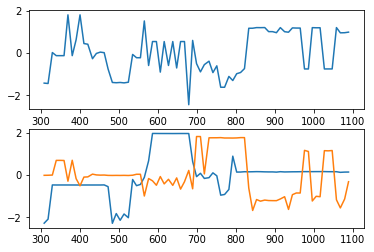

subject 22; gesture 1_1_2; avg 1.7285070669212406; sd 0.013043019268121302
subject 22; gesture 1_1_2; PoV: 0.9882721659807955


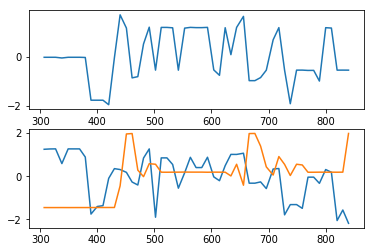

subject 22; gesture 2_1_2; avg 1.1480745264222914; sd 0.008681088407747048
subject 22; gesture 2_1_2; PoV: 0.9891808886107116


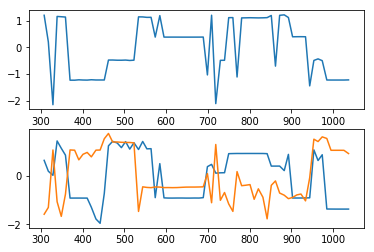

subject 22; gesture 4_0_1; avg 1.0705867580732884; sd 0.010468265871674917
subject 22; gesture 4_0_1; PoV: 0.9886471186909159


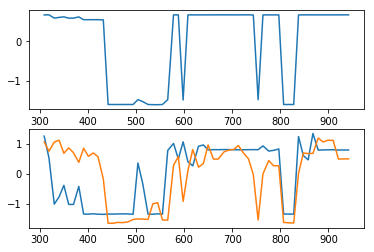

subject 22; gesture 3_0_2; avg 2.619634718677961; sd 0.02662956841814742
subject 22; gesture 3_0_2; PoV: 0.9867788917955137


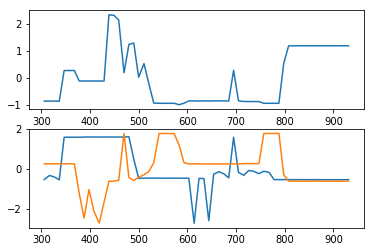

subject 22; gesture 1_1_1; avg 1.3833998086557875; sd 0.011150433798373398
subject 22; gesture 1_1_1; PoV: 0.9903721882259523


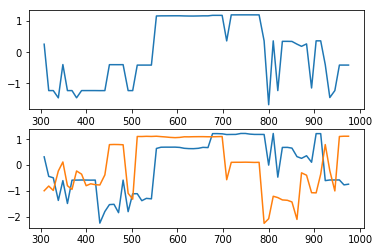

subject 22; gesture 3_1_2; avg 1.1387011204393764; sd 0.0077591630794264016
subject 22; gesture 3_1_2; PoV: 0.9906475726793511


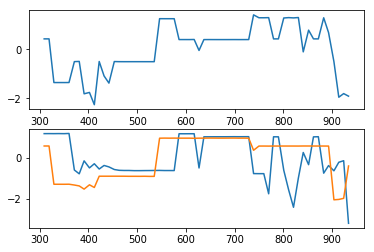

subject 22; gesture 2_1_1; avg 1.6862335009320408; sd 0.023237440105251417
subject 22; gesture 2_1_1; PoV: 0.9732569766722972


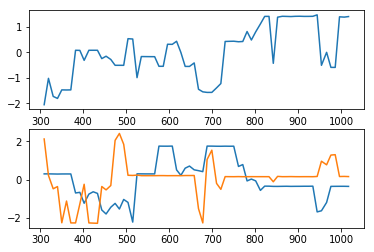

subject 22; gesture 1_0_1; avg 1.548547702832742; sd 0.01160110456778878
subject 22; gesture 1_0_1; PoV: 0.9893957567871057


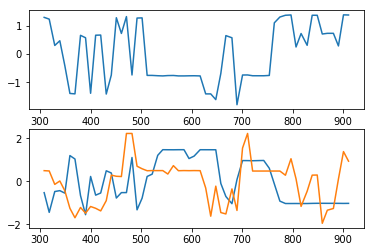

subject 22; gesture 3_1_1; avg 1.3629503769203526; sd 0.020888367687161905
subject 22; gesture 3_1_1; PoV: 0.9834276535704222


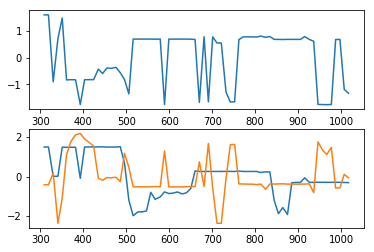

subject 22; gesture 1_0_2; avg 1.5096960226895006; sd 0.028952490223534518
subject 22; gesture 1_0_2; PoV: 0.9817030180173303


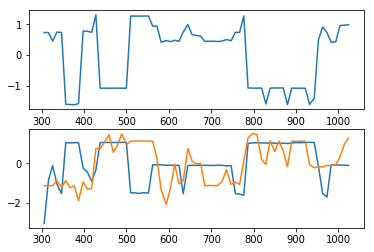

subject 22; gesture 4_0_2; avg 1.217437914701336; sd 0.011099373816961912
subject 22; gesture 4_0_2; PoV: 0.9883788197240664


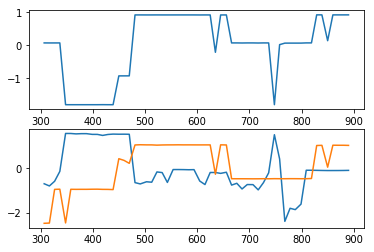

subject 34; gesture 3_0_1; avg 1.6493186959690422; sd 0.015993194807324668
subject 34; gesture 3_0_1; PoV: 0.9864207214278323


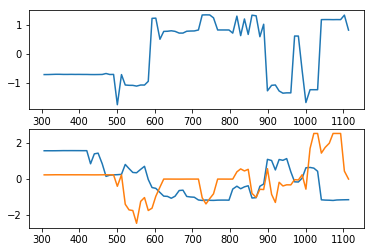

subject 34; gesture 4_1_1; avg 3.362229591871895; sd 0.045470195444901315
subject 34; gesture 4_1_1; PoV: 0.9841186274915132


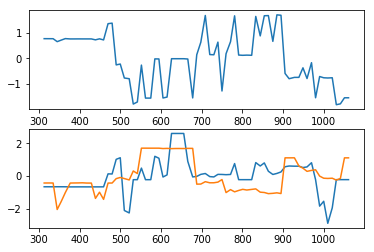

subject 34; gesture 2_0_1; avg 1.2429197936028504; sd 0.011580959501864399
subject 34; gesture 2_0_1; PoV: 0.9866193726522999


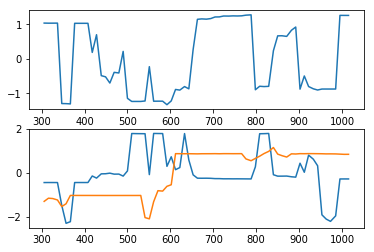

subject 34; gesture 4_1_2; avg 0.7351483811551816; sd 0.0074143253091899135
subject 34; gesture 4_1_2; PoV: 0.9837553082323685


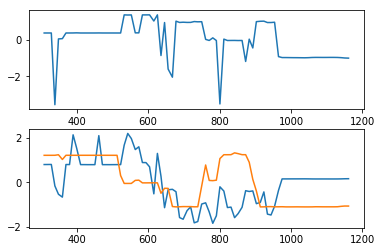

subject 34; gesture 2_0_2; avg 2.2509513356970716; sd 0.0165377855550106
subject 34; gesture 2_0_2; PoV: 0.990985958308689


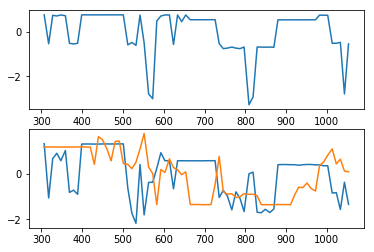

subject 34; gesture 1_1_2; avg 0.9991419405484814; sd 0.0057153265285455656
subject 34; gesture 1_1_2; PoV: 0.9911080837692955


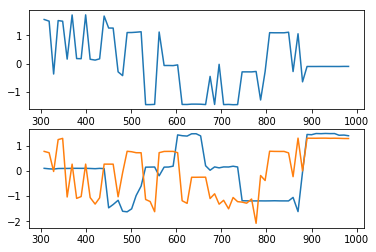

subject 34; gesture 2_1_2; avg 0.9322503612100879; sd 0.007074182198881175
subject 34; gesture 2_1_2; PoV: 0.9895279081638328


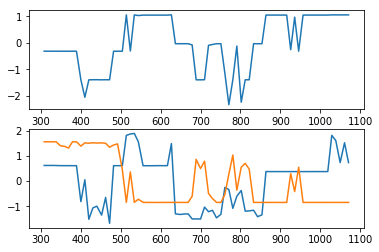

subject 34; gesture 4_0_1; avg 0.9211119155463651; sd 0.017390787392752613
subject 34; gesture 4_0_1; PoV: 0.9800429072135832


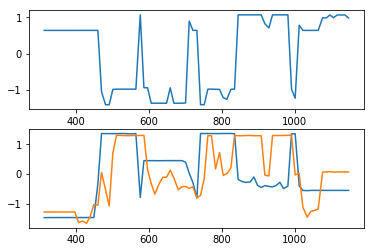

subject 34; gesture 3_0_2; avg 1.2642484879922489; sd 0.008734749616379711
subject 34; gesture 3_0_2; PoV: 0.9904149695602952


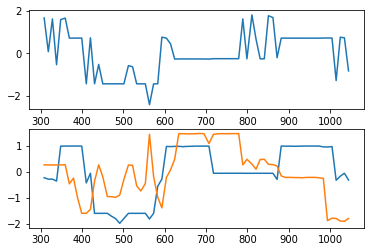

subject 34; gesture 1_1_1; avg 0.7147292203314232; sd 0.004823747704266523
subject 34; gesture 1_1_1; PoV: 0.9916158409051348


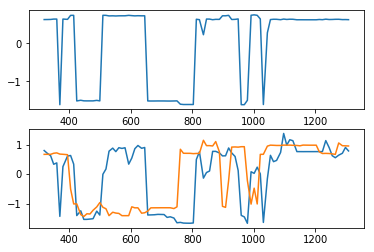

subject 34; gesture 3_1_2; avg 4.000315929358878; sd 0.039188678213542195
subject 34; gesture 3_1_2; PoV: 0.9912849784933859


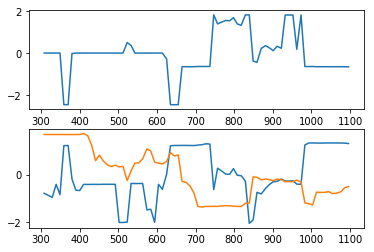

subject 34; gesture 2_1_1; avg 1.1255212904014782; sd 0.01989597279662165
subject 34; gesture 2_1_1; PoV: 0.9715979273882974


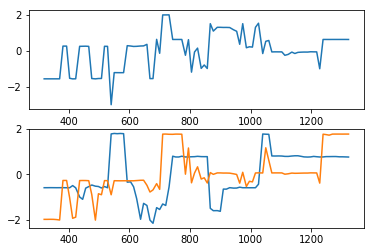

subject 34; gesture 1_0_1; avg 0.9473743206704328; sd 0.006009103264828865
subject 34; gesture 1_0_1; PoV: 0.9905154224746069


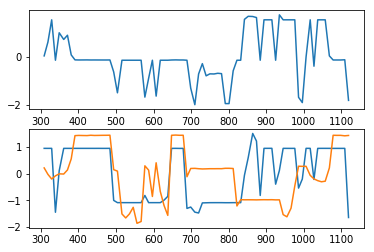

subject 34; gesture 3_1_1; avg 5.342620238759164; sd 0.02563474959627803
subject 34; gesture 3_1_1; PoV: 0.9965237811716267


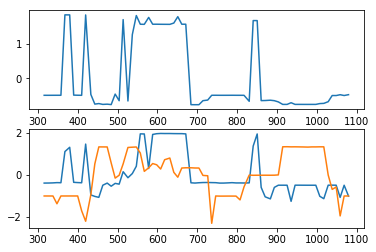

subject 34; gesture 1_0_2; avg 1.1488259730047985; sd 0.012374502469197824
subject 34; gesture 1_0_2; PoV: 0.9784875085981249


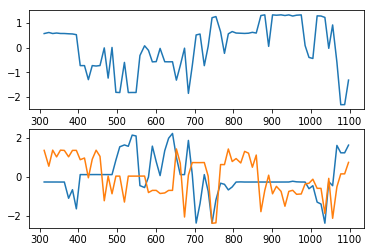

subject 34; gesture 4_0_2; avg 1.159407578232228; sd 0.010018145056727079
subject 34; gesture 4_0_2; PoV: 0.9859316925110105


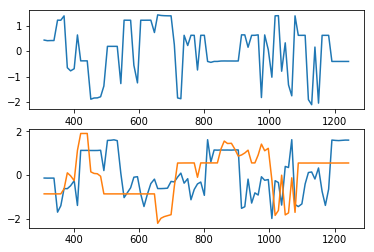

subject 10; gesture 3_0_1; avg 1.4883389272459109; sd 0.009815655320464538
subject 10; gesture 3_0_1; PoV: 0.9911783840773228


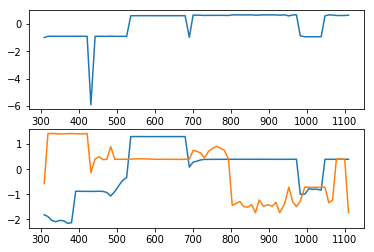

subject 10; gesture 4_1_1; avg 3.3521309425034262; sd 0.029992408524927922
subject 10; gesture 4_1_1; PoV: 0.9871198550360634


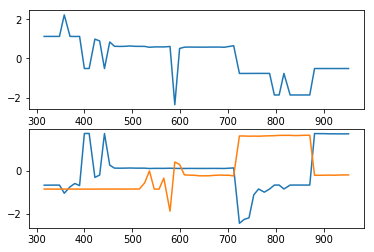

subject 10; gesture 2_0_1; avg 3.1875504931569845; sd 0.03098802323530164
subject 10; gesture 2_0_1; PoV: 0.984053414495339


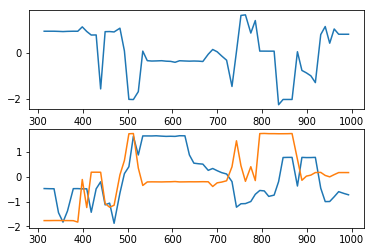

subject 10; gesture 4_1_2; avg 1.8229942031413082; sd 0.01483341302180626
subject 10; gesture 4_1_2; PoV: 0.9879713997435285


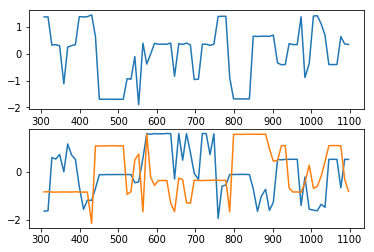

subject 10; gesture 2_0_2; avg 1.7671476198182912; sd 0.0375732187557455
subject 10; gesture 2_0_2; PoV: 0.980885536265027


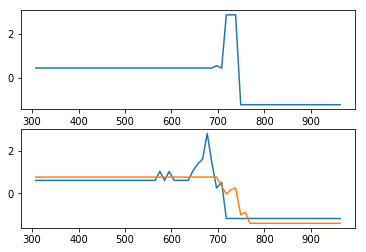

subject 10; gesture 1_1_2; avg 1.4222241128221866; sd 0.015425706197404448
subject 10; gesture 1_1_2; PoV: 0.9814405686662188


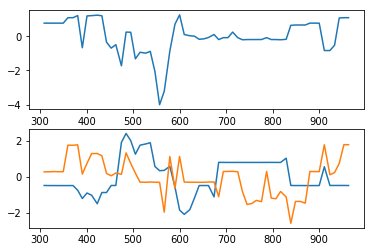

subject 10; gesture 2_1_2; avg 0.9345938880979148; sd 0.007436147034559065
subject 10; gesture 2_1_2; PoV: 0.9899852537854723


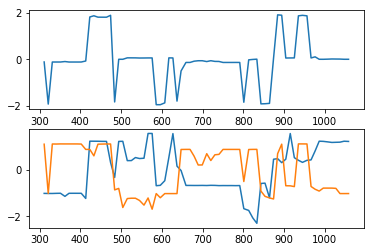

subject 10; gesture 4_0_1; avg 1.519392772116685; sd 0.019946356937482593
subject 10; gesture 4_0_1; PoV: 0.9789602770258381


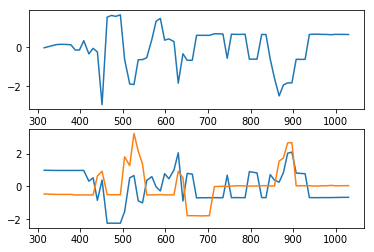

subject 10; gesture 3_0_2; avg 1.315659807300104; sd 0.01045736961610535
subject 10; gesture 3_0_2; PoV: 0.9890816375501925


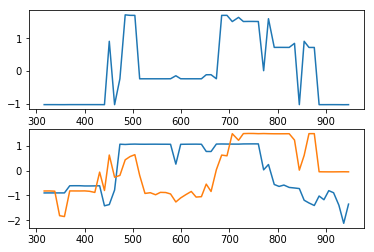

subject 10; gesture 1_1_1; avg 1.1604443672180142; sd 0.010107916792850637
subject 10; gesture 1_1_1; PoV: 0.9867288617844476


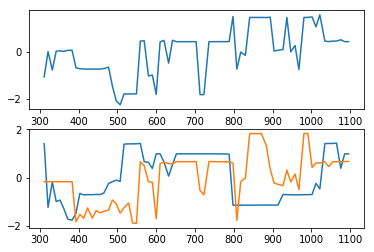

subject 10; gesture 3_1_2; avg 1.5211006027584602; sd 0.02283968015920018
subject 10; gesture 3_1_2; PoV: 0.9808114036238308


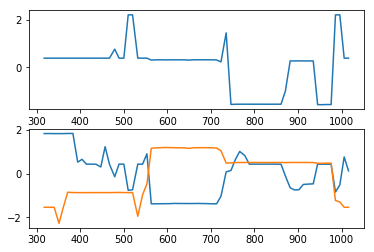

subject 10; gesture 2_1_1; avg 1.7488425321764505; sd 0.0222668266414117
subject 10; gesture 2_1_1; PoV: 0.9835888545304247


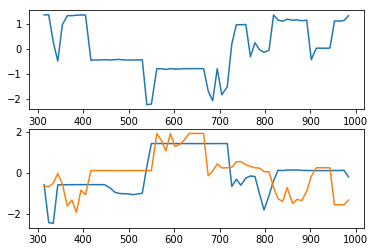

subject 10; gesture 1_0_1; avg 1.1228650096981982; sd 0.013565623357389249
subject 10; gesture 1_0_1; PoV: 0.9815149989959882


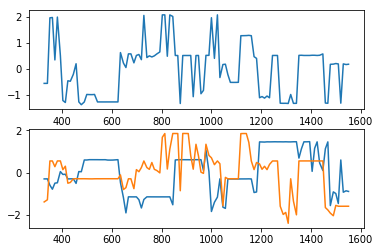

subject 10; gesture 3_1_1; avg 1.2901324613025968; sd 0.022746455197411832
subject 10; gesture 3_1_1; PoV: 0.971295223504879


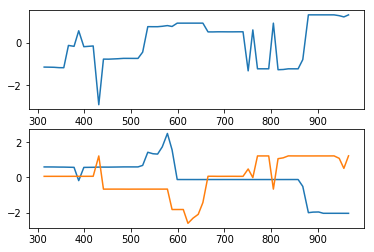

subject 10; gesture 1_0_2; avg 1.1162268016009622; sd 0.01007816222363378
subject 10; gesture 1_0_2; PoV: 0.9817841920642519


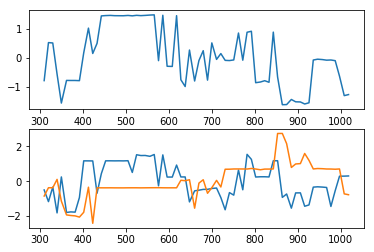

subject 10; gesture 4_0_2; avg 1.8593830987078368; sd 0.009648793835113963
subject 10; gesture 4_0_2; PoV: 0.9938312780474399


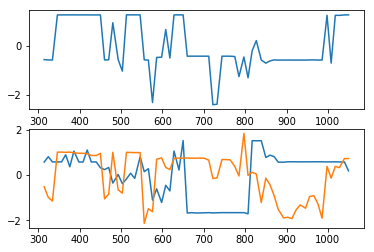

subject 02; gesture 3_0_1; avg 1.7570038425235643; sd 0.012887562340542467
subject 02; gesture 3_0_1; PoV: 0.9913281371843332


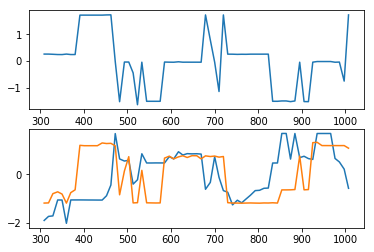

subject 02; gesture 4_1_1; avg 1.3098719069411595; sd 0.019303098365933444
subject 02; gesture 4_1_1; PoV: 0.9761135155366796


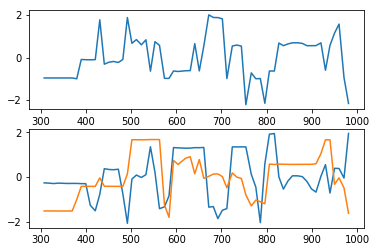

subject 02; gesture 2_0_1; avg 1.3688531058171893; sd 0.009652717293204296
subject 02; gesture 2_0_1; PoV: 0.987148915072144


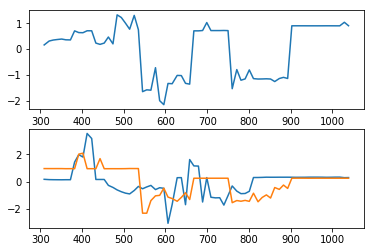

subject 02; gesture 4_1_2; avg 1.927072851684947; sd 0.013683568014744933
subject 02; gesture 4_1_2; PoV: 0.9904350797395896


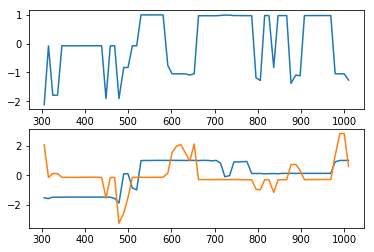

subject 02; gesture 2_0_2; avg 2.4873431983437113; sd 0.017720000683338344
subject 02; gesture 2_0_2; PoV: 0.9898247869059619


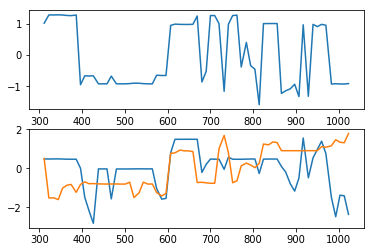

subject 02; gesture 1_1_2; avg 1.7935900759354966; sd 0.009993811500541606
subject 02; gesture 1_1_2; PoV: 0.9928027937531397


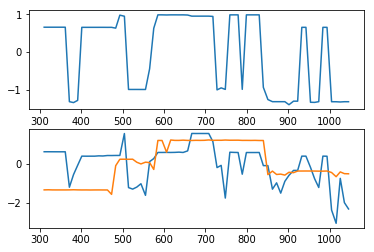

subject 02; gesture 2_1_2; avg 1.2075352882031853; sd 0.015807505017155818
subject 02; gesture 2_1_2; PoV: 0.9859781367467532


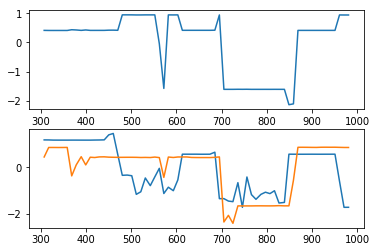

subject 02; gesture 4_0_1; avg 0.9926733705511733; sd 0.013358769436040543
subject 02; gesture 4_0_1; PoV: 0.9828199603119175


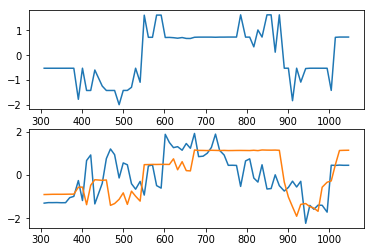

subject 02; gesture 3_0_2; avg 1.9702386141575552; sd 0.024783310739949868
subject 02; gesture 3_0_2; PoV: 0.9833165384528498


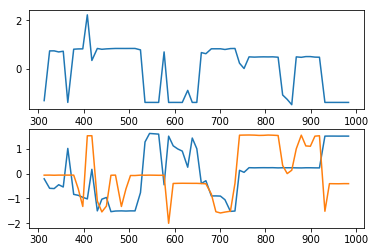

subject 02; gesture 1_1_1; avg 1.3769856588427716; sd 0.00843610495723584
subject 02; gesture 1_1_1; PoV: 0.9925411599612958


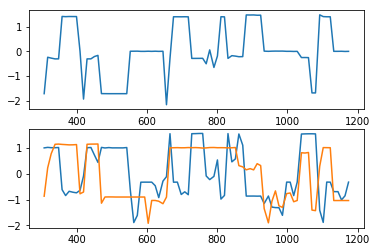

subject 02; gesture 3_1_2; avg 1.0118395762797616; sd 0.02926112696959292
subject 02; gesture 3_1_2; PoV: 0.959321118039518


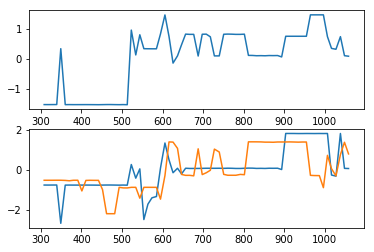

subject 02; gesture 2_1_1; avg 1.7502015620587341; sd 0.023245785393403846
subject 02; gesture 2_1_1; PoV: 0.9820219431934735


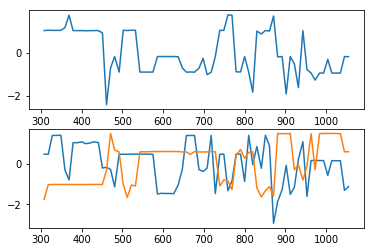

subject 02; gesture 1_0_1; avg 1.4984200323093404; sd 0.0171673648559278
subject 02; gesture 1_0_1; PoV: 0.9881801506242636


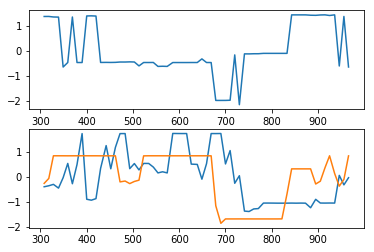

subject 02; gesture 3_1_1; avg 1.3263287765469933; sd 0.008499736202437309
subject 02; gesture 3_1_1; PoV: 0.9914489638089657


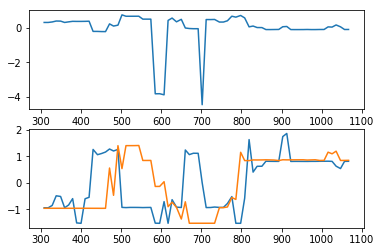

subject 02; gesture 1_0_2; avg 0.8655668589982539; sd 0.011519730051722887
subject 02; gesture 1_0_2; PoV: 0.9862803722452005


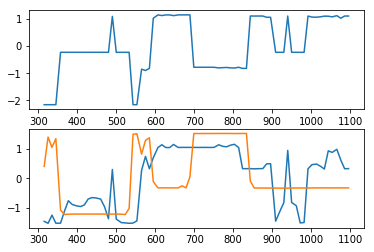

subject 02; gesture 4_0_2; avg 1.3525098287056945; sd 0.052865100589958726
subject 02; gesture 4_0_2; PoV: 0.9623216168093759


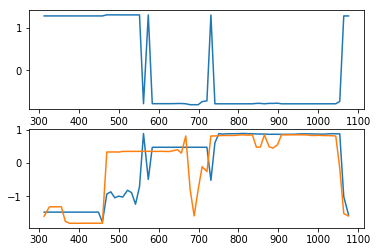

In [11]:
decomp_fuse = {}

for s, gdict in dict_fused.items():
    decomp_fuse[s] = {}
    for g, a in gdict.items():
        print(f"subject {s}; gesture {g}; avg {a.mean()}; sd {a.std()}")
        evals, evecs = la.eig(a)
        evals = evals.real
        sort_idx = np.argsort(-evals)
        evals = evals[sort_idx]
        evecs = evecs[:, sort_idx]
        # calc percent of variance explained
        print(f"subject {s}; gesture {g}; PoV: {evals[0].real / evals.real.sum()}")
        # do PCA
        res = a @ evecs[:, 0]
        res = scale(res.real)
        decomp_fuse[s][g] = res
        # plot results
        plt.subplot(211)
        plt.plot(dc.data_set_smooth[s][g][:,0], res)
        plt.subplot(212)
        plt.plot(dc.data_set_smooth[s][g][:,0], ant_syn_dict[s][g][:,1])
        plt.plot(dc.data_set_smooth[s][g][:,0], ant_syn_dict[s][g][:,2])
        plt.show()

---

In [12]:
# organize vectors by gesture
gest_dict = {"1":[], "2":[], "3":[], "4":[]}

for s, gdict in decomp_fuse.items():
    for g, a in gdict.items():
        if g[0] not in ["1", "2", "3", "4"]: continue
        gest_dict[g[0]].append(a)

In [13]:
comp_dict = {"1":{"1":[], "2":[], "3":[], "4":[]},
             "2":{"1":[], "2":[], "3":[], "4":[]},
             "3":{"1":[], "2":[], "3":[], "4":[]},
             "4":{"1":[], "2":[], "3":[], "4":[]}}

for g1 in ["1", "2", "3", "4"]:
    for g2 in ["1", "2", "3", "4"]:
        for i in range(144):
            for j in range(144):
                if i == j and g1 == g2: continue
                comp_dict[g1][g2].append(dtw(gest_dict[g1][i], gest_dict[g2][j]))

In [14]:
for g1 in ["1", "2", "3", "4"]:
    print(f"gesture {g1} dtw similarities w/ other gestures:")
    for g2 in ["1", "2", "3", "4"]:
        print(f"avg similarity vs gesture {g2}: {np.mean(comp_dict[g1][g2])}")

gesture 1 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.794537319314333
avg similarity vs gesture 2: 6.882238697286989
avg similarity vs gesture 3: 6.934542496177809
avg similarity vs gesture 4: 7.0439585612417055
gesture 2 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.882238697286989
avg similarity vs gesture 2: 6.948227555110421
avg similarity vs gesture 3: 6.976614907536772
avg similarity vs gesture 4: 7.107072986762771
gesture 3 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.934542496177809
avg similarity vs gesture 2: 6.976614907536772
avg similarity vs gesture 3: 6.988706933279864
avg similarity vs gesture 4: 7.154930545439213
gesture 4 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 7.043958561241704
avg similarity vs gesture 2: 7.107072986762771
avg similarity vs gesture 3: 7.154930545439213
avg similarity vs gesture 4: 7.279131599976401
